# Load Libraries

In [1]:
import numpy as np 
import matplotlib.pyplot as plt
import glob
import cv2

from keras.models import Model, Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
from keras.layers.normalization import BatchNormalization
import os
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [2]:
list_of_architectures = [
    "Xception",
    "VGG16",
    "VGG19",
    "ResNet50V2",
    "ResNet101V2",
    "ResNet152V2",
    "InceptionV3",
    "MobileNet",
    "MobileNetV2",
    "DenseNet121",
    "DenseNet169",
    "DenseNet201"
    
]

In [3]:
list_of_classifiers = [
    "RF"
]

In [4]:
list_of_size = [
    128,
    256
]

In [5]:
layer = "last_layer"

In [6]:
preprocessing_technique = "smote_pca"

In [7]:
n_components = [50, 100, 500]

In [8]:
output_folder = "output"
analysis_output =  output_folder + "/" + layer + "_" + preprocessing_technique + "_fusion_2_axis1_RF_128_256.csv"

# get Data

In [9]:
import tensorflow as tf
def getData(model1, model2, image_size, n_component):
    X_data_dir="../pca/" + layer + "/" + str(image_size)+"/"
    y_train_data_dir="../class_imabalance/" + layer + "/" + str(image_size)+"/"
    y_test_data_dir="../feature_extractor/" + layer + "/" + str(image_size)+"/"
    
    X_train1=np.load(X_data_dir+model1+"_train_" + str(n_component) + ".npy")
    X_train2=np.load(X_data_dir+model2+"_train_" + str(n_component) + ".npy")
    X_train = tf.keras.layers.concatenate([X_train1, X_train2],
                            axis=1)
    
    y_train=np.load(y_train_data_dir+model1+"_y_train_SMOTE.npy")
    
    X_test1=np.load(X_data_dir+model1+"_test_" + str(n_component) + ".npy")
    X_test2=np.load(X_data_dir+model2+"_test_" + str(n_component) + ".npy")
    X_test = tf.keras.layers.concatenate([X_test1, X_test2],
                            axis=1)
    
    y_test=np.load(y_test_data_dir+"test_labels.npy")
    
    
    return X_train, y_train, X_test, y_test

In [10]:
def getLabelEncoder(layer, image_size):
    label_encoder_location = "../feature_extractor/" + layer + "/" + str(image_size)+"/"
    label_encoder = np.load(label_encoder_location+'label_encoder.npy')
    return label_encoder

#  Reusable function for Confusion Matrix 

In [11]:
def getClassificationReport(test_labels, prediction):
    
    def plot_confusion_matrix(cm, classes,
                              normalize=False,
                              title='Confusion matrix',
                              cmap=plt.cm.Blues):
        """
        This function prints and plots the confusion matrix.
        Normalization can be applied by setting `normalize=True`.
        """
        import itertools
        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            print("Normalized confusion matrix")
        else:
            print('Confusion matrix, without normalization')

        #print(cm)

        plt.imshow(cm, interpolation='nearest', cmap=cmap)
        plt.title(title)
        #plt.colorbar()
        tick_marks = np.arange(len(classes))
        plt.xticks(tick_marks, classes, rotation=45)
        plt.yticks(tick_marks, classes)

        fmt = '.2f' if normalize else 'd'
        thresh = cm.max() / 2.
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            plt.text(j, i, format(cm[i, j], fmt),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

        plt.ylabel('True label')
        plt.xlabel('Predicted label')
        plt.tight_layout()
        plt.show()
        
    from sklearn.metrics import confusion_matrix
    test_label_list=list(np.unique(test_labels))
    cnf_matrix = confusion_matrix(test_labels, prediction,labels=test_label_list)
    np.set_printoptions(precision=2)

    # Plot non-normalized confusion matrix
    plt.figure(figsize=(8,8))
    plot_confusion_matrix(cnf_matrix, classes=test_label_list,
                          title='Confusion matrix, without normalization')
    
    
    from sklearn import metrics
    
    accuracy = round(metrics.accuracy_score(test_labels, prediction),3)
    precision = round(metrics.precision_score(test_labels, prediction, average='weighted'),3)
    recall = round(metrics.recall_score(test_labels, prediction, average='weighted'),3)
    f1_score = round(metrics.f1_score(test_labels, prediction, average='weighted'),3)
    
    # Balanced
    balanced_accuracy = round(metrics.balanced_accuracy_score(test_labels, prediction),3)
    
    FP = cnf_matrix.sum(axis=0) - np.diag(cnf_matrix)  
    FN = cnf_matrix.sum(axis=1) - np.diag(cnf_matrix)
    TP = np.diag(cnf_matrix)
    TN = cnf_matrix.sum() - (FP + FN + TP)
    
    # Sensitivity, hit rate, recall, or true positive rate
    TPR = round((TP/(TP+FN)).mean(),3)
    # Specificity or true negative rate
    TNR = round((TN/(TN+FP) ).mean(),3)
    # Precision or positive predictive value
    PPV = round((TP/(TP+FP)).mean(),3)
    # Negative predictive value
    NPV = round((TN/(TN+FN)).mean(),3)
    # Fall out or false positive rate
    FPR = round((FP/(FP+TN)).mean(),3)
    # False negative rate
    FNR = round((FN/(TP+FN)).mean(),3)
    # False discovery rate
    FDR = round((FP/(TP+FP)).mean(),3)

    # Overall accuracy
    Overall_Acc = round(((TP+TN)/(TP+FP+FN+TN)).mean(),3)
    Bal_F1 = round((2*(PPV*TPR)/(PPV+TPR)),3)
    
    
    print("Acc     = ", accuracy)
    print("Pre     = ", precision)
    print("Rec     = ", recall)
    print("F1      = ", f1_score)
    print("")
    
    print("Bal_Acc = ", balanced_accuracy)
    print("Bal_Pre = ", PPV)
    print("Bal_Rec = ", TPR)
    print("Bal_F1  = ", Bal_F1)
    print("")
    
    from sklearn.metrics import classification_report, confusion_matrix
    print(classification_report(test_labels, prediction))
    
    return accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc


# Classifier

In [12]:
def classify(model1, model2, classifier, image_size, n_component):
    X_train, y_train, X_test, y_test = getData(model1, model2, image_size, n_component)

    if classifier == "RF":
        from sklearn.ensemble import RandomForestClassifier
        model = RandomForestClassifier(n_estimators = 100, random_state = 42)
    elif classifier == "SVM":
        from sklearn.svm import SVC
        model = SVC(kernel='linear', degree=3, C=1, decision_function_shape='ovo')
        
    # Train the model on training data
    model.fit(X_train, y_train) #For sklearn no one hot encoding

    #Now predict using the trained RF model. 
    prediction = model.predict(X_test)
    
    #get the encoder from the pickle file
    from sklearn import preprocessing
    le = preprocessing.LabelEncoder()
    le.classes_ = getLabelEncoder(layer, image_size)
    
    """
    import pickle
    model_loc = "models"
    filename = model_loc + "/" + layer + "_" + preprocessing_technique + "_" + 'classifier'  + "_" + model_name + "_" + classifier + "_" + str(image_size) + " .sav "
    pickle.dump(model, open(filename, 'wb'))
    """
    
    #Inverse le transform to get original label back. 
    prediction = le.inverse_transform(prediction)
    y_test = le.inverse_transform(y_test)
    
    accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc = getClassificationReport(y_test, prediction)
    return accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc

In [13]:
from itertools import combinations
list_of_combinations=[",".join(map(str, comb)) for comb in combinations(list_of_architectures, 2)]
list_of_combinations

['Xception,VGG16',
 'Xception,VGG19',
 'Xception,ResNet50V2',
 'Xception,ResNet101V2',
 'Xception,ResNet152V2',
 'Xception,InceptionV3',
 'Xception,MobileNet',
 'Xception,MobileNetV2',
 'Xception,DenseNet121',
 'Xception,DenseNet169',
 'Xception,DenseNet201',
 'VGG16,VGG19',
 'VGG16,ResNet50V2',
 'VGG16,ResNet101V2',
 'VGG16,ResNet152V2',
 'VGG16,InceptionV3',
 'VGG16,MobileNet',
 'VGG16,MobileNetV2',
 'VGG16,DenseNet121',
 'VGG16,DenseNet169',
 'VGG16,DenseNet201',
 'VGG19,ResNet50V2',
 'VGG19,ResNet101V2',
 'VGG19,ResNet152V2',
 'VGG19,InceptionV3',
 'VGG19,MobileNet',
 'VGG19,MobileNetV2',
 'VGG19,DenseNet121',
 'VGG19,DenseNet169',
 'VGG19,DenseNet201',
 'ResNet50V2,ResNet101V2',
 'ResNet50V2,ResNet152V2',
 'ResNet50V2,InceptionV3',
 'ResNet50V2,MobileNet',
 'ResNet50V2,MobileNetV2',
 'ResNet50V2,DenseNet121',
 'ResNet50V2,DenseNet169',
 'ResNet50V2,DenseNet201',
 'ResNet101V2,ResNet152V2',
 'ResNet101V2,InceptionV3',
 'ResNet101V2,MobileNet',
 'ResNet101V2,MobileNetV2',
 'ResNet10

--------------------------------------------------------------------------
RF Xception VGG16 128 50


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, y

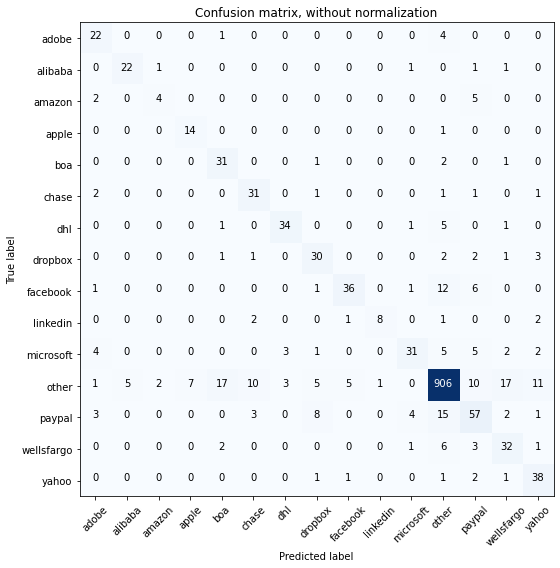

Acc     =  0.842
Pre     =  0.855
Rec     =  0.842
F1      =  0.844

Bal_Acc =  0.742
Bal_Pre =  0.712
Bal_Rec =  0.742
Bal_F1  =  0.727

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.57      0.36      0.44        11
       apple       0.67      0.93      0.78        15
         boa       0.58      0.89      0.70        35
       chase       0.66      0.84      0.74        37
         dhl       0.85      0.81      0.83        42
     dropbox       0.62      0.75      0.68        40
    facebook       0.84      0.63      0.72        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.79      0.58      0.67        53
       other       0.94      0.91      0.92      1000
      paypal       0.62      0.61      0.62        93
  wellsfargo       0.55      0.71      0.62        45
       yahoo       0.64      0.86      0.74        

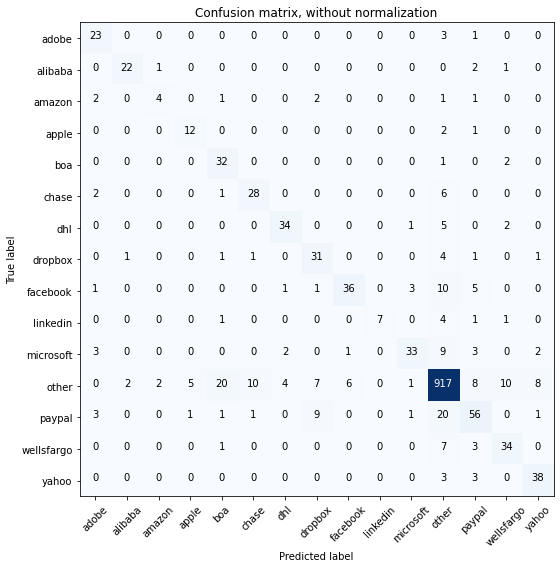

Acc     =  0.849
Pre     =  0.857
Rec     =  0.849
F1      =  0.849

Bal_Acc =  0.734
Bal_Pre =  0.747
Bal_Rec =  0.734
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.57      0.36      0.44        11
       apple       0.67      0.80      0.73        15
         boa       0.55      0.91      0.69        35
       chase       0.70      0.76      0.73        37
         dhl       0.83      0.81      0.82        42
     dropbox       0.62      0.78      0.69        40
    facebook       0.84      0.63      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.85      0.62      0.72        53
       other       0.92      0.92      0.92      1000
      paypal       0.66      0.60      0.63        93
  wellsfargo       0.68      0.76      0.72        45
       yahoo       0.76      0.86      0.81        4

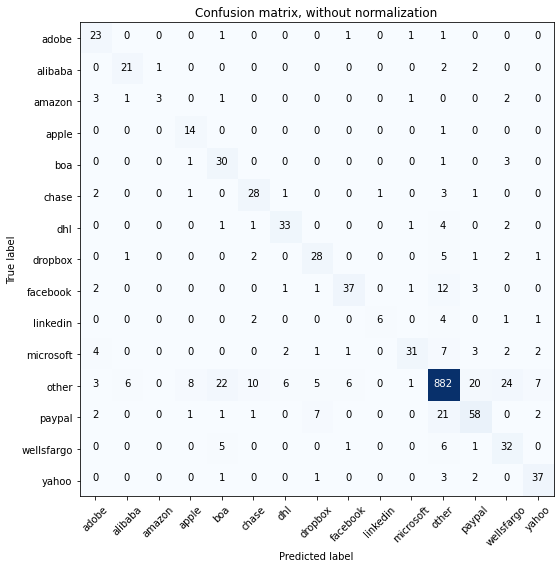

Acc     =  0.821
Pre     =  0.84
Rec     =  0.821
F1      =  0.824

Bal_Acc =  0.712
Bal_Pre =  0.697
Bal_Rec =  0.712
Bal_F1  =  0.704

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.72      0.81      0.76        26
      amazon       0.75      0.27      0.40        11
       apple       0.56      0.93      0.70        15
         boa       0.48      0.86      0.62        35
       chase       0.64      0.76      0.69        37
         dhl       0.77      0.79      0.78        42
     dropbox       0.65      0.70      0.67        40
    facebook       0.80      0.65      0.72        57
    linkedin       0.86      0.43      0.57        14
   microsoft       0.86      0.58      0.70        53
       other       0.93      0.88      0.90      1000
      paypal       0.64      0.62      0.63        93
  wellsfargo       0.47      0.71      0.57        45
       yahoo       0.74      0.84      0.79        4

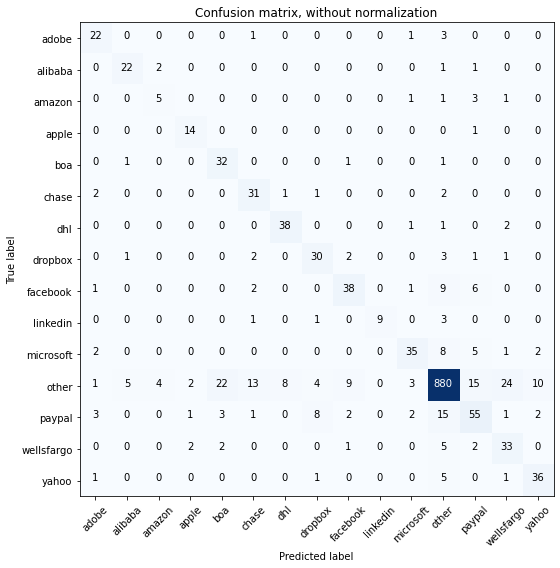

Acc     =  0.832
Pre     =  0.848
Rec     =  0.832
F1      =  0.836

Bal_Acc =  0.763
Bal_Pre =  0.705
Bal_Rec =  0.763
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.76      0.85      0.80        26
      amazon       0.45      0.45      0.45        11
       apple       0.74      0.93      0.82        15
         boa       0.54      0.91      0.68        35
       chase       0.61      0.84      0.70        37
         dhl       0.81      0.90      0.85        42
     dropbox       0.67      0.75      0.71        40
    facebook       0.72      0.67      0.69        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.80      0.66      0.72        53
       other       0.94      0.88      0.91      1000
      paypal       0.62      0.59      0.60        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.72      0.82      0.77        

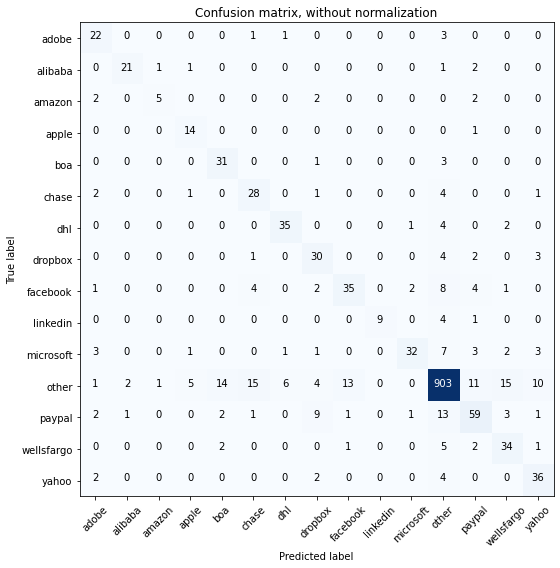

Acc     =  0.841
Pre     =  0.854
Rec     =  0.841
F1      =  0.843

Bal_Acc =  0.747
Bal_Pre =  0.726
Bal_Rec =  0.747
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.71      0.45      0.56        11
       apple       0.64      0.93      0.76        15
         boa       0.63      0.89      0.74        35
       chase       0.56      0.76      0.64        37
         dhl       0.81      0.83      0.82        42
     dropbox       0.58      0.75      0.65        40
    facebook       0.70      0.61      0.65        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.89      0.60      0.72        53
       other       0.94      0.90      0.92      1000
      paypal       0.68      0.63      0.66        93
  wellsfargo       0.60      0.76      0.67        45
       yahoo       0.65      0.82      0.73        

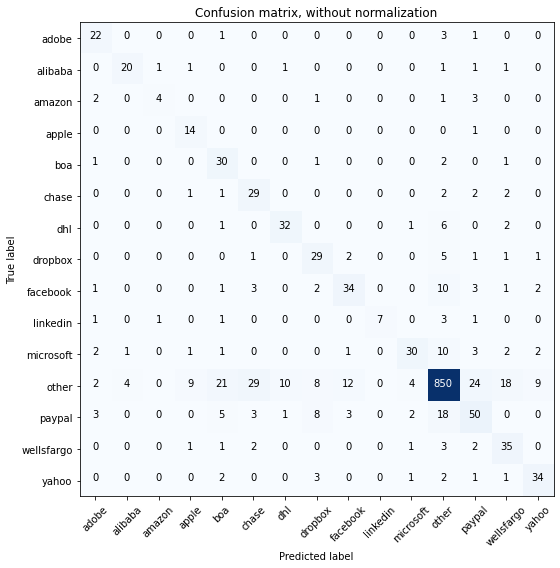

Acc     =  0.793
Pre     =  0.821
Rec     =  0.793
F1      =  0.8

Bal_Acc =  0.707
Bal_Pre =  0.664
Bal_Rec =  0.707
Bal_F1  =  0.685

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.80      0.77      0.78        26
      amazon       0.67      0.36      0.47        11
       apple       0.52      0.93      0.67        15
         boa       0.46      0.86      0.60        35
       chase       0.43      0.78      0.56        37
         dhl       0.73      0.76      0.74        42
     dropbox       0.56      0.72      0.63        40
    facebook       0.65      0.60      0.62        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.77      0.57      0.65        53
       other       0.93      0.85      0.89      1000
      paypal       0.54      0.54      0.54        93
  wellsfargo       0.55      0.78      0.64        45
       yahoo       0.71      0.77      0.74        44

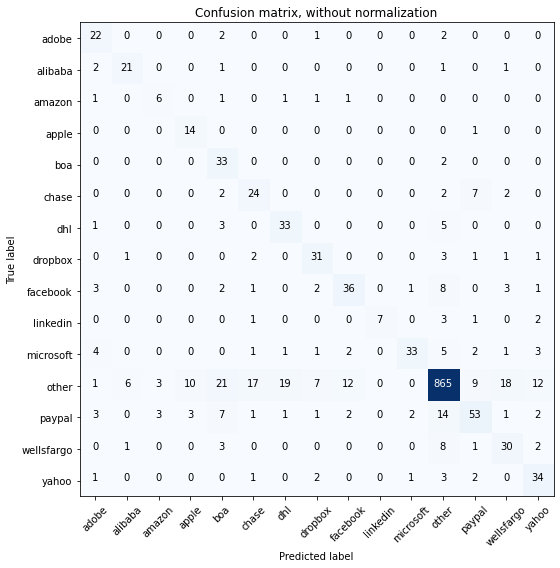

Acc     =  0.807
Pre     =  0.836
Rec     =  0.807
F1      =  0.814

Bal_Acc =  0.725
Bal_Pre =  0.657
Bal_Rec =  0.725
Bal_F1  =  0.689

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        27
     alibaba       0.72      0.81      0.76        26
      amazon       0.50      0.55      0.52        11
       apple       0.52      0.93      0.67        15
         boa       0.44      0.94      0.60        35
       chase       0.50      0.65      0.56        37
         dhl       0.60      0.79      0.68        42
     dropbox       0.67      0.78      0.72        40
    facebook       0.68      0.63      0.65        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.89      0.62      0.73        53
       other       0.94      0.86      0.90      1000
      paypal       0.69      0.57      0.62        93
  wellsfargo       0.53      0.67      0.59        45
       yahoo       0.60      0.77      0.67        

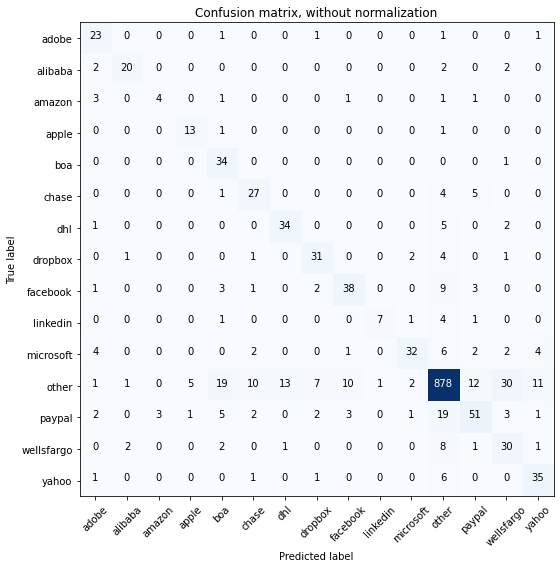

Acc     =  0.817
Pre     =  0.836
Rec     =  0.817
F1      =  0.821

Bal_Acc =  0.72
Bal_Pre =  0.689
Bal_Rec =  0.72
Bal_F1  =  0.704

              precision    recall  f1-score   support

       adobe       0.61      0.85      0.71        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.57      0.36      0.44        11
       apple       0.68      0.87      0.76        15
         boa       0.50      0.97      0.66        35
       chase       0.61      0.73      0.67        37
         dhl       0.71      0.81      0.76        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.72      0.67      0.69        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.84      0.60      0.70        53
       other       0.93      0.88      0.90      1000
      paypal       0.67      0.55      0.60        93
  wellsfargo       0.42      0.67      0.52        45
       yahoo       0.66      0.80      0.72        44

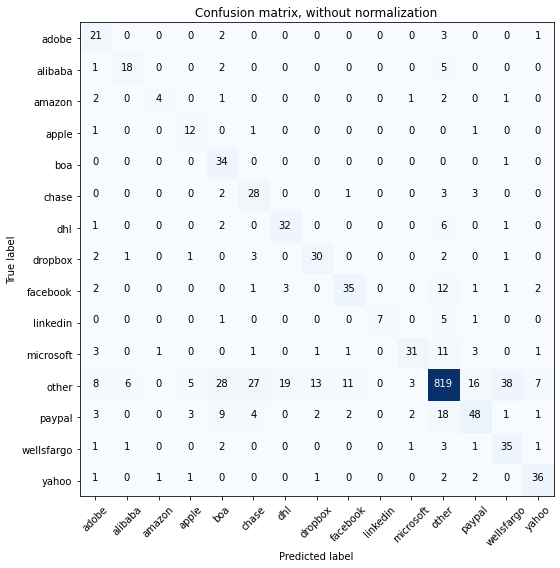

Acc     =  0.773
Pre     =  0.815
Rec     =  0.773
F1      =  0.783

Bal_Acc =  0.7
Bal_Pre =  0.645
Bal_Rec =  0.7
Bal_F1  =  0.671

              precision    recall  f1-score   support

       adobe       0.46      0.78      0.58        27
     alibaba       0.69      0.69      0.69        26
      amazon       0.67      0.36      0.47        11
       apple       0.55      0.80      0.65        15
         boa       0.41      0.97      0.58        35
       chase       0.43      0.76      0.55        37
         dhl       0.59      0.76      0.67        42
     dropbox       0.64      0.75      0.69        40
    facebook       0.70      0.61      0.65        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.92      0.82      0.87      1000
      paypal       0.63      0.52      0.57        93
  wellsfargo       0.44      0.78      0.56        45
       yahoo       0.73      0.82      0.77        44



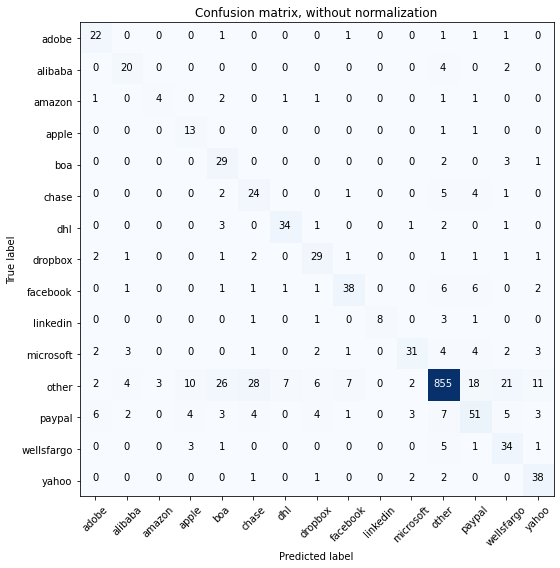

Acc     =  0.799
Pre     =  0.836
Rec     =  0.799
F1      =  0.81

Bal_Acc =  0.711
Bal_Pre =  0.647
Bal_Rec =  0.711
Bal_F1  =  0.677

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.65      0.77      0.70        26
      amazon       0.57      0.36      0.44        11
       apple       0.43      0.87      0.58        15
         boa       0.42      0.83      0.56        35
       chase       0.39      0.65      0.48        37
         dhl       0.79      0.81      0.80        42
     dropbox       0.63      0.72      0.67        40
    facebook       0.76      0.67      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.58      0.67        53
       other       0.95      0.85      0.90      1000
      paypal       0.57      0.55      0.56        93
  wellsfargo       0.48      0.76      0.59        45
       yahoo       0.63      0.86      0.73        4

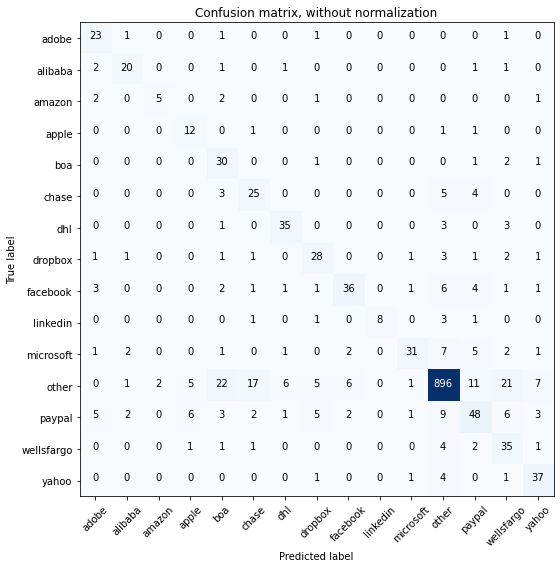

Acc     =  0.825
Pre     =  0.85
Rec     =  0.825
F1      =  0.831

Bal_Acc =  0.717
Bal_Pre =  0.687
Bal_Rec =  0.717
Bal_F1  =  0.702

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       0.74      0.77      0.75        26
      amazon       0.71      0.45      0.56        11
       apple       0.50      0.80      0.62        15
         boa       0.44      0.86      0.58        35
       chase       0.51      0.68      0.58        37
         dhl       0.78      0.83      0.80        42
     dropbox       0.64      0.70      0.67        40
    facebook       0.78      0.63      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.58      0.70        53
       other       0.95      0.90      0.92      1000
      paypal       0.61      0.52      0.56        93
  wellsfargo       0.47      0.78      0.58        45
       yahoo       0.70      0.84      0.76        4

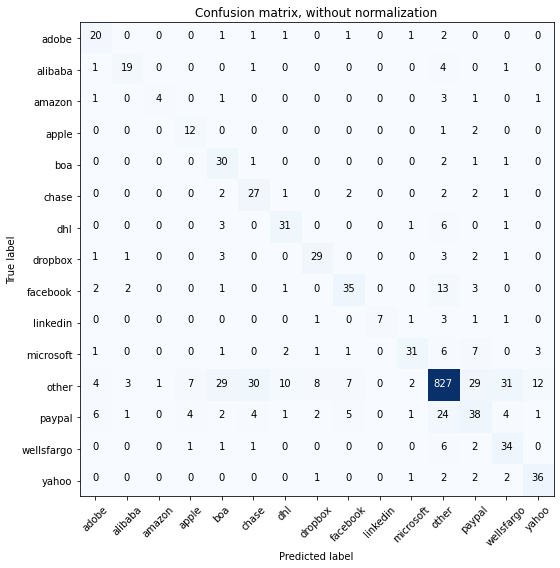

Acc     =  0.767
Pre     =  0.803
Rec     =  0.767
F1      =  0.776

Bal_Acc =  0.68
Bal_Pre =  0.648
Bal_Rec =  0.68
Bal_F1  =  0.664

              precision    recall  f1-score   support

       adobe       0.56      0.74      0.63        27
     alibaba       0.73      0.73      0.73        26
      amazon       0.80      0.36      0.50        11
       apple       0.50      0.80      0.62        15
         boa       0.41      0.86      0.55        35
       chase       0.42      0.73      0.53        37
         dhl       0.66      0.74      0.70        42
     dropbox       0.69      0.72      0.71        40
    facebook       0.69      0.61      0.65        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.91      0.83      0.87      1000
      paypal       0.42      0.41      0.42        93
  wellsfargo       0.44      0.76      0.56        45
       yahoo       0.68      0.82      0.74        44

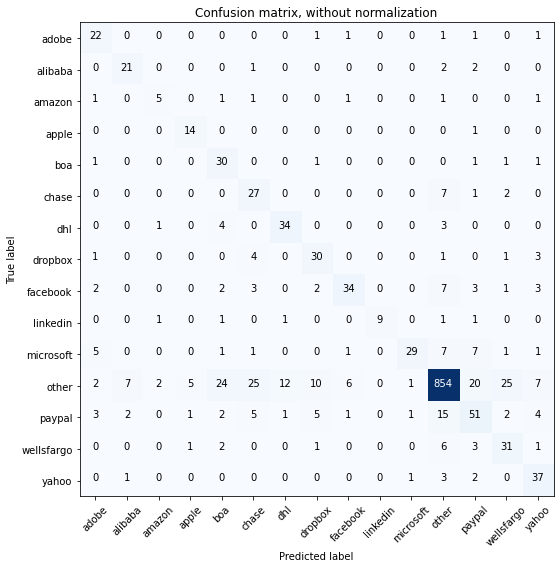

Acc     =  0.798
Pre     =  0.832
Rec     =  0.798
F1      =  0.807

Bal_Acc =  0.725
Bal_Pre =  0.662
Bal_Rec =  0.725
Bal_F1  =  0.692

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       0.68      0.81      0.74        26
      amazon       0.56      0.45      0.50        11
       apple       0.67      0.93      0.78        15
         boa       0.45      0.86      0.59        35
       chase       0.40      0.73      0.52        37
         dhl       0.71      0.81      0.76        42
     dropbox       0.60      0.75      0.67        40
    facebook       0.77      0.60      0.67        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.91      0.55      0.68        53
       other       0.94      0.85      0.90      1000
      paypal       0.55      0.55      0.55        93
  wellsfargo       0.48      0.69      0.57        45
       yahoo       0.63      0.84      0.72        

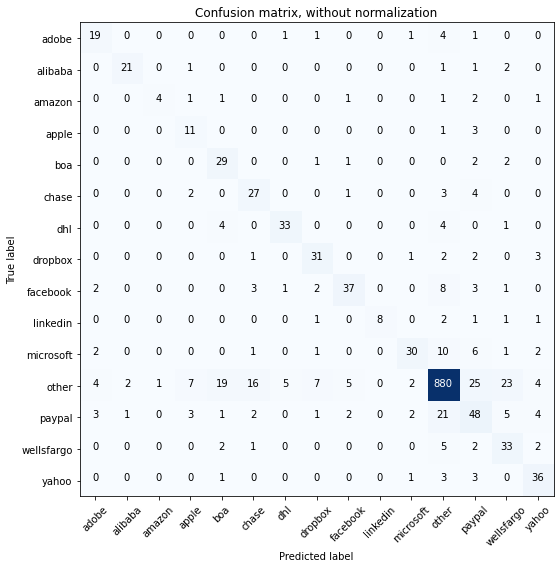

Acc     =  0.81
Pre     =  0.833
Rec     =  0.81
F1      =  0.816

Bal_Acc =  0.697
Bal_Pre =  0.697
Bal_Rec =  0.697
Bal_F1  =  0.697

              precision    recall  f1-score   support

       adobe       0.63      0.70      0.67        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.80      0.36      0.50        11
       apple       0.44      0.73      0.55        15
         boa       0.51      0.83      0.63        35
       chase       0.53      0.73      0.61        37
         dhl       0.82      0.79      0.80        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.79      0.65      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.57      0.67        53
       other       0.93      0.88      0.90      1000
      paypal       0.47      0.52      0.49        93
  wellsfargo       0.48      0.73      0.58        45
       yahoo       0.68      0.82      0.74        44

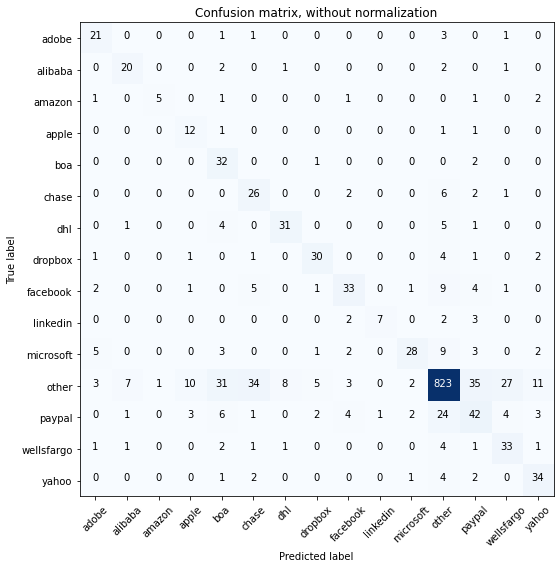

Acc     =  0.765
Pre     =  0.807
Rec     =  0.765
F1      =  0.776

Bal_Acc =  0.686
Bal_Pre =  0.644
Bal_Rec =  0.686
Bal_F1  =  0.664

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        27
     alibaba       0.67      0.77      0.71        26
      amazon       0.83      0.45      0.59        11
       apple       0.44      0.80      0.57        15
         boa       0.38      0.91      0.54        35
       chase       0.37      0.70      0.48        37
         dhl       0.76      0.74      0.75        42
     dropbox       0.75      0.75      0.75        40
    facebook       0.70      0.58      0.63        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.82      0.53      0.64        53
       other       0.92      0.82      0.87      1000
      paypal       0.43      0.45      0.44        93
  wellsfargo       0.49      0.73      0.58        45
       yahoo       0.62      0.77      0.69        

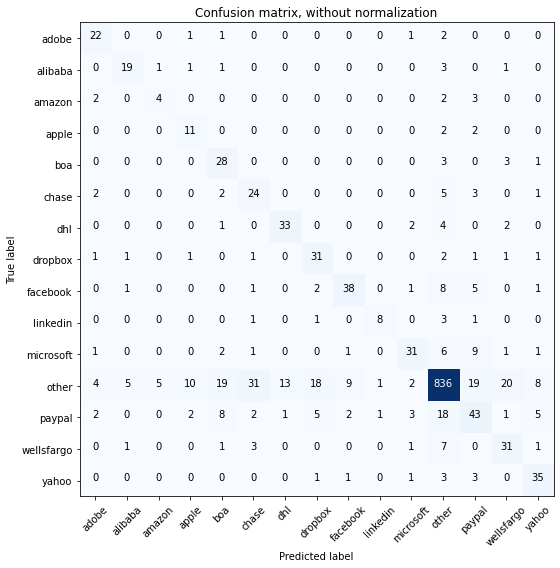

Acc     =  0.776
Pre     =  0.806
Rec     =  0.776
F1      =  0.785

Bal_Acc =  0.684
Bal_Pre =  0.606
Bal_Rec =  0.684
Bal_F1  =  0.643

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.70      0.73      0.72        26
      amazon       0.40      0.36      0.38        11
       apple       0.42      0.73      0.54        15
         boa       0.44      0.80      0.57        35
       chase       0.38      0.65      0.48        37
         dhl       0.70      0.79      0.74        42
     dropbox       0.53      0.78      0.63        40
    facebook       0.75      0.67      0.70        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.74      0.58      0.65        53
       other       0.92      0.84      0.88      1000
      paypal       0.48      0.46      0.47        93
  wellsfargo       0.52      0.69      0.59        45
       yahoo       0.65      0.80      0.71        

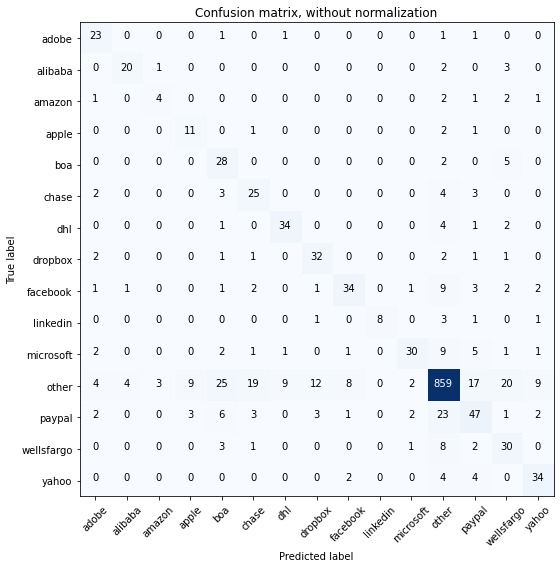

Acc     =  0.792
Pre     =  0.819
Rec     =  0.792
F1      =  0.799

Bal_Acc =  0.689
Bal_Pre =  0.656
Bal_Rec =  0.689
Bal_F1  =  0.672

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       0.80      0.77      0.78        26
      amazon       0.50      0.36      0.42        11
       apple       0.48      0.73      0.58        15
         boa       0.39      0.80      0.53        35
       chase       0.47      0.68      0.56        37
         dhl       0.76      0.81      0.78        42
     dropbox       0.65      0.80      0.72        40
    facebook       0.74      0.60      0.66        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.83      0.57      0.67        53
       other       0.92      0.86      0.89      1000
      paypal       0.54      0.51      0.52        93
  wellsfargo       0.45      0.67      0.54        45
       yahoo       0.68      0.77      0.72        

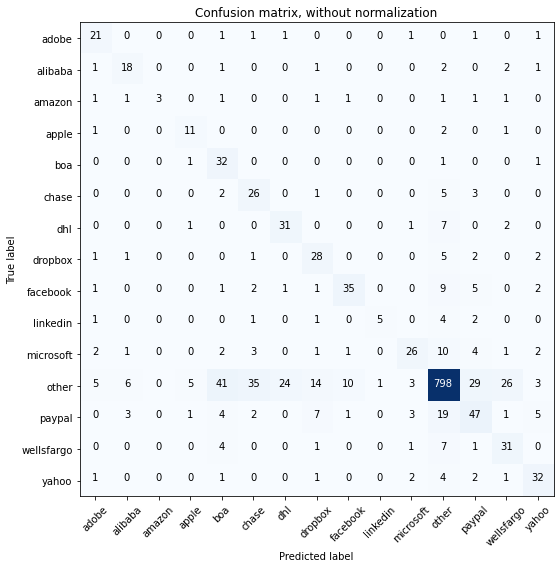

Acc     =  0.743
Pre     =  0.792
Rec     =  0.743
F1      =  0.756

Bal_Acc =  0.648
Bal_Pre =  0.621
Bal_Rec =  0.648
Bal_F1  =  0.634

              precision    recall  f1-score   support

       adobe       0.60      0.78      0.68        27
     alibaba       0.60      0.69      0.64        26
      amazon       1.00      0.27      0.43        11
       apple       0.58      0.73      0.65        15
         boa       0.36      0.91      0.51        35
       chase       0.37      0.70      0.48        37
         dhl       0.54      0.74      0.63        42
     dropbox       0.49      0.70      0.58        40
    facebook       0.73      0.61      0.67        57
    linkedin       0.83      0.36      0.50        14
   microsoft       0.70      0.49      0.58        53
       other       0.91      0.80      0.85      1000
      paypal       0.48      0.51      0.49        93
  wellsfargo       0.47      0.69      0.56        45
       yahoo       0.65      0.73      0.69        

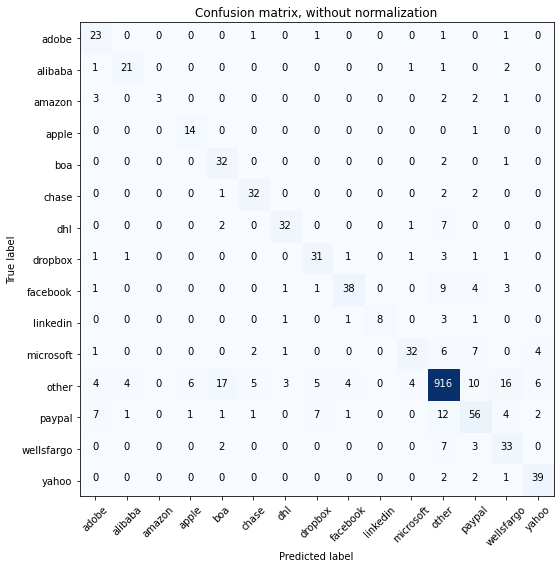

Acc     =  0.851
Pre     =  0.865
Rec     =  0.851
F1      =  0.853

Bal_Acc =  0.744
Bal_Pre =  0.762
Bal_Rec =  0.744
Bal_F1  =  0.753

              precision    recall  f1-score   support

       adobe       0.56      0.85      0.68        27
     alibaba       0.78      0.81      0.79        26
      amazon       1.00      0.27      0.43        11
       apple       0.67      0.93      0.78        15
         boa       0.58      0.91      0.71        35
       chase       0.78      0.86      0.82        37
         dhl       0.84      0.76      0.80        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.84      0.67      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.60      0.70        53
       other       0.94      0.92      0.93      1000
      paypal       0.63      0.60      0.62        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.76      0.89      0.82        

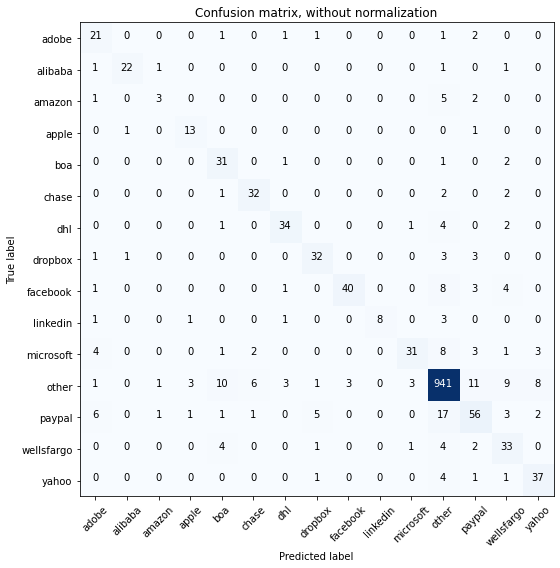

Acc     =  0.867
Pre     =  0.873
Rec     =  0.867
F1      =  0.866

Bal_Acc =  0.74
Bal_Pre =  0.762
Bal_Rec =  0.74
Bal_F1  =  0.751

              precision    recall  f1-score   support

       adobe       0.57      0.78      0.66        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.50      0.27      0.35        11
       apple       0.72      0.87      0.79        15
         boa       0.62      0.89      0.73        35
       chase       0.78      0.86      0.82        37
         dhl       0.83      0.81      0.82        42
     dropbox       0.78      0.80      0.79        40
    facebook       0.93      0.70      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.58      0.70        53
       other       0.94      0.94      0.94      1000
      paypal       0.67      0.60      0.63        93
  wellsfargo       0.57      0.73      0.64        45
       yahoo       0.74      0.84      0.79        44

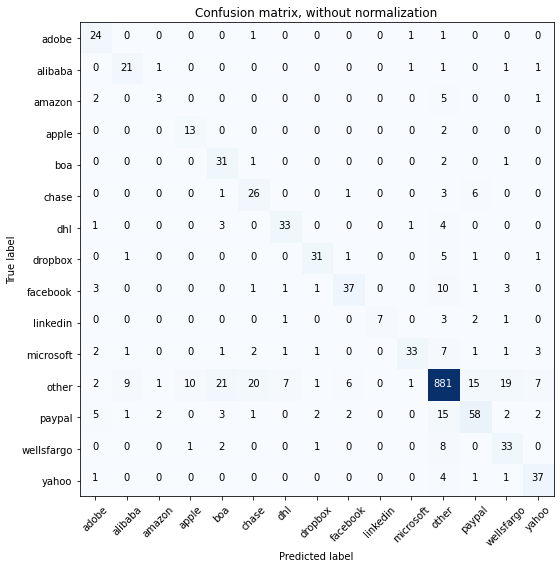

Acc     =  0.824
Pre     =  0.844
Rec     =  0.824
F1      =  0.828

Bal_Acc =  0.722
Bal_Pre =  0.69
Bal_Rec =  0.722
Bal_F1  =  0.706

              precision    recall  f1-score   support

       adobe       0.60      0.89      0.72        27
     alibaba       0.64      0.81      0.71        26
      amazon       0.43      0.27      0.33        11
       apple       0.54      0.87      0.67        15
         boa       0.50      0.89      0.64        35
       chase       0.50      0.70      0.58        37
         dhl       0.77      0.79      0.78        42
     dropbox       0.84      0.78      0.81        40
    facebook       0.79      0.65      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.89      0.62      0.73        53
       other       0.93      0.88      0.90      1000
      paypal       0.68      0.62      0.65        93
  wellsfargo       0.53      0.73      0.62        45
       yahoo       0.71      0.84      0.77        4

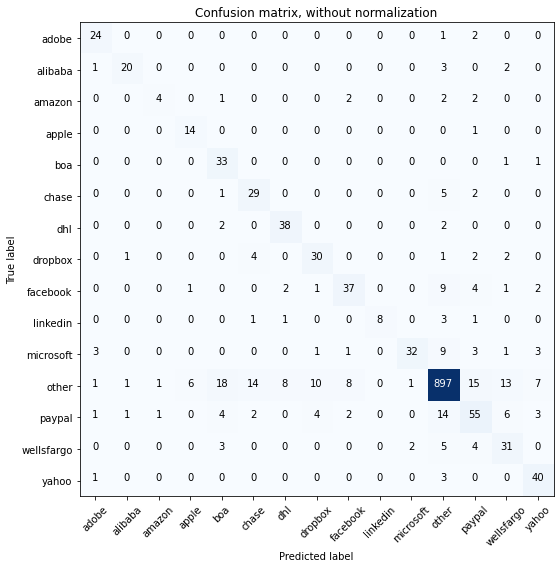

Acc     =  0.84
Pre     =  0.855
Rec     =  0.84
F1      =  0.842

Bal_Acc =  0.75
Bal_Pre =  0.732
Bal_Rec =  0.75
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.77      0.89      0.83        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.67      0.36      0.47        11
       apple       0.67      0.93      0.78        15
         boa       0.53      0.94      0.68        35
       chase       0.58      0.78      0.67        37
         dhl       0.78      0.90      0.84        42
     dropbox       0.65      0.75      0.70        40
    facebook       0.74      0.65      0.69        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.91      0.60      0.73        53
       other       0.94      0.90      0.92      1000
      paypal       0.60      0.59      0.60        93
  wellsfargo       0.54      0.69      0.61        45
       yahoo       0.71      0.91      0.80        44



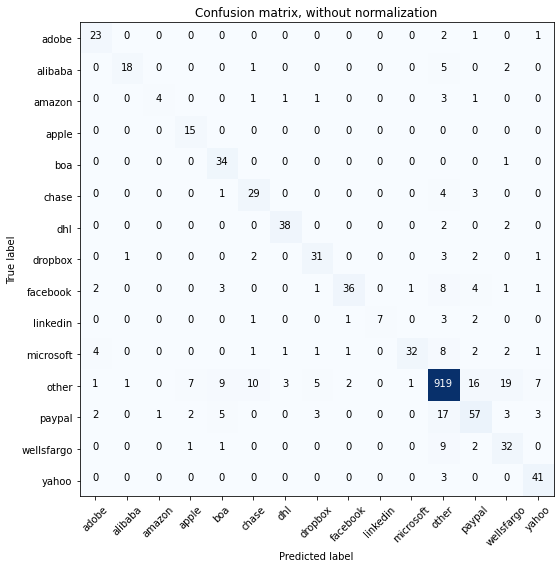

Acc     =  0.855
Pre     =  0.868
Rec     =  0.855
F1      =  0.855

Bal_Acc =  0.75
Bal_Pre =  0.773
Bal_Rec =  0.75
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.90      0.69      0.78        26
      amazon       0.80      0.36      0.50        11
       apple       0.60      1.00      0.75        15
         boa       0.64      0.97      0.77        35
       chase       0.64      0.78      0.71        37
         dhl       0.88      0.90      0.89        42
     dropbox       0.74      0.78      0.76        40
    facebook       0.90      0.63      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.94      0.60      0.74        53
       other       0.93      0.92      0.93      1000
      paypal       0.63      0.61      0.62        93
  wellsfargo       0.52      0.71      0.60        45
       yahoo       0.75      0.93      0.83        44

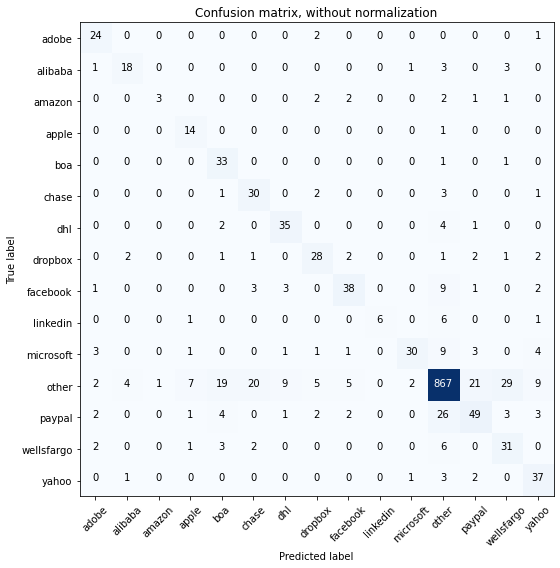

Acc     =  0.808
Pre     =  0.831
Rec     =  0.808
F1      =  0.811

Bal_Acc =  0.711
Bal_Pre =  0.693
Bal_Rec =  0.711
Bal_F1  =  0.702

              precision    recall  f1-score   support

       adobe       0.69      0.89      0.77        27
     alibaba       0.72      0.69      0.71        26
      amazon       0.75      0.27      0.40        11
       apple       0.56      0.93      0.70        15
         boa       0.52      0.94      0.67        35
       chase       0.54      0.81      0.65        37
         dhl       0.71      0.83      0.77        42
     dropbox       0.67      0.70      0.68        40
    facebook       0.76      0.67      0.71        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.88      0.57      0.69        53
       other       0.92      0.87      0.89      1000
      paypal       0.61      0.53      0.57        93
  wellsfargo       0.45      0.69      0.54        45
       yahoo       0.62      0.84      0.71        

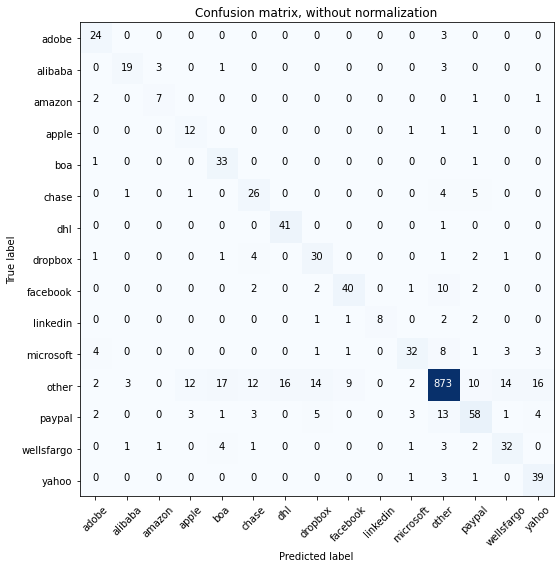

Acc     =  0.828
Pre     =  0.849
Rec     =  0.828
F1      =  0.833

Bal_Acc =  0.76
Bal_Pre =  0.691
Bal_Rec =  0.76
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.79      0.73      0.76        26
      amazon       0.64      0.64      0.64        11
       apple       0.43      0.80      0.56        15
         boa       0.58      0.94      0.72        35
       chase       0.54      0.70      0.61        37
         dhl       0.72      0.98      0.83        42
     dropbox       0.57      0.75      0.65        40
    facebook       0.78      0.70      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.60      0.68        53
       other       0.94      0.87      0.91      1000
      paypal       0.67      0.62      0.65        93
  wellsfargo       0.63      0.71      0.67        45
       yahoo       0.62      0.89      0.73        44

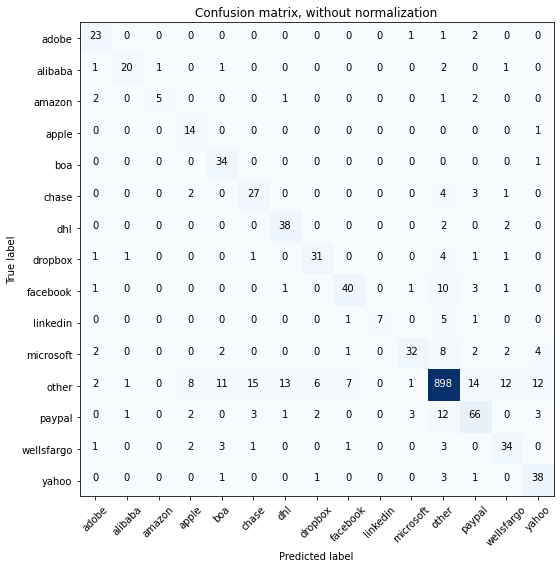

Acc     =  0.849
Pre     =  0.865
Rec     =  0.849
F1      =  0.852

Bal_Acc =  0.761
Bal_Pre =  0.744
Bal_Rec =  0.761
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.83      0.45      0.59        11
       apple       0.50      0.93      0.65        15
         boa       0.65      0.97      0.78        35
       chase       0.57      0.73      0.64        37
         dhl       0.70      0.90      0.79        42
     dropbox       0.78      0.78      0.78        40
    facebook       0.80      0.70      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.60      0.70        53
       other       0.94      0.90      0.92      1000
      paypal       0.69      0.71      0.70        93
  wellsfargo       0.63      0.76      0.69        45
       yahoo       0.64      0.86      0.74        

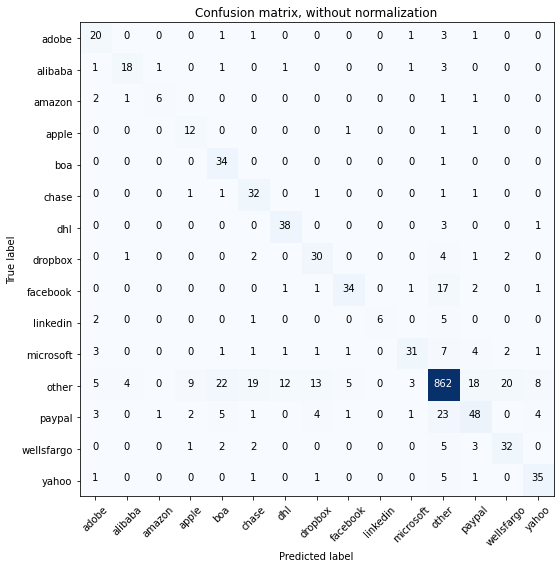

Acc     =  0.804
Pre     =  0.826
Rec     =  0.804
F1      =  0.808

Bal_Acc =  0.718
Bal_Pre =  0.685
Bal_Rec =  0.718
Bal_F1  =  0.701

              precision    recall  f1-score   support

       adobe       0.54      0.74      0.62        27
     alibaba       0.75      0.69      0.72        26
      amazon       0.75      0.55      0.63        11
       apple       0.48      0.80      0.60        15
         boa       0.51      0.97      0.67        35
       chase       0.53      0.86      0.66        37
         dhl       0.72      0.90      0.80        42
     dropbox       0.59      0.75      0.66        40
    facebook       0.81      0.60      0.69        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.82      0.58      0.68        53
       other       0.92      0.86      0.89      1000
      paypal       0.59      0.52      0.55        93
  wellsfargo       0.57      0.71      0.63        45
       yahoo       0.70      0.80      0.74        

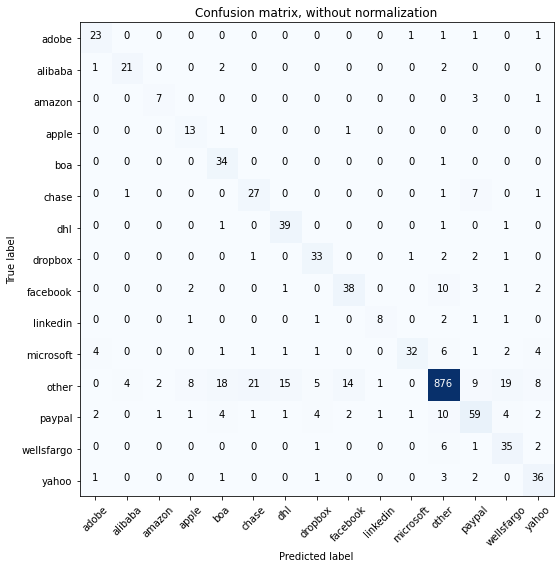

Acc     =  0.832
Pre     =  0.856
Rec     =  0.832
F1      =  0.838

Bal_Acc =  0.771
Bal_Pre =  0.696
Bal_Rec =  0.771
Bal_F1  =  0.732

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.70      0.64      0.67        11
       apple       0.52      0.87      0.65        15
         boa       0.55      0.97      0.70        35
       chase       0.53      0.73      0.61        37
         dhl       0.68      0.93      0.79        42
     dropbox       0.72      0.82      0.77        40
    facebook       0.69      0.67      0.68        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.91      0.60      0.73        53
       other       0.95      0.88      0.91      1000
      paypal       0.66      0.63      0.65        93
  wellsfargo       0.55      0.78      0.64        45
       yahoo       0.63      0.82      0.71        

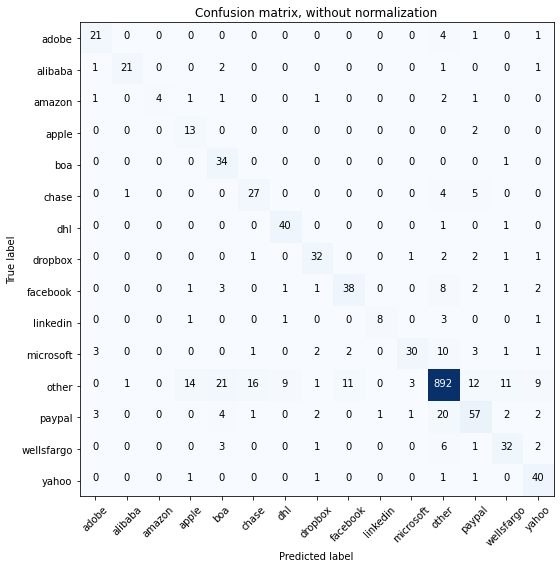

Acc     =  0.838
Pre     =  0.857
Rec     =  0.838
F1      =  0.841

Bal_Acc =  0.747
Bal_Pre =  0.74
Bal_Rec =  0.747
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        27
     alibaba       0.91      0.81      0.86        26
      amazon       1.00      0.36      0.53        11
       apple       0.42      0.87      0.57        15
         boa       0.50      0.97      0.66        35
       chase       0.59      0.73      0.65        37
         dhl       0.78      0.95      0.86        42
     dropbox       0.78      0.80      0.79        40
    facebook       0.75      0.67      0.70        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.86      0.57      0.68        53
       other       0.94      0.89      0.91      1000
      paypal       0.66      0.61      0.63        93
  wellsfargo       0.64      0.71      0.67        45
       yahoo       0.67      0.91      0.77        4

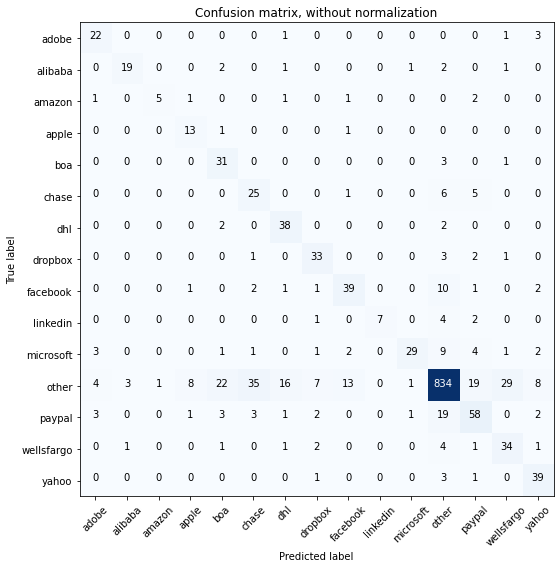

Acc     =  0.797
Pre     =  0.832
Rec     =  0.797
F1      =  0.805

Bal_Acc =  0.733
Bal_Pre =  0.691
Bal_Rec =  0.733
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.83      0.73      0.78        26
      amazon       0.83      0.45      0.59        11
       apple       0.54      0.87      0.67        15
         boa       0.49      0.89      0.63        35
       chase       0.37      0.68      0.48        37
         dhl       0.63      0.90      0.75        42
     dropbox       0.69      0.82      0.75        40
    facebook       0.68      0.68      0.68        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.91      0.55      0.68        53
       other       0.93      0.83      0.88      1000
      paypal       0.61      0.62      0.62        93
  wellsfargo       0.50      0.76      0.60        45
       yahoo       0.68      0.89      0.77        

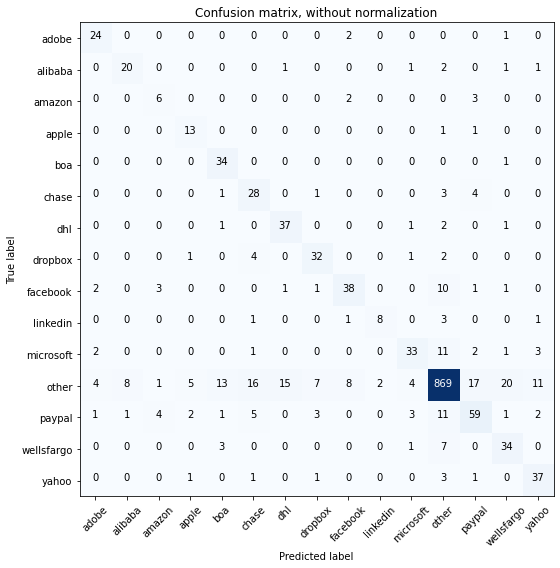

Acc     =  0.827
Pre     =  0.845
Rec     =  0.827
F1      =  0.831

Bal_Acc =  0.763
Bal_Pre =  0.674
Bal_Rec =  0.763
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.73      0.89      0.80        27
     alibaba       0.69      0.77      0.73        26
      amazon       0.43      0.55      0.48        11
       apple       0.59      0.87      0.70        15
         boa       0.64      0.97      0.77        35
       chase       0.50      0.76      0.60        37
         dhl       0.69      0.88      0.77        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.75      0.67      0.70        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.75      0.62      0.68        53
       other       0.94      0.87      0.90      1000
      paypal       0.67      0.63      0.65        93
  wellsfargo       0.56      0.76      0.64        45
       yahoo       0.67      0.84      0.75        

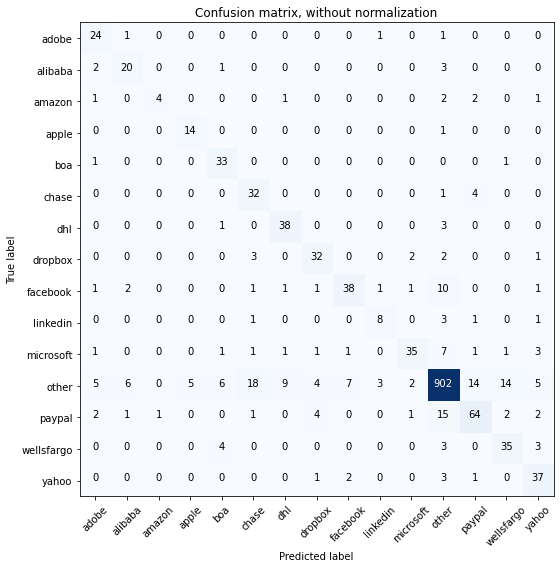

Acc     =  0.855
Pre     =  0.866
Rec     =  0.855
F1      =  0.857

Bal_Acc =  0.772
Bal_Pre =  0.728
Bal_Rec =  0.772
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.65      0.89      0.75        27
     alibaba       0.67      0.77      0.71        26
      amazon       0.80      0.36      0.50        11
       apple       0.74      0.93      0.82        15
         boa       0.72      0.94      0.81        35
       chase       0.56      0.86      0.68        37
         dhl       0.76      0.90      0.83        42
     dropbox       0.74      0.80      0.77        40
    facebook       0.79      0.67      0.72        57
    linkedin       0.62      0.57      0.59        14
   microsoft       0.85      0.66      0.74        53
       other       0.94      0.90      0.92      1000
      paypal       0.74      0.69      0.71        93
  wellsfargo       0.66      0.78      0.71        45
       yahoo       0.69      0.84      0.76        

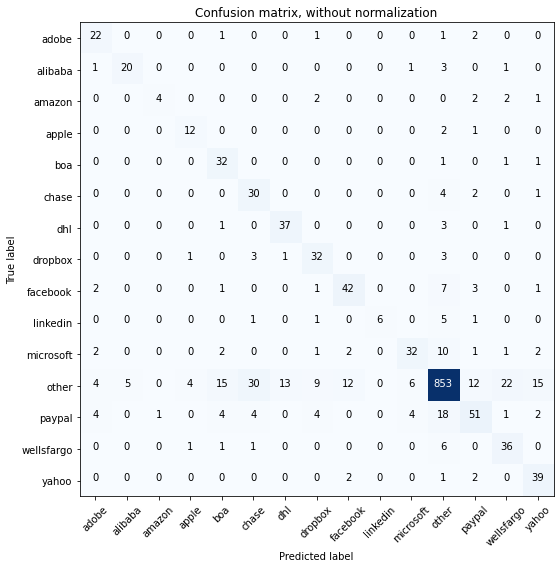

Acc     =  0.811
Pre     =  0.836
Rec     =  0.811
F1      =  0.816

Bal_Acc =  0.734
Bal_Pre =  0.699
Bal_Rec =  0.734
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.80      0.77      0.78        26
      amazon       0.80      0.36      0.50        11
       apple       0.67      0.80      0.73        15
         boa       0.56      0.91      0.70        35
       chase       0.43      0.81      0.57        37
         dhl       0.73      0.88      0.80        42
     dropbox       0.63      0.80      0.70        40
    facebook       0.72      0.74      0.73        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.74      0.60      0.67        53
       other       0.93      0.85      0.89      1000
      paypal       0.66      0.55      0.60        93
  wellsfargo       0.55      0.80      0.65        45
       yahoo       0.63      0.89      0.74        

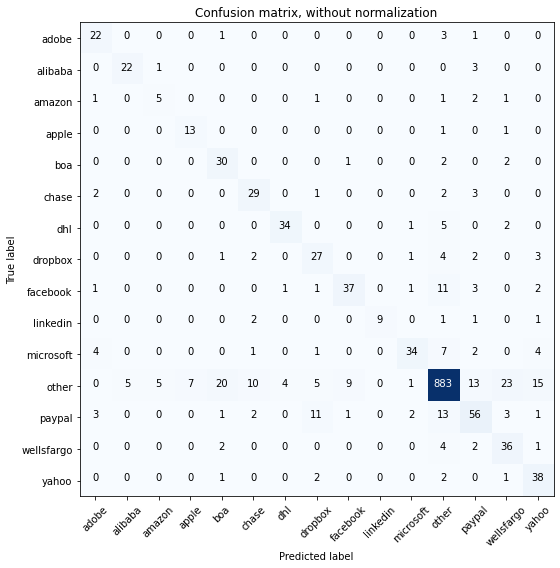

Acc     =  0.828
Pre     =  0.849
Rec     =  0.828
F1      =  0.834

Bal_Acc =  0.746
Bal_Pre =  0.699
Bal_Rec =  0.746
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.45      0.45      0.45        11
       apple       0.65      0.87      0.74        15
         boa       0.54      0.86      0.66        35
       chase       0.63      0.78      0.70        37
         dhl       0.87      0.81      0.84        42
     dropbox       0.55      0.68      0.61        40
    facebook       0.77      0.65      0.70        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.85      0.64      0.73        53
       other       0.94      0.88      0.91      1000
      paypal       0.64      0.60      0.62        93
  wellsfargo       0.52      0.80      0.63        45
       yahoo       0.58      0.86      0.70        

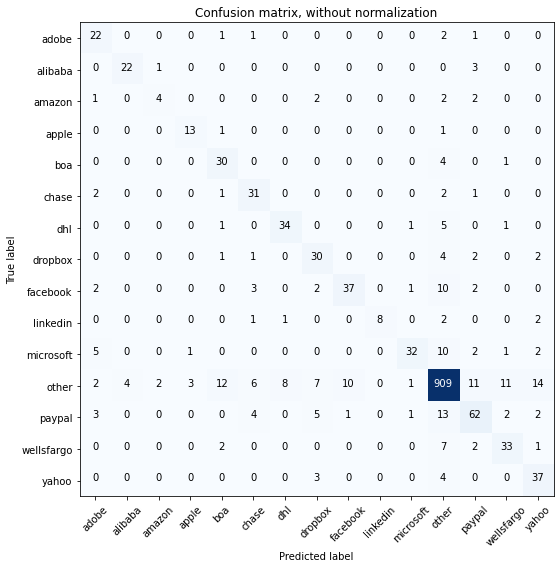

Acc     =  0.847
Pre     =  0.857
Rec     =  0.847
F1      =  0.849

Bal_Acc =  0.741
Bal_Pre =  0.736
Bal_Rec =  0.741
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.57      0.36      0.44        11
       apple       0.76      0.87      0.81        15
         boa       0.61      0.86      0.71        35
       chase       0.66      0.84      0.74        37
         dhl       0.79      0.81      0.80        42
     dropbox       0.61      0.75      0.67        40
    facebook       0.77      0.65      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.60      0.72        53
       other       0.93      0.91      0.92      1000
      paypal       0.70      0.67      0.69        93
  wellsfargo       0.67      0.73      0.70        45
       yahoo       0.62      0.84      0.71        

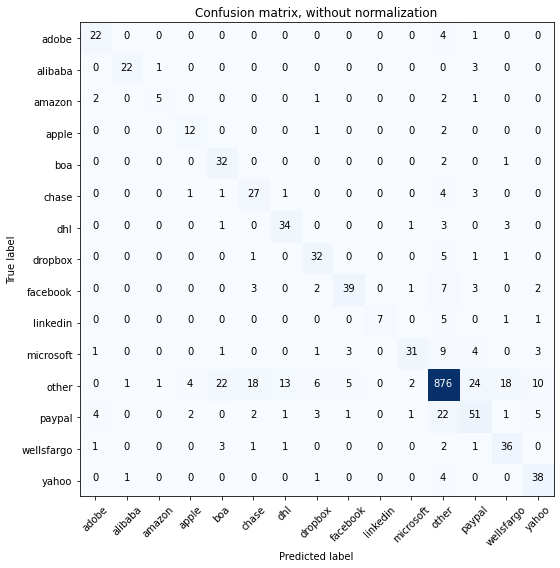

Acc     =  0.821
Pre     =  0.84
Rec     =  0.821
F1      =  0.825

Bal_Acc =  0.735
Bal_Pre =  0.72
Bal_Rec =  0.735
Bal_F1  =  0.727

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.71      0.45      0.56        11
       apple       0.63      0.80      0.71        15
         boa       0.53      0.91      0.67        35
       chase       0.52      0.73      0.61        37
         dhl       0.68      0.81      0.74        42
     dropbox       0.68      0.80      0.74        40
    facebook       0.81      0.68      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.58      0.70        53
       other       0.93      0.88      0.90      1000
      paypal       0.55      0.55      0.55        93
  wellsfargo       0.59      0.80      0.68        45
       yahoo       0.64      0.86      0.74        44

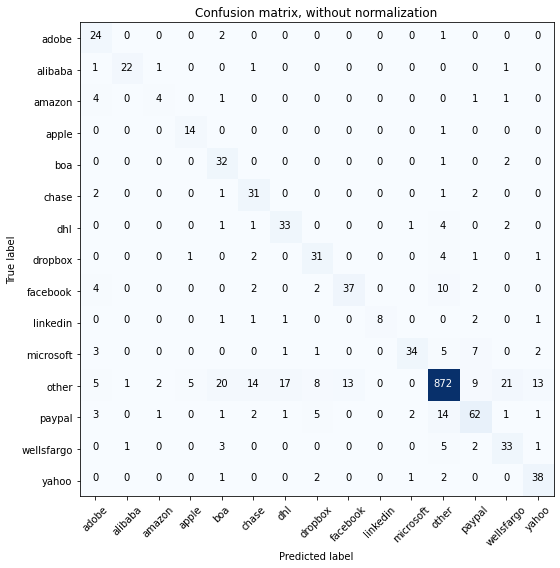

Acc     =  0.828
Pre     =  0.854
Rec     =  0.828
F1      =  0.835

Bal_Acc =  0.756
Bal_Pre =  0.698
Bal_Rec =  0.756
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.52      0.89      0.66        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.50      0.36      0.42        11
       apple       0.70      0.93      0.80        15
         boa       0.51      0.91      0.65        35
       chase       0.57      0.84      0.68        37
         dhl       0.62      0.79      0.69        42
     dropbox       0.63      0.78      0.70        40
    facebook       0.74      0.65      0.69        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.64      0.75        53
       other       0.95      0.87      0.91      1000
      paypal       0.70      0.67      0.69        93
  wellsfargo       0.54      0.73      0.62        45
       yahoo       0.67      0.86      0.75        

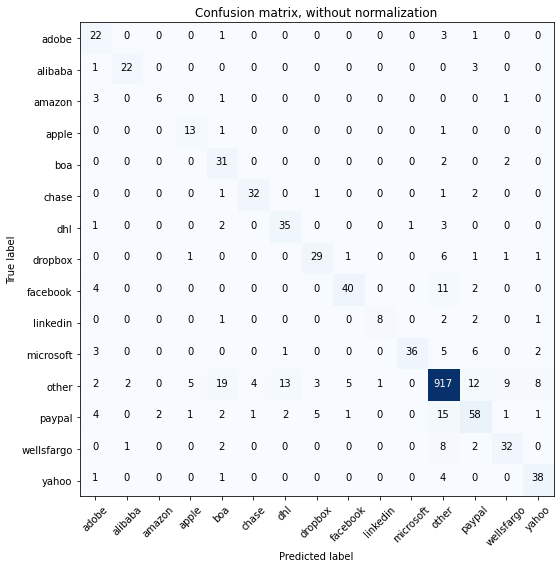

Acc     =  0.857
Pre     =  0.87
Rec     =  0.857
F1      =  0.86

Bal_Acc =  0.763
Bal_Pre =  0.758
Bal_Rec =  0.763
Bal_F1  =  0.76

              precision    recall  f1-score   support

       adobe       0.54      0.81      0.65        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.75      0.55      0.63        11
       apple       0.65      0.87      0.74        15
         boa       0.50      0.89      0.64        35
       chase       0.86      0.86      0.86        37
         dhl       0.69      0.83      0.75        42
     dropbox       0.76      0.72      0.74        40
    facebook       0.85      0.70      0.77        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.97      0.68      0.80        53
       other       0.94      0.92      0.93      1000
      paypal       0.65      0.62      0.64        93
  wellsfargo       0.70      0.71      0.70        45
       yahoo       0.75      0.86      0.80        44


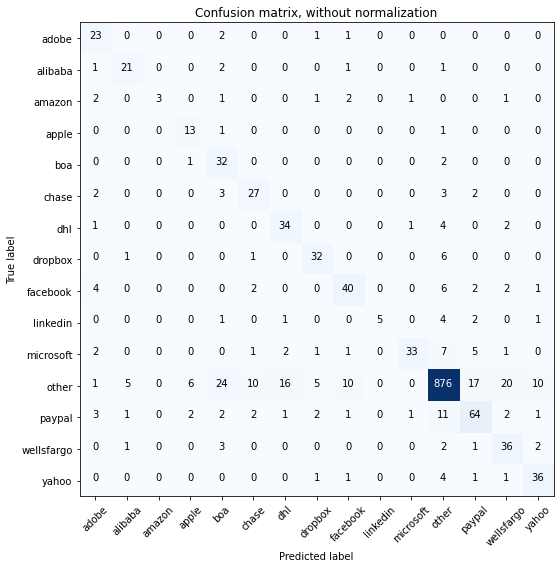

Acc     =  0.828
Pre     =  0.856
Rec     =  0.828
F1      =  0.834

Bal_Acc =  0.728
Bal_Pre =  0.724
Bal_Rec =  0.728
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.72      0.81      0.76        26
      amazon       1.00      0.27      0.43        11
       apple       0.59      0.87      0.70        15
         boa       0.45      0.91      0.60        35
       chase       0.63      0.73      0.68        37
         dhl       0.63      0.81      0.71        42
     dropbox       0.74      0.80      0.77        40
    facebook       0.70      0.70      0.70        57
    linkedin       1.00      0.36      0.53        14
   microsoft       0.92      0.62      0.74        53
       other       0.94      0.88      0.91      1000
      paypal       0.68      0.69      0.68        93
  wellsfargo       0.55      0.80      0.65        45
       yahoo       0.71      0.82      0.76        

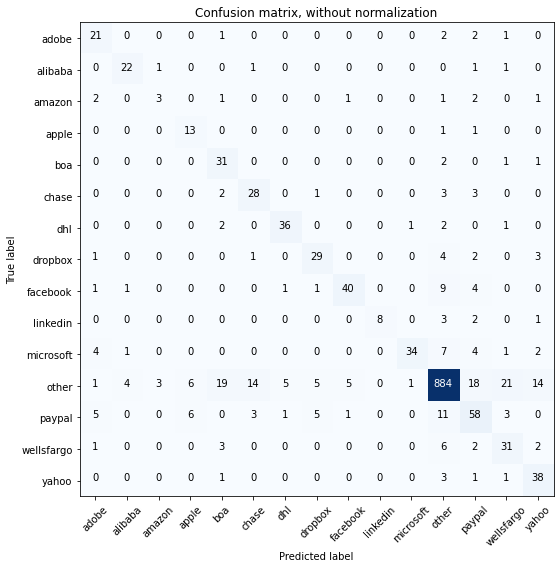

Acc     =  0.829
Pre     =  0.852
Rec     =  0.829
F1      =  0.835

Bal_Acc =  0.731
Bal_Pre =  0.694
Bal_Rec =  0.731
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.58      0.78      0.67        27
     alibaba       0.79      0.85      0.81        26
      amazon       0.43      0.27      0.33        11
       apple       0.52      0.87      0.65        15
         boa       0.52      0.89      0.65        35
       chase       0.60      0.76      0.67        37
         dhl       0.84      0.86      0.85        42
     dropbox       0.71      0.72      0.72        40
    facebook       0.85      0.70      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.94      0.64      0.76        53
       other       0.94      0.88      0.91      1000
      paypal       0.58      0.62      0.60        93
  wellsfargo       0.51      0.69      0.58        45
       yahoo       0.61      0.86      0.72        

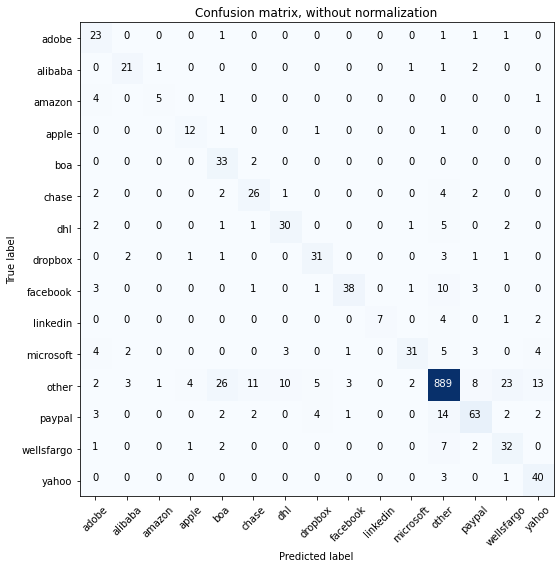

Acc     =  0.832
Pre     =  0.856
Rec     =  0.832
F1      =  0.837

Bal_Acc =  0.732
Bal_Pre =  0.715
Bal_Rec =  0.732
Bal_F1  =  0.723

              precision    recall  f1-score   support

       adobe       0.52      0.85      0.65        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.71      0.45      0.56        11
       apple       0.67      0.80      0.73        15
         boa       0.47      0.94      0.63        35
       chase       0.60      0.70      0.65        37
         dhl       0.68      0.71      0.70        42
     dropbox       0.74      0.78      0.76        40
    facebook       0.88      0.67      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.58      0.70        53
       other       0.94      0.89      0.91      1000
      paypal       0.74      0.68      0.71        93
  wellsfargo       0.51      0.71      0.59        45
       yahoo       0.65      0.91      0.75        

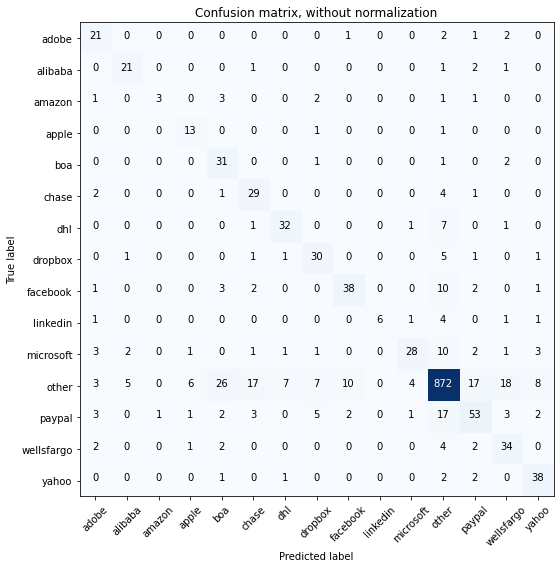

Acc     =  0.812
Pre     =  0.834
Rec     =  0.812
F1      =  0.816

Bal_Acc =  0.706
Bal_Pre =  0.69
Bal_Rec =  0.706
Bal_F1  =  0.698

              precision    recall  f1-score   support

       adobe       0.57      0.78      0.66        27
     alibaba       0.72      0.81      0.76        26
      amazon       0.75      0.27      0.40        11
       apple       0.59      0.87      0.70        15
         boa       0.45      0.89      0.60        35
       chase       0.53      0.78      0.63        37
         dhl       0.76      0.76      0.76        42
     dropbox       0.64      0.75      0.69        40
    facebook       0.75      0.67      0.70        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.80      0.53      0.64        53
       other       0.93      0.87      0.90      1000
      paypal       0.63      0.57      0.60        93
  wellsfargo       0.54      0.76      0.63        45
       yahoo       0.70      0.86      0.78        4

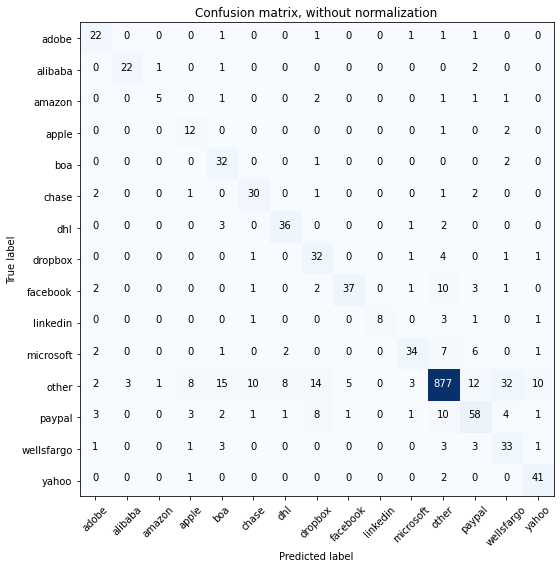

Acc     =  0.831
Pre     =  0.859
Rec     =  0.831
F1      =  0.838

Bal_Acc =  0.755
Bal_Pre =  0.71
Bal_Rec =  0.755
Bal_F1  =  0.732

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.71      0.45      0.56        11
       apple       0.46      0.80      0.59        15
         boa       0.54      0.91      0.68        35
       chase       0.68      0.81      0.74        37
         dhl       0.77      0.86      0.81        42
     dropbox       0.52      0.80      0.63        40
    facebook       0.86      0.65      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.64      0.72        53
       other       0.95      0.88      0.91      1000
      paypal       0.65      0.62      0.64        93
  wellsfargo       0.43      0.73      0.55        45
       yahoo       0.73      0.93      0.82        4

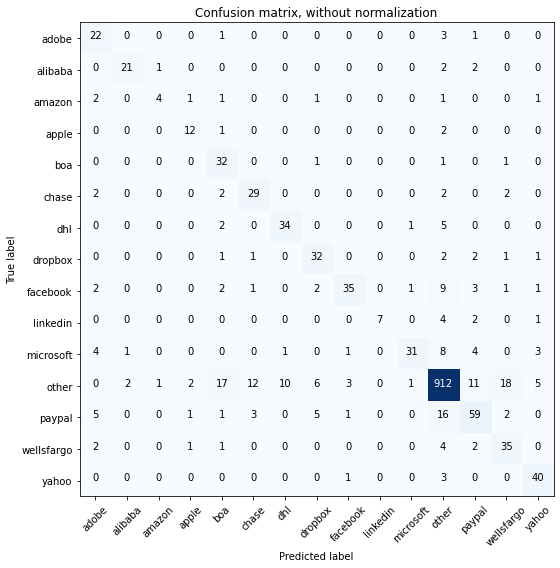

Acc     =  0.848
Pre     =  0.863
Rec     =  0.848
F1      =  0.85

Bal_Acc =  0.735
Bal_Pre =  0.743
Bal_Rec =  0.735
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.56      0.81      0.67        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.71      0.80      0.75        15
         boa       0.52      0.91      0.67        35
       chase       0.63      0.78      0.70        37
         dhl       0.76      0.81      0.78        42
     dropbox       0.68      0.80      0.74        40
    facebook       0.85      0.61      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.91      0.58      0.71        53
       other       0.94      0.91      0.92      1000
      paypal       0.69      0.63      0.66        93
  wellsfargo       0.58      0.78      0.67        45
       yahoo       0.77      0.91      0.83        4

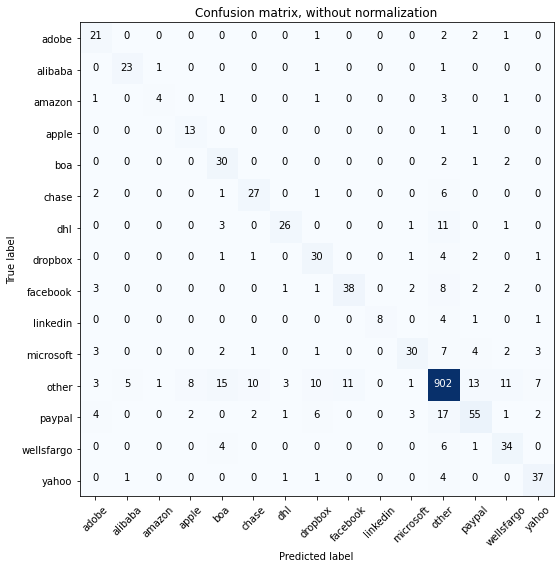

Acc     =  0.83
Pre     =  0.842
Rec     =  0.83
F1      =  0.832

Bal_Acc =  0.716
Bal_Pre =  0.711
Bal_Rec =  0.716
Bal_F1  =  0.713

              precision    recall  f1-score   support

       adobe       0.57      0.78      0.66        27
     alibaba       0.79      0.88      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.57      0.87      0.68        15
         boa       0.53      0.86      0.65        35
       chase       0.66      0.73      0.69        37
         dhl       0.81      0.62      0.70        42
     dropbox       0.57      0.75      0.65        40
    facebook       0.78      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.57      0.66        53
       other       0.92      0.90      0.91      1000
      paypal       0.67      0.59      0.63        93
  wellsfargo       0.62      0.76      0.68        45
       yahoo       0.73      0.84      0.78        44

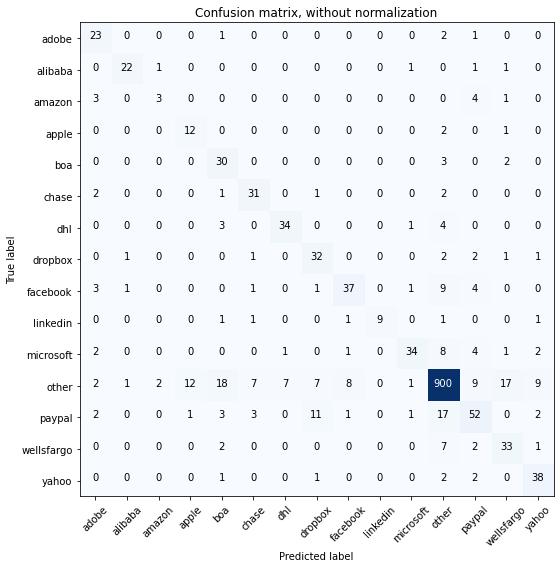

Acc     =  0.838
Pre     =  0.853
Rec     =  0.838
F1      =  0.841

Bal_Acc =  0.738
Bal_Pre =  0.707
Bal_Rec =  0.738
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.50      0.27      0.35        11
       apple       0.48      0.80      0.60        15
         boa       0.50      0.86      0.63        35
       chase       0.70      0.84      0.77        37
         dhl       0.81      0.81      0.81        42
     dropbox       0.60      0.80      0.69        40
    facebook       0.77      0.65      0.70        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.87      0.64      0.74        53
       other       0.94      0.90      0.92      1000
      paypal       0.64      0.56      0.60        93
  wellsfargo       0.58      0.73      0.65        45
       yahoo       0.70      0.86      0.78        

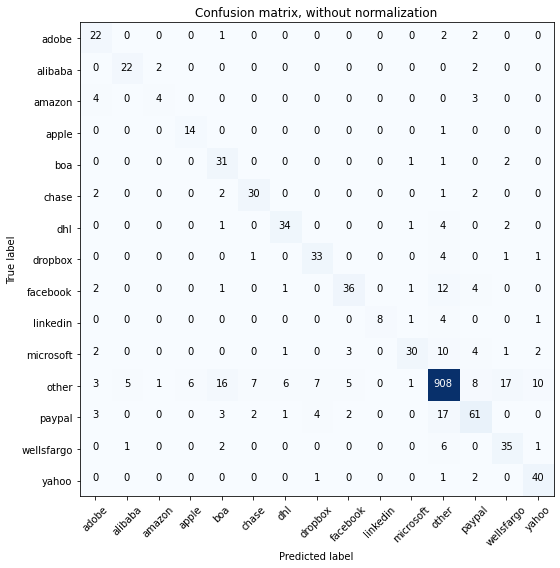

Acc     =  0.85
Pre     =  0.861
Rec     =  0.85
F1      =  0.851

Bal_Acc =  0.754
Bal_Pre =  0.737
Bal_Rec =  0.754
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        27
     alibaba       0.79      0.85      0.81        26
      amazon       0.57      0.36      0.44        11
       apple       0.70      0.93      0.80        15
         boa       0.54      0.89      0.67        35
       chase       0.75      0.81      0.78        37
         dhl       0.79      0.81      0.80        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.78      0.63      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.57      0.68        53
       other       0.94      0.91      0.92      1000
      paypal       0.69      0.66      0.67        93
  wellsfargo       0.60      0.78      0.68        45
       yahoo       0.73      0.91      0.81        44

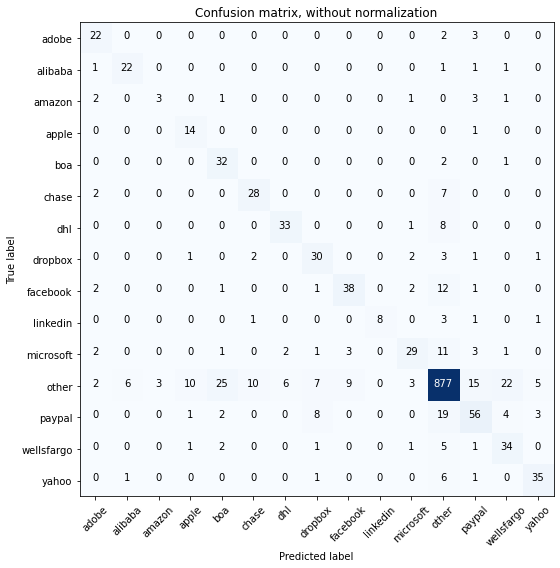

Acc     =  0.819
Pre     =  0.834
Rec     =  0.819
F1      =  0.822

Bal_Acc =  0.726
Bal_Pre =  0.695
Bal_Rec =  0.726
Bal_F1  =  0.71

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.76      0.85      0.80        26
      amazon       0.50      0.27      0.35        11
       apple       0.52      0.93      0.67        15
         boa       0.50      0.91      0.65        35
       chase       0.68      0.76      0.72        37
         dhl       0.80      0.79      0.80        42
     dropbox       0.61      0.75      0.67        40
    facebook       0.76      0.67      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.74      0.55      0.63        53
       other       0.92      0.88      0.90      1000
      paypal       0.64      0.60      0.62        93
  wellsfargo       0.53      0.76      0.62        45
       yahoo       0.78      0.80      0.79        4

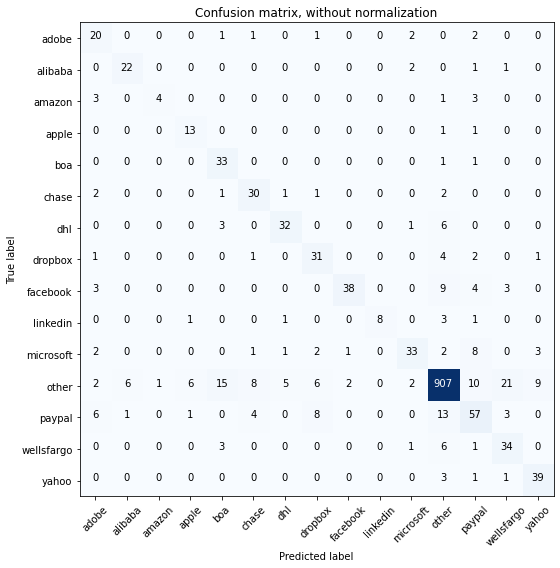

Acc     =  0.845
Pre     =  0.862
Rec     =  0.845
F1      =  0.849

Bal_Acc =  0.742
Bal_Pre =  0.731
Bal_Rec =  0.742
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.51      0.74      0.61        27
     alibaba       0.76      0.85      0.80        26
      amazon       0.80      0.36      0.50        11
       apple       0.62      0.87      0.72        15
         boa       0.59      0.94      0.73        35
       chase       0.67      0.81      0.73        37
         dhl       0.80      0.76      0.78        42
     dropbox       0.63      0.78      0.70        40
    facebook       0.93      0.67      0.78        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.62      0.70        53
       other       0.95      0.91      0.93      1000
      paypal       0.62      0.61      0.62        93
  wellsfargo       0.54      0.76      0.63        45
       yahoo       0.75      0.89      0.81        

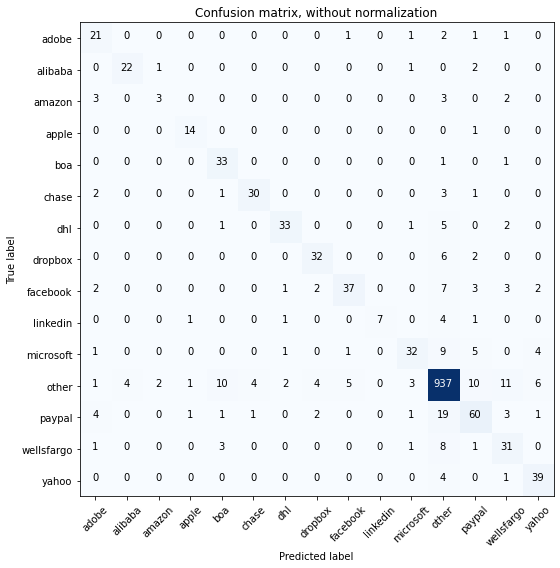

Acc     =  0.865
Pre     =  0.868
Rec     =  0.865
F1      =  0.863

Bal_Acc =  0.739
Bal_Pre =  0.769
Bal_Rec =  0.739
Bal_F1  =  0.754

              precision    recall  f1-score   support

       adobe       0.60      0.78      0.68        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.50      0.27      0.35        11
       apple       0.82      0.93      0.87        15
         boa       0.67      0.94      0.79        35
       chase       0.86      0.81      0.83        37
         dhl       0.87      0.79      0.82        42
     dropbox       0.80      0.80      0.80        40
    facebook       0.84      0.65      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.80      0.60      0.69        53
       other       0.93      0.94      0.93      1000
      paypal       0.69      0.65      0.67        93
  wellsfargo       0.56      0.69      0.62        45
       yahoo       0.75      0.89      0.81        

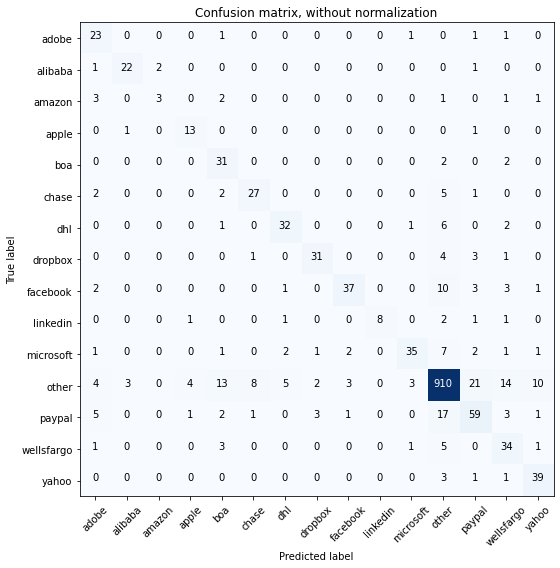

Acc     =  0.847
Pre     =  0.861
Rec     =  0.847
F1      =  0.85

Bal_Acc =  0.737
Bal_Pre =  0.741
Bal_Rec =  0.737
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.55      0.85      0.67        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.60      0.27      0.37        11
       apple       0.68      0.87      0.76        15
         boa       0.55      0.89      0.68        35
       chase       0.73      0.73      0.73        37
         dhl       0.78      0.76      0.77        42
     dropbox       0.84      0.78      0.81        40
    facebook       0.86      0.65      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.66      0.74        53
       other       0.94      0.91      0.92      1000
      paypal       0.63      0.63      0.63        93
  wellsfargo       0.53      0.76      0.62        45
       yahoo       0.72      0.89      0.80        4

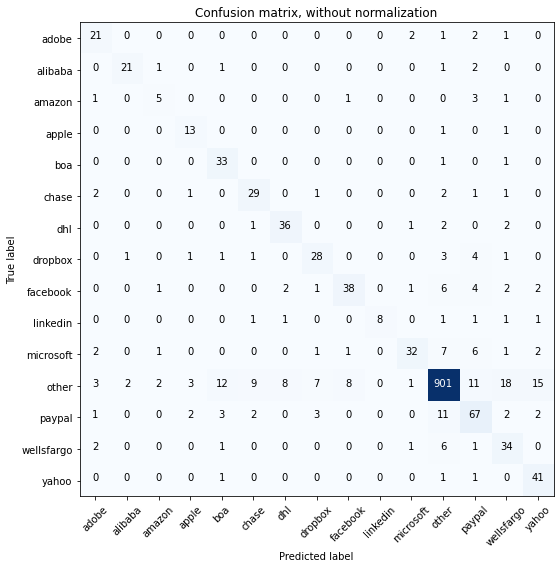

Acc     =  0.849
Pre     =  0.866
Rec     =  0.849
F1      =  0.853

Bal_Acc =  0.756
Bal_Pre =  0.723
Bal_Rec =  0.756
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.66      0.78      0.71        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.50      0.45      0.48        11
       apple       0.65      0.87      0.74        15
         boa       0.63      0.94      0.76        35
       chase       0.67      0.78      0.72        37
         dhl       0.77      0.86      0.81        42
     dropbox       0.68      0.70      0.69        40
    facebook       0.79      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.60      0.70        53
       other       0.95      0.90      0.93      1000
      paypal       0.65      0.72      0.68        93
  wellsfargo       0.52      0.76      0.61        45
       yahoo       0.65      0.93      0.77        

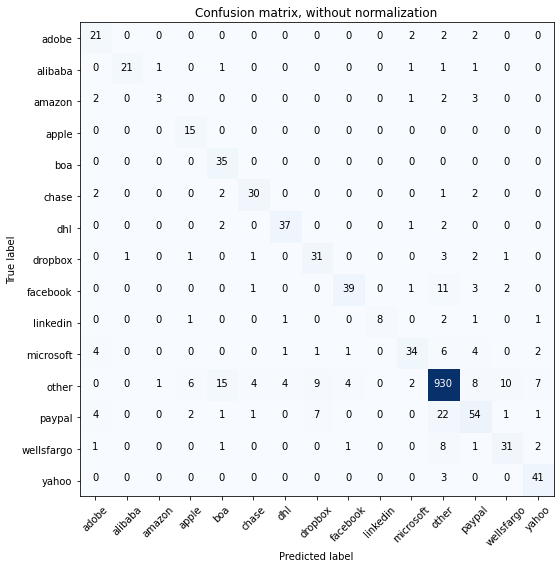

Acc     =  0.864
Pre     =  0.871
Rec     =  0.864
F1      =  0.863

Bal_Acc =  0.757
Bal_Pre =  0.762
Bal_Rec =  0.757
Bal_F1  =  0.759

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.60      0.27      0.37        11
       apple       0.60      1.00      0.75        15
         boa       0.61      1.00      0.76        35
       chase       0.81      0.81      0.81        37
         dhl       0.86      0.88      0.87        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.87      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.64      0.72        53
       other       0.94      0.93      0.93      1000
      paypal       0.67      0.58      0.62        93
  wellsfargo       0.69      0.69      0.69        45
       yahoo       0.76      0.93      0.84        

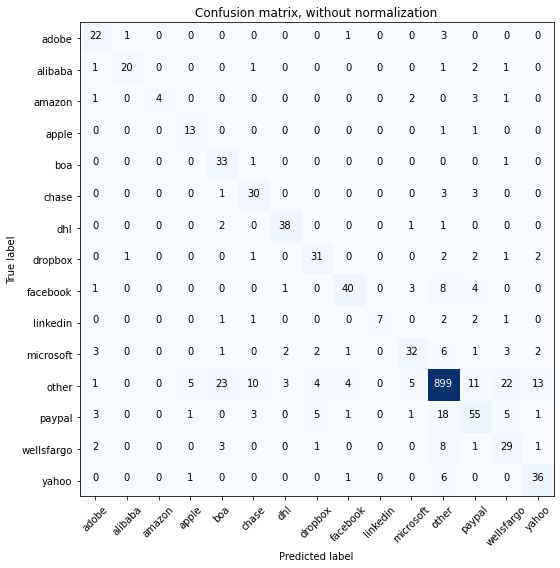

Acc     =  0.838
Pre     =  0.855
Rec     =  0.838
F1      =  0.841

Bal_Acc =  0.734
Bal_Pre =  0.747
Bal_Rec =  0.734
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.91      0.77      0.83        26
      amazon       1.00      0.36      0.53        11
       apple       0.65      0.87      0.74        15
         boa       0.52      0.94      0.67        35
       chase       0.64      0.81      0.71        37
         dhl       0.86      0.90      0.88        42
     dropbox       0.72      0.78      0.75        40
    facebook       0.83      0.70      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.73      0.60      0.66        53
       other       0.94      0.90      0.92      1000
      paypal       0.65      0.59      0.62        93
  wellsfargo       0.45      0.64      0.53        45
       yahoo       0.65      0.82      0.73        4

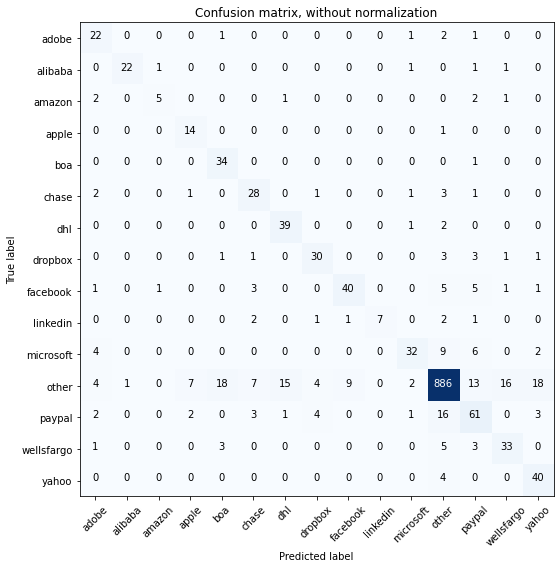

Acc     =  0.84
Pre     =  0.859
Rec     =  0.84
F1      =  0.844

Bal_Acc =  0.763
Bal_Pre =  0.729
Bal_Rec =  0.763
Bal_F1  =  0.746

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.71      0.45      0.56        11
       apple       0.58      0.93      0.72        15
         boa       0.60      0.97      0.74        35
       chase       0.64      0.76      0.69        37
         dhl       0.70      0.93      0.80        42
     dropbox       0.75      0.75      0.75        40
    facebook       0.80      0.70      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.60      0.70        53
       other       0.94      0.89      0.91      1000
      paypal       0.62      0.66      0.64        93
  wellsfargo       0.62      0.73      0.67        45
       yahoo       0.62      0.91      0.73        44

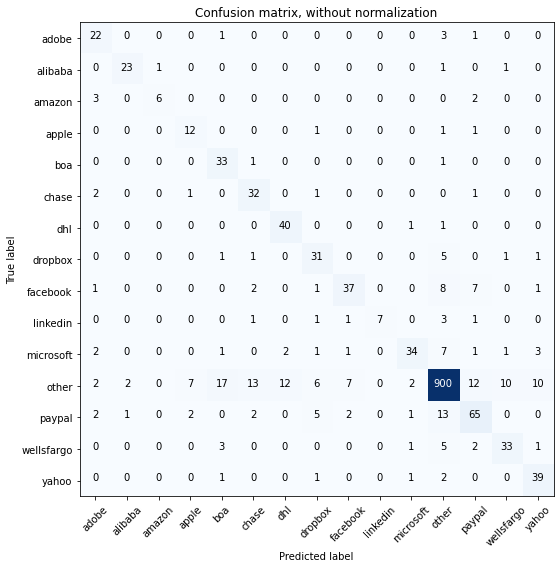

Acc     =  0.854
Pre     =  0.869
Rec     =  0.854
F1      =  0.856

Bal_Acc =  0.773
Bal_Pre =  0.747
Bal_Rec =  0.773
Bal_F1  =  0.76

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.88      0.88      0.88        26
      amazon       0.86      0.55      0.67        11
       apple       0.55      0.80      0.65        15
         boa       0.58      0.94      0.72        35
       chase       0.62      0.86      0.72        37
         dhl       0.74      0.95      0.83        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.77      0.65      0.70        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.85      0.64      0.73        53
       other       0.95      0.90      0.92      1000
      paypal       0.70      0.70      0.70        93
  wellsfargo       0.72      0.73      0.73        45
       yahoo       0.71      0.89      0.79        4

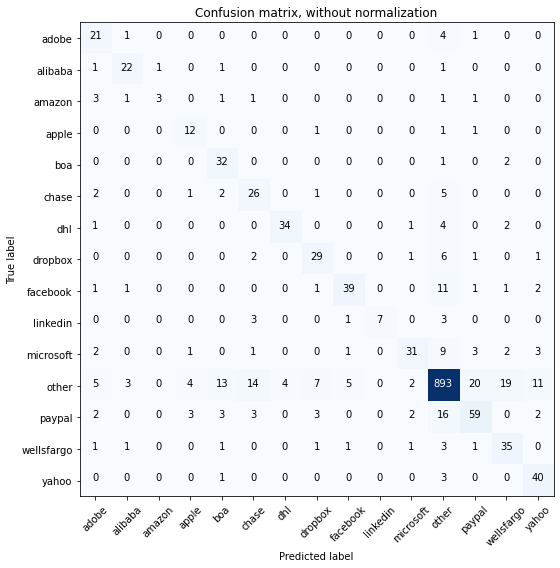

Acc     =  0.834
Pre     =  0.85
Rec     =  0.834
F1      =  0.836

Bal_Acc =  0.722
Bal_Pre =  0.72
Bal_Rec =  0.722
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.54      0.78      0.64        27
     alibaba       0.76      0.85      0.80        26
      amazon       0.75      0.27      0.40        11
       apple       0.57      0.80      0.67        15
         boa       0.59      0.91      0.72        35
       chase       0.52      0.70      0.60        37
         dhl       0.89      0.81      0.85        42
     dropbox       0.67      0.72      0.70        40
    facebook       0.83      0.68      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.93      0.89      0.91      1000
      paypal       0.67      0.63      0.65        93
  wellsfargo       0.57      0.78      0.66        45
       yahoo       0.68      0.91      0.78        44

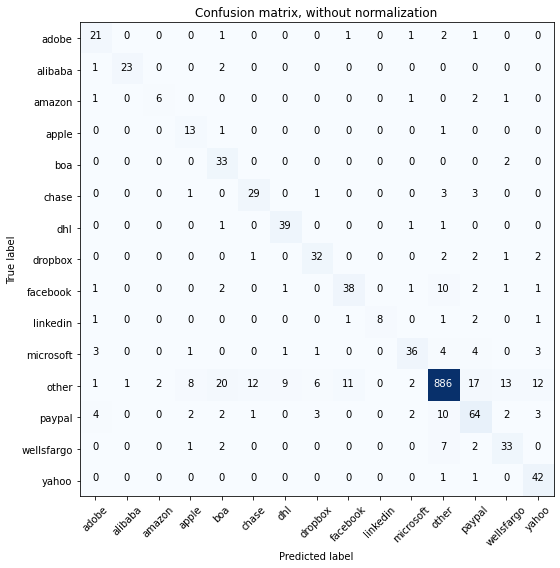

Acc     =  0.847
Pre     =  0.867
Rec     =  0.847
F1      =  0.852

Bal_Acc =  0.781
Bal_Pre =  0.733
Bal_Rec =  0.781
Bal_F1  =  0.756

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        27
     alibaba       0.96      0.88      0.92        26
      amazon       0.75      0.55      0.63        11
       apple       0.50      0.87      0.63        15
         boa       0.52      0.94      0.67        35
       chase       0.67      0.78      0.72        37
         dhl       0.78      0.93      0.85        42
     dropbox       0.74      0.80      0.77        40
    facebook       0.75      0.67      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.68      0.74        53
       other       0.95      0.89      0.92      1000
      paypal       0.64      0.69      0.66        93
  wellsfargo       0.62      0.73      0.67        45
       yahoo       0.66      0.95      0.78        

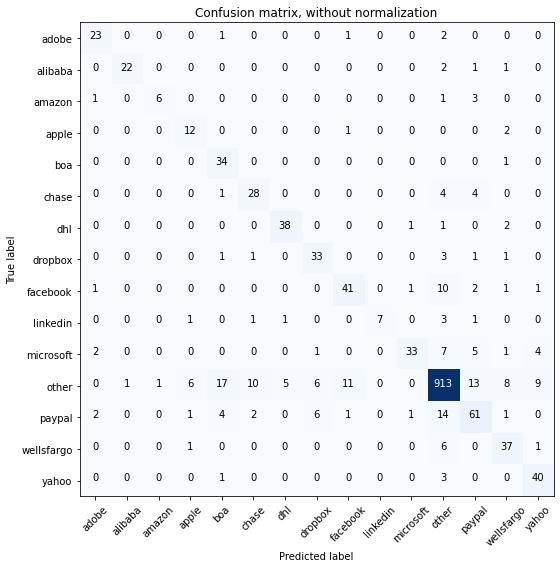

Acc     =  0.863
Pre     =  0.875
Rec     =  0.863
F1      =  0.865

Bal_Acc =  0.776
Bal_Pre =  0.778
Bal_Rec =  0.776
Bal_F1  =  0.777

              precision    recall  f1-score   support

       adobe       0.79      0.85      0.82        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.86      0.55      0.67        11
       apple       0.57      0.80      0.67        15
         boa       0.58      0.97      0.72        35
       chase       0.67      0.76      0.71        37
         dhl       0.86      0.90      0.88        42
     dropbox       0.72      0.82      0.77        40
    facebook       0.75      0.72      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.92      0.62      0.74        53
       other       0.94      0.91      0.93      1000
      paypal       0.67      0.66      0.66        93
  wellsfargo       0.67      0.82      0.74        45
       yahoo       0.73      0.91      0.81        

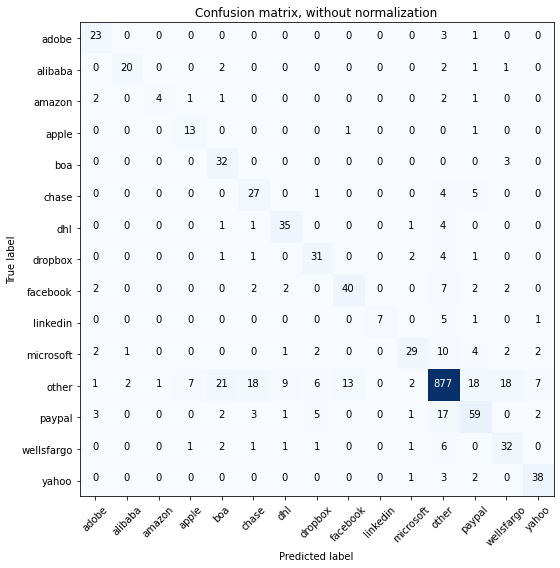

Acc     =  0.823
Pre     =  0.842
Rec     =  0.823
F1      =  0.827

Bal_Acc =  0.729
Bal_Pre =  0.717
Bal_Rec =  0.729
Bal_F1  =  0.723

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.80      0.36      0.50        11
       apple       0.59      0.87      0.70        15
         boa       0.52      0.91      0.66        35
       chase       0.51      0.73      0.60        37
         dhl       0.71      0.83      0.77        42
     dropbox       0.67      0.78      0.72        40
    facebook       0.74      0.70      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.78      0.55      0.64        53
       other       0.93      0.88      0.90      1000
      paypal       0.61      0.63      0.62        93
  wellsfargo       0.55      0.71      0.62        45
       yahoo       0.76      0.86      0.81        

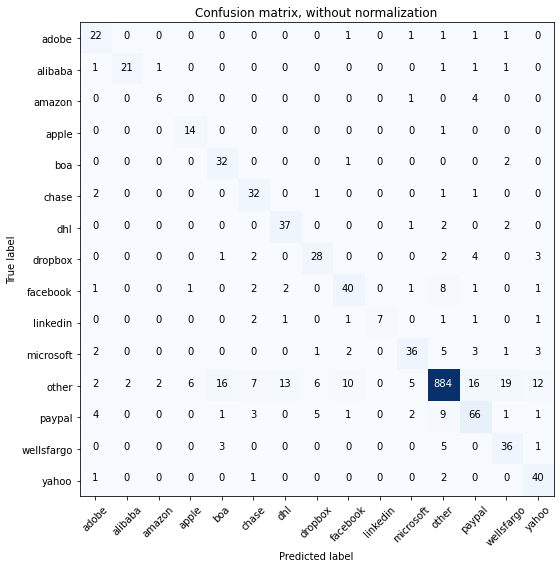

Acc     =  0.845
Pre     =  0.865
Rec     =  0.845
F1      =  0.85

Bal_Acc =  0.776
Bal_Pre =  0.723
Bal_Rec =  0.776
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.67      0.55      0.60        11
       apple       0.67      0.93      0.78        15
         boa       0.60      0.91      0.73        35
       chase       0.65      0.86      0.74        37
         dhl       0.70      0.88      0.78        42
     dropbox       0.68      0.70      0.69        40
    facebook       0.71      0.70      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.77      0.68      0.72        53
       other       0.96      0.88      0.92      1000
      paypal       0.67      0.71      0.69        93
  wellsfargo       0.57      0.80      0.67        45
       yahoo       0.65      0.91      0.75        4

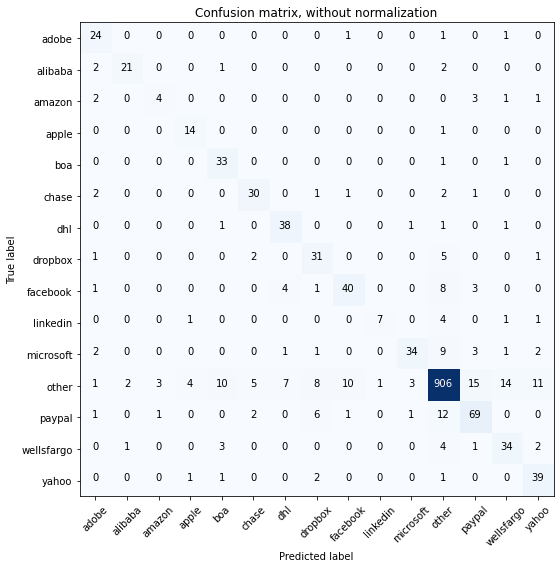

Acc     =  0.86
Pre     =  0.87
Rec     =  0.86
F1      =  0.862

Bal_Acc =  0.771
Bal_Pre =  0.737
Bal_Rec =  0.771
Bal_F1  =  0.754

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.50      0.36      0.42        11
       apple       0.70      0.93      0.80        15
         boa       0.67      0.94      0.79        35
       chase       0.77      0.81      0.79        37
         dhl       0.76      0.90      0.83        42
     dropbox       0.62      0.78      0.69        40
    facebook       0.75      0.70      0.73        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.87      0.64      0.74        53
       other       0.95      0.91      0.93      1000
      paypal       0.73      0.74      0.73        93
  wellsfargo       0.63      0.76      0.69        45
       yahoo       0.68      0.89      0.77        44


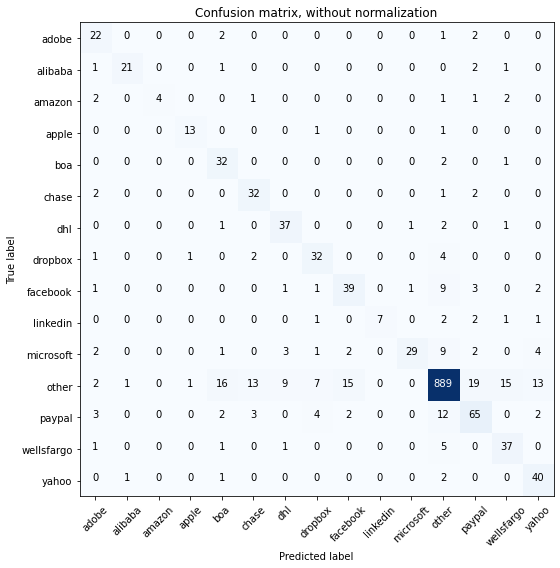

Acc     =  0.844
Pre     =  0.865
Rec     =  0.844
F1      =  0.847

Bal_Acc =  0.758
Bal_Pre =  0.765
Bal_Rec =  0.758
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       0.91      0.81      0.86        26
      amazon       1.00      0.36      0.53        11
       apple       0.87      0.87      0.87        15
         boa       0.56      0.91      0.70        35
       chase       0.63      0.86      0.73        37
         dhl       0.73      0.88      0.80        42
     dropbox       0.68      0.80      0.74        40
    facebook       0.67      0.68      0.68        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.94      0.55      0.69        53
       other       0.95      0.89      0.92      1000
      paypal       0.66      0.70      0.68        93
  wellsfargo       0.64      0.82      0.72        45
       yahoo       0.65      0.91      0.75        

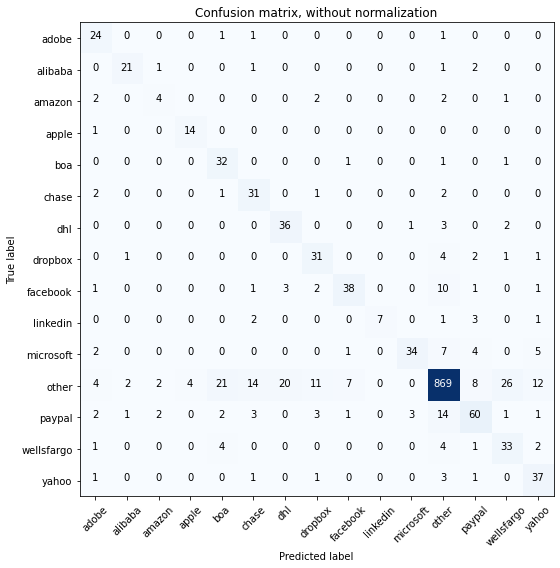

Acc     =  0.826
Pre     =  0.852
Rec     =  0.826
F1      =  0.832

Bal_Acc =  0.752
Bal_Pre =  0.698
Bal_Rec =  0.752
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.60      0.89      0.72        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.44      0.36      0.40        11
       apple       0.78      0.93      0.85        15
         boa       0.52      0.91      0.67        35
       chase       0.57      0.84      0.68        37
         dhl       0.61      0.86      0.71        42
     dropbox       0.61      0.78      0.68        40
    facebook       0.79      0.67      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.89      0.64      0.75        53
       other       0.94      0.87      0.90      1000
      paypal       0.73      0.65      0.69        93
  wellsfargo       0.51      0.73      0.60        45
       yahoo       0.62      0.84      0.71        

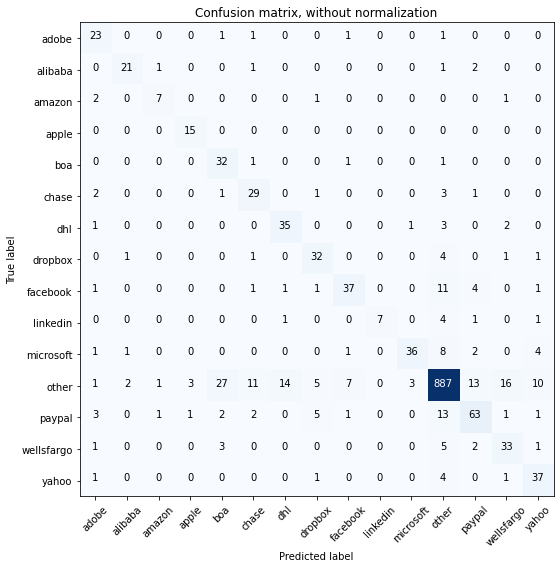

Acc     =  0.841
Pre     =  0.859
Rec     =  0.841
F1      =  0.845

Bal_Acc =  0.773
Bal_Pre =  0.736
Bal_Rec =  0.773
Bal_F1  =  0.754

              precision    recall  f1-score   support

       adobe       0.64      0.85      0.73        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.70      0.64      0.67        11
       apple       0.79      1.00      0.88        15
         boa       0.48      0.91      0.63        35
       chase       0.62      0.78      0.69        37
         dhl       0.69      0.83      0.75        42
     dropbox       0.70      0.80      0.74        40
    facebook       0.77      0.65      0.70        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.90      0.68      0.77        53
       other       0.94      0.89      0.91      1000
      paypal       0.72      0.68      0.70        93
  wellsfargo       0.60      0.73      0.66        45
       yahoo       0.66      0.84      0.74        

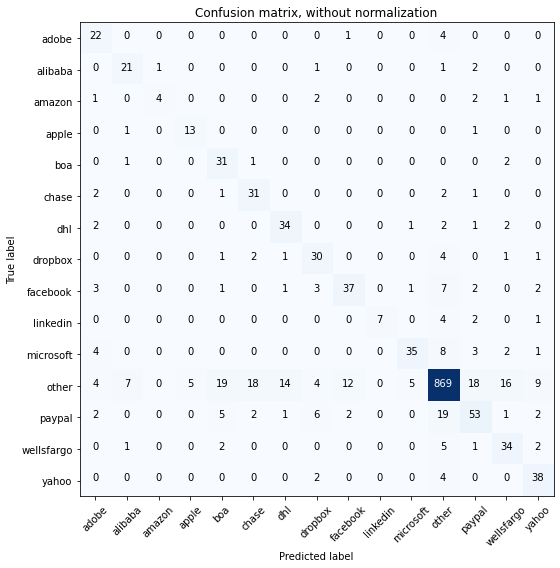

Acc     =  0.818
Pre     =  0.839
Rec     =  0.818
F1      =  0.823

Bal_Acc =  0.734
Bal_Pre =  0.698
Bal_Rec =  0.734
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.55      0.81      0.66        27
     alibaba       0.68      0.81      0.74        26
      amazon       0.80      0.36      0.50        11
       apple       0.72      0.87      0.79        15
         boa       0.52      0.89      0.65        35
       chase       0.57      0.84      0.68        37
         dhl       0.67      0.81      0.73        42
     dropbox       0.62      0.75      0.68        40
    facebook       0.71      0.65      0.68        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.83      0.66      0.74        53
       other       0.94      0.87      0.90      1000
      paypal       0.62      0.57      0.59        93
  wellsfargo       0.58      0.76      0.65        45
       yahoo       0.67      0.86      0.75        

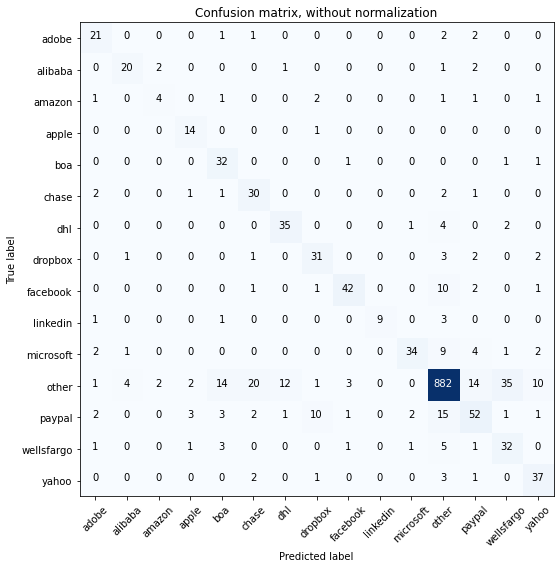

Acc     =  0.828
Pre     =  0.85
Rec     =  0.828
F1      =  0.834

Bal_Acc =  0.746
Bal_Pre =  0.703
Bal_Rec =  0.746
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        27
     alibaba       0.77      0.77      0.77        26
      amazon       0.50      0.36      0.42        11
       apple       0.67      0.93      0.78        15
         boa       0.57      0.91      0.70        35
       chase       0.53      0.81      0.64        37
         dhl       0.71      0.83      0.77        42
     dropbox       0.66      0.78      0.71        40
    facebook       0.88      0.74      0.80        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.89      0.64      0.75        53
       other       0.94      0.88      0.91      1000
      paypal       0.63      0.56      0.59        93
  wellsfargo       0.44      0.71      0.55        45
       yahoo       0.67      0.84      0.75        4

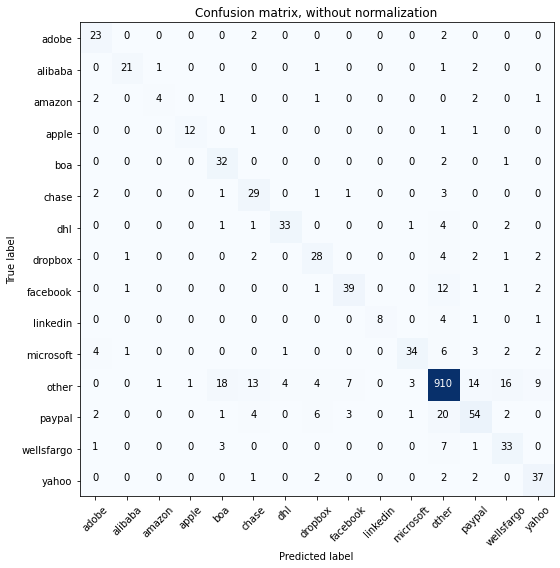

Acc     =  0.843
Pre     =  0.855
Rec     =  0.843
F1      =  0.845

Bal_Acc =  0.731
Bal_Pre =  0.749
Bal_Rec =  0.731
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.92      0.80      0.86        15
         boa       0.56      0.91      0.70        35
       chase       0.55      0.78      0.64        37
         dhl       0.87      0.79      0.82        42
     dropbox       0.64      0.70      0.67        40
    facebook       0.78      0.68      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.87      0.64      0.74        53
       other       0.93      0.91      0.92      1000
      paypal       0.65      0.58      0.61        93
  wellsfargo       0.57      0.73      0.64        45
       yahoo       0.69      0.84      0.76        4

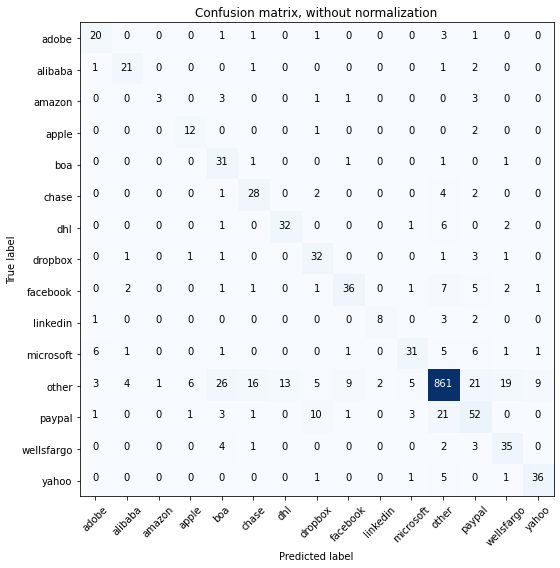

Acc     =  0.804
Pre     =  0.83
Rec     =  0.804
F1      =  0.811

Bal_Acc =  0.709
Bal_Pre =  0.669
Bal_Rec =  0.709
Bal_F1  =  0.688

              precision    recall  f1-score   support

       adobe       0.62      0.74      0.68        27
     alibaba       0.72      0.81      0.76        26
      amazon       0.75      0.27      0.40        11
       apple       0.60      0.80      0.69        15
         boa       0.42      0.89      0.57        35
       chase       0.56      0.76      0.64        37
         dhl       0.71      0.76      0.74        42
     dropbox       0.59      0.80      0.68        40
    facebook       0.73      0.63      0.68        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.74      0.58      0.65        53
       other       0.94      0.86      0.90      1000
      paypal       0.51      0.56      0.53        93
  wellsfargo       0.56      0.78      0.65        45
       yahoo       0.77      0.82      0.79        4

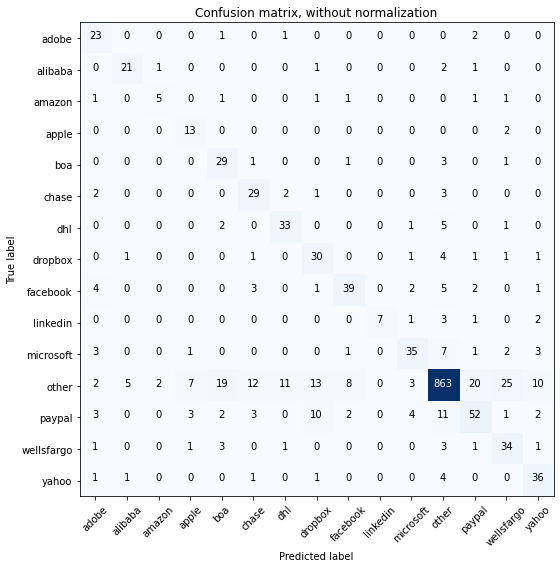

Acc     =  0.812
Pre     =  0.838
Rec     =  0.812
F1      =  0.819

Bal_Acc =  0.731
Bal_Pre =  0.665
Bal_Rec =  0.731
Bal_F1  =  0.696

              precision    recall  f1-score   support

       adobe       0.57      0.85      0.69        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.62      0.45      0.53        11
       apple       0.52      0.87      0.65        15
         boa       0.51      0.83      0.63        35
       chase       0.58      0.78      0.67        37
         dhl       0.69      0.79      0.73        42
     dropbox       0.52      0.75      0.61        40
    facebook       0.75      0.68      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.74      0.66      0.70        53
       other       0.95      0.86      0.90      1000
      paypal       0.63      0.56      0.59        93
  wellsfargo       0.50      0.76      0.60        45
       yahoo       0.64      0.82      0.72        

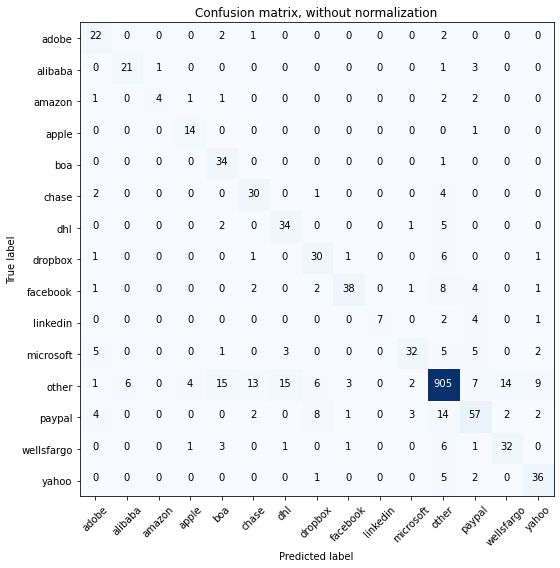

Acc     =  0.842
Pre     =  0.855
Rec     =  0.842
F1      =  0.844

Bal_Acc =  0.739
Bal_Pre =  0.732
Bal_Rec =  0.739
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       0.78      0.81      0.79        26
      amazon       0.80      0.36      0.50        11
       apple       0.70      0.93      0.80        15
         boa       0.59      0.97      0.73        35
       chase       0.61      0.81      0.70        37
         dhl       0.64      0.81      0.72        42
     dropbox       0.62      0.75      0.68        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.60      0.70        53
       other       0.94      0.91      0.92      1000
      paypal       0.66      0.61      0.64        93
  wellsfargo       0.67      0.71      0.69        45
       yahoo       0.69      0.82      0.75        

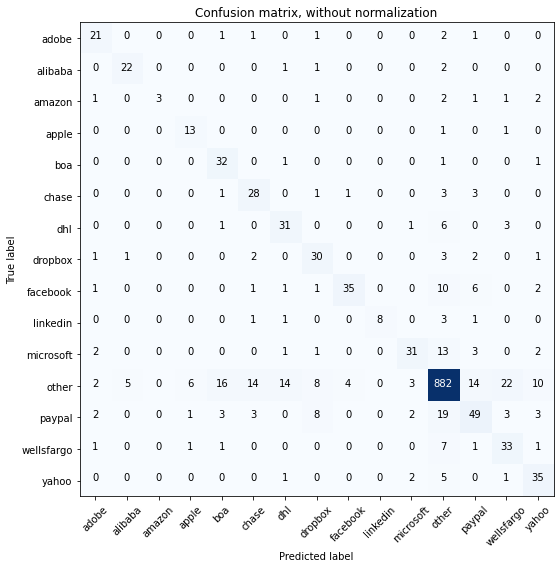

Acc     =  0.814
Pre     =  0.832
Rec     =  0.814
F1      =  0.817

Bal_Acc =  0.709
Bal_Pre =  0.716
Bal_Rec =  0.709
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        27
     alibaba       0.79      0.85      0.81        26
      amazon       1.00      0.27      0.43        11
       apple       0.62      0.87      0.72        15
         boa       0.58      0.91      0.71        35
       chase       0.56      0.76      0.64        37
         dhl       0.61      0.74      0.67        42
     dropbox       0.58      0.75      0.65        40
    facebook       0.88      0.61      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.58      0.67        53
       other       0.92      0.88      0.90      1000
      paypal       0.60      0.53      0.56        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.61      0.80      0.69        

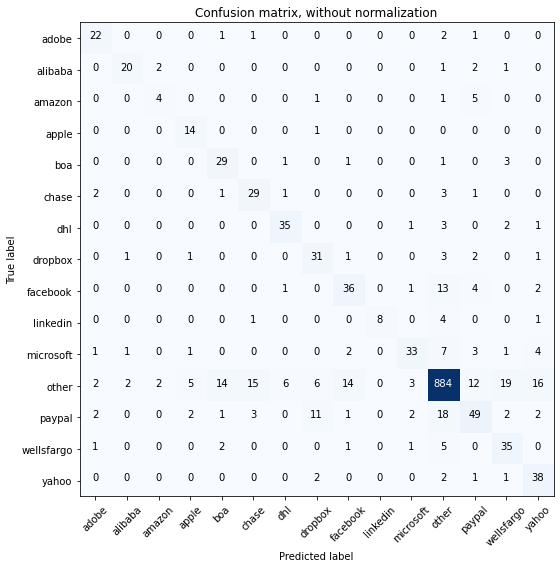

Acc     =  0.823
Pre     =  0.839
Rec     =  0.823
F1      =  0.826

Bal_Acc =  0.732
Bal_Pre =  0.693
Bal_Rec =  0.732
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.50      0.36      0.42        11
       apple       0.61      0.93      0.74        15
         boa       0.60      0.83      0.70        35
       chase       0.59      0.78      0.67        37
         dhl       0.80      0.83      0.81        42
     dropbox       0.60      0.78      0.67        40
    facebook       0.64      0.63      0.64        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.62      0.70        53
       other       0.93      0.88      0.91      1000
      paypal       0.61      0.53      0.57        93
  wellsfargo       0.55      0.78      0.64        45
       yahoo       0.58      0.86      0.70        

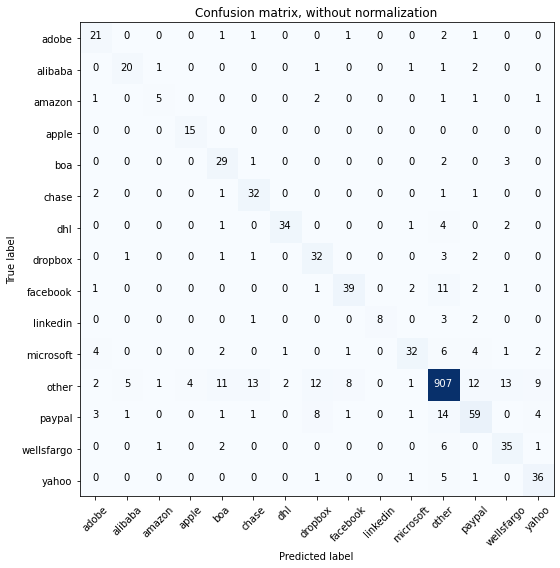

Acc     =  0.847
Pre     =  0.859
Rec     =  0.847
F1      =  0.85

Bal_Acc =  0.753
Bal_Pre =  0.735
Bal_Rec =  0.753
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        27
     alibaba       0.74      0.77      0.75        26
      amazon       0.62      0.45      0.53        11
       apple       0.79      1.00      0.88        15
         boa       0.59      0.83      0.69        35
       chase       0.64      0.86      0.74        37
         dhl       0.92      0.81      0.86        42
     dropbox       0.56      0.80      0.66        40
    facebook       0.78      0.68      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.60      0.70        53
       other       0.94      0.91      0.92      1000
      paypal       0.68      0.63      0.66        93
  wellsfargo       0.64      0.78      0.70        45
       yahoo       0.68      0.82      0.74        4

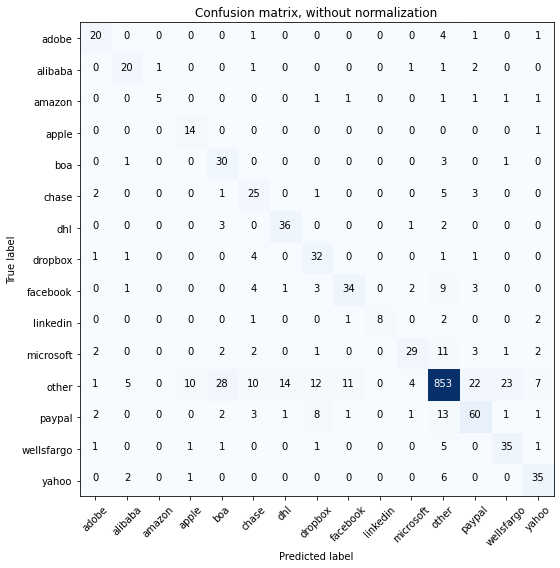

Acc     =  0.803
Pre     =  0.83
Rec     =  0.803
F1      =  0.81

Bal_Acc =  0.725
Bal_Pre =  0.679
Bal_Rec =  0.725
Bal_F1  =  0.701

              precision    recall  f1-score   support

       adobe       0.69      0.74      0.71        27
     alibaba       0.67      0.77      0.71        26
      amazon       0.83      0.45      0.59        11
       apple       0.54      0.93      0.68        15
         boa       0.45      0.86      0.59        35
       chase       0.49      0.68      0.57        37
         dhl       0.69      0.86      0.77        42
     dropbox       0.54      0.80      0.65        40
    facebook       0.71      0.60      0.65        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.76      0.55      0.64        53
       other       0.93      0.85      0.89      1000
      paypal       0.62      0.65      0.63        93
  wellsfargo       0.56      0.78      0.65        45
       yahoo       0.69      0.80      0.74        44

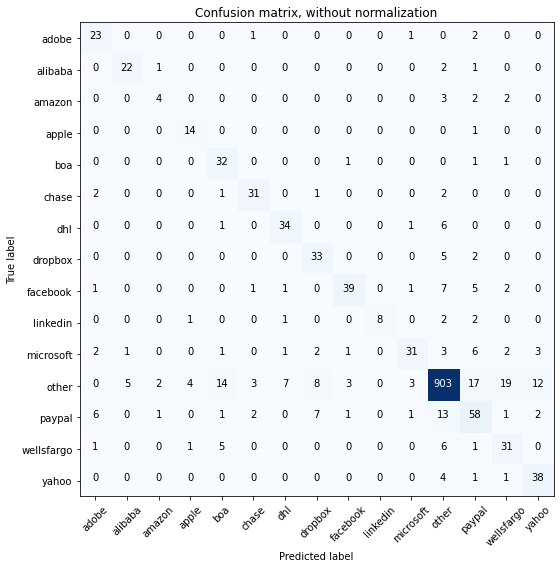

Acc     =  0.845
Pre     =  0.86
Rec     =  0.845
F1      =  0.848

Bal_Acc =  0.753
Bal_Pre =  0.726
Bal_Rec =  0.753
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.79      0.85      0.81        26
      amazon       0.50      0.36      0.42        11
       apple       0.70      0.93      0.80        15
         boa       0.58      0.91      0.71        35
       chase       0.82      0.84      0.83        37
         dhl       0.77      0.81      0.79        42
     dropbox       0.65      0.82      0.73        40
    facebook       0.87      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.58      0.68        53
       other       0.94      0.90      0.92      1000
      paypal       0.59      0.62      0.60        93
  wellsfargo       0.53      0.69      0.60        45
       yahoo       0.69      0.86      0.77        4

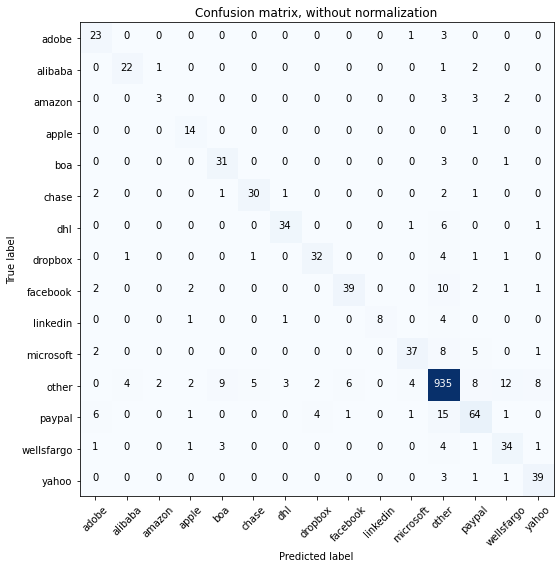

Acc     =  0.874
Pre     =  0.877
Rec     =  0.874
F1      =  0.873

Bal_Acc =  0.762
Bal_Pre =  0.775
Bal_Rec =  0.762
Bal_F1  =  0.768

              precision    recall  f1-score   support

       adobe       0.64      0.85      0.73        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.50      0.27      0.35        11
       apple       0.67      0.93      0.78        15
         boa       0.70      0.89      0.78        35
       chase       0.83      0.81      0.82        37
         dhl       0.87      0.81      0.84        42
     dropbox       0.84      0.80      0.82        40
    facebook       0.85      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.70      0.76        53
       other       0.93      0.94      0.93      1000
      paypal       0.72      0.69      0.70        93
  wellsfargo       0.64      0.76      0.69        45
       yahoo       0.76      0.89      0.82        

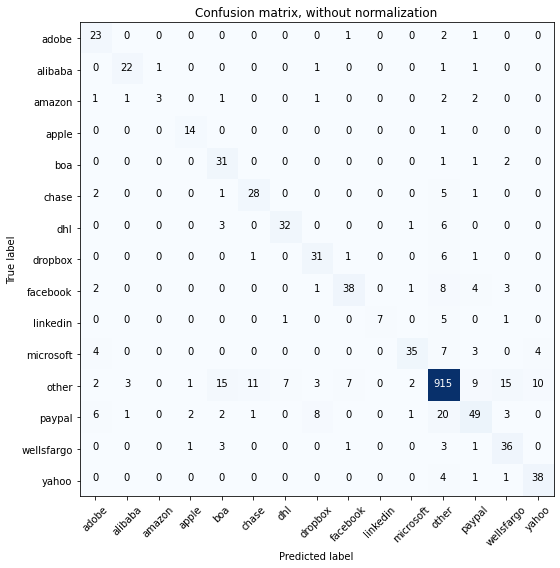

Acc     =  0.846
Pre     =  0.855
Rec     =  0.846
F1      =  0.846

Bal_Acc =  0.734
Bal_Pre =  0.748
Bal_Rec =  0.734
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.57      0.85      0.69        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.75      0.27      0.40        11
       apple       0.78      0.93      0.85        15
         boa       0.55      0.89      0.68        35
       chase       0.68      0.76      0.72        37
         dhl       0.80      0.76      0.78        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.79      0.67      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.88      0.66      0.75        53
       other       0.93      0.92      0.92      1000
      paypal       0.66      0.53      0.59        93
  wellsfargo       0.59      0.80      0.68        45
       yahoo       0.73      0.86      0.79        

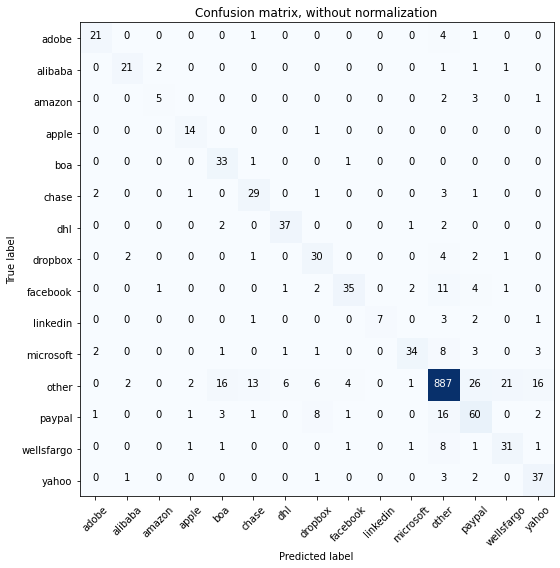

Acc     =  0.832
Pre     =  0.849
Rec     =  0.832
F1      =  0.836

Bal_Acc =  0.743
Bal_Pre =  0.732
Bal_Rec =  0.743
Bal_F1  =  0.737

              precision    recall  f1-score   support

       adobe       0.81      0.78      0.79        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.62      0.45      0.53        11
       apple       0.74      0.93      0.82        15
         boa       0.59      0.94      0.73        35
       chase       0.62      0.78      0.69        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.60      0.75      0.67        40
    facebook       0.83      0.61      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.64      0.74        53
       other       0.93      0.89      0.91      1000
      paypal       0.57      0.65      0.60        93
  wellsfargo       0.56      0.69      0.62        45
       yahoo       0.61      0.84      0.70        

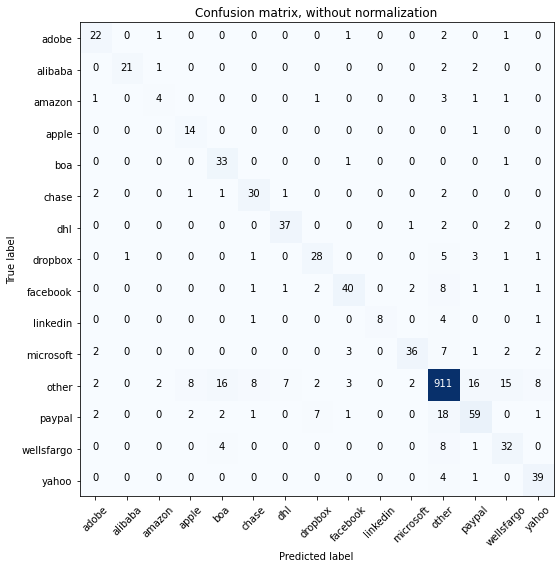

Acc     =  0.854
Pre     =  0.864
Rec     =  0.854
F1      =  0.855

Bal_Acc =  0.757
Bal_Pre =  0.744
Bal_Rec =  0.757
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.50      0.36      0.42        11
       apple       0.56      0.93      0.70        15
         boa       0.59      0.94      0.73        35
       chase       0.71      0.81      0.76        37
         dhl       0.80      0.88      0.84        42
     dropbox       0.70      0.70      0.70        40
    facebook       0.82      0.70      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.88      0.68      0.77        53
       other       0.93      0.91      0.92      1000
      paypal       0.69      0.63      0.66        93
  wellsfargo       0.57      0.71      0.63        45
       yahoo       0.74      0.89      0.80        4

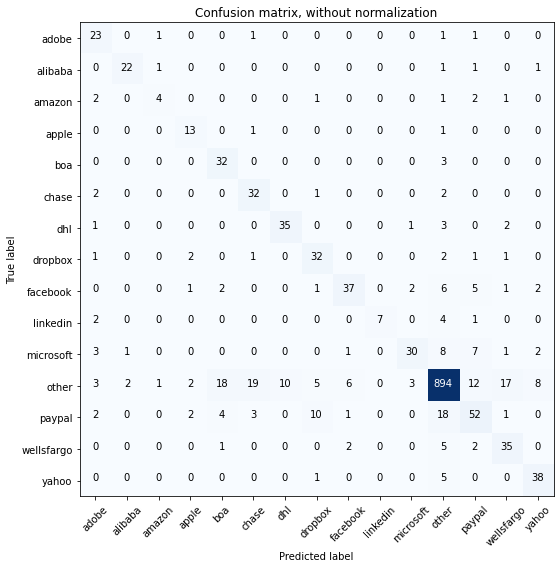

Acc     =  0.836
Pre     =  0.851
Rec     =  0.836
F1      =  0.838

Bal_Acc =  0.743
Bal_Pre =  0.716
Bal_Rec =  0.743
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.57      0.36      0.44        11
       apple       0.65      0.87      0.74        15
         boa       0.56      0.91      0.70        35
       chase       0.56      0.86      0.68        37
         dhl       0.78      0.83      0.80        42
     dropbox       0.63      0.80      0.70        40
    facebook       0.79      0.65      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.83      0.57      0.67        53
       other       0.94      0.89      0.92      1000
      paypal       0.62      0.56      0.59        93
  wellsfargo       0.59      0.78      0.67        45
       yahoo       0.75      0.86      0.80        

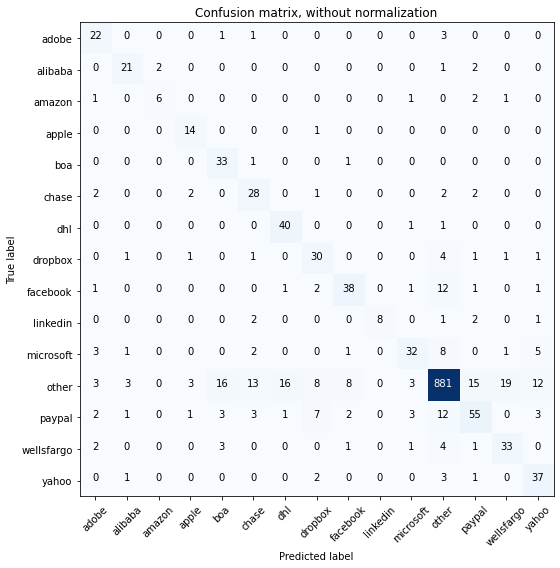

Acc     =  0.83
Pre     =  0.849
Rec     =  0.83
F1      =  0.834

Bal_Acc =  0.759
Bal_Pre =  0.702
Bal_Rec =  0.759
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.75      0.55      0.63        11
       apple       0.67      0.93      0.78        15
         boa       0.59      0.94      0.73        35
       chase       0.55      0.76      0.64        37
         dhl       0.69      0.95      0.80        42
     dropbox       0.59      0.75      0.66        40
    facebook       0.75      0.67      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.76      0.60      0.67        53
       other       0.95      0.88      0.91      1000
      paypal       0.67      0.59      0.63        93
  wellsfargo       0.60      0.73      0.66        45
       yahoo       0.62      0.84      0.71        44

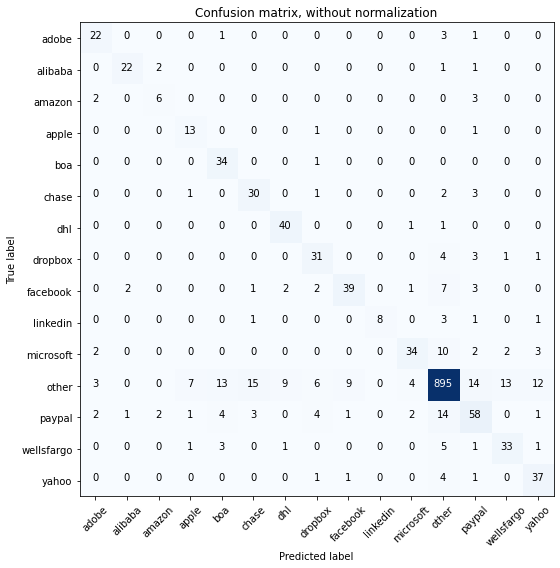

Acc     =  0.846
Pre     =  0.859
Rec     =  0.846
F1      =  0.849

Bal_Acc =  0.772
Bal_Pre =  0.727
Bal_Rec =  0.772
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.60      0.55      0.57        11
       apple       0.57      0.87      0.68        15
         boa       0.62      0.97      0.76        35
       chase       0.60      0.81      0.69        37
         dhl       0.77      0.95      0.85        42
     dropbox       0.66      0.78      0.71        40
    facebook       0.78      0.68      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.64      0.72        53
       other       0.94      0.90      0.92      1000
      paypal       0.63      0.62      0.63        93
  wellsfargo       0.67      0.73      0.70        45
       yahoo       0.66      0.84      0.74        

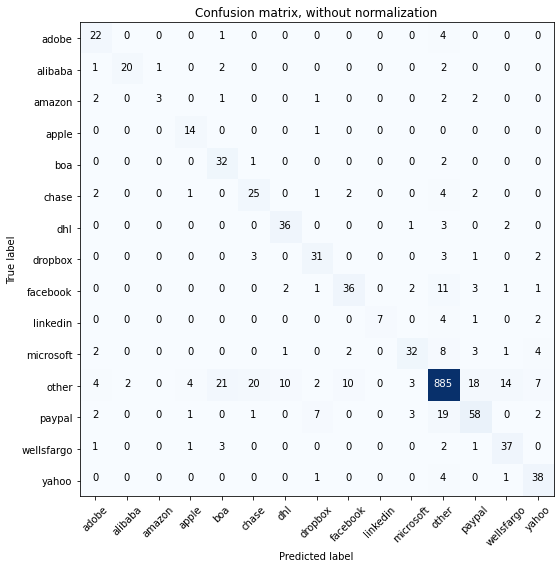

Acc     =  0.829
Pre     =  0.844
Rec     =  0.829
F1      =  0.831

Bal_Acc =  0.729
Bal_Pre =  0.721
Bal_Rec =  0.729
Bal_F1  =  0.725

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.75      0.27      0.40        11
       apple       0.67      0.93      0.78        15
         boa       0.53      0.91      0.67        35
       chase       0.50      0.68      0.57        37
         dhl       0.73      0.86      0.79        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.72      0.63      0.67        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.78      0.60      0.68        53
       other       0.93      0.89      0.91      1000
      paypal       0.65      0.62      0.64        93
  wellsfargo       0.66      0.82      0.73        45
       yahoo       0.68      0.86      0.76        

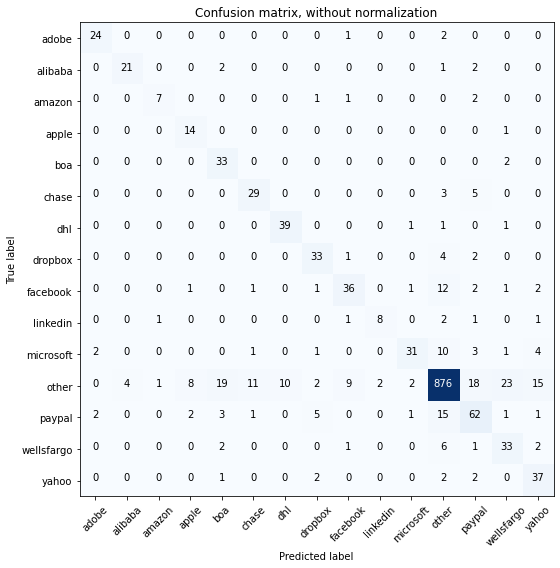

Acc     =  0.834
Pre     =  0.853
Rec     =  0.834
F1      =  0.838

Bal_Acc =  0.777
Bal_Pre =  0.723
Bal_Rec =  0.777
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.86      0.89      0.87        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.78      0.64      0.70        11
       apple       0.56      0.93      0.70        15
         boa       0.55      0.94      0.69        35
       chase       0.67      0.78      0.72        37
         dhl       0.80      0.93      0.86        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.72      0.63      0.67        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.86      0.58      0.70        53
       other       0.94      0.88      0.91      1000
      paypal       0.62      0.67      0.64        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.60      0.84      0.70        

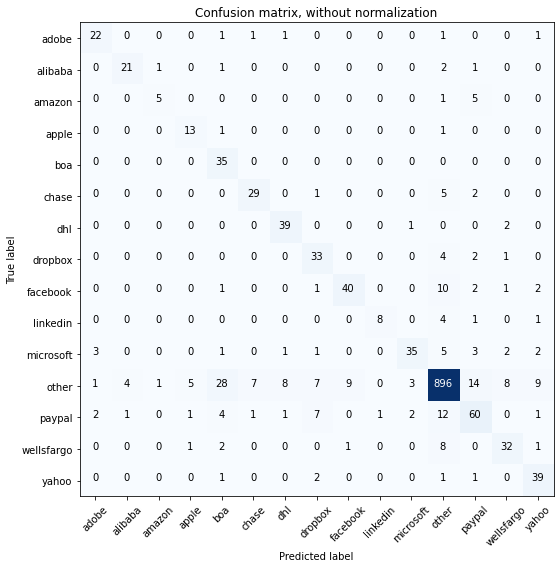

Acc     =  0.849
Pre     =  0.866
Rec     =  0.849
F1      =  0.853

Bal_Acc =  0.77
Bal_Pre =  0.743
Bal_Rec =  0.77
Bal_F1  =  0.756

              precision    recall  f1-score   support

       adobe       0.79      0.81      0.80        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.71      0.45      0.56        11
       apple       0.65      0.87      0.74        15
         boa       0.47      1.00      0.64        35
       chase       0.76      0.78      0.77        37
         dhl       0.78      0.93      0.85        42
     dropbox       0.63      0.82      0.72        40
    facebook       0.80      0.70      0.75        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.85      0.66      0.74        53
       other       0.94      0.90      0.92      1000
      paypal       0.66      0.65      0.65        93
  wellsfargo       0.70      0.71      0.70        45
       yahoo       0.70      0.89      0.78        44

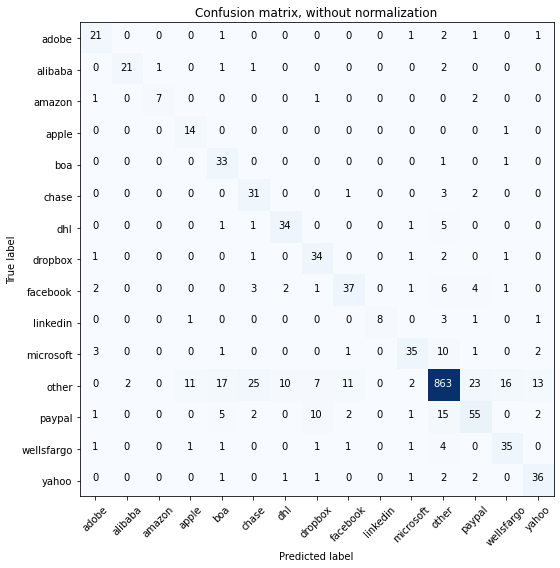

Acc     =  0.821
Pre     =  0.846
Rec     =  0.821
F1      =  0.828

Bal_Acc =  0.768
Bal_Pre =  0.713
Bal_Rec =  0.768
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.88      0.64      0.74        11
       apple       0.52      0.93      0.67        15
         boa       0.54      0.94      0.69        35
       chase       0.48      0.84      0.61        37
         dhl       0.72      0.81      0.76        42
     dropbox       0.62      0.85      0.72        40
    facebook       0.70      0.65      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.66      0.72        53
       other       0.94      0.86      0.90      1000
      paypal       0.60      0.59      0.60        93
  wellsfargo       0.64      0.78      0.70        45
       yahoo       0.65      0.82      0.73        

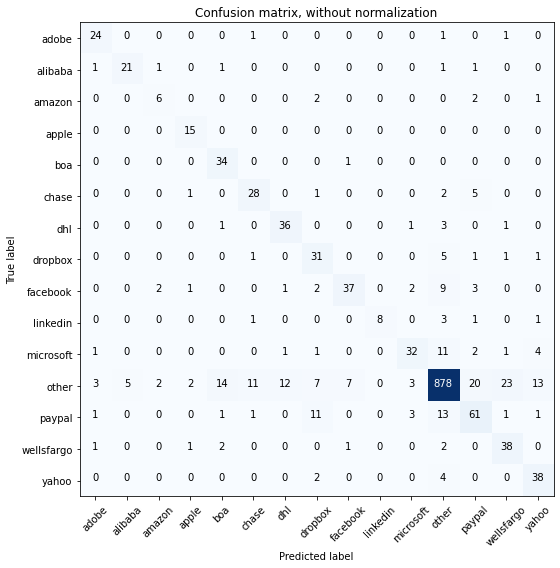

Acc     =  0.836
Pre     =  0.854
Rec     =  0.836
F1      =  0.84

Bal_Acc =  0.778
Bal_Pre =  0.721
Bal_Rec =  0.778
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.77      0.89      0.83        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.55      0.55      0.55        11
       apple       0.75      1.00      0.86        15
         boa       0.64      0.97      0.77        35
       chase       0.65      0.76      0.70        37
         dhl       0.72      0.86      0.78        42
     dropbox       0.54      0.78      0.64        40
    facebook       0.80      0.65      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.60      0.68        53
       other       0.94      0.88      0.91      1000
      paypal       0.64      0.66      0.65        93
  wellsfargo       0.58      0.84      0.68        45
       yahoo       0.64      0.86      0.74        4

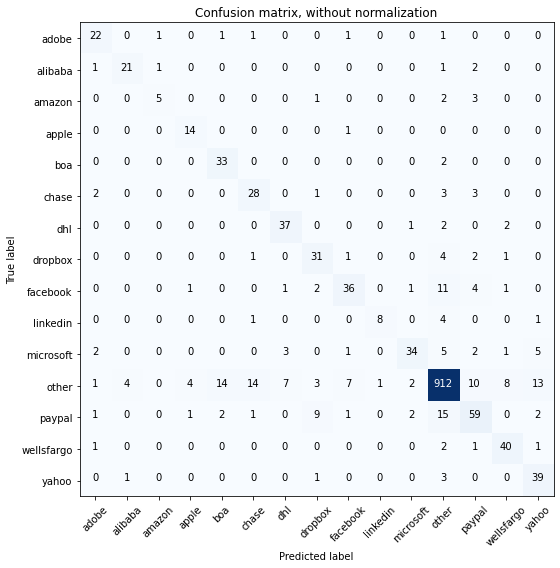

Acc     =  0.857
Pre     =  0.866
Rec     =  0.857
F1      =  0.858

Bal_Acc =  0.769
Bal_Pre =  0.744
Bal_Rec =  0.769
Bal_F1  =  0.756

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.71      0.45      0.56        11
       apple       0.70      0.93      0.80        15
         boa       0.66      0.94      0.78        35
       chase       0.61      0.76      0.67        37
         dhl       0.77      0.88      0.82        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.75      0.63      0.69        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.85      0.64      0.73        53
       other       0.94      0.91      0.93      1000
      paypal       0.69      0.63      0.66        93
  wellsfargo       0.75      0.89      0.82        45
       yahoo       0.64      0.89      0.74        

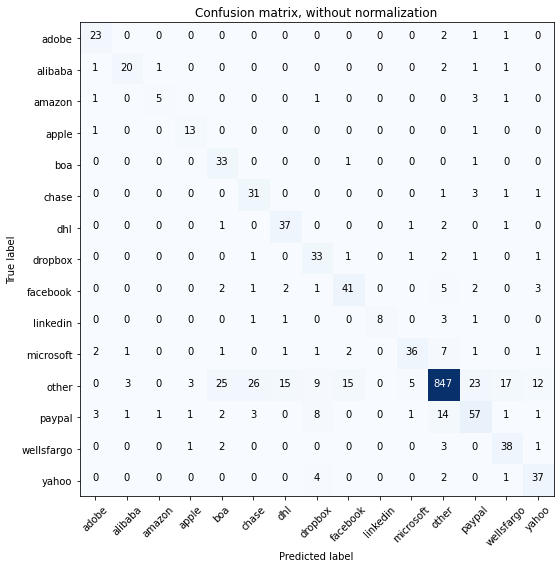

Acc     =  0.818
Pre     =  0.849
Rec     =  0.818
F1      =  0.826

Bal_Acc =  0.77
Bal_Pre =  0.702
Bal_Rec =  0.77
Bal_F1  =  0.734

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.80      0.77      0.78        26
      amazon       0.71      0.45      0.56        11
       apple       0.72      0.87      0.79        15
         boa       0.50      0.94      0.65        35
       chase       0.49      0.84      0.62        37
         dhl       0.66      0.88      0.76        42
     dropbox       0.58      0.82      0.68        40
    facebook       0.68      0.72      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.68      0.74        53
       other       0.95      0.85      0.90      1000
      paypal       0.60      0.61      0.61        93
  wellsfargo       0.61      0.84      0.71        45
       yahoo       0.65      0.84      0.73        44

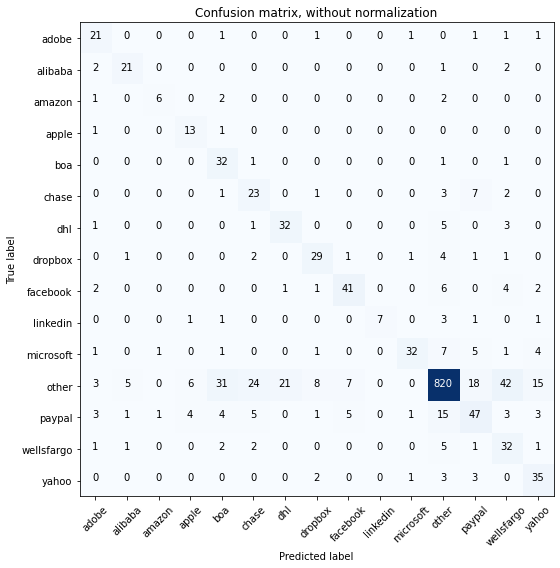

Acc     =  0.774
Pre     =  0.822
Rec     =  0.774
F1      =  0.788

Bal_Acc =  0.712
Bal_Pre =  0.648
Bal_Rec =  0.712
Bal_F1  =  0.678

              precision    recall  f1-score   support

       adobe       0.58      0.78      0.67        27
     alibaba       0.72      0.81      0.76        26
      amazon       0.75      0.55      0.63        11
       apple       0.54      0.87      0.67        15
         boa       0.42      0.91      0.58        35
       chase       0.40      0.62      0.48        37
         dhl       0.59      0.76      0.67        42
     dropbox       0.66      0.72      0.69        40
    facebook       0.76      0.72      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.89      0.60      0.72        53
       other       0.94      0.82      0.87      1000
      paypal       0.56      0.51      0.53        93
  wellsfargo       0.35      0.71      0.47        45
       yahoo       0.56      0.80      0.66        

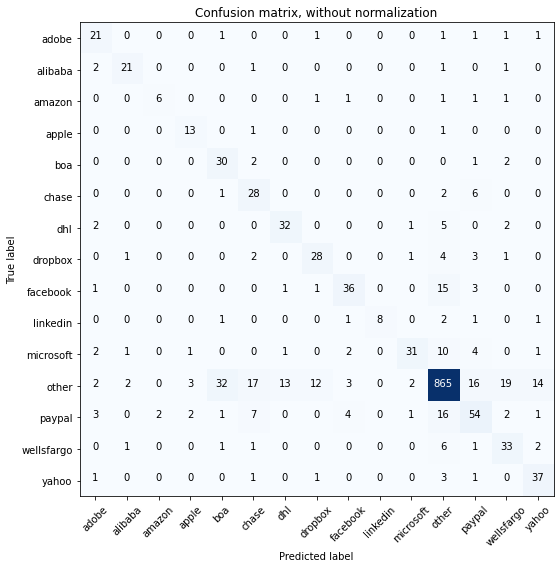

Acc     =  0.808
Pre     =  0.833
Rec     =  0.808
F1      =  0.814

Bal_Acc =  0.725
Bal_Pre =  0.694
Bal_Rec =  0.725
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.75      0.55      0.63        11
       apple       0.68      0.87      0.76        15
         boa       0.45      0.86      0.59        35
       chase       0.47      0.76      0.58        37
         dhl       0.68      0.76      0.72        42
     dropbox       0.64      0.70      0.67        40
    facebook       0.77      0.63      0.69        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.58      0.70        53
       other       0.93      0.86      0.90      1000
      paypal       0.59      0.58      0.58        93
  wellsfargo       0.53      0.73      0.62        45
       yahoo       0.65      0.84      0.73        

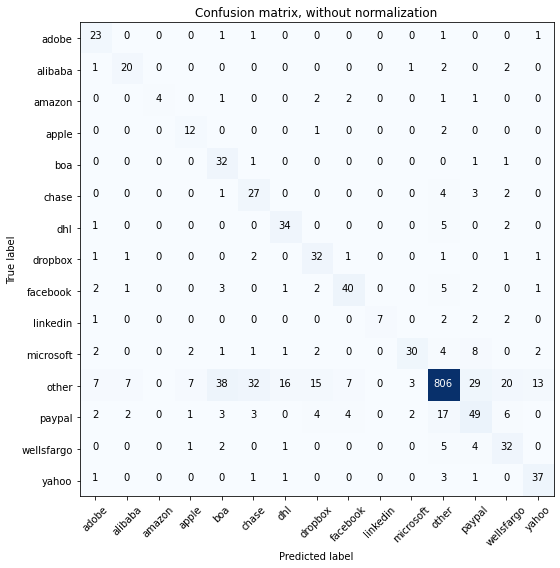

Acc     =  0.77
Pre     =  0.821
Rec     =  0.77
F1      =  0.783

Bal_Acc =  0.713
Bal_Pre =  0.656
Bal_Rec =  0.713
Bal_F1  =  0.683

              precision    recall  f1-score   support

       adobe       0.56      0.85      0.68        27
     alibaba       0.65      0.77      0.70        26
      amazon       1.00      0.36      0.53        11
       apple       0.52      0.80      0.63        15
         boa       0.39      0.91      0.55        35
       chase       0.40      0.73      0.51        37
         dhl       0.63      0.81      0.71        42
     dropbox       0.55      0.80      0.65        40
    facebook       0.74      0.70      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.83      0.57      0.67        53
       other       0.94      0.81      0.87      1000
      paypal       0.49      0.53      0.51        93
  wellsfargo       0.47      0.71      0.57        45
       yahoo       0.67      0.84      0.75        44

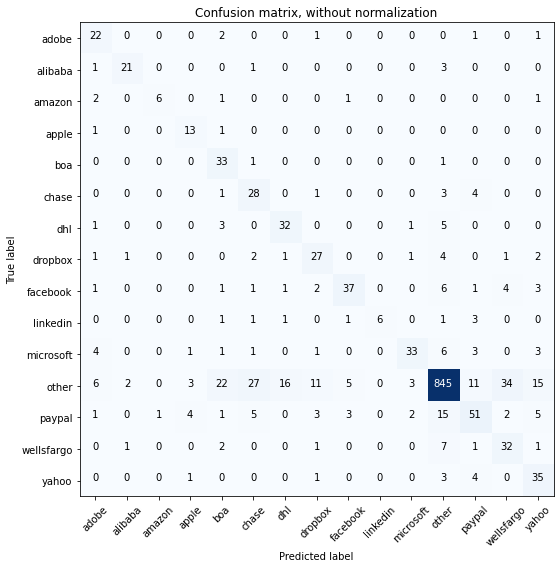

Acc     =  0.793
Pre     =  0.833
Rec     =  0.793
F1      =  0.804

Bal_Acc =  0.718
Bal_Pre =  0.673
Bal_Rec =  0.718
Bal_F1  =  0.695

              precision    recall  f1-score   support

       adobe       0.55      0.81      0.66        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.86      0.55      0.67        11
       apple       0.59      0.87      0.70        15
         boa       0.48      0.94      0.63        35
       chase       0.42      0.76      0.54        37
         dhl       0.63      0.76      0.69        42
     dropbox       0.56      0.68      0.61        40
    facebook       0.79      0.65      0.71        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.84      0.89      1000
      paypal       0.65      0.55      0.59        93
  wellsfargo       0.44      0.71      0.54        45
       yahoo       0.53      0.80      0.64        

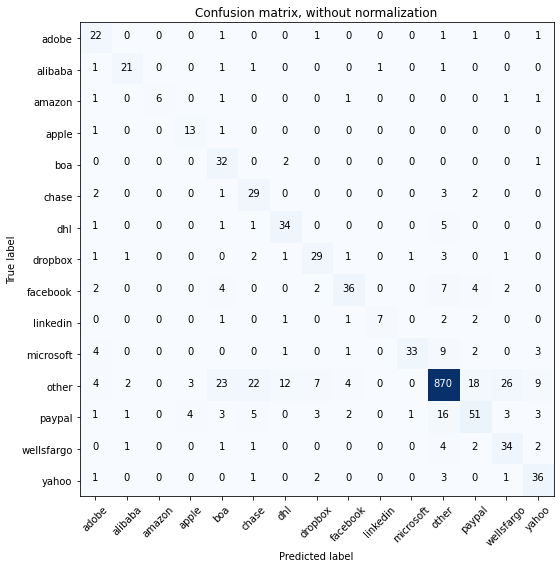

Acc     =  0.814
Pre     =  0.845
Rec     =  0.814
F1      =  0.822

Bal_Acc =  0.734
Bal_Pre =  0.703
Bal_Rec =  0.734
Bal_F1  =  0.718

              precision    recall  f1-score   support

       adobe       0.54      0.81      0.65        27
     alibaba       0.81      0.81      0.81        26
      amazon       1.00      0.55      0.71        11
       apple       0.65      0.87      0.74        15
         boa       0.46      0.91      0.61        35
       chase       0.47      0.78      0.59        37
         dhl       0.67      0.81      0.73        42
     dropbox       0.66      0.72      0.69        40
    facebook       0.78      0.63      0.70        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.94      0.62      0.75        53
       other       0.94      0.87      0.90      1000
      paypal       0.62      0.55      0.58        93
  wellsfargo       0.50      0.76      0.60        45
       yahoo       0.64      0.82      0.72        

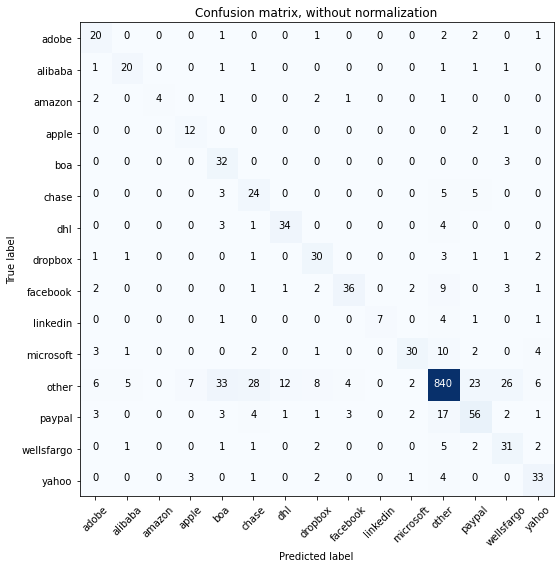

Acc     =  0.786
Pre     =  0.825
Rec     =  0.786
F1      =  0.796

Bal_Acc =  0.692
Bal_Pre =  0.676
Bal_Rec =  0.692
Bal_F1  =  0.684

              precision    recall  f1-score   support

       adobe       0.53      0.74      0.62        27
     alibaba       0.71      0.77      0.74        26
      amazon       1.00      0.36      0.53        11
       apple       0.55      0.80      0.65        15
         boa       0.41      0.91      0.56        35
       chase       0.38      0.65      0.48        37
         dhl       0.71      0.81      0.76        42
     dropbox       0.61      0.75      0.67        40
    facebook       0.82      0.63      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.81      0.57      0.67        53
       other       0.93      0.84      0.88      1000
      paypal       0.59      0.60      0.60        93
  wellsfargo       0.46      0.69      0.55        45
       yahoo       0.65      0.75      0.69        

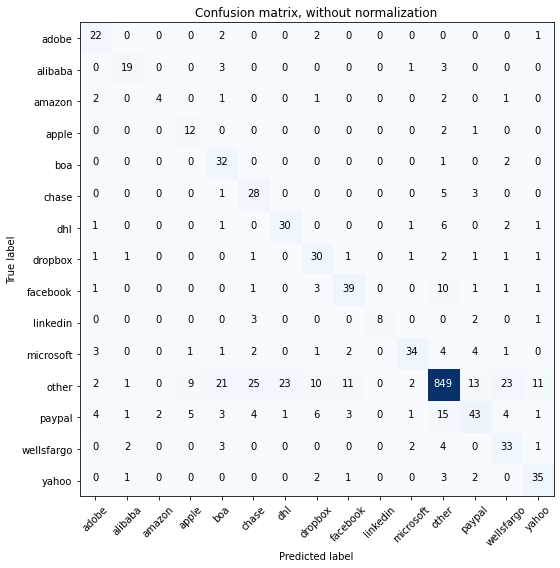

Acc     =  0.791
Pre     =  0.825
Rec     =  0.791
F1      =  0.8

Bal_Acc =  0.705
Bal_Pre =  0.645
Bal_Rec =  0.705
Bal_F1  =  0.674

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.76      0.73      0.75        26
      amazon       0.67      0.36      0.47        11
       apple       0.44      0.80      0.57        15
         boa       0.47      0.91      0.62        35
       chase       0.44      0.76      0.55        37
         dhl       0.56      0.71      0.63        42
     dropbox       0.55      0.75      0.63        40
    facebook       0.68      0.68      0.68        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.64      0.72        53
       other       0.94      0.85      0.89      1000
      paypal       0.61      0.46      0.53        93
  wellsfargo       0.49      0.73      0.58        45
       yahoo       0.66      0.80      0.72        44

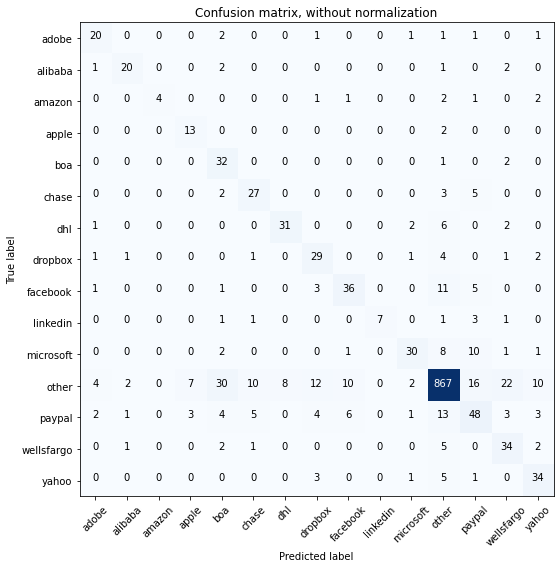

Acc     =  0.801
Pre     =  0.829
Rec     =  0.801
F1      =  0.807

Bal_Acc =  0.697
Bal_Pre =  0.695
Bal_Rec =  0.697
Bal_F1  =  0.696

              precision    recall  f1-score   support

       adobe       0.67      0.74      0.70        27
     alibaba       0.80      0.77      0.78        26
      amazon       1.00      0.36      0.53        11
       apple       0.57      0.87      0.68        15
         boa       0.41      0.91      0.57        35
       chase       0.60      0.73      0.66        37
         dhl       0.79      0.74      0.77        42
     dropbox       0.55      0.72      0.62        40
    facebook       0.67      0.63      0.65        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.79      0.57      0.66        53
       other       0.93      0.87      0.90      1000
      paypal       0.53      0.52      0.52        93
  wellsfargo       0.50      0.76      0.60        45
       yahoo       0.62      0.77      0.69        

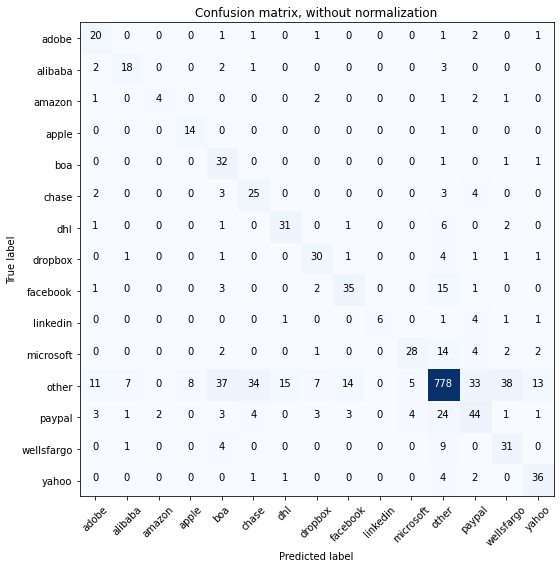

Acc     =  0.736
Pre     =  0.783
Rec     =  0.736
F1      =  0.748

Bal_Acc =  0.676
Bal_Pre =  0.618
Bal_Rec =  0.676
Bal_F1  =  0.646

              precision    recall  f1-score   support

       adobe       0.49      0.74      0.59        27
     alibaba       0.64      0.69      0.67        26
      amazon       0.67      0.36      0.47        11
       apple       0.64      0.93      0.76        15
         boa       0.36      0.91      0.52        35
       chase       0.38      0.68      0.49        37
         dhl       0.65      0.74      0.69        42
     dropbox       0.65      0.75      0.70        40
    facebook       0.65      0.61      0.63        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.76      0.53      0.62        53
       other       0.90      0.78      0.83      1000
      paypal       0.45      0.47      0.46        93
  wellsfargo       0.40      0.69      0.50        45
       yahoo       0.64      0.82      0.72        

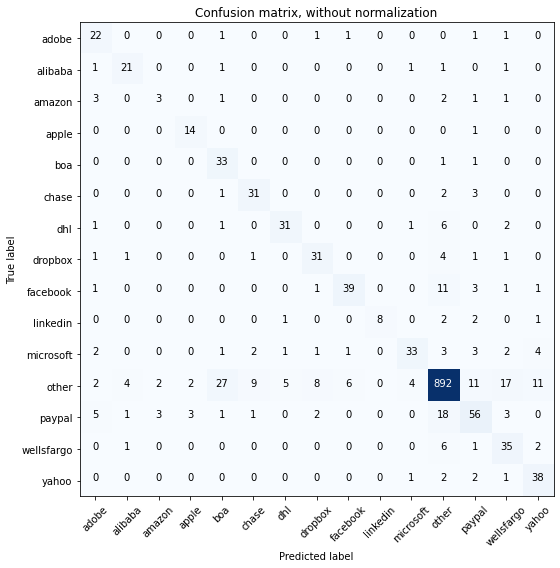

Acc     =  0.836
Pre     =  0.854
Rec     =  0.836
F1      =  0.84

Bal_Acc =  0.742
Bal_Pre =  0.707
Bal_Rec =  0.742
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.38      0.27      0.32        11
       apple       0.74      0.93      0.82        15
         boa       0.49      0.94      0.65        35
       chase       0.70      0.84      0.77        37
         dhl       0.82      0.74      0.78        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.83      0.68      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.89      0.91      1000
      paypal       0.65      0.60      0.63        93
  wellsfargo       0.54      0.78      0.64        45
       yahoo       0.67      0.86      0.75        4

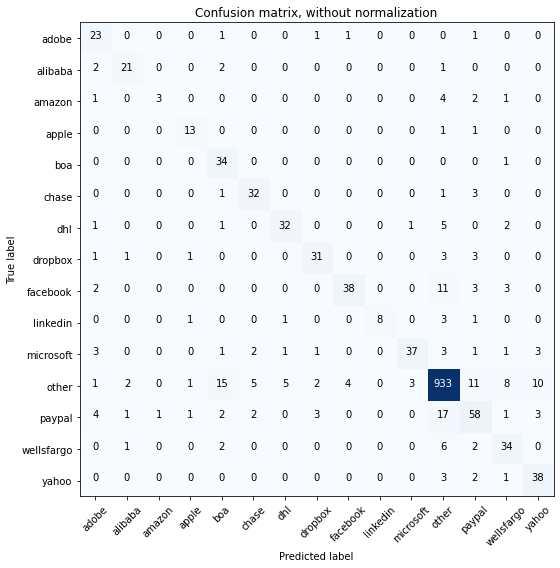

Acc     =  0.867
Pre     =  0.876
Rec     =  0.867
F1      =  0.867

Bal_Acc =  0.752
Bal_Pre =  0.778
Bal_Rec =  0.752
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.61      0.85      0.71        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.75      0.27      0.40        11
       apple       0.76      0.87      0.81        15
         boa       0.58      0.97      0.72        35
       chase       0.78      0.86      0.82        37
         dhl       0.82      0.76      0.79        42
     dropbox       0.82      0.78      0.79        40
    facebook       0.88      0.67      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.90      0.70      0.79        53
       other       0.94      0.93      0.94      1000
      paypal       0.66      0.62      0.64        93
  wellsfargo       0.65      0.76      0.70        45
       yahoo       0.70      0.86      0.78        

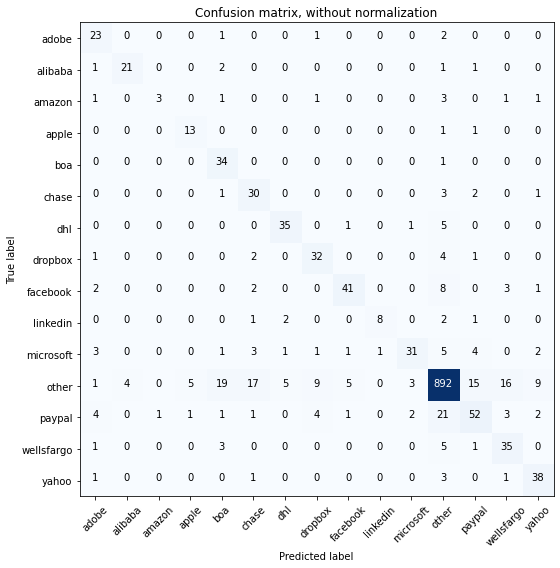

Acc     =  0.837
Pre     =  0.853
Rec     =  0.837
F1      =  0.839

Bal_Acc =  0.746
Bal_Pre =  0.726
Bal_Rec =  0.746
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.61      0.85      0.71        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.75      0.27      0.40        11
       apple       0.68      0.87      0.76        15
         boa       0.54      0.97      0.69        35
       chase       0.53      0.81      0.64        37
         dhl       0.81      0.83      0.82        42
     dropbox       0.67      0.80      0.73        40
    facebook       0.84      0.72      0.77        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.84      0.58      0.69        53
       other       0.93      0.89      0.91      1000
      paypal       0.67      0.56      0.61        93
  wellsfargo       0.59      0.78      0.67        45
       yahoo       0.70      0.86      0.78        

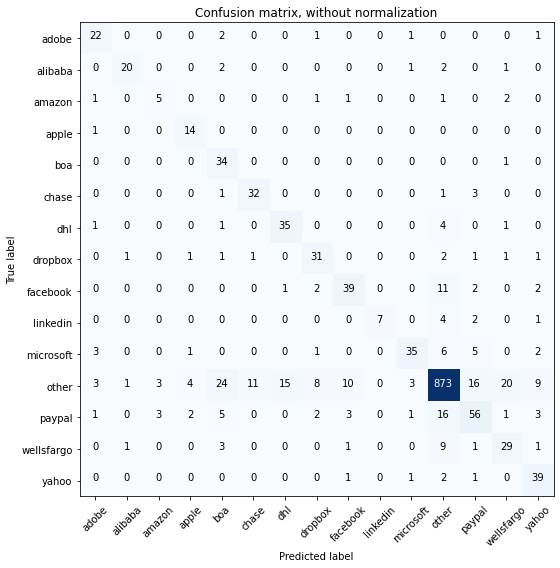

Acc     =  0.826
Pre     =  0.847
Rec     =  0.826
F1      =  0.831

Bal_Acc =  0.751
Bal_Pre =  0.7
Bal_Rec =  0.751
Bal_F1  =  0.725

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.45      0.45      0.45        11
       apple       0.64      0.93      0.76        15
         boa       0.47      0.97      0.63        35
       chase       0.73      0.86      0.79        37
         dhl       0.69      0.83      0.75        42
     dropbox       0.67      0.78      0.72        40
    facebook       0.71      0.68      0.70        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.83      0.66      0.74        53
       other       0.94      0.87      0.90      1000
      paypal       0.64      0.60      0.62        93
  wellsfargo       0.52      0.64      0.57        45
       yahoo       0.66      0.89      0.76        44

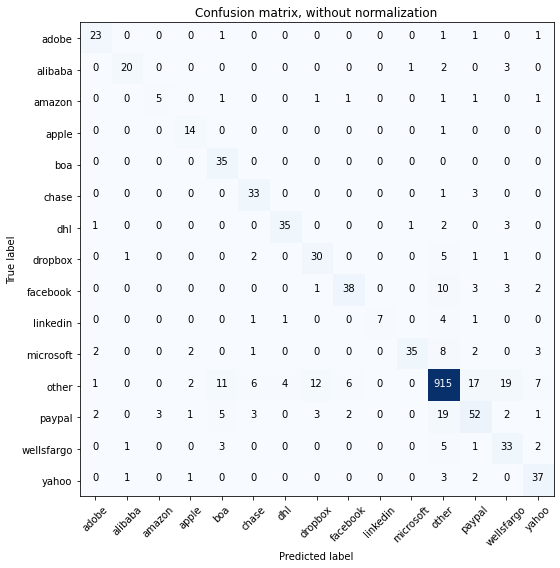

Acc     =  0.853
Pre     =  0.864
Rec     =  0.853
F1      =  0.854

Bal_Acc =  0.757
Bal_Pre =  0.757
Bal_Rec =  0.757
Bal_F1  =  0.757

              precision    recall  f1-score   support

       adobe       0.79      0.85      0.82        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.62      0.45      0.53        11
       apple       0.70      0.93      0.80        15
         boa       0.62      1.00      0.77        35
       chase       0.72      0.89      0.80        37
         dhl       0.88      0.83      0.85        42
     dropbox       0.64      0.75      0.69        40
    facebook       0.81      0.67      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.95      0.66      0.78        53
       other       0.94      0.92      0.93      1000
      paypal       0.62      0.56      0.59        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.69      0.84      0.76        

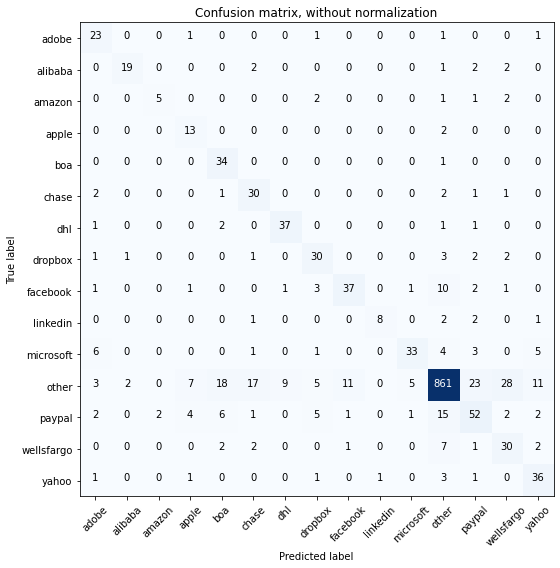

Acc     =  0.811
Pre     =  0.839
Rec     =  0.811
F1      =  0.818

Bal_Acc =  0.738
Bal_Pre =  0.677
Bal_Rec =  0.738
Bal_F1  =  0.706

              precision    recall  f1-score   support

       adobe       0.57      0.85      0.69        27
     alibaba       0.86      0.73      0.79        26
      amazon       0.71      0.45      0.56        11
       apple       0.48      0.87      0.62        15
         boa       0.54      0.97      0.69        35
       chase       0.55      0.81      0.65        37
         dhl       0.79      0.88      0.83        42
     dropbox       0.62      0.75      0.68        40
    facebook       0.74      0.65      0.69        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.86      0.90      1000
      paypal       0.57      0.56      0.57        93
  wellsfargo       0.44      0.67      0.53        45
       yahoo       0.62      0.82      0.71        

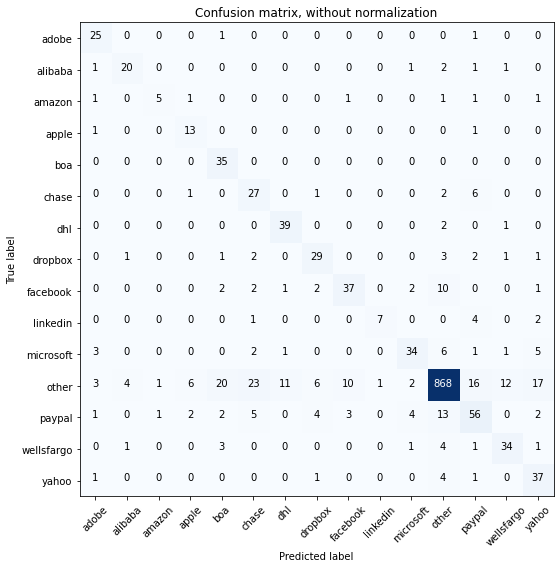

Acc     =  0.823
Pre     =  0.847
Rec     =  0.823
F1      =  0.829

Bal_Acc =  0.75
Bal_Pre =  0.688
Bal_Rec =  0.75
Bal_F1  =  0.718

              precision    recall  f1-score   support

       adobe       0.69      0.93      0.79        27
     alibaba       0.77      0.77      0.77        26
      amazon       0.71      0.45      0.56        11
       apple       0.57      0.87      0.68        15
         boa       0.55      1.00      0.71        35
       chase       0.44      0.73      0.55        37
         dhl       0.75      0.93      0.83        42
     dropbox       0.67      0.72      0.70        40
    facebook       0.73      0.65      0.69        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.77      0.64      0.70        53
       other       0.95      0.87      0.91      1000
      paypal       0.62      0.60      0.61        93
  wellsfargo       0.68      0.76      0.72        45
       yahoo       0.55      0.84      0.67        44

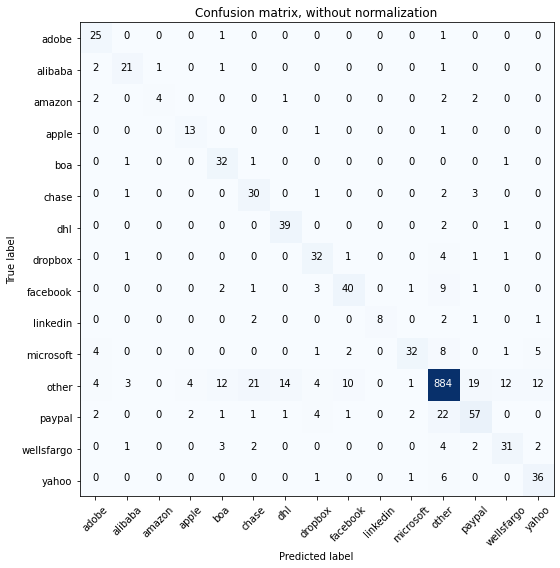

Acc     =  0.834
Pre     =  0.85
Rec     =  0.834
F1      =  0.837

Bal_Acc =  0.753
Bal_Pre =  0.727
Bal_Rec =  0.753
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.64      0.93      0.76        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.80      0.36      0.50        11
       apple       0.68      0.87      0.76        15
         boa       0.62      0.91      0.74        35
       chase       0.52      0.81      0.63        37
         dhl       0.71      0.93      0.80        42
     dropbox       0.68      0.80      0.74        40
    facebook       0.74      0.70      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.60      0.71        53
       other       0.93      0.88      0.91      1000
      paypal       0.66      0.61      0.64        93
  wellsfargo       0.66      0.69      0.67        45
       yahoo       0.64      0.82      0.72        44

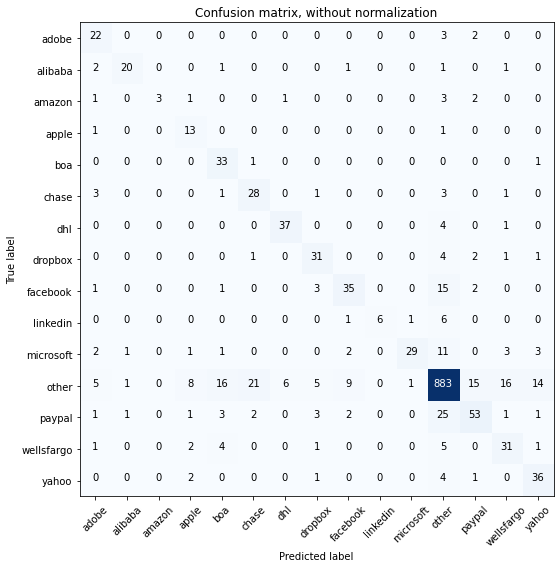

Acc     =  0.819
Pre     =  0.838
Rec     =  0.819
F1      =  0.82

Bal_Acc =  0.709
Bal_Pre =  0.729
Bal_Rec =  0.709
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.56      0.81      0.67        27
     alibaba       0.87      0.77      0.82        26
      amazon       1.00      0.27      0.43        11
       apple       0.46      0.87      0.60        15
         boa       0.55      0.94      0.69        35
       chase       0.53      0.76      0.62        37
         dhl       0.84      0.88      0.86        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.70      0.61      0.65        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.94      0.55      0.69        53
       other       0.91      0.88      0.90      1000
      paypal       0.69      0.57      0.62        93
  wellsfargo       0.56      0.69      0.62        45
       yahoo       0.63      0.82      0.71        4

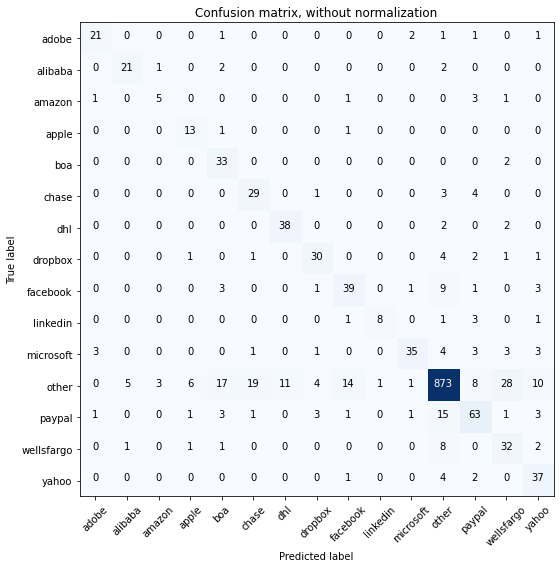

Acc     =  0.83
Pre     =  0.852
Rec     =  0.83
F1      =  0.836

Bal_Acc =  0.754
Bal_Pre =  0.701
Bal_Rec =  0.754
Bal_F1  =  0.727

              precision    recall  f1-score   support

       adobe       0.81      0.78      0.79        27
     alibaba       0.78      0.81      0.79        26
      amazon       0.56      0.45      0.50        11
       apple       0.59      0.87      0.70        15
         boa       0.54      0.94      0.69        35
       chase       0.57      0.78      0.66        37
         dhl       0.78      0.90      0.84        42
     dropbox       0.75      0.75      0.75        40
    facebook       0.67      0.68      0.68        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.88      0.66      0.75        53
       other       0.94      0.87      0.91      1000
      paypal       0.70      0.68      0.69        93
  wellsfargo       0.46      0.71      0.56        45
       yahoo       0.61      0.84      0.70        44

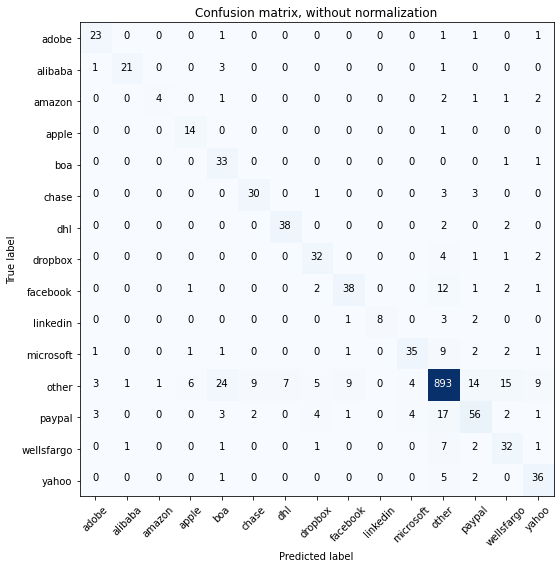

Acc     =  0.84
Pre     =  0.855
Rec     =  0.84
F1      =  0.843

Bal_Acc =  0.756
Bal_Pre =  0.749
Bal_Rec =  0.756
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.64      0.93      0.76        15
         boa       0.49      0.94      0.64        35
       chase       0.73      0.81      0.77        37
         dhl       0.84      0.90      0.87        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.76      0.67      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.66      0.73        53
       other       0.93      0.89      0.91      1000
      paypal       0.66      0.60      0.63        93
  wellsfargo       0.55      0.71      0.62        45
       yahoo       0.65      0.82      0.73        44

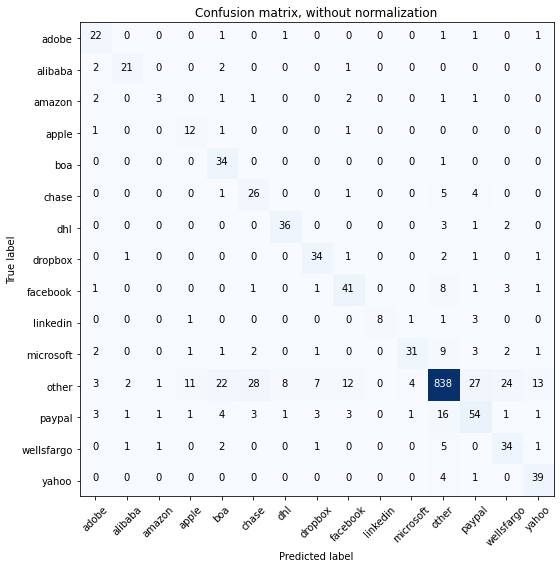

Acc     =  0.801
Pre     =  0.833
Rec     =  0.801
F1      =  0.809

Bal_Acc =  0.734
Bal_Pre =  0.666
Bal_Rec =  0.734
Bal_F1  =  0.698

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.50      0.27      0.35        11
       apple       0.46      0.80      0.59        15
         boa       0.49      0.97      0.65        35
       chase       0.43      0.70      0.53        37
         dhl       0.78      0.86      0.82        42
     dropbox       0.72      0.85      0.78        40
    facebook       0.66      0.72      0.69        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.58      0.69        53
       other       0.94      0.84      0.88      1000
      paypal       0.56      0.58      0.57        93
  wellsfargo       0.52      0.76      0.61        45
       yahoo       0.67      0.89      0.76        

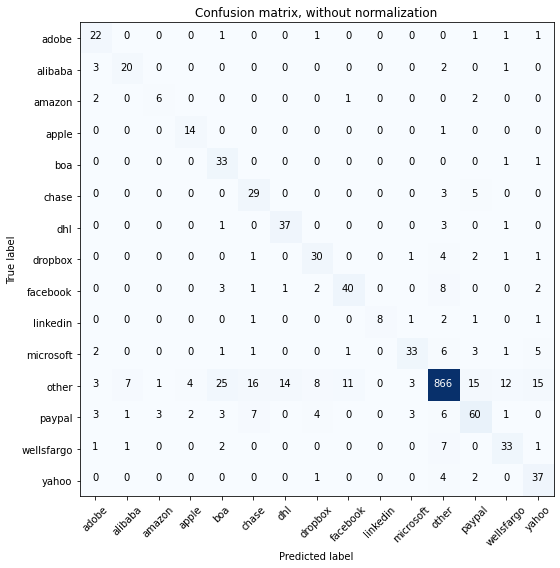

Acc     =  0.824
Pre     =  0.85
Rec     =  0.824
F1      =  0.831

Bal_Acc =  0.76
Bal_Pre =  0.689
Bal_Rec =  0.76
Bal_F1  =  0.723

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.69      0.77      0.73        26
      amazon       0.60      0.55      0.57        11
       apple       0.70      0.93      0.80        15
         boa       0.48      0.94      0.63        35
       chase       0.52      0.78      0.62        37
         dhl       0.71      0.88      0.79        42
     dropbox       0.65      0.75      0.70        40
    facebook       0.75      0.70      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.62      0.70        53
       other       0.95      0.87      0.91      1000
      paypal       0.66      0.65      0.65        93
  wellsfargo       0.63      0.73      0.68        45
       yahoo       0.58      0.84      0.69        44


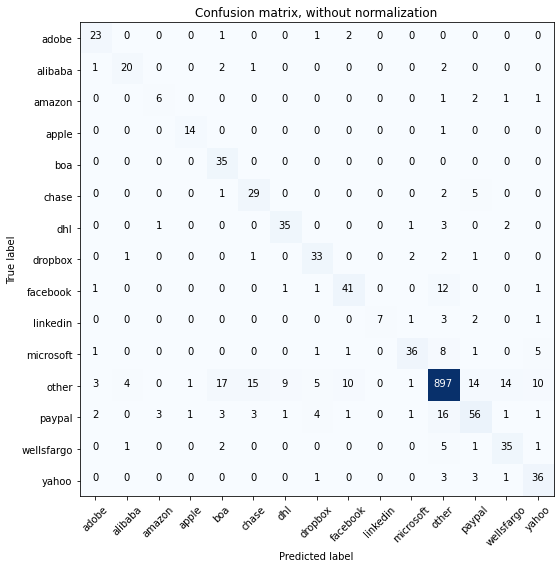

Acc     =  0.847
Pre     =  0.859
Rec     =  0.847
F1      =  0.849

Bal_Acc =  0.769
Bal_Pre =  0.741
Bal_Rec =  0.769
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.77      0.77      0.77        26
      amazon       0.60      0.55      0.57        11
       apple       0.88      0.93      0.90        15
         boa       0.57      1.00      0.73        35
       chase       0.59      0.78      0.67        37
         dhl       0.76      0.83      0.80        42
     dropbox       0.72      0.82      0.77        40
    facebook       0.75      0.72      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.68      0.76        53
       other       0.94      0.90      0.92      1000
      paypal       0.66      0.60      0.63        93
  wellsfargo       0.65      0.78      0.71        45
       yahoo       0.64      0.82      0.72        

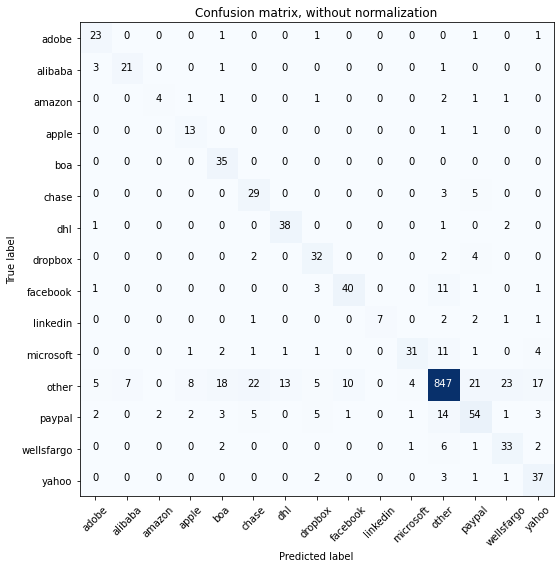

Acc     =  0.808
Pre     =  0.837
Rec     =  0.808
F1      =  0.815

Bal_Acc =  0.744
Bal_Pre =  0.682
Bal_Rec =  0.744
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.67      0.36      0.47        11
       apple       0.52      0.87      0.65        15
         boa       0.56      1.00      0.71        35
       chase       0.48      0.78      0.60        37
         dhl       0.73      0.90      0.81        42
     dropbox       0.64      0.80      0.71        40
    facebook       0.78      0.70      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.58      0.69        53
       other       0.94      0.85      0.89      1000
      paypal       0.58      0.58      0.58        93
  wellsfargo       0.53      0.73      0.62        45
       yahoo       0.56      0.84      0.67        

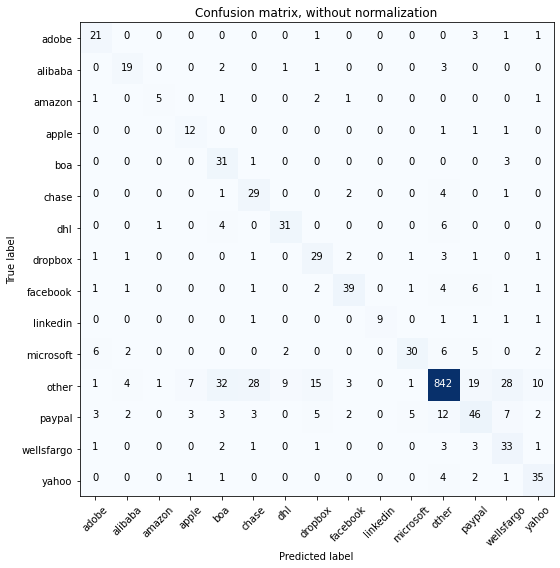

Acc     =  0.787
Pre     =  0.829
Rec     =  0.787
F1      =  0.799

Bal_Acc =  0.71
Bal_Pre =  0.647
Bal_Rec =  0.71
Bal_F1  =  0.677

              precision    recall  f1-score   support

       adobe       0.60      0.78      0.68        27
     alibaba       0.66      0.73      0.69        26
      amazon       0.71      0.45      0.56        11
       apple       0.52      0.80      0.63        15
         boa       0.40      0.89      0.55        35
       chase       0.45      0.78      0.57        37
         dhl       0.72      0.74      0.73        42
     dropbox       0.52      0.72      0.60        40
    facebook       0.80      0.68      0.74        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.79      0.57      0.66        53
       other       0.95      0.84      0.89      1000
      paypal       0.53      0.49      0.51        93
  wellsfargo       0.43      0.73      0.54        45
       yahoo       0.64      0.80      0.71        44

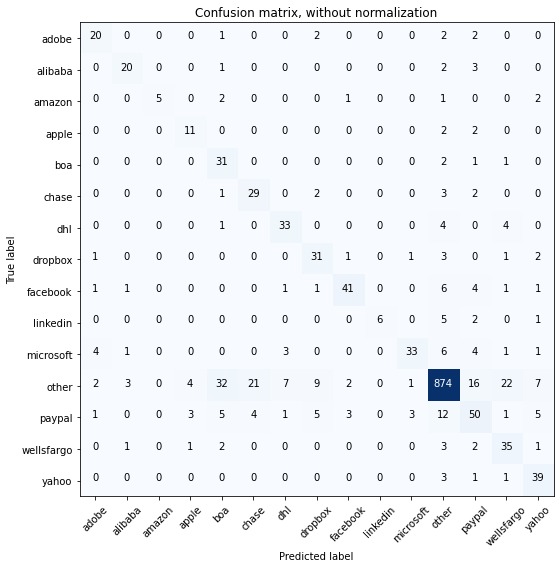

Acc     =  0.817
Pre     =  0.847
Rec     =  0.817
F1      =  0.825

Bal_Acc =  0.718
Bal_Pre =  0.716
Bal_Rec =  0.718
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.69      0.74      0.71        27
     alibaba       0.77      0.77      0.77        26
      amazon       1.00      0.45      0.62        11
       apple       0.58      0.73      0.65        15
         boa       0.41      0.89      0.56        35
       chase       0.54      0.78      0.64        37
         dhl       0.73      0.79      0.76        42
     dropbox       0.62      0.78      0.69        40
    facebook       0.85      0.72      0.78        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.87      0.91      1000
      paypal       0.56      0.54      0.55        93
  wellsfargo       0.52      0.78      0.62        45
       yahoo       0.66      0.89      0.76        

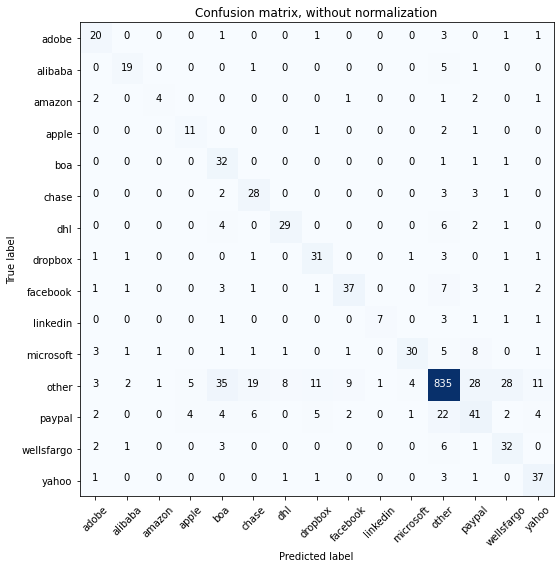

Acc     =  0.775
Pre     =  0.811
Rec     =  0.775
F1      =  0.785

Bal_Acc =  0.683
Bal_Pre =  0.644
Bal_Rec =  0.683
Bal_F1  =  0.663

              precision    recall  f1-score   support

       adobe       0.57      0.74      0.65        27
     alibaba       0.76      0.73      0.75        26
      amazon       0.67      0.36      0.47        11
       apple       0.55      0.73      0.63        15
         boa       0.37      0.91      0.53        35
       chase       0.49      0.76      0.60        37
         dhl       0.74      0.69      0.72        42
     dropbox       0.61      0.78      0.68        40
    facebook       0.74      0.65      0.69        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.83      0.57      0.67        53
       other       0.92      0.83      0.88      1000
      paypal       0.44      0.44      0.44        93
  wellsfargo       0.46      0.71      0.56        45
       yahoo       0.63      0.84      0.72        

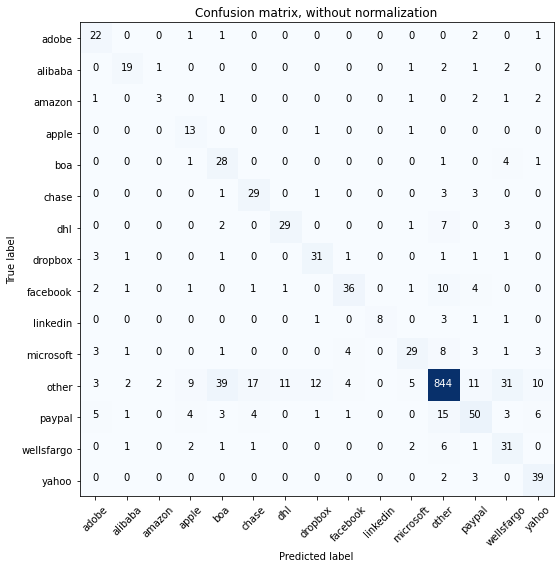

Acc     =  0.787
Pre     =  0.825
Rec     =  0.787
F1      =  0.797

Bal_Acc =  0.696
Bal_Pre =  0.637
Bal_Rec =  0.696
Bal_F1  =  0.665

              precision    recall  f1-score   support

       adobe       0.56      0.81      0.67        27
     alibaba       0.73      0.73      0.73        26
      amazon       0.50      0.27      0.35        11
       apple       0.42      0.87      0.57        15
         boa       0.36      0.80      0.50        35
       chase       0.56      0.78      0.65        37
         dhl       0.71      0.69      0.70        42
     dropbox       0.66      0.78      0.71        40
    facebook       0.78      0.63      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.71      0.55      0.62        53
       other       0.94      0.84      0.89      1000
      paypal       0.61      0.54      0.57        93
  wellsfargo       0.40      0.69      0.50        45
       yahoo       0.63      0.89      0.74        

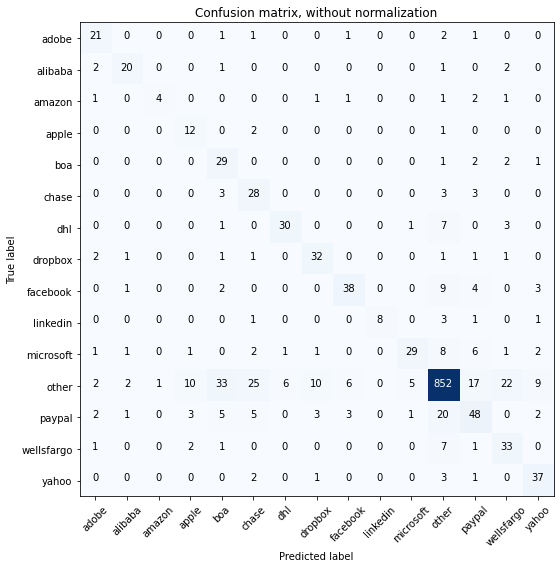

Acc     =  0.793
Pre     =  0.828
Rec     =  0.793
F1      =  0.803

Bal_Acc =  0.703
Bal_Pre =  0.678
Bal_Rec =  0.703
Bal_F1  =  0.69

              precision    recall  f1-score   support

       adobe       0.66      0.78      0.71        27
     alibaba       0.77      0.77      0.77        26
      amazon       0.80      0.36      0.50        11
       apple       0.43      0.80      0.56        15
         boa       0.38      0.83      0.52        35
       chase       0.42      0.76      0.54        37
         dhl       0.81      0.71      0.76        42
     dropbox       0.67      0.80      0.73        40
    facebook       0.78      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.55      0.65        53
       other       0.93      0.85      0.89      1000
      paypal       0.55      0.52      0.53        93
  wellsfargo       0.51      0.73      0.60        45
       yahoo       0.67      0.84      0.75        4

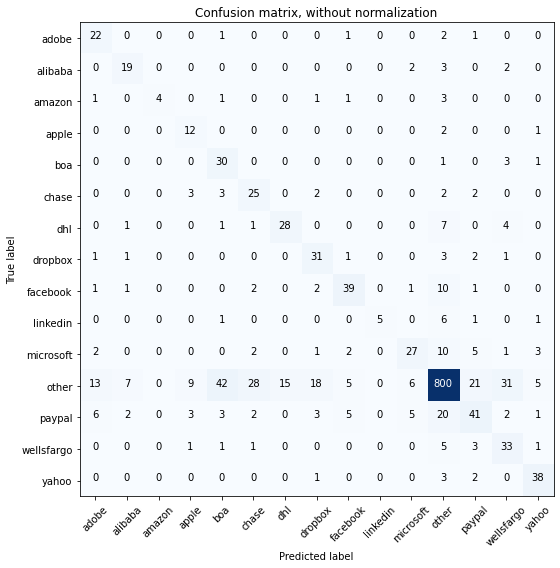

Acc     =  0.75
Pre     =  0.796
Rec     =  0.75
F1      =  0.761

Bal_Acc =  0.671
Bal_Pre =  0.63
Bal_Rec =  0.671
Bal_F1  =  0.65

              precision    recall  f1-score   support

       adobe       0.48      0.81      0.60        27
     alibaba       0.61      0.73      0.67        26
      amazon       1.00      0.36      0.53        11
       apple       0.43      0.80      0.56        15
         boa       0.36      0.86      0.51        35
       chase       0.41      0.68      0.51        37
         dhl       0.65      0.67      0.66        42
     dropbox       0.53      0.78      0.63        40
    facebook       0.72      0.68      0.70        57
    linkedin       1.00      0.36      0.53        14
   microsoft       0.66      0.51      0.57        53
       other       0.91      0.80      0.85      1000
      paypal       0.52      0.44      0.48        93
  wellsfargo       0.43      0.73      0.54        45
       yahoo       0.75      0.86      0.80        44



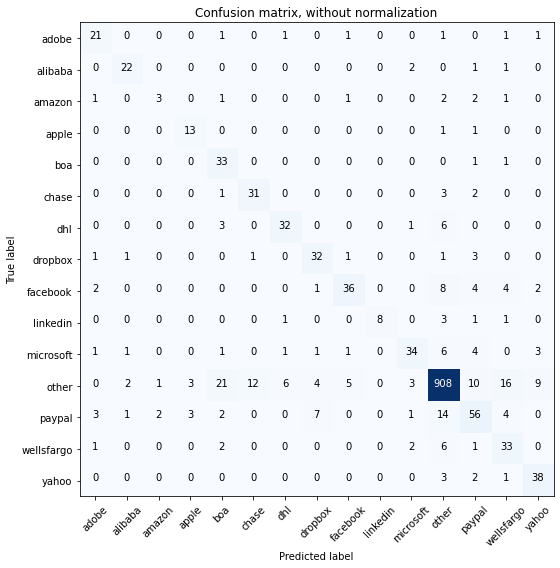

Acc     =  0.845
Pre     =  0.858
Rec     =  0.845
F1      =  0.847

Bal_Acc =  0.737
Bal_Pre =  0.721
Bal_Rec =  0.737
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.50      0.27      0.35        11
       apple       0.68      0.87      0.76        15
         boa       0.51      0.94      0.66        35
       chase       0.70      0.84      0.77        37
         dhl       0.78      0.76      0.77        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.80      0.63      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.64      0.71        53
       other       0.94      0.91      0.93      1000
      paypal       0.64      0.60      0.62        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.72      0.86      0.78        

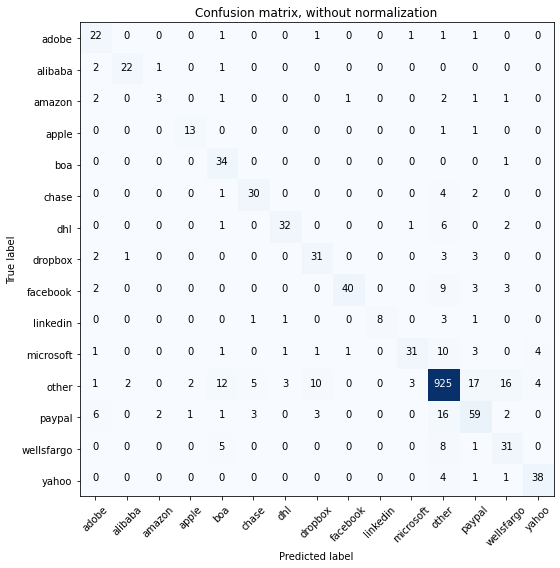

Acc     =  0.857
Pre     =  0.867
Rec     =  0.857
F1      =  0.858

Bal_Acc =  0.739
Bal_Pre =  0.761
Bal_Rec =  0.739
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.50      0.27      0.35        11
       apple       0.81      0.87      0.84        15
         boa       0.59      0.97      0.73        35
       chase       0.77      0.81      0.79        37
         dhl       0.86      0.76      0.81        42
     dropbox       0.67      0.78      0.72        40
    facebook       0.95      0.70      0.81        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.58      0.70        53
       other       0.93      0.93      0.93      1000
      paypal       0.63      0.63      0.63        93
  wellsfargo       0.54      0.69      0.61        45
       yahoo       0.83      0.86      0.84        4

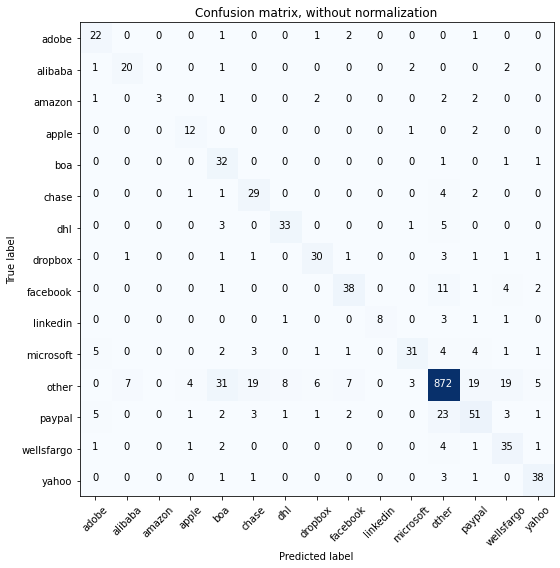

Acc     =  0.815
Pre     =  0.842
Rec     =  0.815
F1      =  0.821

Bal_Acc =  0.718
Bal_Pre =  0.718
Bal_Rec =  0.718
Bal_F1  =  0.718

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.71      0.77      0.74        26
      amazon       1.00      0.27      0.43        11
       apple       0.63      0.80      0.71        15
         boa       0.41      0.91      0.56        35
       chase       0.52      0.78      0.62        37
         dhl       0.77      0.79      0.78        42
     dropbox       0.73      0.75      0.74        40
    facebook       0.75      0.67      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.58      0.68        53
       other       0.93      0.87      0.90      1000
      paypal       0.59      0.55      0.57        93
  wellsfargo       0.52      0.78      0.62        45
       yahoo       0.76      0.86      0.81        

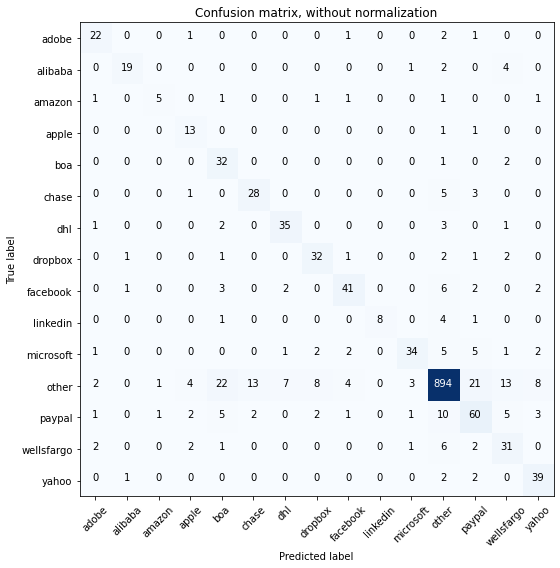

Acc     =  0.84
Pre     =  0.86
Rec     =  0.84
F1      =  0.845

Bal_Acc =  0.748
Bal_Pre =  0.729
Bal_Rec =  0.748
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.86      0.73      0.79        26
      amazon       0.71      0.45      0.56        11
       apple       0.57      0.87      0.68        15
         boa       0.47      0.91      0.62        35
       chase       0.65      0.76      0.70        37
         dhl       0.78      0.83      0.80        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.80      0.72      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.64      0.73        53
       other       0.95      0.89      0.92      1000
      paypal       0.61      0.65      0.62        93
  wellsfargo       0.53      0.69      0.60        45
       yahoo       0.71      0.89      0.79        44


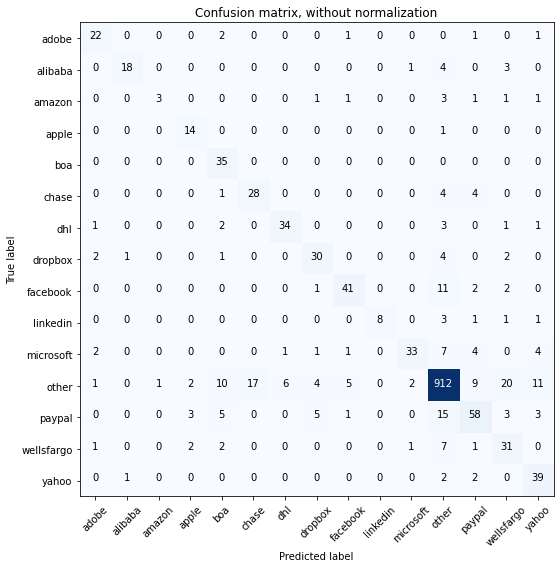

Acc     =  0.849
Pre     =  0.862
Rec     =  0.849
F1      =  0.85

Bal_Acc =  0.737
Bal_Pre =  0.754
Bal_Rec =  0.737
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.90      0.69      0.78        26
      amazon       0.75      0.27      0.40        11
       apple       0.67      0.93      0.78        15
         boa       0.60      1.00      0.75        35
       chase       0.62      0.76      0.68        37
         dhl       0.83      0.81      0.82        42
     dropbox       0.71      0.75      0.73        40
    facebook       0.82      0.72      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.93      0.91      0.92      1000
      paypal       0.70      0.62      0.66        93
  wellsfargo       0.48      0.69      0.57        45
       yahoo       0.64      0.89      0.74        4

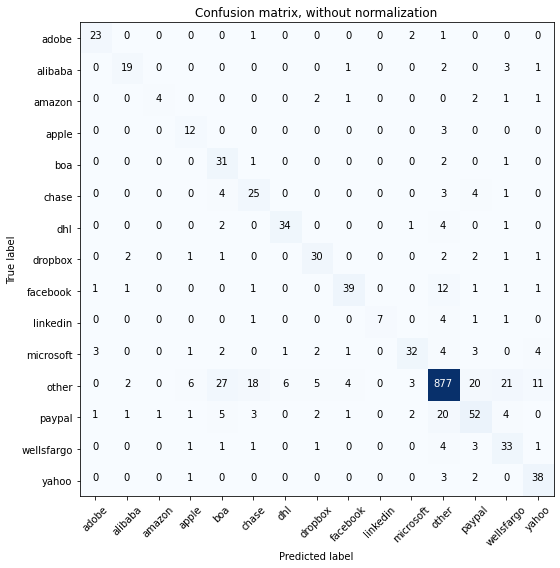

Acc     =  0.816
Pre     =  0.841
Rec     =  0.816
F1      =  0.823

Bal_Acc =  0.713
Bal_Pre =  0.709
Bal_Rec =  0.713
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.82      0.85      0.84        27
     alibaba       0.76      0.73      0.75        26
      amazon       0.80      0.36      0.50        11
       apple       0.52      0.80      0.63        15
         boa       0.42      0.89      0.57        35
       chase       0.49      0.68      0.57        37
         dhl       0.83      0.81      0.82        42
     dropbox       0.71      0.75      0.73        40
    facebook       0.83      0.68      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.80      0.60      0.69        53
       other       0.93      0.88      0.90      1000
      paypal       0.58      0.56      0.57        93
  wellsfargo       0.49      0.73      0.58        45
       yahoo       0.66      0.86      0.75        

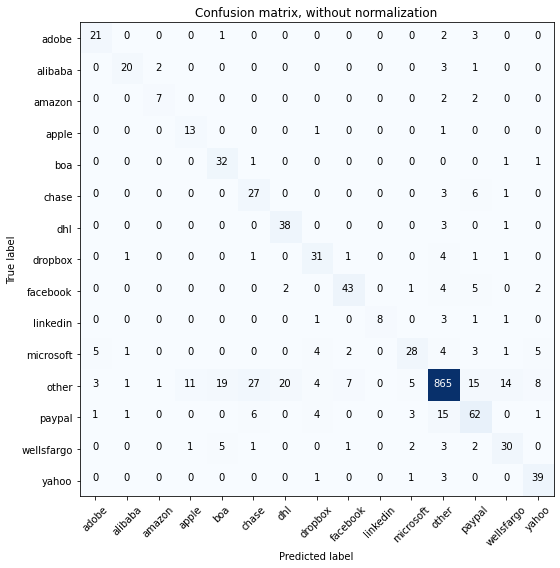

Acc     =  0.821
Pre     =  0.846
Rec     =  0.821
F1      =  0.828

Bal_Acc =  0.754
Bal_Pre =  0.693
Bal_Rec =  0.754
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.70      0.64      0.67        11
       apple       0.52      0.87      0.65        15
         boa       0.56      0.91      0.70        35
       chase       0.43      0.73      0.54        37
         dhl       0.63      0.90      0.75        42
     dropbox       0.67      0.78      0.72        40
    facebook       0.80      0.75      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.70      0.53      0.60        53
       other       0.95      0.86      0.90      1000
      paypal       0.61      0.67      0.64        93
  wellsfargo       0.60      0.67      0.63        45
       yahoo       0.70      0.89      0.78        

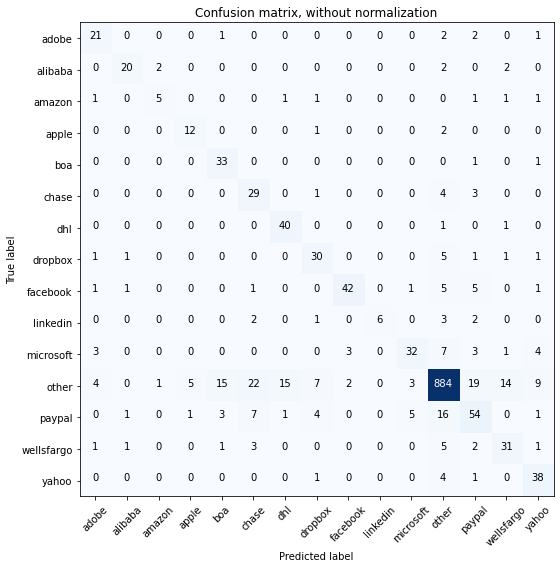

Acc     =  0.83
Pre     =  0.849
Rec     =  0.83
F1      =  0.834

Bal_Acc =  0.734
Bal_Pre =  0.711
Bal_Rec =  0.734
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.66      0.78      0.71        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.62      0.45      0.53        11
       apple       0.67      0.80      0.73        15
         boa       0.62      0.94      0.75        35
       chase       0.45      0.78      0.57        37
         dhl       0.70      0.95      0.81        42
     dropbox       0.65      0.75      0.70        40
    facebook       0.89      0.74      0.81        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.78      0.60      0.68        53
       other       0.94      0.88      0.91      1000
      paypal       0.57      0.58      0.58        93
  wellsfargo       0.61      0.69      0.65        45
       yahoo       0.66      0.86      0.75        44

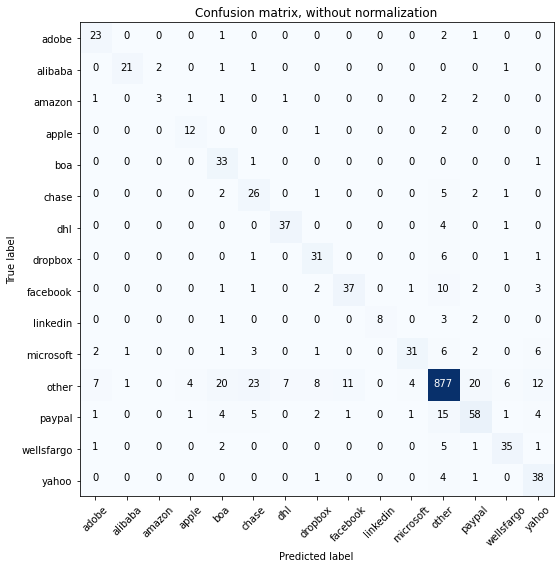

Acc     =  0.825
Pre     =  0.847
Rec     =  0.825
F1      =  0.83

Bal_Acc =  0.732
Bal_Pre =  0.716
Bal_Rec =  0.732
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.60      0.27      0.37        11
       apple       0.67      0.80      0.73        15
         boa       0.49      0.94      0.65        35
       chase       0.43      0.70      0.53        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.66      0.78      0.71        40
    facebook       0.76      0.65      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.58      0.69        53
       other       0.93      0.88      0.90      1000
      paypal       0.64      0.62      0.63        93
  wellsfargo       0.76      0.78      0.77        45
       yahoo       0.58      0.86      0.69        4

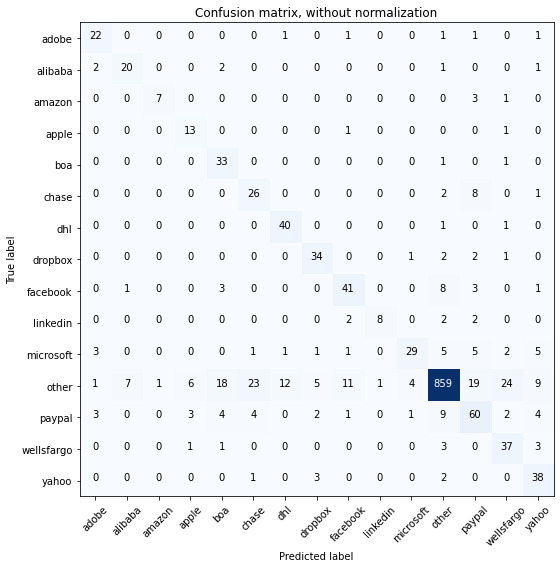

Acc     =  0.823
Pre     =  0.853
Rec     =  0.823
F1      =  0.831

Bal_Acc =  0.771
Bal_Pre =  0.698
Bal_Rec =  0.771
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.71      0.77      0.74        26
      amazon       0.88      0.64      0.74        11
       apple       0.57      0.87      0.68        15
         boa       0.54      0.94      0.69        35
       chase       0.47      0.70      0.57        37
         dhl       0.74      0.95      0.83        42
     dropbox       0.76      0.85      0.80        40
    facebook       0.71      0.72      0.71        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.83      0.55      0.66        53
       other       0.96      0.86      0.91      1000
      paypal       0.58      0.65      0.61        93
  wellsfargo       0.53      0.82      0.64        45
       yahoo       0.60      0.86      0.71        

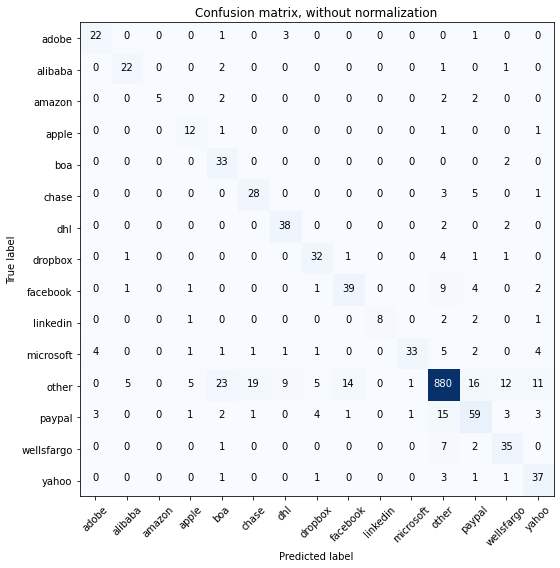

Acc     =  0.834
Pre     =  0.856
Rec     =  0.834
F1      =  0.839

Bal_Acc =  0.755
Bal_Pre =  0.738
Bal_Rec =  0.755
Bal_F1  =  0.746

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.76      0.85      0.80        26
      amazon       1.00      0.45      0.62        11
       apple       0.57      0.80      0.67        15
         boa       0.49      0.94      0.65        35
       chase       0.57      0.76      0.65        37
         dhl       0.75      0.90      0.82        42
     dropbox       0.73      0.80      0.76        40
    facebook       0.71      0.68      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.94      0.62      0.75        53
       other       0.94      0.88      0.91      1000
      paypal       0.62      0.63      0.63        93
  wellsfargo       0.61      0.78      0.69        45
       yahoo       0.62      0.84      0.71        

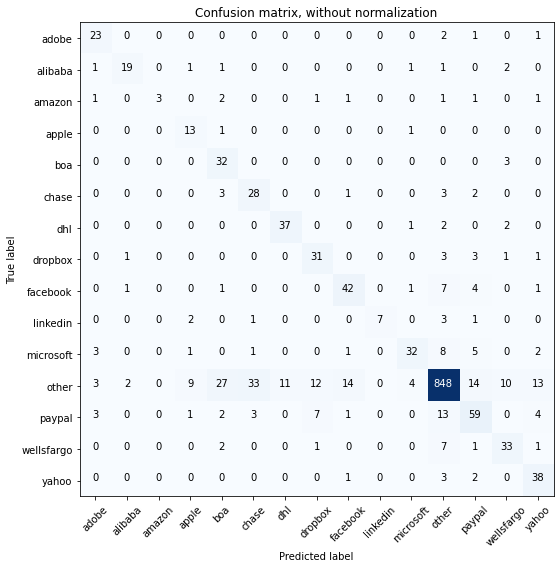

Acc     =  0.809
Pre     =  0.843
Rec     =  0.809
F1      =  0.817

Bal_Acc =  0.731
Bal_Pre =  0.703
Bal_Rec =  0.731
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       0.83      0.73      0.78        26
      amazon       1.00      0.27      0.43        11
       apple       0.48      0.87      0.62        15
         boa       0.45      0.91      0.60        35
       chase       0.42      0.76      0.54        37
         dhl       0.77      0.88      0.82        42
     dropbox       0.60      0.78      0.67        40
    facebook       0.69      0.74      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.80      0.60      0.69        53
       other       0.94      0.85      0.89      1000
      paypal       0.63      0.63      0.63        93
  wellsfargo       0.65      0.73      0.69        45
       yahoo       0.61      0.86      0.72        

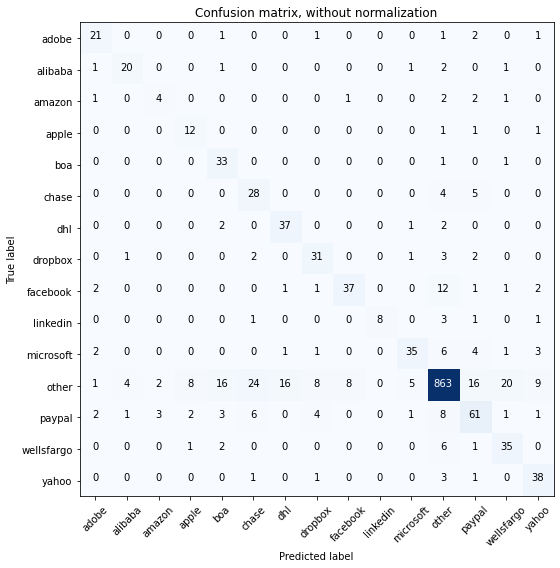

Acc     =  0.821
Pre     =  0.845
Rec     =  0.821
F1      =  0.827

Bal_Acc =  0.74
Bal_Pre =  0.681
Bal_Rec =  0.74
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.77      0.77      0.77        26
      amazon       0.44      0.36      0.40        11
       apple       0.52      0.80      0.63        15
         boa       0.57      0.94      0.71        35
       chase       0.45      0.76      0.57        37
         dhl       0.67      0.88      0.76        42
     dropbox       0.66      0.78      0.71        40
    facebook       0.80      0.65      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.66      0.72        53
       other       0.94      0.86      0.90      1000
      paypal       0.63      0.66      0.64        93
  wellsfargo       0.57      0.78      0.66        45
       yahoo       0.68      0.86      0.76        44

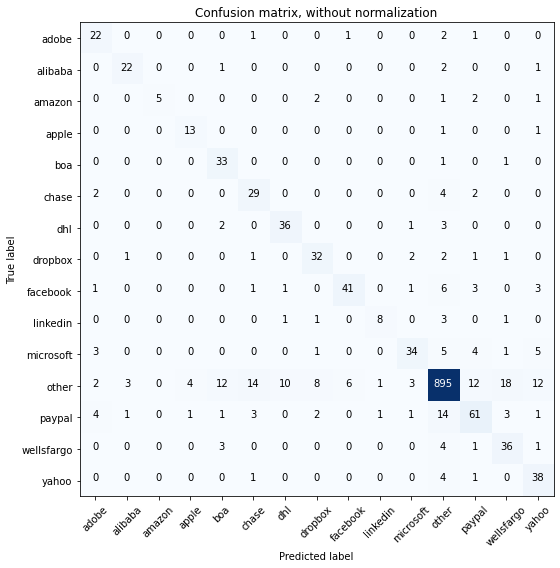

Acc     =  0.848
Pre     =  0.864
Rec     =  0.848
F1      =  0.851

Bal_Acc =  0.768
Bal_Pre =  0.743
Bal_Rec =  0.768
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.81      0.85      0.83        26
      amazon       1.00      0.45      0.62        11
       apple       0.72      0.87      0.79        15
         boa       0.63      0.94      0.76        35
       chase       0.58      0.78      0.67        37
         dhl       0.75      0.86      0.80        42
     dropbox       0.70      0.80      0.74        40
    facebook       0.85      0.72      0.78        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.81      0.64      0.72        53
       other       0.95      0.90      0.92      1000
      paypal       0.69      0.66      0.67        93
  wellsfargo       0.59      0.80      0.68        45
       yahoo       0.60      0.86      0.71        

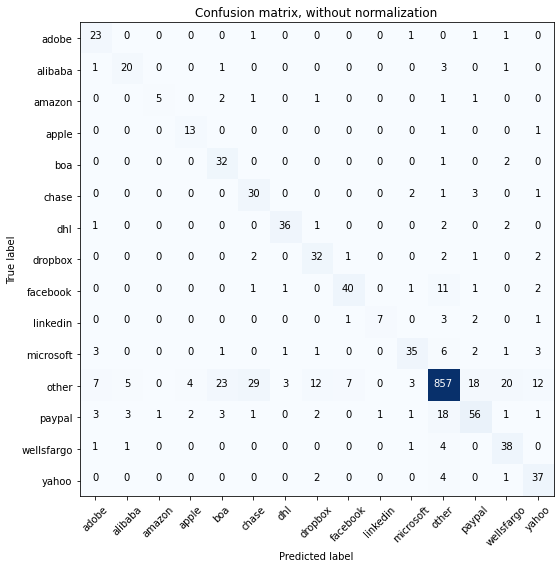

Acc     =  0.819
Pre     =  0.847
Rec     =  0.819
F1      =  0.826

Bal_Acc =  0.755
Bal_Pre =  0.703
Bal_Rec =  0.755
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.69      0.77      0.73        26
      amazon       0.83      0.45      0.59        11
       apple       0.68      0.87      0.76        15
         boa       0.52      0.91      0.66        35
       chase       0.46      0.81      0.59        37
         dhl       0.88      0.86      0.87        42
     dropbox       0.63      0.80      0.70        40
    facebook       0.82      0.70      0.75        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.80      0.66      0.72        53
       other       0.94      0.86      0.90      1000
      paypal       0.66      0.60      0.63        93
  wellsfargo       0.57      0.84      0.68        45
       yahoo       0.62      0.84      0.71        

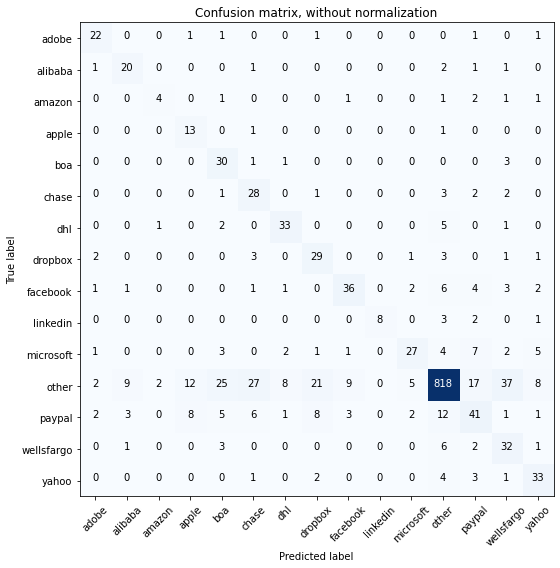

Acc     =  0.763
Pre     =  0.813
Rec     =  0.763
F1      =  0.777

Bal_Acc =  0.691
Bal_Pre =  0.609
Bal_Rec =  0.691
Bal_F1  =  0.647

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.59      0.77      0.67        26
      amazon       0.57      0.36      0.44        11
       apple       0.38      0.87      0.53        15
         boa       0.42      0.86      0.57        35
       chase       0.41      0.76      0.53        37
         dhl       0.72      0.79      0.75        42
     dropbox       0.46      0.72      0.56        40
    facebook       0.72      0.63      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.73      0.51      0.60        53
       other       0.94      0.82      0.88      1000
      paypal       0.50      0.44      0.47        93
  wellsfargo       0.38      0.71      0.49        45
       yahoo       0.61      0.75      0.67        

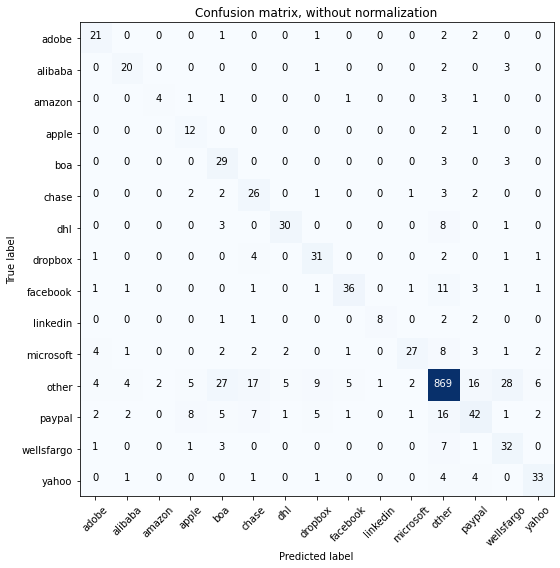

Acc     =  0.793
Pre     =  0.822
Rec     =  0.793
F1      =  0.8

Bal_Acc =  0.682
Bal_Pre =  0.656
Bal_Rec =  0.682
Bal_F1  =  0.669

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        27
     alibaba       0.69      0.77      0.73        26
      amazon       0.67      0.36      0.47        11
       apple       0.41      0.80      0.55        15
         boa       0.39      0.83      0.53        35
       chase       0.44      0.70      0.54        37
         dhl       0.79      0.71      0.75        42
     dropbox       0.62      0.78      0.69        40
    facebook       0.82      0.63      0.71        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.84      0.51      0.64        53
       other       0.92      0.87      0.89      1000
      paypal       0.55      0.45      0.49        93
  wellsfargo       0.45      0.71      0.55        45
       yahoo       0.73      0.75      0.74        44

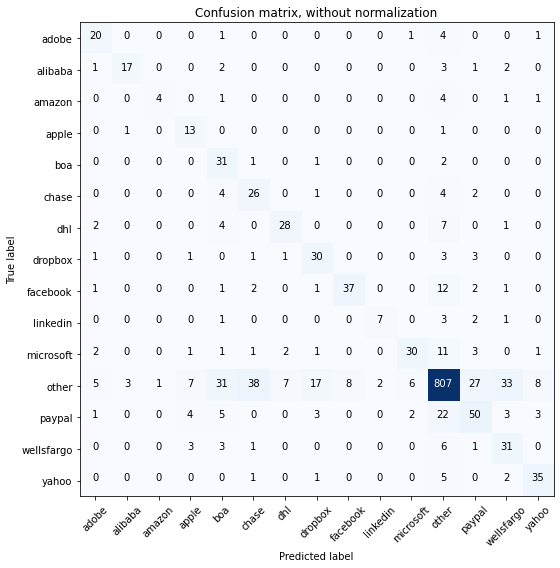

Acc     =  0.758
Pre     =  0.802
Rec     =  0.758
F1      =  0.77

Bal_Acc =  0.678
Bal_Pre =  0.642
Bal_Rec =  0.678
Bal_F1  =  0.66

              precision    recall  f1-score   support

       adobe       0.61      0.74      0.67        27
     alibaba       0.81      0.65      0.72        26
      amazon       0.80      0.36      0.50        11
       apple       0.45      0.87      0.59        15
         boa       0.36      0.89      0.52        35
       chase       0.37      0.70      0.48        37
         dhl       0.74      0.67      0.70        42
     dropbox       0.55      0.75      0.63        40
    facebook       0.82      0.65      0.73        57
    linkedin       0.78      0.50      0.61        14
   microsoft       0.77      0.57      0.65        53
       other       0.90      0.81      0.85      1000
      paypal       0.55      0.54      0.54        93
  wellsfargo       0.41      0.69      0.52        45
       yahoo       0.71      0.80      0.75        44

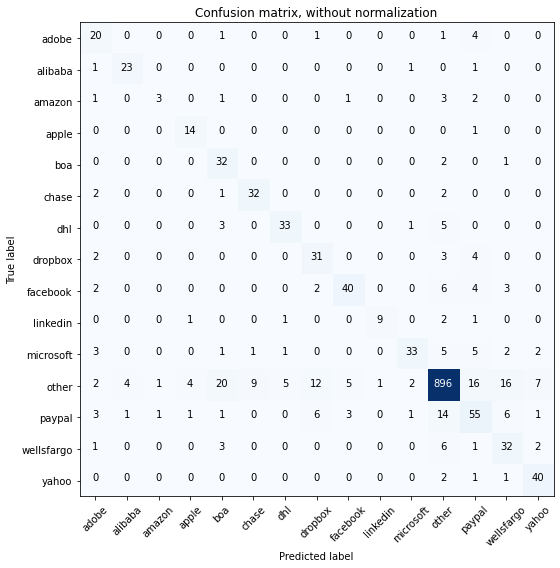

Acc     =  0.84
Pre     =  0.858
Rec     =  0.84
F1      =  0.844

Bal_Acc =  0.75
Bal_Pre =  0.717
Bal_Rec =  0.75
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.54      0.74      0.62        27
     alibaba       0.82      0.88      0.85        26
      amazon       0.60      0.27      0.37        11
       apple       0.70      0.93      0.80        15
         boa       0.51      0.91      0.65        35
       chase       0.76      0.86      0.81        37
         dhl       0.82      0.79      0.80        42
     dropbox       0.60      0.78      0.67        40
    facebook       0.82      0.70      0.75        57
    linkedin       0.90      0.64      0.75        14
   microsoft       0.87      0.62      0.73        53
       other       0.95      0.90      0.92      1000
      paypal       0.58      0.59      0.59        93
  wellsfargo       0.52      0.71      0.60        45
       yahoo       0.77      0.91      0.83        44



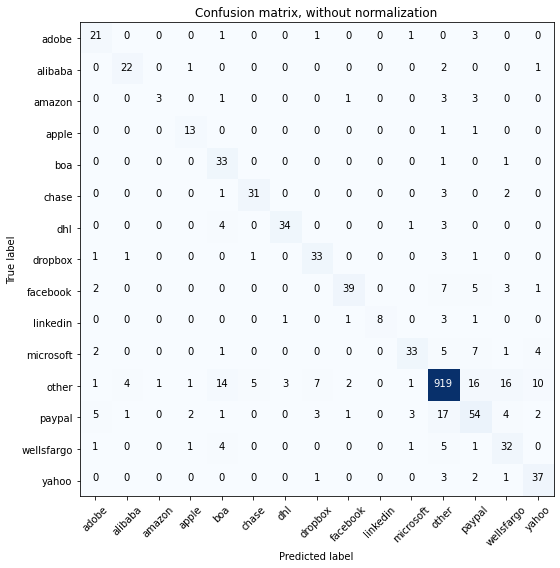

Acc     =  0.853
Pre     =  0.865
Rec     =  0.853
F1      =  0.854

Bal_Acc =  0.741
Bal_Pre =  0.756
Bal_Rec =  0.741
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        27
     alibaba       0.79      0.85      0.81        26
      amazon       0.75      0.27      0.40        11
       apple       0.72      0.87      0.79        15
         boa       0.55      0.94      0.69        35
       chase       0.84      0.84      0.84        37
         dhl       0.89      0.81      0.85        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.89      0.68      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.92      0.93      1000
      paypal       0.57      0.58      0.58        93
  wellsfargo       0.53      0.71      0.61        45
       yahoo       0.67      0.84      0.75        

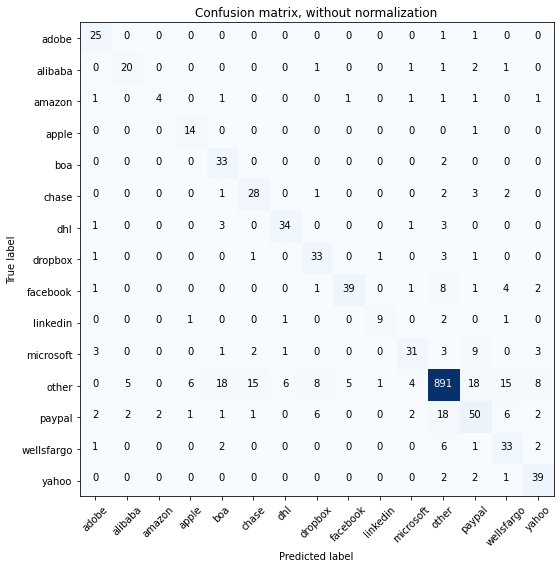

Acc     =  0.834
Pre     =  0.85
Rec     =  0.834
F1      =  0.837

Bal_Acc =  0.752
Bal_Pre =  0.702
Bal_Rec =  0.752
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.71      0.93      0.81        27
     alibaba       0.74      0.77      0.75        26
      amazon       0.67      0.36      0.47        11
       apple       0.64      0.93      0.76        15
         boa       0.55      0.94      0.69        35
       chase       0.60      0.76      0.67        37
         dhl       0.81      0.81      0.81        42
     dropbox       0.66      0.82      0.73        40
    facebook       0.87      0.68      0.76        57
    linkedin       0.82      0.64      0.72        14
   microsoft       0.76      0.58      0.66        53
       other       0.94      0.89      0.92      1000
      paypal       0.56      0.54      0.55        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.68      0.89      0.77        4

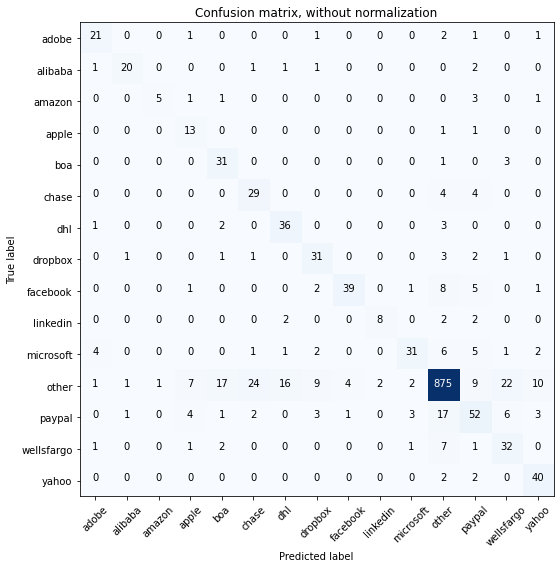

Acc     =  0.821
Pre     =  0.845
Rec     =  0.821
F1      =  0.827

Bal_Acc =  0.738
Bal_Pre =  0.696
Bal_Rec =  0.738
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.83      0.45      0.59        11
       apple       0.46      0.87      0.60        15
         boa       0.56      0.89      0.69        35
       chase       0.50      0.78      0.61        37
         dhl       0.64      0.86      0.73        42
     dropbox       0.63      0.78      0.70        40
    facebook       0.89      0.68      0.77        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.94      0.88      0.91      1000
      paypal       0.58      0.56      0.57        93
  wellsfargo       0.49      0.71      0.58        45
       yahoo       0.69      0.91      0.78        

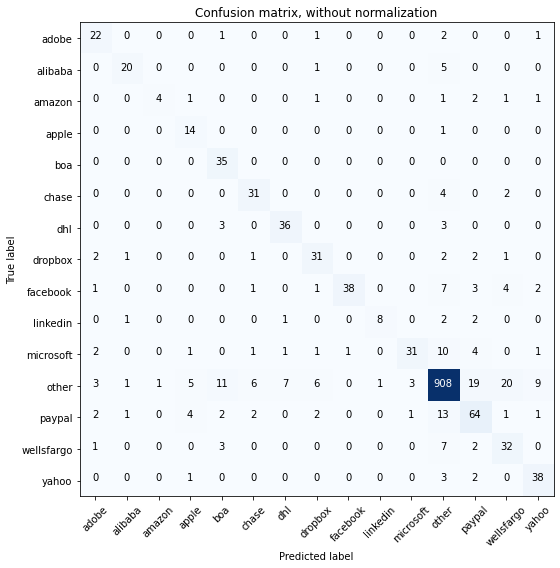

Acc     =  0.853
Pre     =  0.868
Rec     =  0.853
F1      =  0.855

Bal_Acc =  0.756
Bal_Pre =  0.752
Bal_Rec =  0.756
Bal_F1  =  0.754

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.80      0.36      0.50        11
       apple       0.54      0.93      0.68        15
         boa       0.64      1.00      0.78        35
       chase       0.74      0.84      0.78        37
         dhl       0.80      0.86      0.83        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.97      0.67      0.79        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.89      0.58      0.70        53
       other       0.94      0.91      0.92      1000
      paypal       0.64      0.69      0.66        93
  wellsfargo       0.52      0.71      0.60        45
       yahoo       0.72      0.86      0.78        

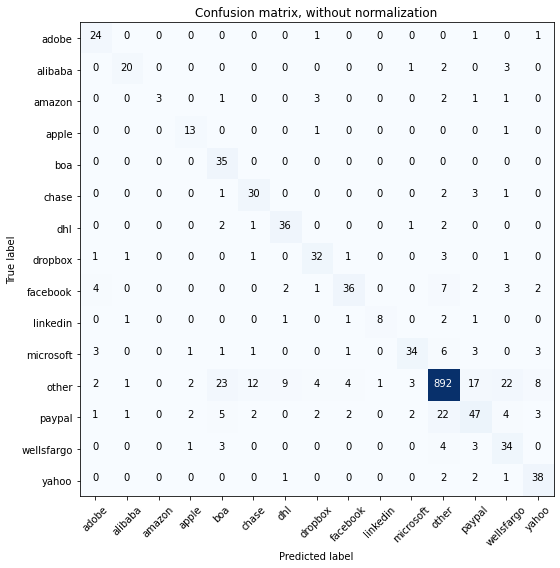

Acc     =  0.833
Pre     =  0.854
Rec     =  0.833
F1      =  0.836

Bal_Acc =  0.742
Bal_Pre =  0.734
Bal_Rec =  0.742
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.69      0.89      0.77        27
     alibaba       0.83      0.77      0.80        26
      amazon       1.00      0.27      0.43        11
       apple       0.68      0.87      0.76        15
         boa       0.49      1.00      0.66        35
       chase       0.64      0.81      0.71        37
         dhl       0.73      0.86      0.79        42
     dropbox       0.73      0.80      0.76        40
    facebook       0.80      0.63      0.71        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.83      0.64      0.72        53
       other       0.94      0.89      0.92      1000
      paypal       0.59      0.51      0.54        93
  wellsfargo       0.48      0.76      0.59        45
       yahoo       0.69      0.86      0.77        

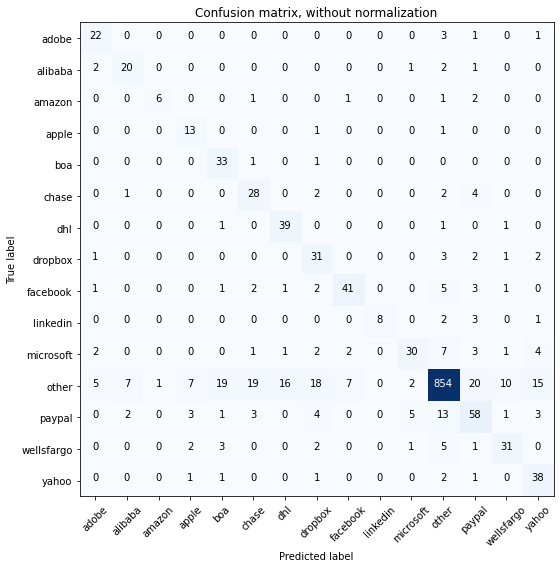

Acc     =  0.814
Pre     =  0.844
Rec     =  0.814
F1      =  0.821

Bal_Acc =  0.752
Bal_Pre =  0.687
Bal_Rec =  0.752
Bal_F1  =  0.718

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.67      0.77      0.71        26
      amazon       0.86      0.55      0.67        11
       apple       0.50      0.87      0.63        15
         boa       0.56      0.94      0.70        35
       chase       0.51      0.76      0.61        37
         dhl       0.68      0.93      0.79        42
     dropbox       0.48      0.78      0.60        40
    facebook       0.80      0.72      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.77      0.57      0.65        53
       other       0.95      0.85      0.90      1000
      paypal       0.59      0.62      0.60        93
  wellsfargo       0.67      0.69      0.68        45
       yahoo       0.59      0.86      0.70        

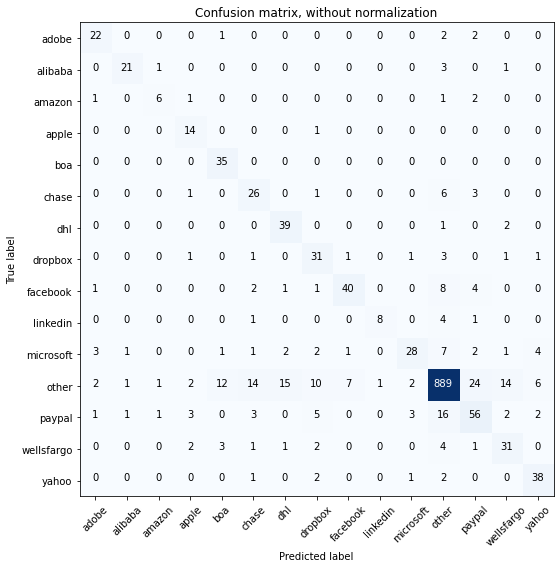

Acc     =  0.834
Pre     =  0.85
Rec     =  0.834
F1      =  0.837

Bal_Acc =  0.757
Bal_Pre =  0.711
Bal_Rec =  0.757
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.55      0.60        11
       apple       0.58      0.93      0.72        15
         boa       0.67      1.00      0.80        35
       chase       0.52      0.70      0.60        37
         dhl       0.67      0.93      0.78        42
     dropbox       0.56      0.78      0.65        40
    facebook       0.82      0.70      0.75        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.80      0.53      0.64        53
       other       0.94      0.89      0.91      1000
      paypal       0.59      0.60      0.60        93
  wellsfargo       0.60      0.69      0.64        45
       yahoo       0.75      0.86      0.80        4

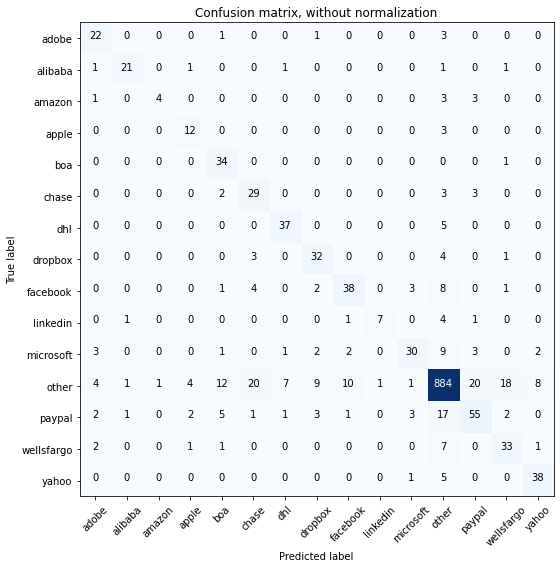

Acc     =  0.829
Pre     =  0.843
Rec     =  0.829
F1      =  0.831

Bal_Acc =  0.735
Bal_Pre =  0.718
Bal_Rec =  0.735
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.80      0.36      0.50        11
       apple       0.60      0.80      0.69        15
         boa       0.60      0.97      0.74        35
       chase       0.51      0.78      0.62        37
         dhl       0.79      0.88      0.83        42
     dropbox       0.65      0.80      0.72        40
    facebook       0.73      0.67      0.70        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.79      0.57      0.66        53
       other       0.92      0.88      0.90      1000
      paypal       0.65      0.59      0.62        93
  wellsfargo       0.58      0.73      0.65        45
       yahoo       0.78      0.86      0.82        

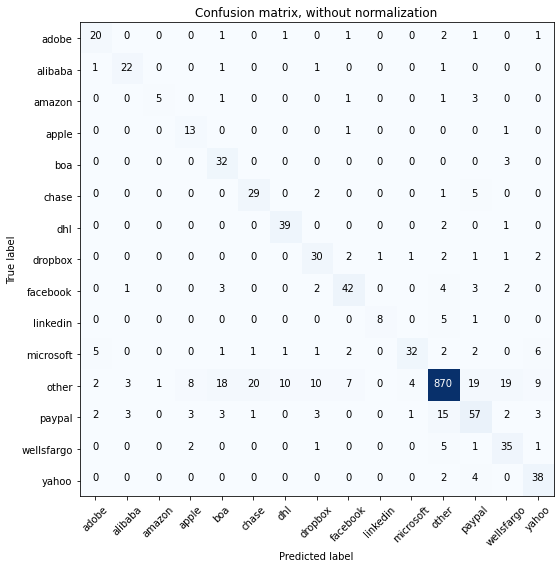

Acc     =  0.827
Pre     =  0.852
Rec     =  0.827
F1      =  0.833

Bal_Acc =  0.755
Bal_Pre =  0.695
Bal_Rec =  0.755
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.67      0.74      0.70        27
     alibaba       0.76      0.85      0.80        26
      amazon       0.83      0.45      0.59        11
       apple       0.50      0.87      0.63        15
         boa       0.53      0.91      0.67        35
       chase       0.57      0.78      0.66        37
         dhl       0.76      0.93      0.84        42
     dropbox       0.60      0.75      0.67        40
    facebook       0.75      0.74      0.74        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.84      0.60      0.70        53
       other       0.95      0.87      0.91      1000
      paypal       0.59      0.61      0.60        93
  wellsfargo       0.55      0.78      0.64        45
       yahoo       0.63      0.86      0.73        

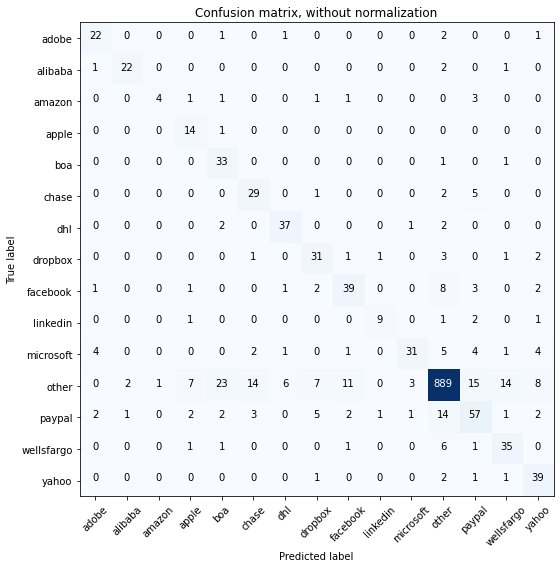

Acc     =  0.839
Pre     =  0.858
Rec     =  0.839
F1      =  0.843

Bal_Acc =  0.761
Bal_Pre =  0.716
Bal_Rec =  0.761
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.52      0.93      0.67        15
         boa       0.52      0.94      0.67        35
       chase       0.59      0.78      0.67        37
         dhl       0.80      0.88      0.84        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.70      0.68      0.69        57
    linkedin       0.82      0.64      0.72        14
   microsoft       0.86      0.58      0.70        53
       other       0.95      0.89      0.92      1000
      paypal       0.63      0.61      0.62        93
  wellsfargo       0.64      0.78      0.70        45
       yahoo       0.66      0.89      0.76        

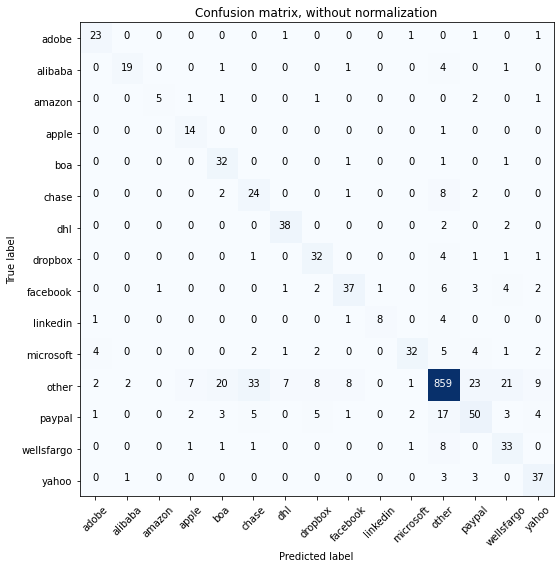

Acc     =  0.808
Pre     =  0.836
Rec     =  0.808
F1      =  0.815

Bal_Acc =  0.736
Bal_Pre =  0.697
Bal_Rec =  0.736
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.86      0.73      0.79        26
      amazon       0.83      0.45      0.59        11
       apple       0.56      0.93      0.70        15
         boa       0.53      0.91      0.67        35
       chase       0.36      0.65      0.47        37
         dhl       0.79      0.90      0.84        42
     dropbox       0.64      0.80      0.71        40
    facebook       0.74      0.65      0.69        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.86      0.60      0.71        53
       other       0.93      0.86      0.89      1000
      paypal       0.56      0.54      0.55        93
  wellsfargo       0.49      0.73      0.59        45
       yahoo       0.65      0.84      0.73        

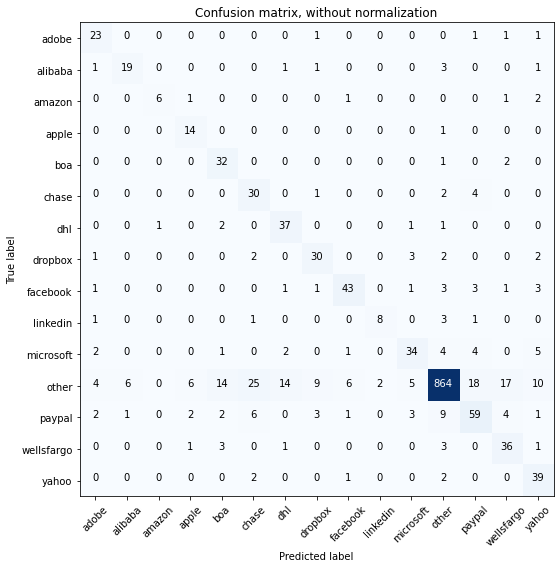

Acc     =  0.828
Pre     =  0.856
Rec     =  0.828
F1      =  0.835

Bal_Acc =  0.771
Bal_Pre =  0.688
Bal_Rec =  0.771
Bal_F1  =  0.727

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.73      0.73      0.73        26
      amazon       0.86      0.55      0.67        11
       apple       0.58      0.93      0.72        15
         boa       0.59      0.91      0.72        35
       chase       0.45      0.81      0.58        37
         dhl       0.66      0.88      0.76        42
     dropbox       0.65      0.75      0.70        40
    facebook       0.81      0.75      0.78        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.72      0.64      0.68        53
       other       0.96      0.86      0.91      1000
      paypal       0.66      0.63      0.64        93
  wellsfargo       0.58      0.80      0.67        45
       yahoo       0.60      0.89      0.72        

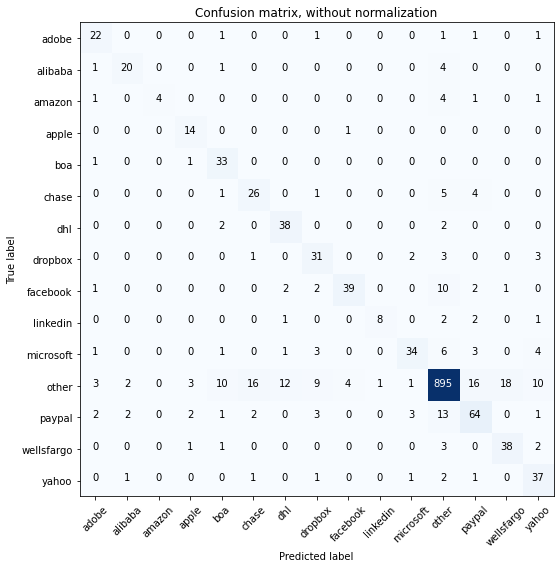

Acc     =  0.847
Pre     =  0.862
Rec     =  0.847
F1      =  0.849

Bal_Acc =  0.758
Bal_Pre =  0.746
Bal_Rec =  0.758
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.80      0.77      0.78        26
      amazon       1.00      0.36      0.53        11
       apple       0.67      0.93      0.78        15
         boa       0.65      0.94      0.77        35
       chase       0.57      0.70      0.63        37
         dhl       0.70      0.90      0.79        42
     dropbox       0.61      0.78      0.68        40
    facebook       0.89      0.68      0.77        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.83      0.64      0.72        53
       other       0.94      0.90      0.92      1000
      paypal       0.68      0.69      0.68        93
  wellsfargo       0.67      0.84      0.75        45
       yahoo       0.62      0.84      0.71        

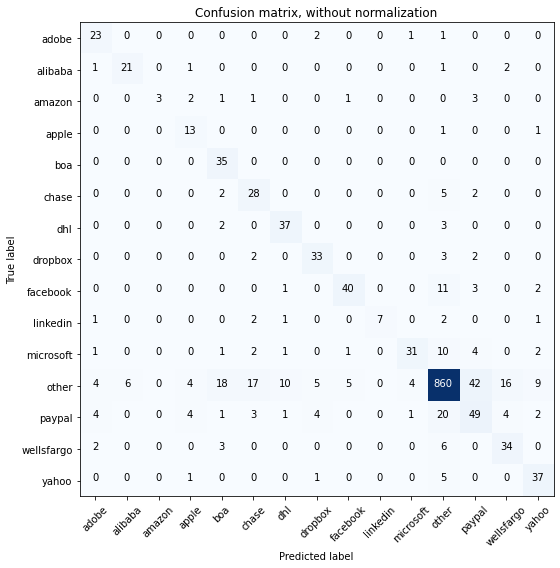

Acc     =  0.813
Pre     =  0.837
Rec     =  0.813
F1      =  0.818

Bal_Acc =  0.735
Bal_Pre =  0.722
Bal_Rec =  0.735
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.64      0.85      0.73        27
     alibaba       0.78      0.81      0.79        26
      amazon       1.00      0.27      0.43        11
       apple       0.52      0.87      0.65        15
         boa       0.56      1.00      0.71        35
       chase       0.51      0.76      0.61        37
         dhl       0.73      0.88      0.80        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.85      0.70      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.58      0.69        53
       other       0.93      0.86      0.89      1000
      paypal       0.47      0.53      0.49        93
  wellsfargo       0.61      0.76      0.67        45
       yahoo       0.69      0.84      0.76        

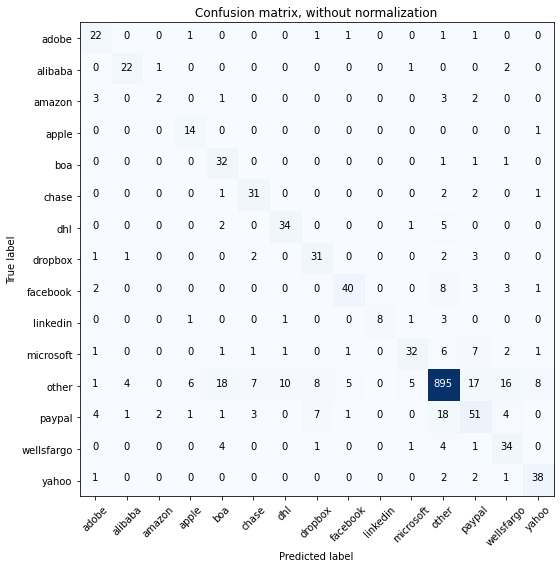

Acc     =  0.836
Pre     =  0.85
Rec     =  0.836
F1      =  0.838

Bal_Acc =  0.737
Bal_Pre =  0.698
Bal_Rec =  0.737
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.79      0.85      0.81        26
      amazon       0.40      0.18      0.25        11
       apple       0.61      0.93      0.74        15
         boa       0.53      0.91      0.67        35
       chase       0.70      0.84      0.77        37
         dhl       0.74      0.81      0.77        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.83      0.70      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.60      0.68        53
       other       0.94      0.90      0.92      1000
      paypal       0.57      0.55      0.56        93
  wellsfargo       0.54      0.76      0.63        45
       yahoo       0.76      0.86      0.81        4

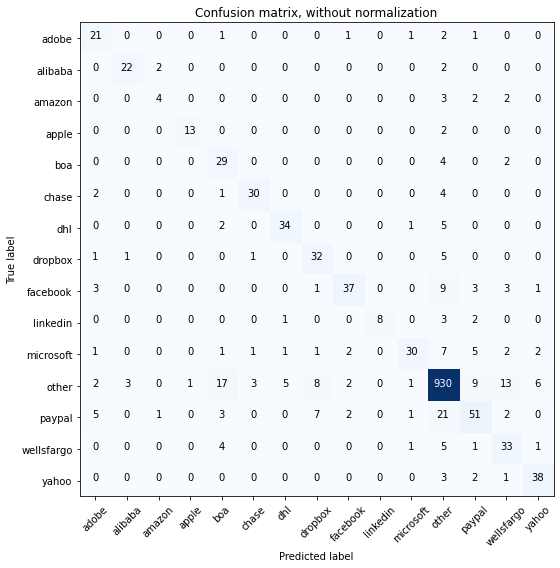

Acc     =  0.853
Pre     =  0.86
Rec     =  0.853
F1      =  0.852

Bal_Acc =  0.731
Bal_Pre =  0.763
Bal_Rec =  0.731
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.60      0.78      0.68        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.57      0.36      0.44        11
       apple       0.93      0.87      0.90        15
         boa       0.50      0.83      0.62        35
       chase       0.86      0.81      0.83        37
         dhl       0.83      0.81      0.82        42
     dropbox       0.65      0.80      0.72        40
    facebook       0.84      0.65      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.57      0.68        53
       other       0.93      0.93      0.93      1000
      paypal       0.67      0.55      0.60        93
  wellsfargo       0.57      0.73      0.64        45
       yahoo       0.79      0.86      0.83        4

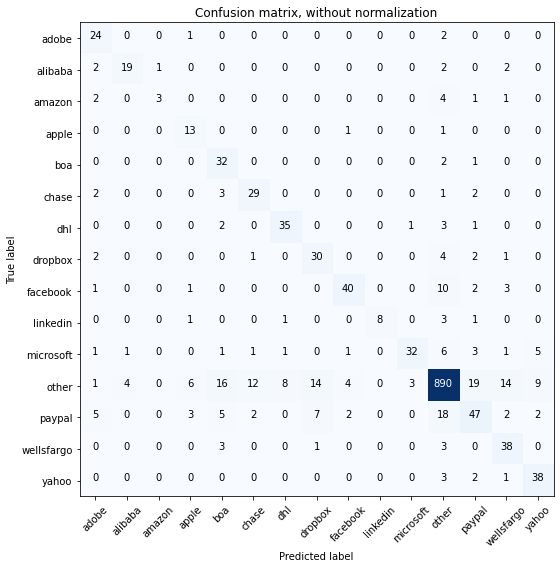

Acc     =  0.83
Pre     =  0.849
Rec     =  0.83
F1      =  0.833

Bal_Acc =  0.735
Bal_Pre =  0.715
Bal_Rec =  0.735
Bal_F1  =  0.725

              precision    recall  f1-score   support

       adobe       0.60      0.89      0.72        27
     alibaba       0.79      0.73      0.76        26
      amazon       0.75      0.27      0.40        11
       apple       0.52      0.87      0.65        15
         boa       0.52      0.91      0.66        35
       chase       0.64      0.78      0.71        37
         dhl       0.78      0.83      0.80        42
     dropbox       0.58      0.75      0.65        40
    facebook       0.83      0.70      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.60      0.72        53
       other       0.93      0.89      0.91      1000
      paypal       0.58      0.51      0.54        93
  wellsfargo       0.60      0.84      0.70        45
       yahoo       0.70      0.86      0.78        44

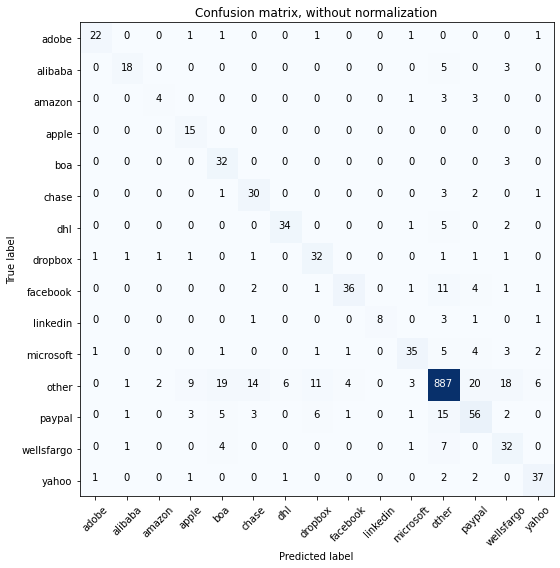

Acc     =  0.83
Pre     =  0.852
Rec     =  0.83
F1      =  0.835

Bal_Acc =  0.741
Bal_Pre =  0.717
Bal_Rec =  0.741
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.88      0.81      0.85        27
     alibaba       0.82      0.69      0.75        26
      amazon       0.57      0.36      0.44        11
       apple       0.50      1.00      0.67        15
         boa       0.51      0.91      0.65        35
       chase       0.59      0.81      0.68        37
         dhl       0.83      0.81      0.82        42
     dropbox       0.62      0.80      0.70        40
    facebook       0.86      0.63      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.66      0.72        53
       other       0.94      0.89      0.91      1000
      paypal       0.60      0.60      0.60        93
  wellsfargo       0.49      0.71      0.58        45
       yahoo       0.76      0.84      0.80        44

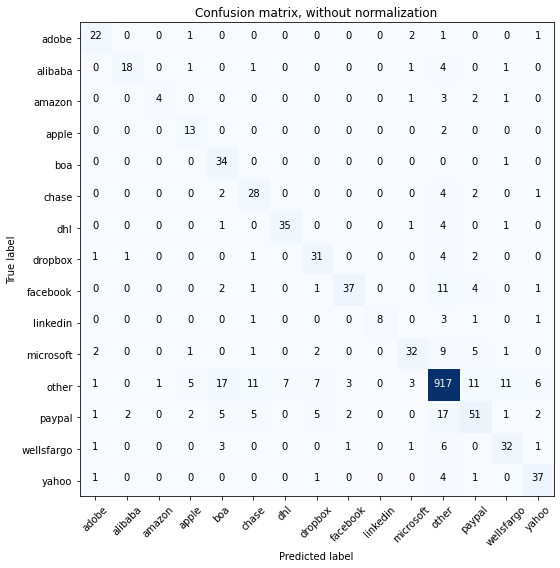

Acc     =  0.844
Pre     =  0.854
Rec     =  0.844
F1      =  0.844

Bal_Acc =  0.728
Bal_Pre =  0.746
Bal_Rec =  0.728
Bal_F1  =  0.737

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.86      0.69      0.77        26
      amazon       0.80      0.36      0.50        11
       apple       0.57      0.87      0.68        15
         boa       0.53      0.97      0.69        35
       chase       0.57      0.76      0.65        37
         dhl       0.83      0.83      0.83        42
     dropbox       0.66      0.78      0.71        40
    facebook       0.86      0.65      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.60      0.68        53
       other       0.93      0.92      0.92      1000
      paypal       0.65      0.55      0.59        93
  wellsfargo       0.65      0.71      0.68        45
       yahoo       0.74      0.84      0.79        

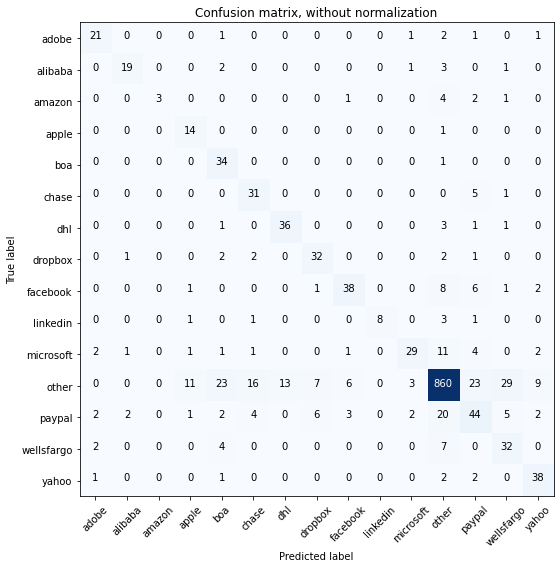

Acc     =  0.805
Pre     =  0.833
Rec     =  0.805
F1      =  0.81

Bal_Acc =  0.725
Bal_Pre =  0.712
Bal_Rec =  0.725
Bal_F1  =  0.718

              precision    recall  f1-score   support

       adobe       0.75      0.78      0.76        27
     alibaba       0.83      0.73      0.78        26
      amazon       1.00      0.27      0.43        11
       apple       0.48      0.93      0.64        15
         boa       0.48      0.97      0.64        35
       chase       0.56      0.84      0.67        37
         dhl       0.73      0.86      0.79        42
     dropbox       0.70      0.80      0.74        40
    facebook       0.78      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.55      0.65        53
       other       0.93      0.86      0.89      1000
      paypal       0.49      0.47      0.48        93
  wellsfargo       0.45      0.71      0.55        45
       yahoo       0.70      0.86      0.78        4

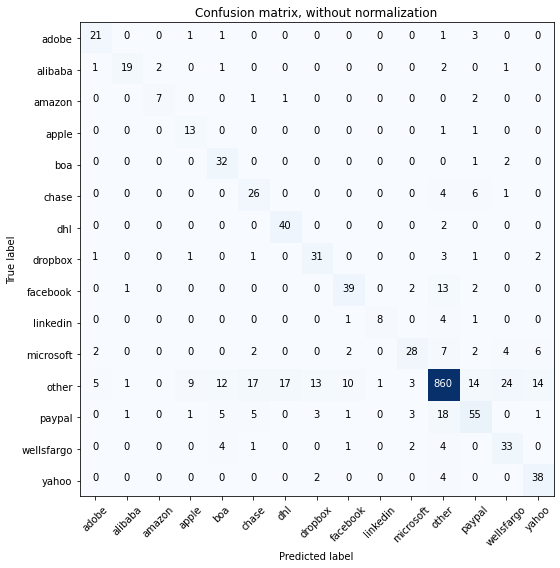

Acc     =  0.812
Pre     =  0.834
Rec     =  0.812
F1      =  0.817

Bal_Acc =  0.746
Bal_Pre =  0.686
Bal_Rec =  0.746
Bal_F1  =  0.715

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.86      0.73      0.79        26
      amazon       0.78      0.64      0.70        11
       apple       0.52      0.87      0.65        15
         boa       0.58      0.91      0.71        35
       chase       0.49      0.70      0.58        37
         dhl       0.69      0.95      0.80        42
     dropbox       0.63      0.78      0.70        40
    facebook       0.72      0.68      0.70        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.74      0.53      0.62        53
       other       0.93      0.86      0.89      1000
      paypal       0.62      0.59      0.61        93
  wellsfargo       0.51      0.73      0.60        45
       yahoo       0.62      0.86      0.72        

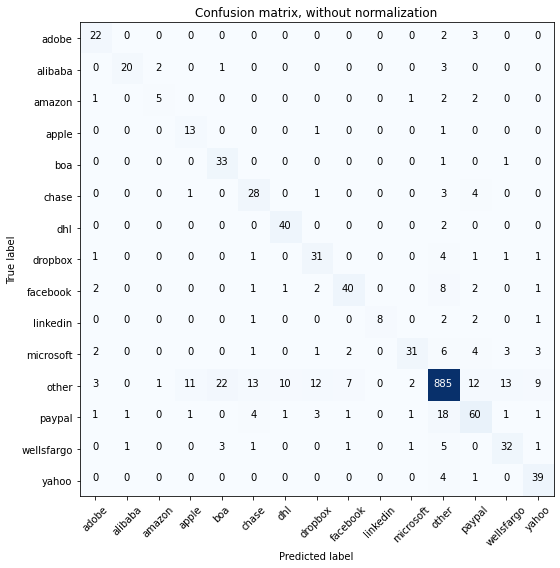

Acc     =  0.836
Pre     =  0.854
Rec     =  0.836
F1      =  0.84

Bal_Acc =  0.755
Bal_Pre =  0.719
Bal_Rec =  0.755
Bal_F1  =  0.737

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.62      0.45      0.53        11
       apple       0.50      0.87      0.63        15
         boa       0.56      0.94      0.70        35
       chase       0.56      0.76      0.64        37
         dhl       0.77      0.95      0.85        42
     dropbox       0.61      0.78      0.68        40
    facebook       0.78      0.70      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.58      0.70        53
       other       0.94      0.89      0.91      1000
      paypal       0.66      0.65      0.65        93
  wellsfargo       0.63      0.71      0.67        45
       yahoo       0.70      0.89      0.78        4

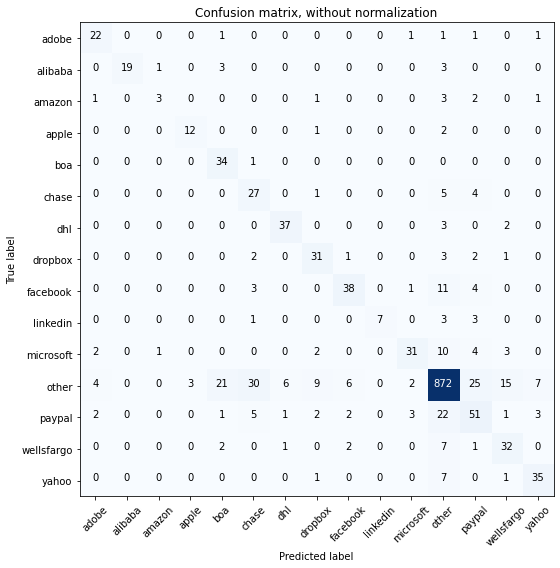

Acc     =  0.813
Pre     =  0.834
Rec     =  0.813
F1      =  0.818

Bal_Acc =  0.71
Bal_Pre =  0.725
Bal_Rec =  0.71
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       1.00      0.73      0.84        26
      amazon       0.60      0.27      0.37        11
       apple       0.80      0.80      0.80        15
         boa       0.55      0.97      0.70        35
       chase       0.39      0.73      0.51        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.78      0.67      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.92      0.87      0.89      1000
      paypal       0.53      0.55      0.54        93
  wellsfargo       0.58      0.71      0.64        45
       yahoo       0.74      0.80      0.77        44

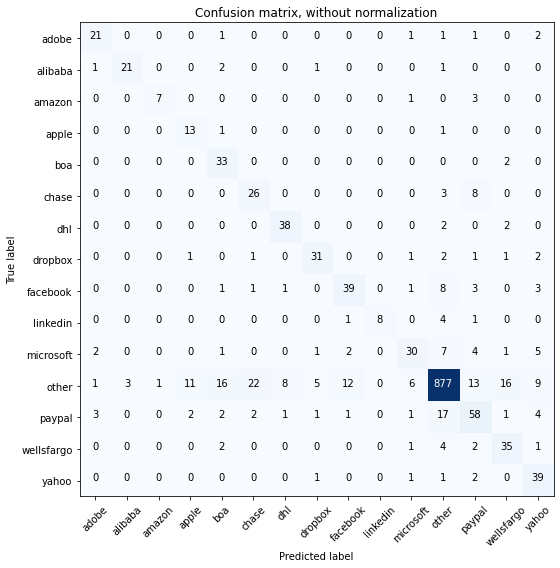

Acc     =  0.829
Pre     =  0.85
Rec     =  0.829
F1      =  0.835

Bal_Acc =  0.76
Bal_Pre =  0.718
Bal_Rec =  0.76
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.75      0.78      0.76        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.88      0.64      0.74        11
       apple       0.48      0.87      0.62        15
         boa       0.56      0.94      0.70        35
       chase       0.50      0.70      0.58        37
         dhl       0.79      0.90      0.84        42
     dropbox       0.78      0.78      0.78        40
    facebook       0.71      0.68      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.70      0.57      0.62        53
       other       0.95      0.88      0.91      1000
      paypal       0.60      0.62      0.61        93
  wellsfargo       0.60      0.78      0.68        45
       yahoo       0.60      0.89      0.72        44


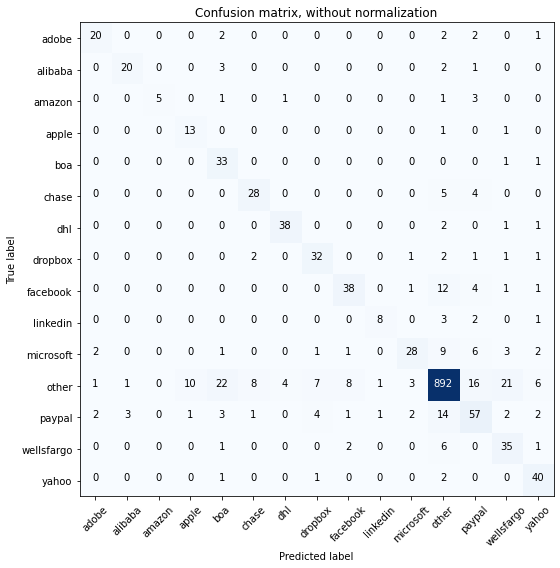

Acc     =  0.836
Pre     =  0.854
Rec     =  0.836
F1      =  0.84

Bal_Acc =  0.746
Bal_Pre =  0.74
Bal_Rec =  0.746
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.80      0.74      0.77        27
     alibaba       0.83      0.77      0.80        26
      amazon       1.00      0.45      0.62        11
       apple       0.54      0.87      0.67        15
         boa       0.49      0.94      0.65        35
       chase       0.72      0.76      0.74        37
         dhl       0.88      0.90      0.89        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.76      0.67      0.71        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.80      0.53      0.64        53
       other       0.94      0.89      0.91      1000
      paypal       0.59      0.61      0.60        93
  wellsfargo       0.53      0.78      0.63        45
       yahoo       0.70      0.91      0.79        44

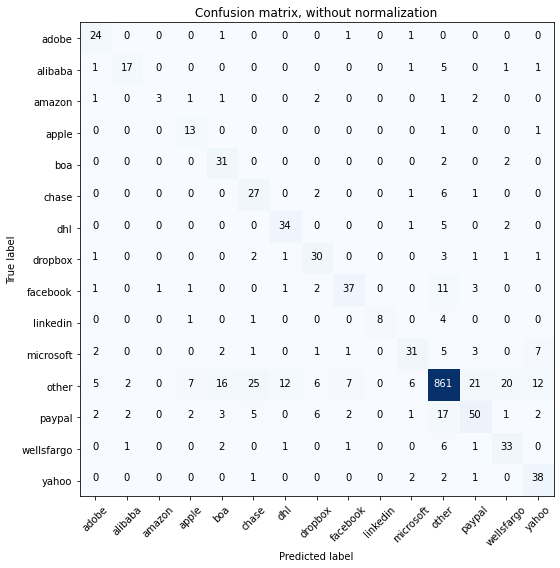

Acc     =  0.804
Pre     =  0.826
Rec     =  0.804
F1      =  0.809

Bal_Acc =  0.711
Bal_Pre =  0.676
Bal_Rec =  0.711
Bal_F1  =  0.693

              precision    recall  f1-score   support

       adobe       0.65      0.89      0.75        27
     alibaba       0.77      0.65      0.71        26
      amazon       0.75      0.27      0.40        11
       apple       0.52      0.87      0.65        15
         boa       0.55      0.89      0.68        35
       chase       0.44      0.73      0.55        37
         dhl       0.69      0.81      0.75        42
     dropbox       0.61      0.75      0.67        40
    facebook       0.76      0.65      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.70      0.58      0.64        53
       other       0.93      0.86      0.89      1000
      paypal       0.60      0.54      0.57        93
  wellsfargo       0.55      0.73      0.63        45
       yahoo       0.61      0.86      0.72        

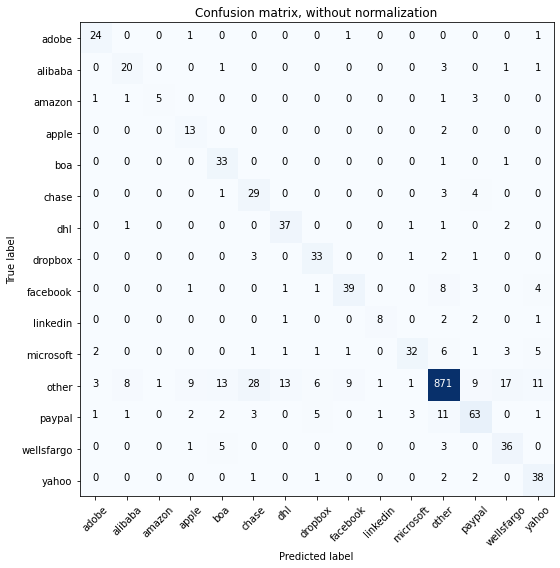

Acc     =  0.832
Pre     =  0.858
Rec     =  0.832
F1      =  0.839

Bal_Acc =  0.766
Bal_Pre =  0.699
Bal_Rec =  0.766
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.77      0.89      0.83        27
     alibaba       0.65      0.77      0.70        26
      amazon       0.83      0.45      0.59        11
       apple       0.48      0.87      0.62        15
         boa       0.60      0.94      0.73        35
       chase       0.45      0.78      0.57        37
         dhl       0.70      0.88      0.78        42
     dropbox       0.70      0.82      0.76        40
    facebook       0.78      0.68      0.73        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.84      0.60      0.70        53
       other       0.95      0.87      0.91      1000
      paypal       0.72      0.68      0.70        93
  wellsfargo       0.60      0.80      0.69        45
       yahoo       0.61      0.86      0.72        

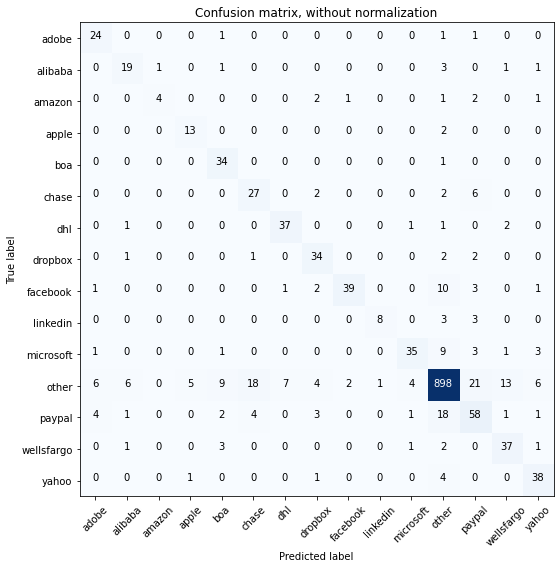

Acc     =  0.848
Pre     =  0.861
Rec     =  0.848
F1      =  0.85

Bal_Acc =  0.76
Bal_Pre =  0.741
Bal_Rec =  0.76
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.66      0.73      0.69        26
      amazon       0.80      0.36      0.50        11
       apple       0.68      0.87      0.76        15
         boa       0.67      0.97      0.79        35
       chase       0.54      0.73      0.62        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.71      0.85      0.77        40
    facebook       0.93      0.68      0.79        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.83      0.66      0.74        53
       other       0.94      0.90      0.92      1000
      paypal       0.59      0.62      0.60        93
  wellsfargo       0.67      0.82      0.74        45
       yahoo       0.73      0.86      0.79        44



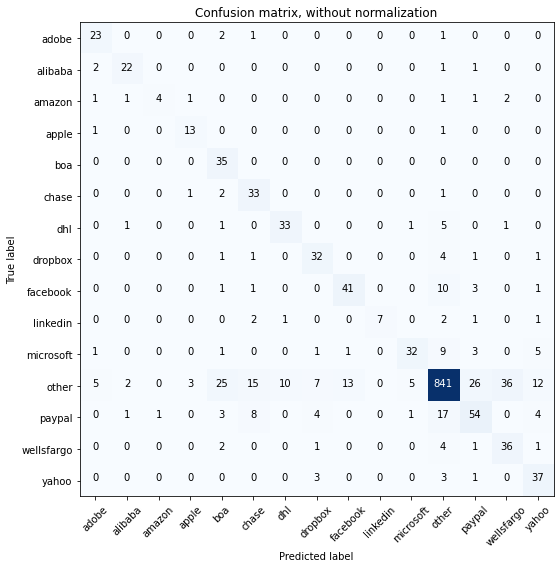

Acc     =  0.808
Pre     =  0.839
Rec     =  0.808
F1      =  0.815

Bal_Acc =  0.753
Bal_Pre =  0.709
Bal_Rec =  0.753
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.80      0.36      0.50        11
       apple       0.72      0.87      0.79        15
         boa       0.48      1.00      0.65        35
       chase       0.54      0.89      0.67        37
         dhl       0.75      0.79      0.77        42
     dropbox       0.67      0.80      0.73        40
    facebook       0.75      0.72      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.60      0.70        53
       other       0.93      0.84      0.89      1000
      paypal       0.59      0.58      0.58        93
  wellsfargo       0.48      0.80      0.60        45
       yahoo       0.60      0.84      0.70        4

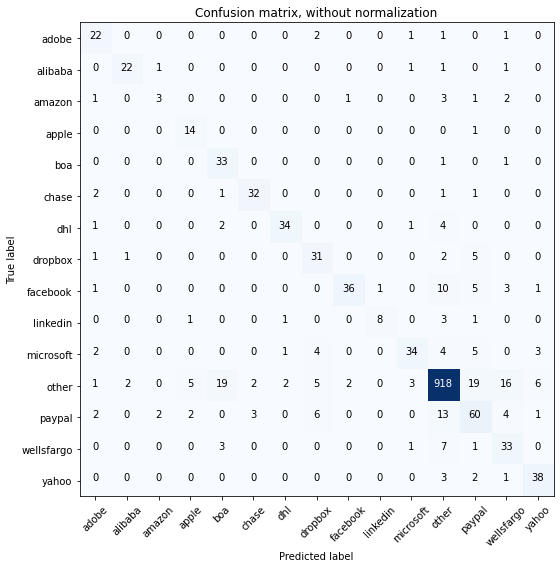

Acc     =  0.856
Pre     =  0.87
Rec     =  0.856
F1      =  0.859

Bal_Acc =  0.751
Bal_Pre =  0.743
Bal_Rec =  0.751
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.50      0.27      0.35        11
       apple       0.64      0.93      0.76        15
         boa       0.57      0.94      0.71        35
       chase       0.86      0.86      0.86        37
         dhl       0.89      0.81      0.85        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.92      0.63      0.75        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.83      0.64      0.72        53
       other       0.95      0.92      0.93      1000
      paypal       0.59      0.65      0.62        93
  wellsfargo       0.53      0.73      0.62        45
       yahoo       0.78      0.86      0.82        4

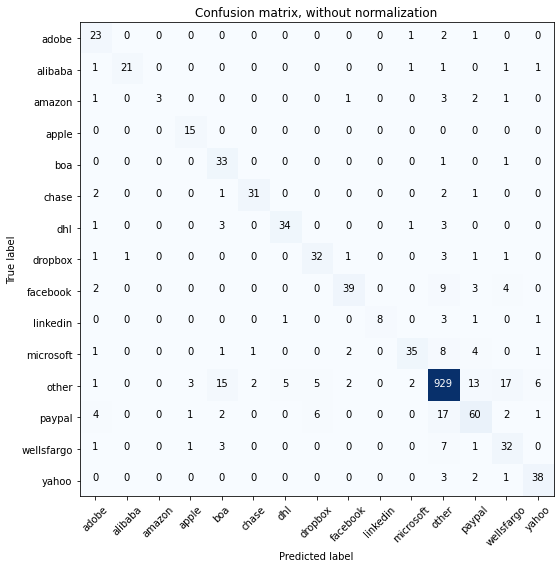

Acc     =  0.866
Pre     =  0.878
Rec     =  0.866
F1      =  0.867

Bal_Acc =  0.759
Bal_Pre =  0.804
Bal_Rec =  0.759
Bal_F1  =  0.781

              precision    recall  f1-score   support

       adobe       0.61      0.85      0.71        27
     alibaba       0.95      0.81      0.88        26
      amazon       1.00      0.27      0.43        11
       apple       0.75      1.00      0.86        15
         boa       0.57      0.94      0.71        35
       chase       0.91      0.84      0.87        37
         dhl       0.85      0.81      0.83        42
     dropbox       0.74      0.80      0.77        40
    facebook       0.87      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.88      0.66      0.75        53
       other       0.94      0.93      0.93      1000
      paypal       0.67      0.65      0.66        93
  wellsfargo       0.53      0.71      0.61        45
       yahoo       0.79      0.86      0.83        

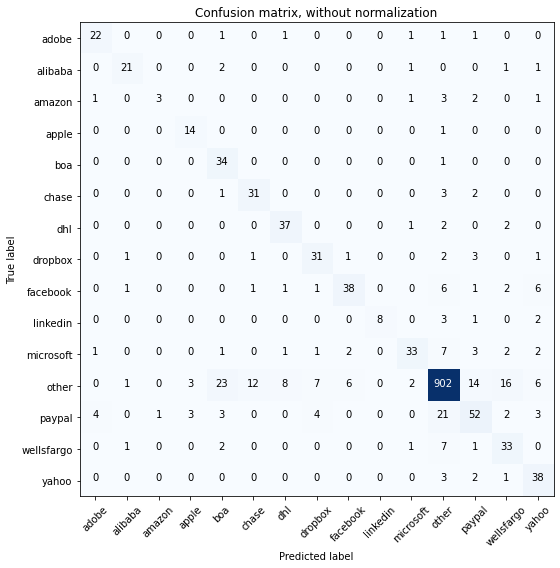

Acc     =  0.843
Pre     =  0.857
Rec     =  0.843
F1      =  0.844

Bal_Acc =  0.748
Bal_Pre =  0.743
Bal_Rec =  0.748
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.79      0.81      0.80        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.75      0.27      0.40        11
       apple       0.70      0.93      0.80        15
         boa       0.51      0.97      0.67        35
       chase       0.69      0.84      0.76        37
         dhl       0.77      0.88      0.82        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.81      0.67      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.90      0.92      1000
      paypal       0.63      0.56      0.59        93
  wellsfargo       0.56      0.73      0.63        45
       yahoo       0.63      0.86      0.73        

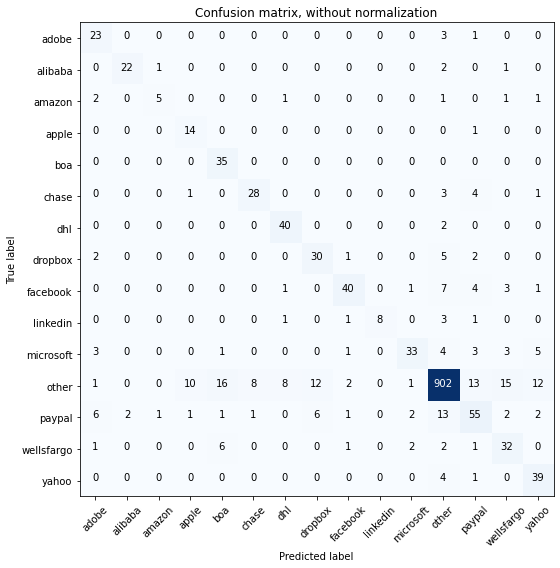

Acc     =  0.849
Pre     =  0.865
Rec     =  0.849
F1      =  0.852

Bal_Acc =  0.769
Bal_Pre =  0.735
Bal_Rec =  0.769
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.61      0.85      0.71        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.71      0.45      0.56        11
       apple       0.54      0.93      0.68        15
         boa       0.59      1.00      0.74        35
       chase       0.76      0.76      0.76        37
         dhl       0.78      0.95      0.86        42
     dropbox       0.62      0.75      0.68        40
    facebook       0.85      0.70      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.62      0.72        53
       other       0.95      0.90      0.92      1000
      paypal       0.64      0.59      0.61        93
  wellsfargo       0.56      0.71      0.63        45
       yahoo       0.64      0.89      0.74        

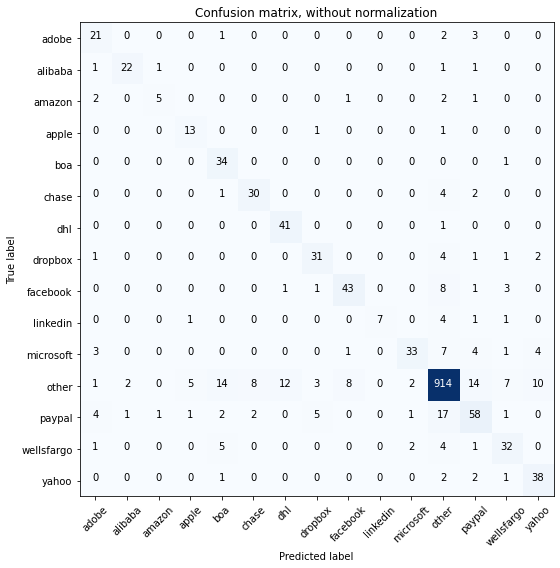

Acc     =  0.859
Pre     =  0.869
Rec     =  0.859
F1      =  0.86

Bal_Acc =  0.765
Bal_Pre =  0.757
Bal_Rec =  0.765
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.71      0.45      0.56        11
       apple       0.65      0.87      0.74        15
         boa       0.59      0.97      0.73        35
       chase       0.75      0.81      0.78        37
         dhl       0.76      0.98      0.85        42
     dropbox       0.76      0.78      0.77        40
    facebook       0.81      0.75      0.78        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.91      0.93      1000
      paypal       0.65      0.62      0.64        93
  wellsfargo       0.67      0.71      0.69        45
       yahoo       0.70      0.86      0.78        4

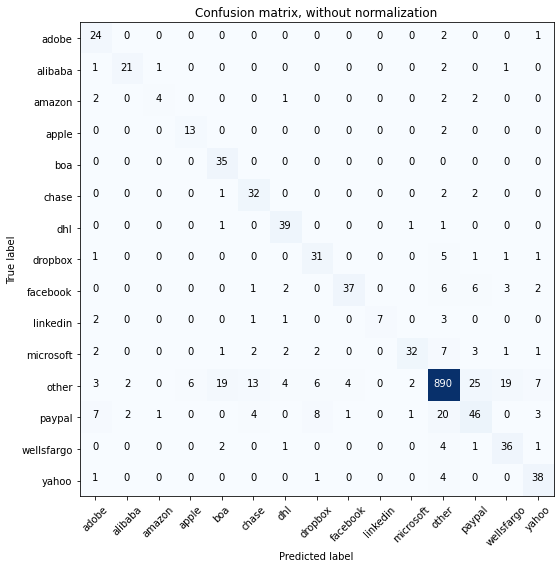

Acc     =  0.835
Pre     =  0.852
Rec     =  0.835
F1      =  0.837

Bal_Acc =  0.753
Bal_Pre =  0.727
Bal_Rec =  0.753
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.56      0.89      0.69        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.67      0.36      0.47        11
       apple       0.68      0.87      0.76        15
         boa       0.59      1.00      0.74        35
       chase       0.60      0.86      0.71        37
         dhl       0.78      0.93      0.85        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.88      0.65      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.89      0.60      0.72        53
       other       0.94      0.89      0.91      1000
      paypal       0.53      0.49      0.51        93
  wellsfargo       0.59      0.80      0.68        45
       yahoo       0.70      0.86      0.78        4

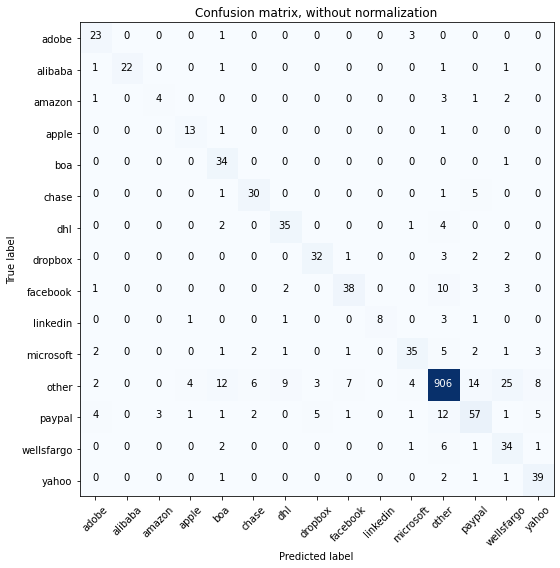

Acc     =  0.851
Pre     =  0.866
Rec     =  0.851
F1      =  0.854

Bal_Acc =  0.76
Bal_Pre =  0.744
Bal_Rec =  0.76
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.57      0.36      0.44        11
       apple       0.68      0.87      0.76        15
         boa       0.60      0.97      0.74        35
       chase       0.75      0.81      0.78        37
         dhl       0.73      0.83      0.78        42
     dropbox       0.80      0.80      0.80        40
    facebook       0.79      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.66      0.71        53
       other       0.95      0.91      0.93      1000
      paypal       0.66      0.61      0.63        93
  wellsfargo       0.48      0.76      0.59        45
       yahoo       0.70      0.89      0.78        44

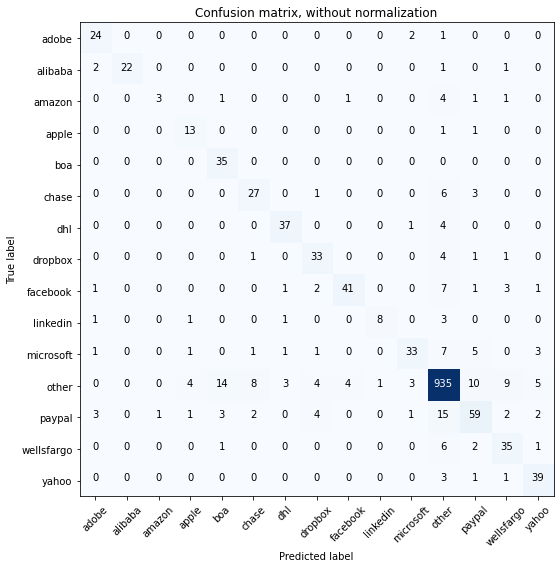

Acc     =  0.873
Pre     =  0.878
Rec     =  0.873
F1      =  0.872

Bal_Acc =  0.764
Bal_Pre =  0.784
Bal_Rec =  0.764
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.75      0.89      0.81        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.75      0.27      0.40        11
       apple       0.65      0.87      0.74        15
         boa       0.65      1.00      0.79        35
       chase       0.69      0.73      0.71        37
         dhl       0.86      0.88      0.87        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.89      0.72      0.80        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.94      0.94      1000
      paypal       0.70      0.63      0.67        93
  wellsfargo       0.66      0.78      0.71        45
       yahoo       0.76      0.89      0.82        

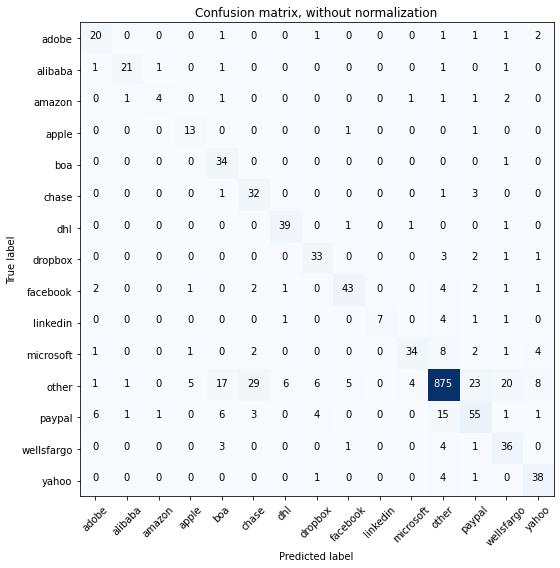

Acc     =  0.834
Pre     =  0.86
Rec     =  0.834
F1      =  0.84

Bal_Acc =  0.76
Bal_Pre =  0.724
Bal_Rec =  0.76
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.65      0.87      0.74        15
         boa       0.53      0.97      0.69        35
       chase       0.47      0.86      0.61        37
         dhl       0.83      0.93      0.88        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.84      0.75      0.80        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.85      0.64      0.73        53
       other       0.95      0.88      0.91      1000
      paypal       0.59      0.59      0.59        93
  wellsfargo       0.54      0.80      0.64        45
       yahoo       0.69      0.86      0.77        44



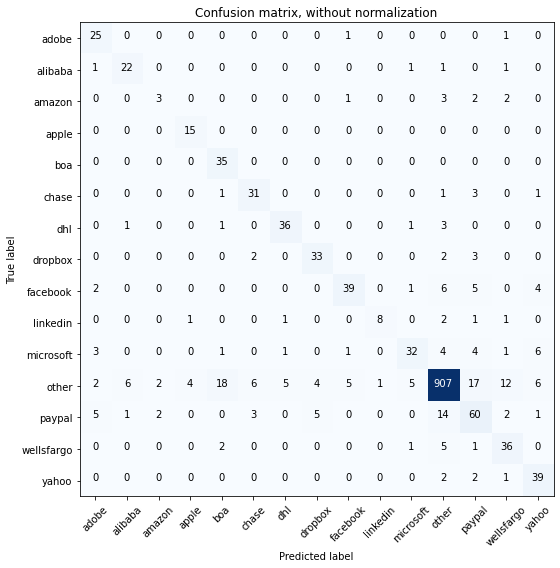

Acc     =  0.858
Pre     =  0.87
Rec     =  0.858
F1      =  0.86

Bal_Acc =  0.778
Bal_Pre =  0.728
Bal_Rec =  0.778
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.66      0.93      0.77        27
     alibaba       0.73      0.85      0.79        26
      amazon       0.43      0.27      0.33        11
       apple       0.75      1.00      0.86        15
         boa       0.60      1.00      0.75        35
       chase       0.74      0.84      0.78        37
         dhl       0.84      0.86      0.85        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.83      0.68      0.75        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.78      0.60      0.68        53
       other       0.95      0.91      0.93      1000
      paypal       0.61      0.65      0.63        93
  wellsfargo       0.63      0.80      0.71        45
       yahoo       0.68      0.89      0.77        44

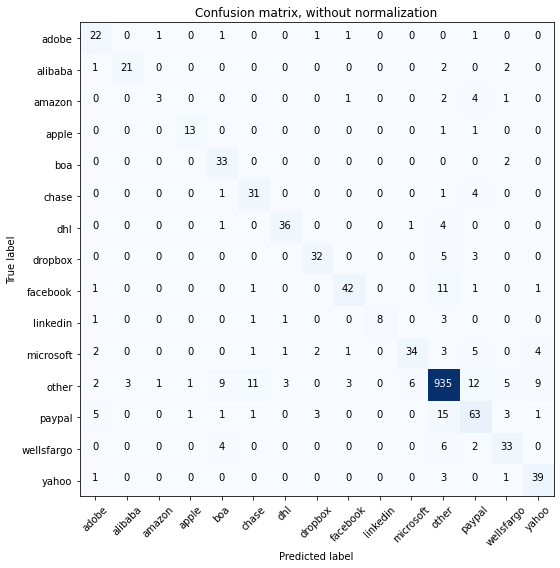

Acc     =  0.874
Pre     =  0.88
Rec     =  0.874
F1      =  0.874

Bal_Acc =  0.759
Bal_Pre =  0.784
Bal_Rec =  0.759
Bal_F1  =  0.771

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.60      0.27      0.37        11
       apple       0.87      0.87      0.87        15
         boa       0.66      0.94      0.78        35
       chase       0.67      0.84      0.75        37
         dhl       0.88      0.86      0.87        42
     dropbox       0.84      0.80      0.82        40
    facebook       0.88      0.74      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.83      0.64      0.72        53
       other       0.94      0.94      0.94      1000
      paypal       0.66      0.68      0.67        93
  wellsfargo       0.70      0.73      0.72        45
       yahoo       0.72      0.89      0.80        4

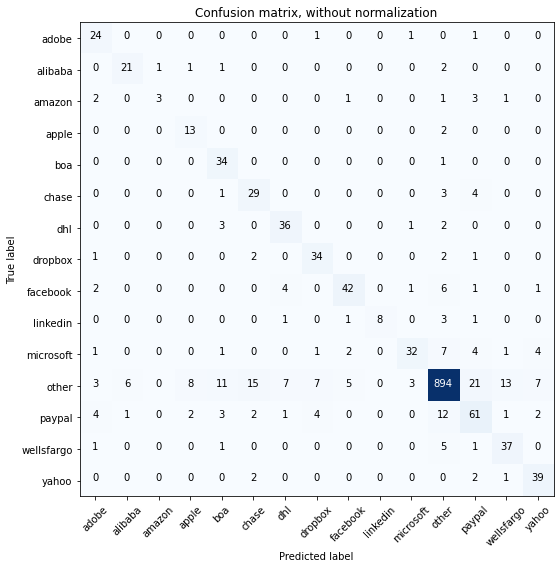

Acc     =  0.849
Pre     =  0.866
Rec     =  0.849
F1      =  0.852

Bal_Acc =  0.765
Bal_Pre =  0.732
Bal_Rec =  0.765
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.63      0.89      0.74        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.75      0.27      0.40        11
       apple       0.54      0.87      0.67        15
         boa       0.62      0.97      0.76        35
       chase       0.58      0.78      0.67        37
         dhl       0.73      0.86      0.79        42
     dropbox       0.72      0.85      0.78        40
    facebook       0.82      0.74      0.78        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.60      0.70        53
       other       0.95      0.89      0.92      1000
      paypal       0.61      0.66      0.63        93
  wellsfargo       0.69      0.82      0.75        45
       yahoo       0.74      0.89      0.80        

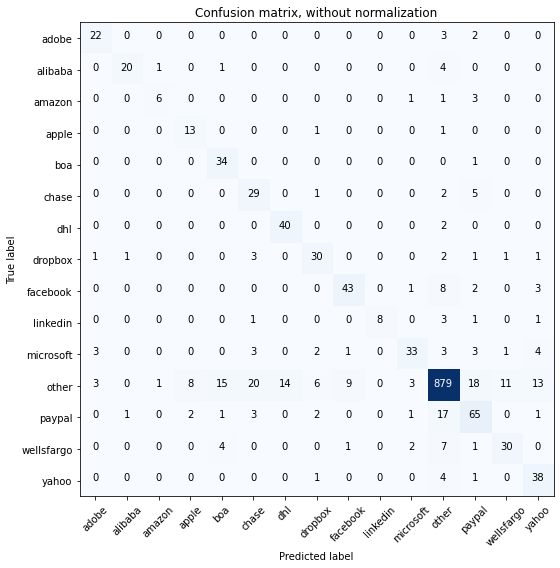

Acc     =  0.838
Pre     =  0.857
Rec     =  0.838
F1      =  0.843

Bal_Acc =  0.767
Bal_Pre =  0.735
Bal_Rec =  0.767
Bal_F1  =  0.751

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.75      0.55      0.63        11
       apple       0.57      0.87      0.68        15
         boa       0.62      0.97      0.76        35
       chase       0.49      0.78      0.60        37
         dhl       0.74      0.95      0.83        42
     dropbox       0.70      0.75      0.72        40
    facebook       0.80      0.75      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.62      0.70        53
       other       0.94      0.88      0.91      1000
      paypal       0.63      0.70      0.66        93
  wellsfargo       0.70      0.67      0.68        45
       yahoo       0.62      0.86      0.72        

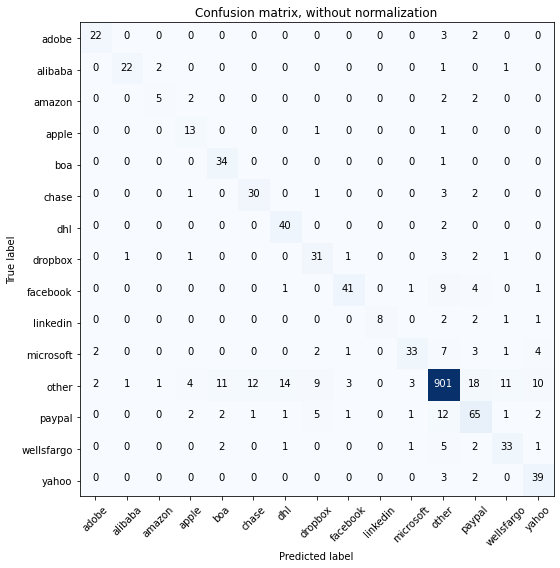

Acc     =  0.856
Pre     =  0.869
Rec     =  0.856
F1      =  0.858

Bal_Acc =  0.775
Bal_Pre =  0.754
Bal_Rec =  0.775
Bal_F1  =  0.764

              precision    recall  f1-score   support

       adobe       0.85      0.81      0.83        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.62      0.45      0.53        11
       apple       0.57      0.87      0.68        15
         boa       0.69      0.97      0.81        35
       chase       0.70      0.81      0.75        37
         dhl       0.70      0.95      0.81        42
     dropbox       0.63      0.78      0.70        40
    facebook       0.87      0.72      0.79        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.62      0.72        53
       other       0.94      0.90      0.92      1000
      paypal       0.62      0.70      0.66        93
  wellsfargo       0.67      0.73      0.70        45
       yahoo       0.67      0.89      0.76        

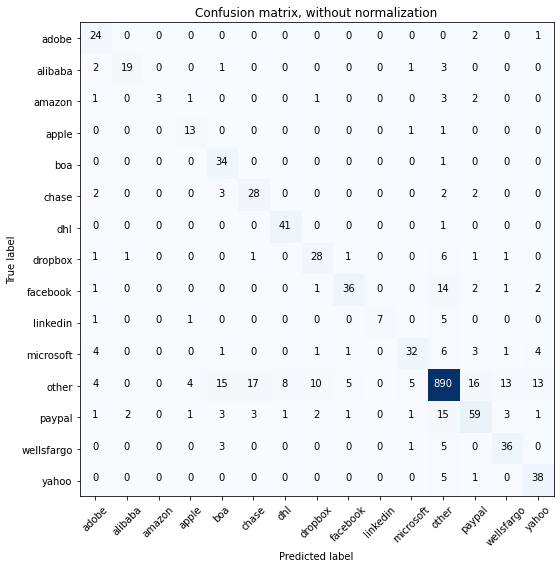

Acc     =  0.837
Pre     =  0.853
Rec     =  0.837
F1      =  0.838

Bal_Acc =  0.739
Bal_Pre =  0.747
Bal_Rec =  0.739
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.59      0.89      0.71        27
     alibaba       0.86      0.73      0.79        26
      amazon       1.00      0.27      0.43        11
       apple       0.65      0.87      0.74        15
         boa       0.57      0.97      0.72        35
       chase       0.57      0.76      0.65        37
         dhl       0.82      0.98      0.89        42
     dropbox       0.65      0.70      0.67        40
    facebook       0.82      0.63      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.78      0.60      0.68        53
       other       0.93      0.89      0.91      1000
      paypal       0.67      0.63      0.65        93
  wellsfargo       0.65      0.80      0.72        45
       yahoo       0.64      0.86      0.74        

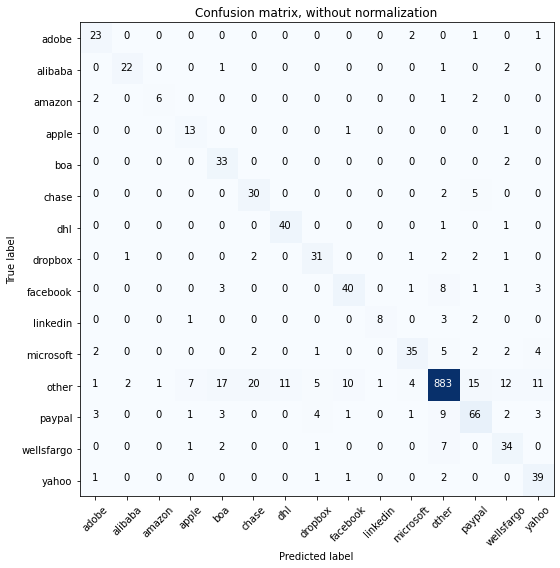

Acc     =  0.847
Pre     =  0.867
Rec     =  0.847
F1      =  0.852

Bal_Acc =  0.784
Bal_Pre =  0.73
Bal_Rec =  0.784
Bal_F1  =  0.756

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.86      0.55      0.67        11
       apple       0.57      0.87      0.68        15
         boa       0.56      0.94      0.70        35
       chase       0.56      0.81      0.66        37
         dhl       0.78      0.95      0.86        42
     dropbox       0.72      0.78      0.75        40
    facebook       0.75      0.70      0.73        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.80      0.66      0.72        53
       other       0.96      0.88      0.92      1000
      paypal       0.69      0.71      0.70        93
  wellsfargo       0.59      0.76      0.66        45
       yahoo       0.64      0.89      0.74        4

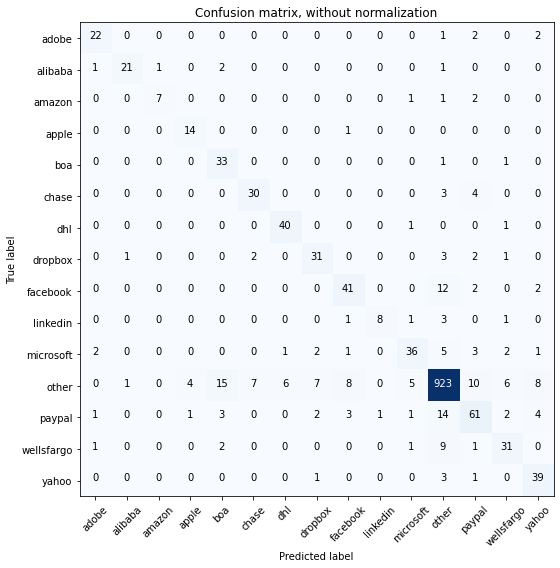

Acc     =  0.869
Pre     =  0.874
Rec     =  0.869
F1      =  0.869

Bal_Acc =  0.786
Bal_Pre =  0.781
Bal_Rec =  0.786
Bal_F1  =  0.783

              precision    recall  f1-score   support

       adobe       0.81      0.81      0.81        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.88      0.64      0.74        11
       apple       0.74      0.93      0.82        15
         boa       0.60      0.94      0.73        35
       chase       0.77      0.81      0.79        37
         dhl       0.85      0.95      0.90        42
     dropbox       0.72      0.78      0.75        40
    facebook       0.75      0.72      0.73        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.78      0.68      0.73        53
       other       0.94      0.92      0.93      1000
      paypal       0.69      0.66      0.67        93
  wellsfargo       0.69      0.69      0.69        45
       yahoo       0.70      0.89      0.78        

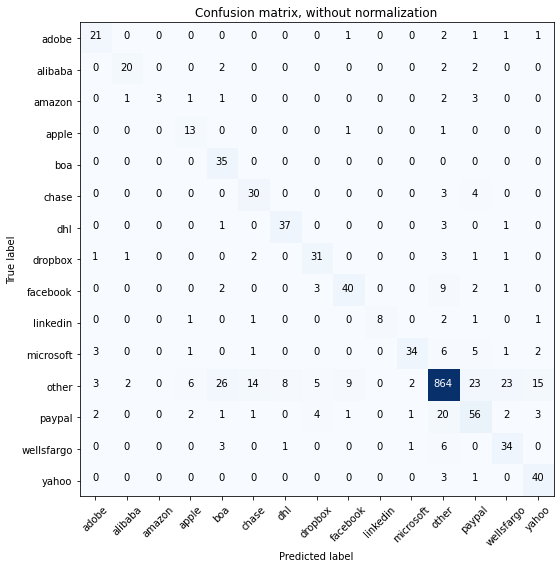

Acc     =  0.823
Pre     =  0.848
Rec     =  0.823
F1      =  0.828

Bal_Acc =  0.747
Bal_Pre =  0.736
Bal_Rec =  0.747
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.83      0.77      0.80        26
      amazon       1.00      0.27      0.43        11
       apple       0.54      0.87      0.67        15
         boa       0.49      1.00      0.66        35
       chase       0.61      0.81      0.70        37
         dhl       0.80      0.88      0.84        42
     dropbox       0.72      0.78      0.75        40
    facebook       0.77      0.70      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.64      0.75        53
       other       0.93      0.86      0.90      1000
      paypal       0.57      0.60      0.58        93
  wellsfargo       0.53      0.76      0.62        45
       yahoo       0.65      0.91      0.75        

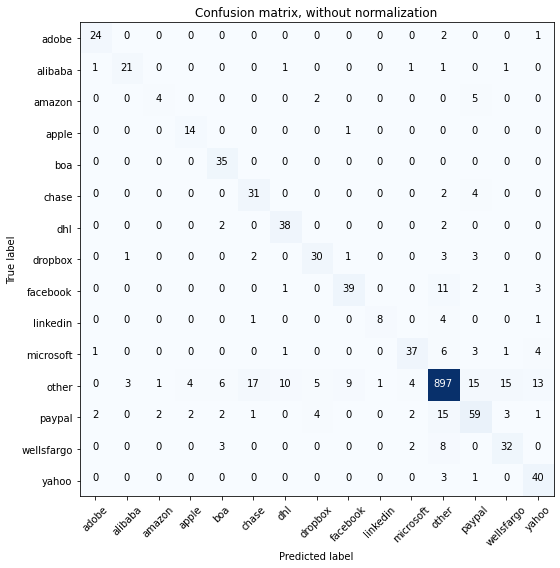

Acc     =  0.851
Pre     =  0.861
Rec     =  0.851
F1      =  0.852

Bal_Acc =  0.773
Bal_Pre =  0.738
Bal_Rec =  0.773
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.86      0.89      0.87        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.57      0.36      0.44        11
       apple       0.70      0.93      0.80        15
         boa       0.73      1.00      0.84        35
       chase       0.60      0.84      0.70        37
         dhl       0.75      0.90      0.82        42
     dropbox       0.73      0.75      0.74        40
    facebook       0.78      0.68      0.73        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.80      0.70      0.75        53
       other       0.94      0.90      0.92      1000
      paypal       0.64      0.63      0.64        93
  wellsfargo       0.60      0.71      0.65        45
       yahoo       0.63      0.91      0.75        

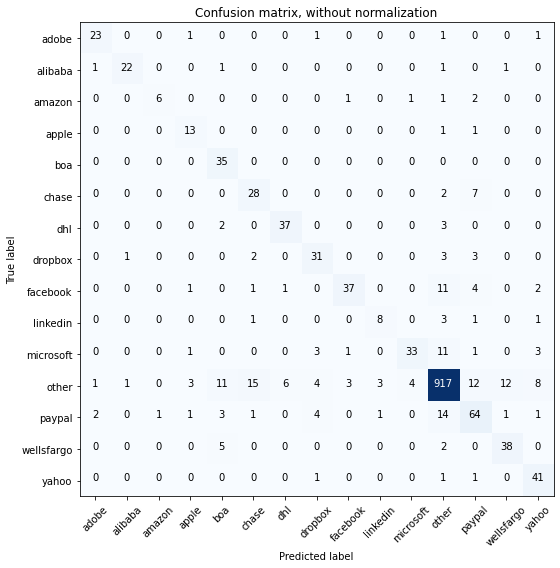

Acc     =  0.866
Pre     =  0.877
Rec     =  0.866
F1      =  0.868

Bal_Acc =  0.783
Bal_Pre =  0.766
Bal_Rec =  0.783
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.85      0.85      0.85        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.86      0.55      0.67        11
       apple       0.65      0.87      0.74        15
         boa       0.61      1.00      0.76        35
       chase       0.58      0.76      0.66        37
         dhl       0.84      0.88      0.86        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.88      0.65      0.75        57
    linkedin       0.67      0.57      0.62        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.92      0.93      1000
      paypal       0.67      0.69      0.68        93
  wellsfargo       0.73      0.84      0.78        45
       yahoo       0.72      0.93      0.81        

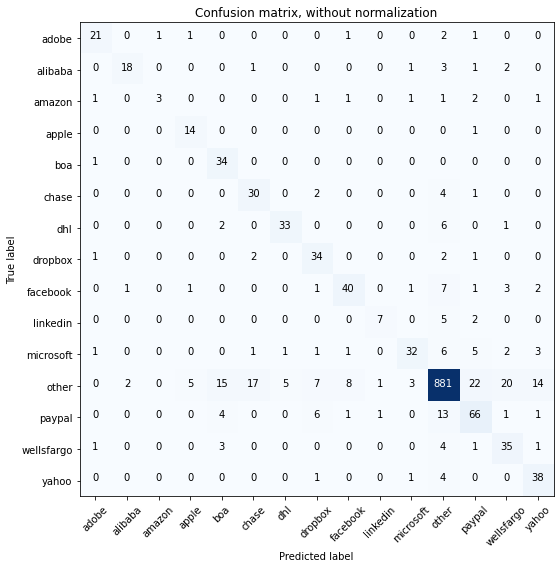

Acc     =  0.836
Pre     =  0.854
Rec     =  0.836
F1      =  0.839

Bal_Acc =  0.742
Bal_Pre =  0.724
Bal_Rec =  0.742
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.81      0.78      0.79        27
     alibaba       0.86      0.69      0.77        26
      amazon       0.75      0.27      0.40        11
       apple       0.67      0.93      0.78        15
         boa       0.59      0.97      0.73        35
       chase       0.59      0.81      0.68        37
         dhl       0.85      0.79      0.81        42
     dropbox       0.64      0.85      0.73        40
    facebook       0.77      0.70      0.73        57
    linkedin       0.78      0.50      0.61        14
   microsoft       0.82      0.60      0.70        53
       other       0.94      0.88      0.91      1000
      paypal       0.63      0.71      0.67        93
  wellsfargo       0.55      0.78      0.64        45
       yahoo       0.63      0.86      0.73        

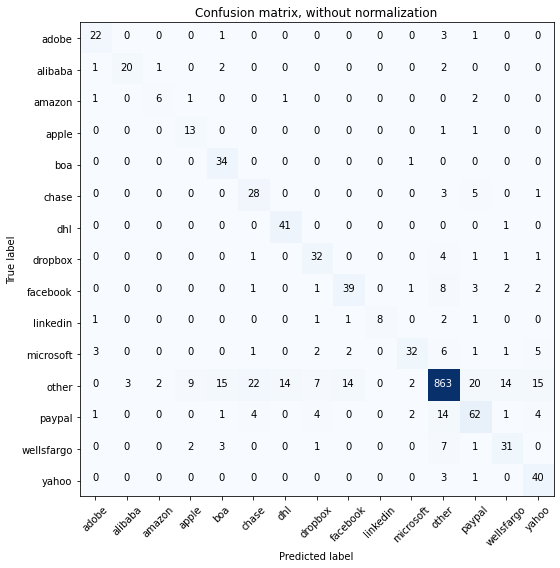

Acc     =  0.826
Pre     =  0.849
Rec     =  0.826
F1      =  0.831

Bal_Acc =  0.766
Bal_Pre =  0.708
Bal_Rec =  0.766
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.67      0.55      0.60        11
       apple       0.52      0.87      0.65        15
         boa       0.61      0.97      0.75        35
       chase       0.49      0.76      0.60        37
         dhl       0.73      0.98      0.84        42
     dropbox       0.67      0.80      0.73        40
    facebook       0.70      0.68      0.69        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.60      0.70        53
       other       0.94      0.86      0.90      1000
      paypal       0.63      0.67      0.65        93
  wellsfargo       0.61      0.69      0.65        45
       yahoo       0.59      0.91      0.71        

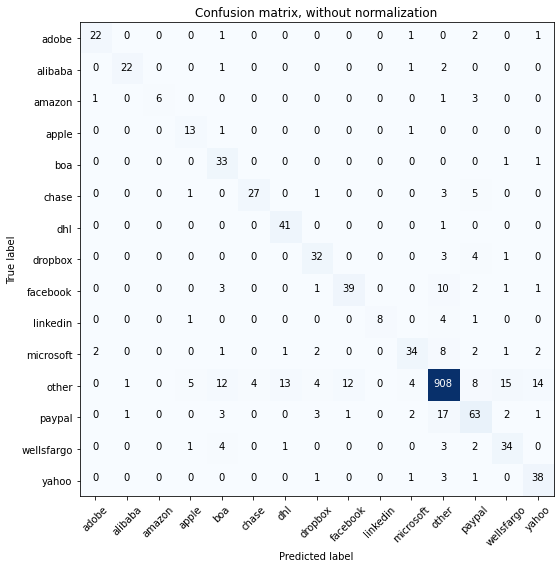

Acc     =  0.858
Pre     =  0.871
Rec     =  0.858
F1      =  0.86

Bal_Acc =  0.775
Bal_Pre =  0.781
Bal_Rec =  0.775
Bal_F1  =  0.778

              precision    recall  f1-score   support

       adobe       0.88      0.81      0.85        27
     alibaba       0.92      0.85      0.88        26
      amazon       1.00      0.55      0.71        11
       apple       0.62      0.87      0.72        15
         boa       0.56      0.94      0.70        35
       chase       0.87      0.73      0.79        37
         dhl       0.73      0.98      0.84        42
     dropbox       0.73      0.80      0.76        40
    facebook       0.75      0.68      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.77      0.64      0.70        53
       other       0.94      0.91      0.93      1000
      paypal       0.68      0.68      0.68        93
  wellsfargo       0.62      0.76      0.68        45
       yahoo       0.66      0.86      0.75        4

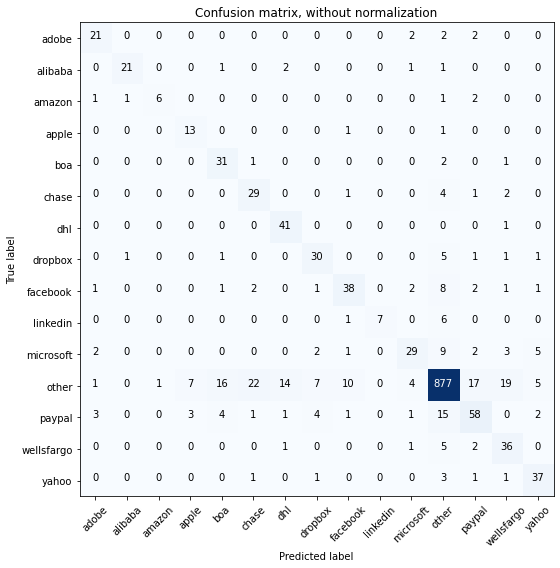

Acc     =  0.828
Pre     =  0.846
Rec     =  0.828
F1      =  0.831

Bal_Acc =  0.75
Bal_Pre =  0.722
Bal_Rec =  0.75
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.86      0.55      0.67        11
       apple       0.57      0.87      0.68        15
         boa       0.57      0.89      0.70        35
       chase       0.52      0.78      0.62        37
         dhl       0.69      0.98      0.81        42
     dropbox       0.67      0.75      0.71        40
    facebook       0.72      0.67      0.69        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.72      0.55      0.62        53
       other       0.93      0.88      0.90      1000
      paypal       0.66      0.62      0.64        93
  wellsfargo       0.55      0.80      0.65        45
       yahoo       0.73      0.84      0.78        44

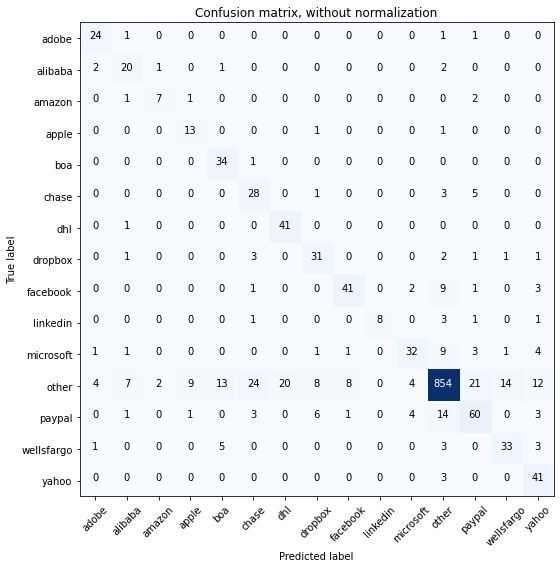

Acc     =  0.823
Pre     =  0.848
Rec     =  0.823
F1      =  0.829

Bal_Acc =  0.78
Bal_Pre =  0.696
Bal_Rec =  0.78
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.75      0.89      0.81        27
     alibaba       0.61      0.77      0.68        26
      amazon       0.70      0.64      0.67        11
       apple       0.54      0.87      0.67        15
         boa       0.64      0.97      0.77        35
       chase       0.46      0.76      0.57        37
         dhl       0.67      0.98      0.80        42
     dropbox       0.65      0.78      0.70        40
    facebook       0.80      0.72      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.76      0.60      0.67        53
       other       0.94      0.85      0.90      1000
      paypal       0.63      0.65      0.64        93
  wellsfargo       0.67      0.73      0.70        45
       yahoo       0.60      0.93      0.73        44

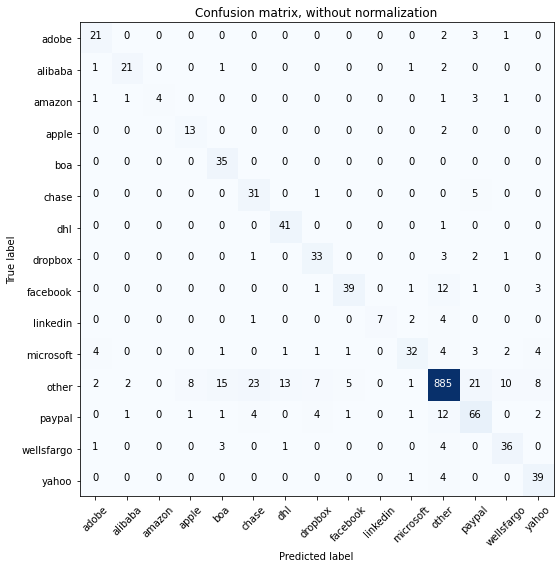

Acc     =  0.847
Pre     =  0.866
Rec     =  0.847
F1      =  0.85

Bal_Acc =  0.768
Bal_Pre =  0.757
Bal_Rec =  0.768
Bal_F1  =  0.762

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.84      0.81      0.82        26
      amazon       1.00      0.36      0.53        11
       apple       0.59      0.87      0.70        15
         boa       0.62      1.00      0.77        35
       chase       0.52      0.84      0.64        37
         dhl       0.73      0.98      0.84        42
     dropbox       0.70      0.82      0.76        40
    facebook       0.85      0.68      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.60      0.70        53
       other       0.95      0.89      0.91      1000
      paypal       0.63      0.71      0.67        93
  wellsfargo       0.71      0.80      0.75        45
       yahoo       0.70      0.89      0.78        4

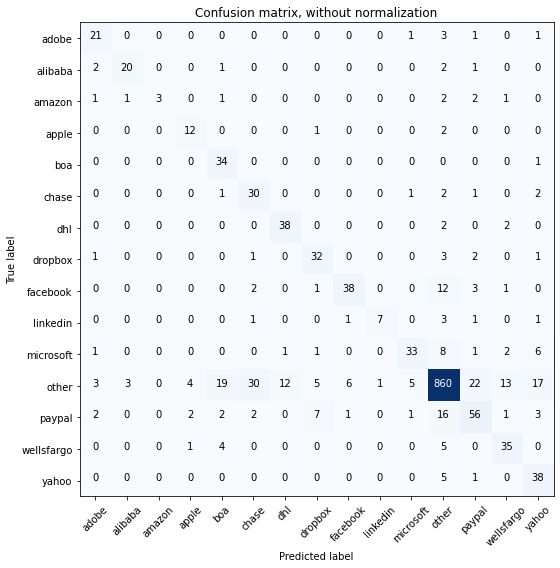

Acc     =  0.817
Pre     =  0.842
Rec     =  0.817
F1      =  0.822

Bal_Acc =  0.733
Bal_Pre =  0.72
Bal_Rec =  0.733
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        27
     alibaba       0.83      0.77      0.80        26
      amazon       1.00      0.27      0.43        11
       apple       0.63      0.80      0.71        15
         boa       0.55      0.97      0.70        35
       chase       0.45      0.81      0.58        37
         dhl       0.75      0.90      0.82        42
     dropbox       0.68      0.80      0.74        40
    facebook       0.83      0.67      0.74        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.80      0.62      0.70        53
       other       0.93      0.86      0.89      1000
      paypal       0.62      0.60      0.61        93
  wellsfargo       0.64      0.78      0.70        45
       yahoo       0.54      0.86      0.67        4

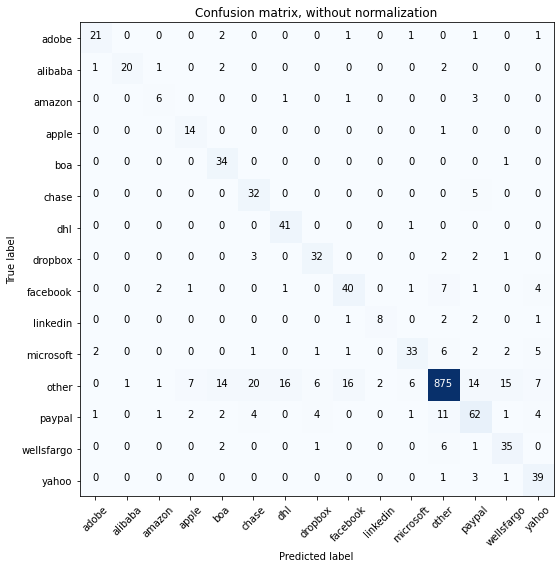

Acc     =  0.84
Pre     =  0.862
Rec     =  0.84
F1      =  0.845

Bal_Acc =  0.783
Bal_Pre =  0.706
Bal_Rec =  0.783
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.84      0.78      0.81        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.55      0.55      0.55        11
       apple       0.58      0.93      0.72        15
         boa       0.61      0.97      0.75        35
       chase       0.53      0.86      0.66        37
         dhl       0.69      0.98      0.81        42
     dropbox       0.73      0.80      0.76        40
    facebook       0.67      0.70      0.68        57
    linkedin       0.80      0.57      0.67        14
   microsoft       0.77      0.62      0.69        53
       other       0.96      0.88      0.91      1000
      paypal       0.65      0.67      0.66        93
  wellsfargo       0.62      0.78      0.69        45
       yahoo       0.64      0.89      0.74        44

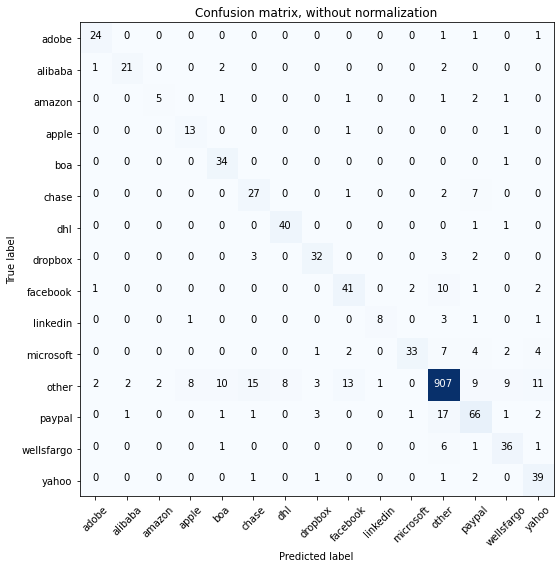

Acc     =  0.862
Pre     =  0.873
Rec     =  0.862
F1      =  0.864

Bal_Acc =  0.779
Bal_Pre =  0.76
Bal_Rec =  0.779
Bal_F1  =  0.769

              precision    recall  f1-score   support

       adobe       0.86      0.89      0.87        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.71      0.45      0.56        11
       apple       0.59      0.87      0.70        15
         boa       0.69      0.97      0.81        35
       chase       0.57      0.73      0.64        37
         dhl       0.83      0.95      0.89        42
     dropbox       0.80      0.80      0.80        40
    facebook       0.69      0.72      0.71        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.92      0.62      0.74        53
       other       0.94      0.91      0.93      1000
      paypal       0.68      0.71      0.69        93
  wellsfargo       0.69      0.80      0.74        45
       yahoo       0.64      0.89      0.74        4

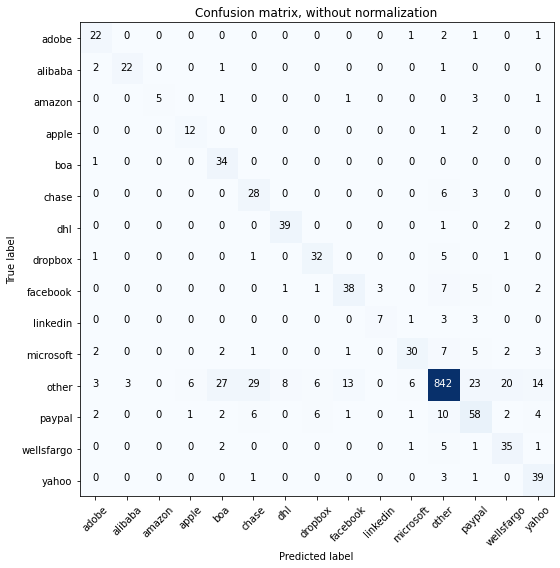

Acc     =  0.808
Pre     =  0.84
Rec     =  0.808
F1      =  0.816

Bal_Acc =  0.749
Bal_Pre =  0.695
Bal_Rec =  0.749
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.88      0.85      0.86        26
      amazon       1.00      0.45      0.62        11
       apple       0.63      0.80      0.71        15
         boa       0.49      0.97      0.65        35
       chase       0.42      0.76      0.54        37
         dhl       0.81      0.93      0.87        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.70      0.67      0.68        57
    linkedin       0.70      0.50      0.58        14
   microsoft       0.75      0.57      0.65        53
       other       0.94      0.84      0.89      1000
      paypal       0.55      0.62      0.59        93
  wellsfargo       0.56      0.78      0.65        45
       yahoo       0.60      0.89      0.72        4

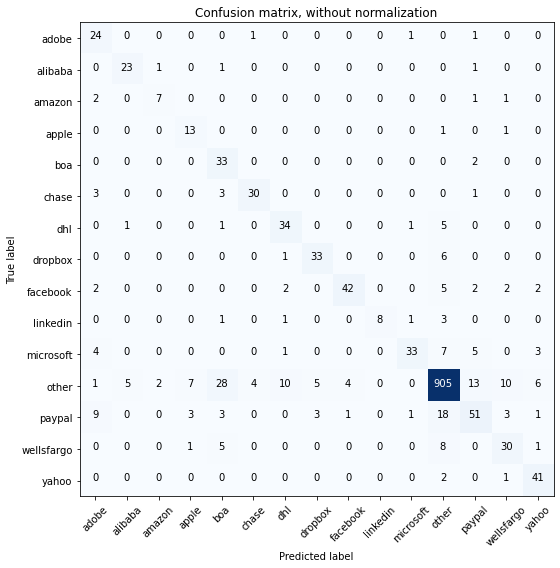

Acc     =  0.849
Pre     =  0.869
Rec     =  0.849
F1      =  0.853

Bal_Acc =  0.777
Bal_Pre =  0.743
Bal_Rec =  0.777
Bal_F1  =  0.76

              precision    recall  f1-score   support

       adobe       0.53      0.89      0.67        27
     alibaba       0.79      0.88      0.84        26
      amazon       0.70      0.64      0.67        11
       apple       0.54      0.87      0.67        15
         boa       0.44      0.94      0.60        35
       chase       0.86      0.81      0.83        37
         dhl       0.69      0.81      0.75        42
     dropbox       0.80      0.82      0.81        40
    facebook       0.89      0.74      0.81        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.94      0.91      0.92      1000
      paypal       0.66      0.55      0.60        93
  wellsfargo       0.62      0.67      0.65        45
       yahoo       0.76      0.93      0.84        4

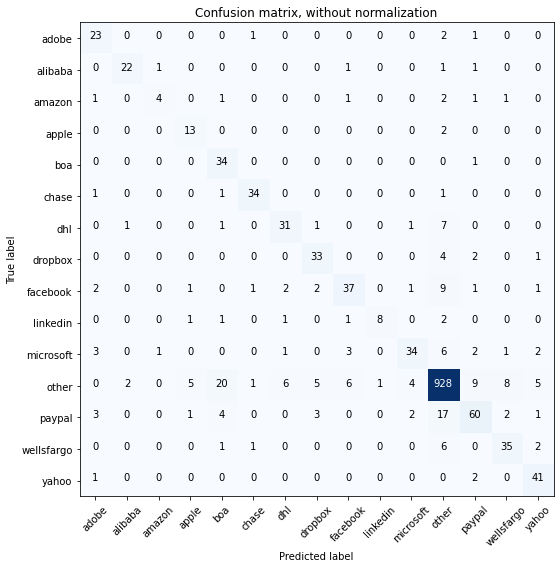

Acc     =  0.869
Pre     =  0.876
Rec     =  0.869
F1      =  0.869

Bal_Acc =  0.768
Bal_Pre =  0.763
Bal_Rec =  0.768
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.67      0.36      0.47        11
       apple       0.62      0.87      0.72        15
         boa       0.54      0.97      0.69        35
       chase       0.89      0.92      0.91        37
         dhl       0.76      0.74      0.75        42
     dropbox       0.75      0.82      0.79        40
    facebook       0.76      0.65      0.70        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.81      0.64      0.72        53
       other       0.94      0.93      0.93      1000
      paypal       0.75      0.65      0.69        93
  wellsfargo       0.74      0.78      0.76        45
       yahoo       0.77      0.93      0.85        

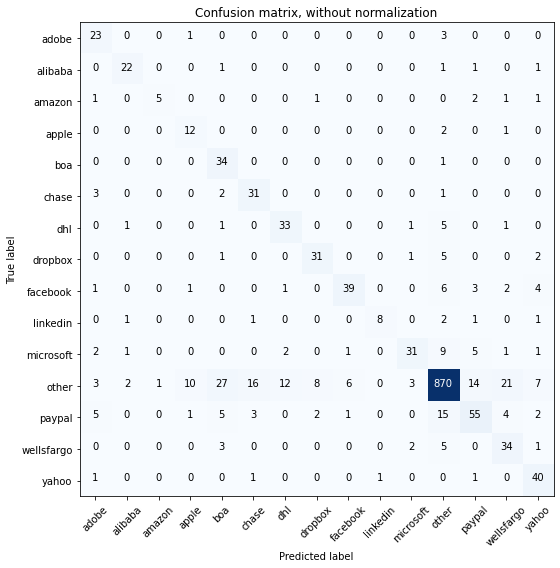

Acc     =  0.824
Pre     =  0.85
Rec     =  0.824
F1      =  0.83

Bal_Acc =  0.753
Bal_Pre =  0.702
Bal_Rec =  0.753
Bal_F1  =  0.727

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.83      0.45      0.59        11
       apple       0.48      0.80      0.60        15
         boa       0.46      0.97      0.62        35
       chase       0.60      0.84      0.70        37
         dhl       0.69      0.79      0.73        42
     dropbox       0.74      0.78      0.76        40
    facebook       0.83      0.68      0.75        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.82      0.58      0.68        53
       other       0.94      0.87      0.90      1000
      paypal       0.67      0.59      0.63        93
  wellsfargo       0.52      0.76      0.62        45
       yahoo       0.67      0.91      0.77        44

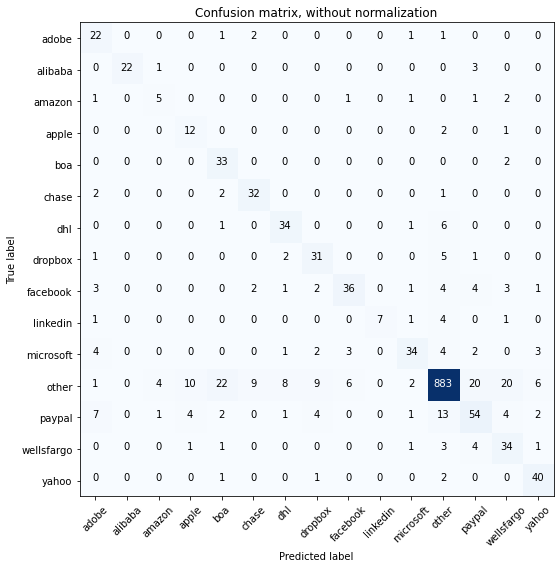

Acc     =  0.831
Pre     =  0.856
Rec     =  0.831
F1      =  0.837

Bal_Acc =  0.747
Bal_Pre =  0.694
Bal_Rec =  0.747
Bal_F1  =  0.72

              precision    recall  f1-score   support

       adobe       0.52      0.81      0.64        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.45      0.45      0.45        11
       apple       0.44      0.80      0.57        15
         boa       0.52      0.94      0.67        35
       chase       0.71      0.86      0.78        37
         dhl       0.72      0.81      0.76        42
     dropbox       0.63      0.78      0.70        40
    facebook       0.78      0.63      0.70        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.79      0.64      0.71        53
       other       0.95      0.88      0.92      1000
      paypal       0.61      0.58      0.59        93
  wellsfargo       0.51      0.76      0.61        45
       yahoo       0.75      0.91      0.82        4

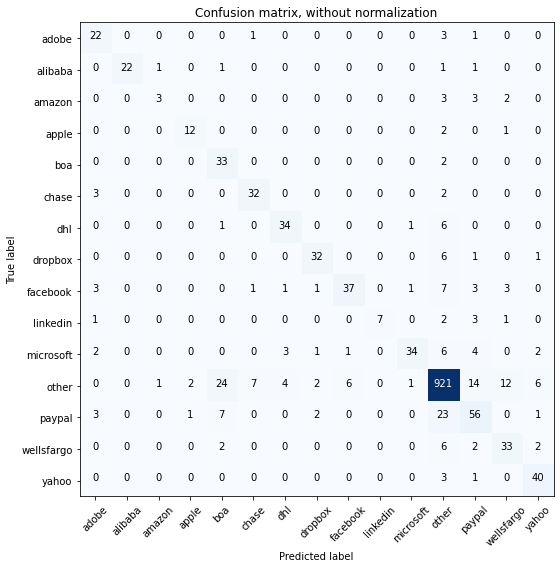

Acc     =  0.856
Pre     =  0.867
Rec     =  0.856
F1      =  0.857

Bal_Acc =  0.74
Bal_Pre =  0.779
Bal_Rec =  0.74
Bal_F1  =  0.759

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.60      0.27      0.37        11
       apple       0.80      0.80      0.80        15
         boa       0.49      0.94      0.64        35
       chase       0.78      0.86      0.82        37
         dhl       0.81      0.81      0.81        42
     dropbox       0.84      0.80      0.82        40
    facebook       0.84      0.65      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.92      0.64      0.76        53
       other       0.93      0.92      0.92      1000
      paypal       0.63      0.60      0.62        93
  wellsfargo       0.63      0.73      0.68        45
       yahoo       0.77      0.91      0.83        44

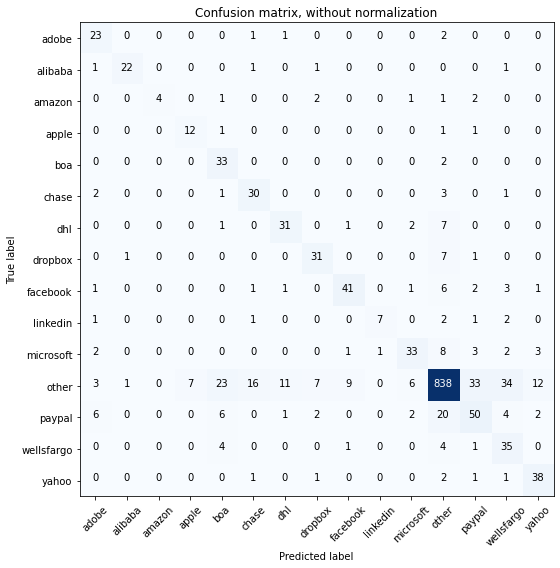

Acc     =  0.798
Pre     =  0.83
Rec     =  0.798
F1      =  0.806

Bal_Acc =  0.732
Bal_Pre =  0.702
Bal_Rec =  0.732
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.92      0.85      0.88        26
      amazon       1.00      0.36      0.53        11
       apple       0.63      0.80      0.71        15
         boa       0.47      0.94      0.63        35
       chase       0.59      0.81      0.68        37
         dhl       0.69      0.74      0.71        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.77      0.72      0.75        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.73      0.62      0.67        53
       other       0.93      0.84      0.88      1000
      paypal       0.53      0.54      0.53        93
  wellsfargo       0.42      0.78      0.55        45
       yahoo       0.68      0.86      0.76        4

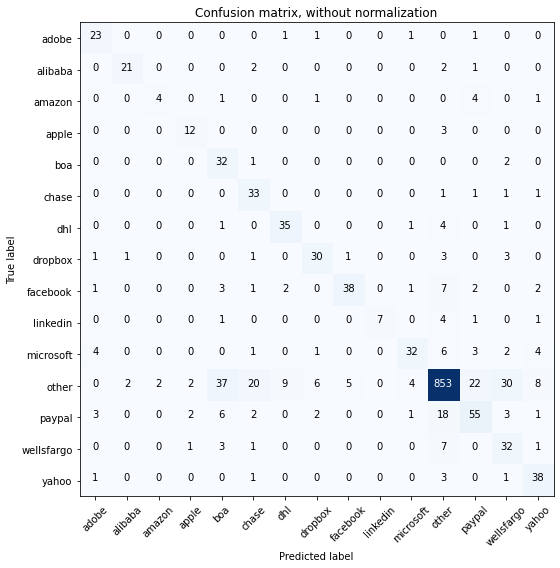

Acc     =  0.809
Pre     =  0.845
Rec     =  0.809
F1      =  0.818

Bal_Acc =  0.733
Bal_Pre =  0.709
Bal_Rec =  0.733
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.71      0.80      0.75        15
         boa       0.38      0.91      0.54        35
       chase       0.52      0.89      0.66        37
         dhl       0.74      0.83      0.79        42
     dropbox       0.73      0.75      0.74        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.80      0.60      0.69        53
       other       0.94      0.85      0.89      1000
      paypal       0.61      0.59      0.60        93
  wellsfargo       0.43      0.71      0.53        45
       yahoo       0.67      0.86      0.75        

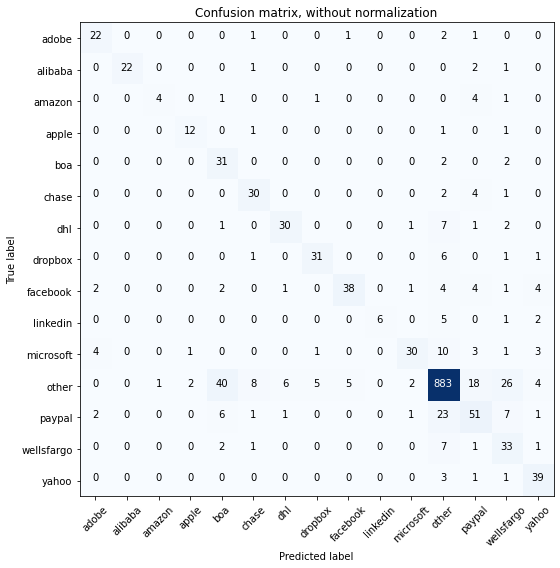

Acc     =  0.82
Pre     =  0.849
Rec     =  0.82
F1      =  0.827

Bal_Acc =  0.715
Bal_Pre =  0.756
Bal_Rec =  0.715
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.80      0.36      0.50        11
       apple       0.80      0.80      0.80        15
         boa       0.37      0.89      0.53        35
       chase       0.68      0.81      0.74        37
         dhl       0.79      0.71      0.75        42
     dropbox       0.82      0.78      0.79        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.86      0.57      0.68        53
       other       0.92      0.88      0.90      1000
      paypal       0.57      0.55      0.56        93
  wellsfargo       0.42      0.73      0.53        45
       yahoo       0.71      0.89      0.79        44

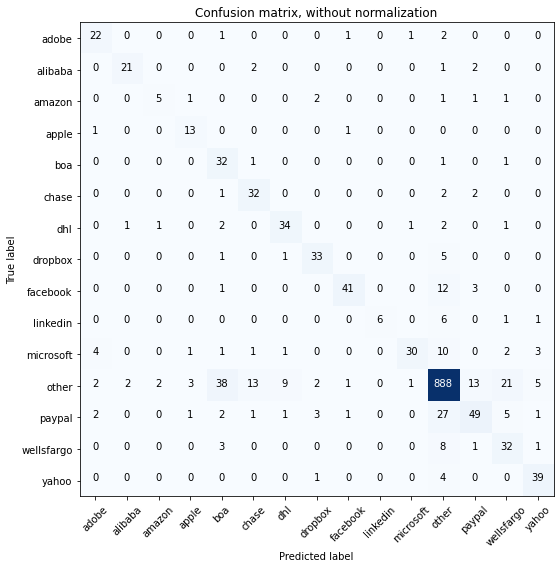

Acc     =  0.83
Pre     =  0.852
Rec     =  0.83
F1      =  0.833

Bal_Acc =  0.739
Bal_Pre =  0.745
Bal_Rec =  0.739
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.62      0.45      0.53        11
       apple       0.68      0.87      0.76        15
         boa       0.39      0.91      0.55        35
       chase       0.64      0.86      0.74        37
         dhl       0.74      0.81      0.77        42
     dropbox       0.80      0.82      0.81        40
    facebook       0.91      0.72      0.80        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.91      0.57      0.70        53
       other       0.92      0.89      0.90      1000
      paypal       0.69      0.53      0.60        93
  wellsfargo       0.50      0.71      0.59        45
       yahoo       0.78      0.89      0.83        44

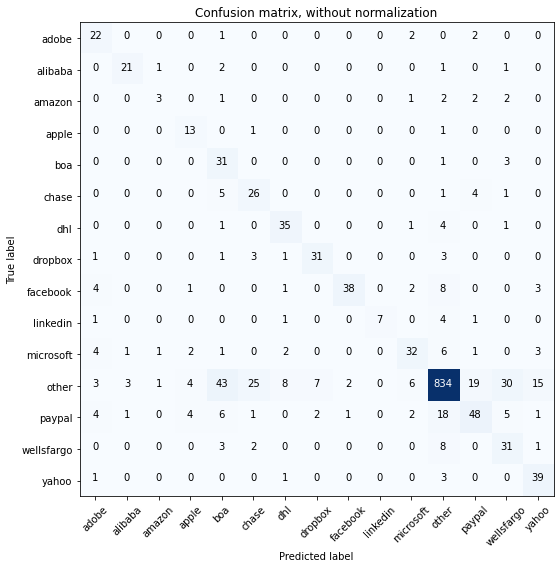

Acc     =  0.787
Pre     =  0.831
Rec     =  0.787
F1      =  0.799

Bal_Acc =  0.71
Bal_Pre =  0.659
Bal_Rec =  0.71
Bal_F1  =  0.684

              precision    recall  f1-score   support

       adobe       0.55      0.81      0.66        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.50      0.27      0.35        11
       apple       0.54      0.87      0.67        15
         boa       0.33      0.89      0.48        35
       chase       0.45      0.70      0.55        37
         dhl       0.71      0.83      0.77        42
     dropbox       0.78      0.78      0.78        40
    facebook       0.93      0.67      0.78        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.70      0.60      0.65        53
       other       0.93      0.83      0.88      1000
      paypal       0.62      0.52      0.56        93
  wellsfargo       0.42      0.69      0.52        45
       yahoo       0.63      0.89      0.74        44

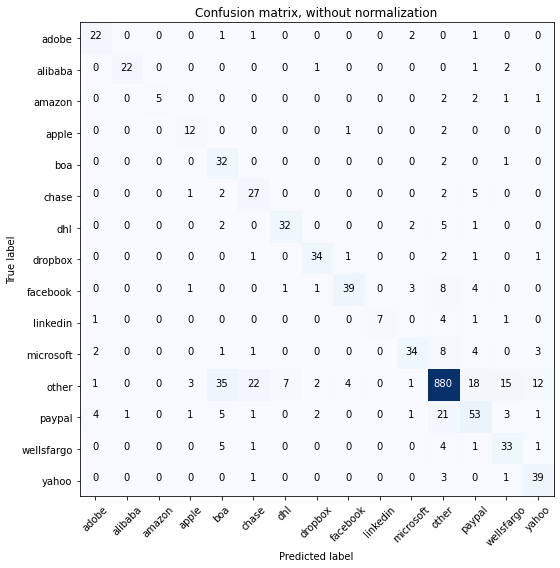

Acc     =  0.826
Pre     =  0.853
Rec     =  0.826
F1      =  0.833

Bal_Acc =  0.738
Bal_Pre =  0.753
Bal_Rec =  0.738
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.96      0.85      0.90        26
      amazon       1.00      0.45      0.62        11
       apple       0.67      0.80      0.73        15
         boa       0.39      0.91      0.54        35
       chase       0.49      0.73      0.59        37
         dhl       0.80      0.76      0.78        42
     dropbox       0.85      0.85      0.85        40
    facebook       0.87      0.68      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.79      0.64      0.71        53
       other       0.93      0.88      0.91      1000
      paypal       0.58      0.57      0.57        93
  wellsfargo       0.58      0.73      0.65        45
       yahoo       0.67      0.89      0.76        

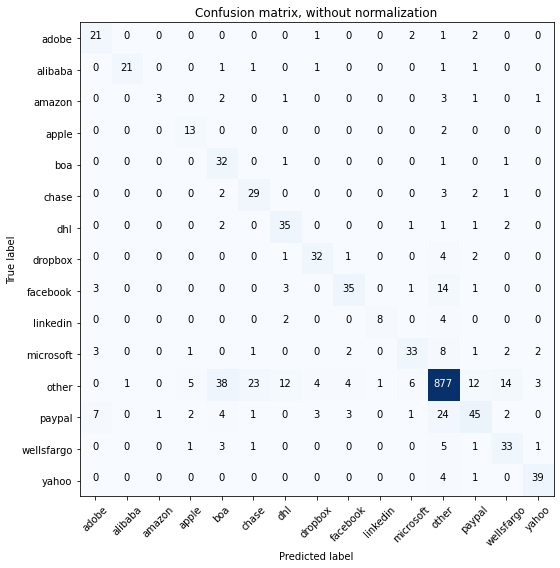

Acc     =  0.816
Pre     =  0.839
Rec     =  0.816
F1      =  0.821

Bal_Acc =  0.723
Bal_Pre =  0.71
Bal_Rec =  0.723
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.75      0.27      0.40        11
       apple       0.59      0.87      0.70        15
         boa       0.38      0.91      0.54        35
       chase       0.52      0.78      0.62        37
         dhl       0.64      0.83      0.72        42
     dropbox       0.78      0.80      0.79        40
    facebook       0.78      0.61      0.69        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.75      0.62      0.68        53
       other       0.92      0.88      0.90      1000
      paypal       0.64      0.48      0.55        93
  wellsfargo       0.60      0.73      0.66        45
       yahoo       0.85      0.89      0.87        4

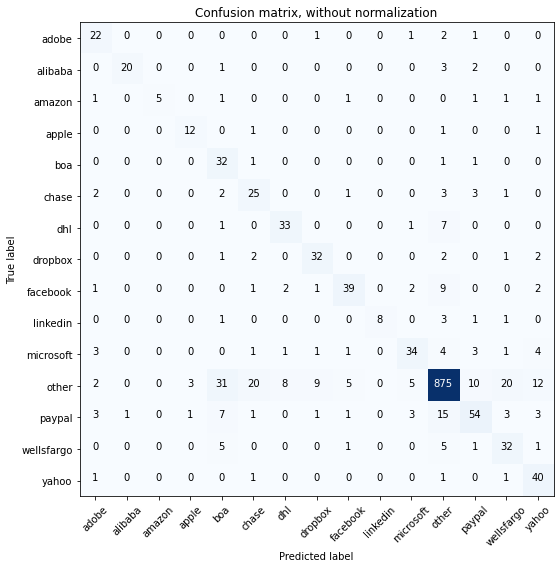

Acc     =  0.821
Pre     =  0.851
Rec     =  0.821
F1      =  0.828

Bal_Acc =  0.732
Bal_Pre =  0.731
Bal_Rec =  0.732
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.95      0.77      0.85        26
      amazon       1.00      0.45      0.62        11
       apple       0.75      0.80      0.77        15
         boa       0.39      0.91      0.55        35
       chase       0.47      0.68      0.56        37
         dhl       0.75      0.79      0.77        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.80      0.68      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.74      0.64      0.69        53
       other       0.94      0.88      0.91      1000
      paypal       0.70      0.58      0.64        93
  wellsfargo       0.52      0.71      0.60        45
       yahoo       0.61      0.91      0.73        

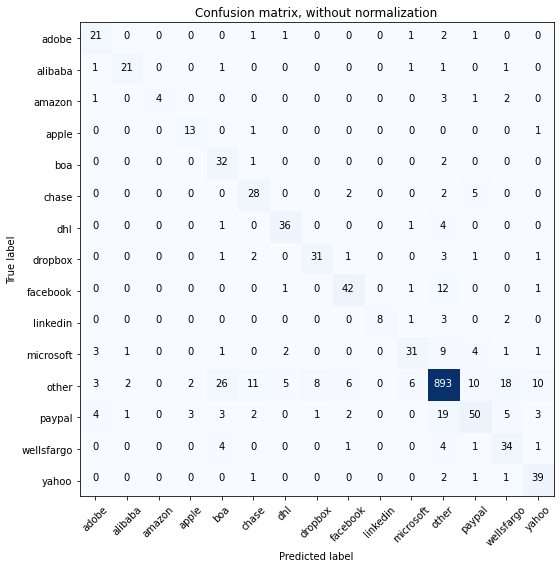

Acc     =  0.834
Pre     =  0.851
Rec     =  0.834
F1      =  0.836

Bal_Acc =  0.739
Bal_Pre =  0.745
Bal_Rec =  0.739
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        27
     alibaba       0.84      0.81      0.82        26
      amazon       1.00      0.36      0.53        11
       apple       0.72      0.87      0.79        15
         boa       0.46      0.91      0.62        35
       chase       0.60      0.76      0.67        37
         dhl       0.80      0.86      0.83        42
     dropbox       0.78      0.78      0.78        40
    facebook       0.78      0.74      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.74      0.58      0.65        53
       other       0.93      0.89      0.91      1000
      paypal       0.68      0.54      0.60        93
  wellsfargo       0.53      0.76      0.62        45
       yahoo       0.68      0.89      0.77        

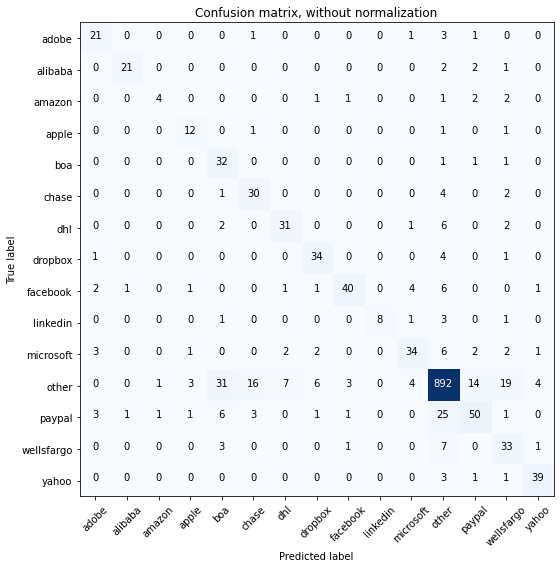

Acc     =  0.832
Pre     =  0.852
Rec     =  0.832
F1      =  0.836

Bal_Acc =  0.735
Bal_Pre =  0.736
Bal_Rec =  0.735
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.67      0.36      0.47        11
       apple       0.67      0.80      0.73        15
         boa       0.42      0.91      0.58        35
       chase       0.59      0.81      0.68        37
         dhl       0.76      0.74      0.75        42
     dropbox       0.76      0.85      0.80        40
    facebook       0.87      0.70      0.78        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.76      0.64      0.69        53
       other       0.93      0.89      0.91      1000
      paypal       0.68      0.54      0.60        93
  wellsfargo       0.49      0.73      0.59        45
       yahoo       0.85      0.89      0.87        

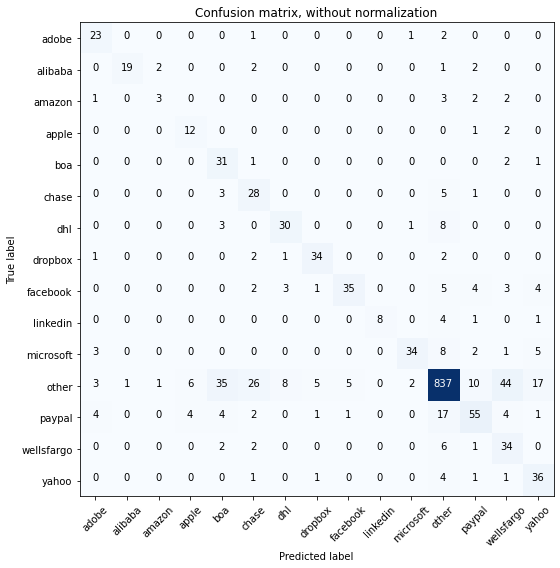

Acc     =  0.792
Pre     =  0.839
Rec     =  0.792
F1      =  0.805

Bal_Acc =  0.713
Bal_Pre =  0.685
Bal_Rec =  0.713
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.95      0.73      0.83        26
      amazon       0.50      0.27      0.35        11
       apple       0.55      0.80      0.65        15
         boa       0.40      0.89      0.55        35
       chase       0.42      0.76      0.54        37
         dhl       0.71      0.71      0.71        42
     dropbox       0.81      0.85      0.83        40
    facebook       0.85      0.61      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.64      0.75        53
       other       0.93      0.84      0.88      1000
      paypal       0.69      0.59      0.64        93
  wellsfargo       0.37      0.76      0.49        45
       yahoo       0.55      0.82      0.66        

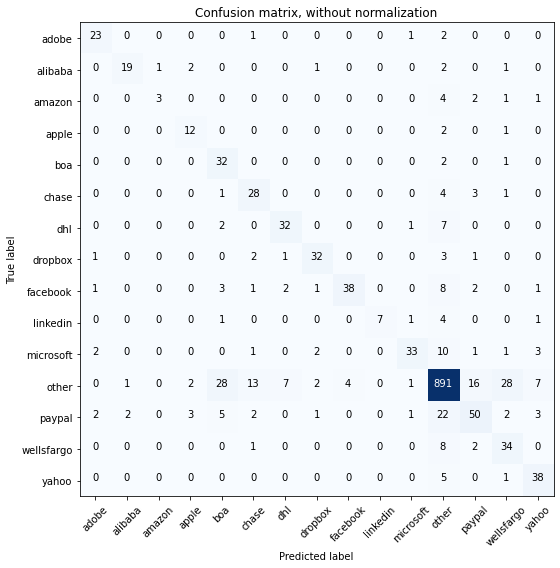

Acc     =  0.827
Pre     =  0.846
Rec     =  0.827
F1      =  0.83

Bal_Acc =  0.715
Bal_Pre =  0.744
Bal_Rec =  0.715
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.79      0.85      0.82        27
     alibaba       0.86      0.73      0.79        26
      amazon       0.75      0.27      0.40        11
       apple       0.63      0.80      0.71        15
         boa       0.44      0.91      0.60        35
       chase       0.57      0.76      0.65        37
         dhl       0.76      0.76      0.76        42
     dropbox       0.82      0.80      0.81        40
    facebook       0.90      0.67      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.62      0.73        53
       other       0.91      0.89      0.90      1000
      paypal       0.65      0.54      0.59        93
  wellsfargo       0.48      0.76      0.59        45
       yahoo       0.70      0.86      0.78        4

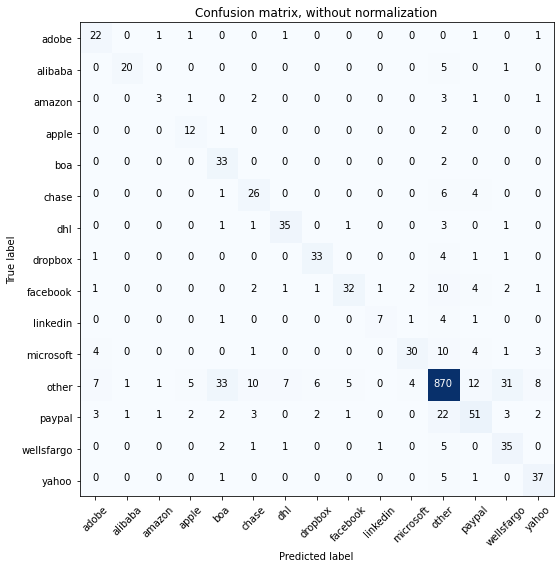

Acc     =  0.81
Pre     =  0.832
Rec     =  0.81
F1      =  0.814

Bal_Acc =  0.708
Bal_Pre =  0.684
Bal_Rec =  0.708
Bal_F1  =  0.696

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.50      0.27      0.35        11
       apple       0.57      0.80      0.67        15
         boa       0.44      0.94      0.60        35
       chase       0.57      0.70      0.63        37
         dhl       0.78      0.83      0.80        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.82      0.56      0.67        57
    linkedin       0.78      0.50      0.61        14
   microsoft       0.81      0.57      0.67        53
       other       0.91      0.87      0.89      1000
      paypal       0.64      0.55      0.59        93
  wellsfargo       0.47      0.78      0.58        45
       yahoo       0.70      0.84      0.76        44

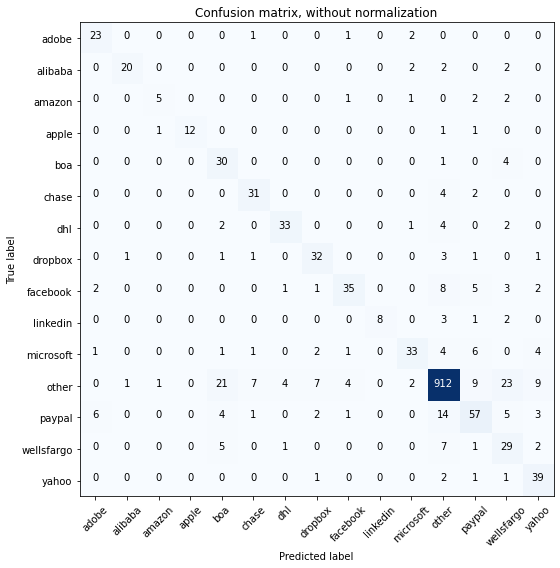

Acc     =  0.844
Pre     =  0.864
Rec     =  0.844
F1      =  0.849

Bal_Acc =  0.735
Bal_Pre =  0.759
Bal_Rec =  0.735
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.71      0.45      0.56        11
       apple       1.00      0.80      0.89        15
         boa       0.47      0.86      0.61        35
       chase       0.74      0.84      0.78        37
         dhl       0.85      0.79      0.81        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.81      0.61      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.62      0.70        53
       other       0.95      0.91      0.93      1000
      paypal       0.66      0.61      0.64        93
  wellsfargo       0.40      0.64      0.49        45
       yahoo       0.65      0.89      0.75        

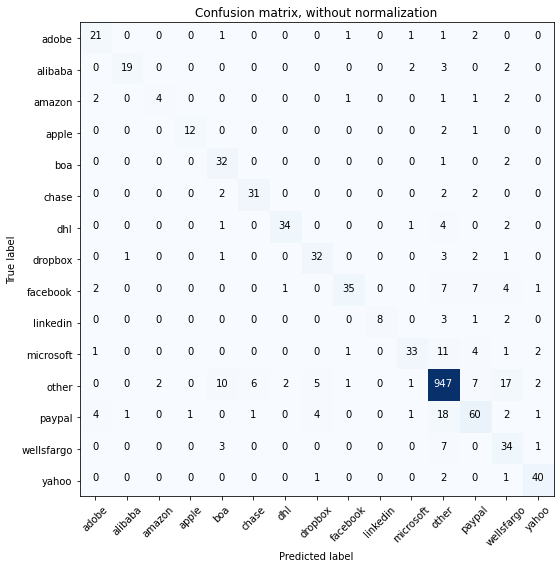

Acc     =  0.872
Pre     =  0.88
Rec     =  0.872
F1      =  0.872

Bal_Acc =  0.74
Bal_Pre =  0.802
Bal_Rec =  0.74
Bal_F1  =  0.77

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.90      0.73      0.81        26
      amazon       0.67      0.36      0.47        11
       apple       0.92      0.80      0.86        15
         boa       0.64      0.91      0.75        35
       chase       0.82      0.84      0.83        37
         dhl       0.92      0.81      0.86        42
     dropbox       0.76      0.80      0.78        40
    facebook       0.90      0.61      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.62      0.72        53
       other       0.94      0.95      0.94      1000
      paypal       0.69      0.65      0.67        93
  wellsfargo       0.49      0.76      0.59        45
       yahoo       0.85      0.91      0.88        44



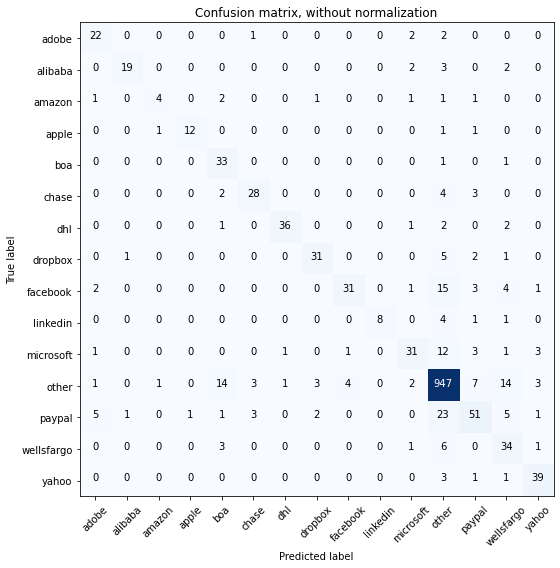

Acc     =  0.862
Pre     =  0.867
Rec     =  0.862
F1      =  0.859

Bal_Acc =  0.725
Bal_Pre =  0.795
Bal_Rec =  0.725
Bal_F1  =  0.758

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.90      0.73      0.81        26
      amazon       0.67      0.36      0.47        11
       apple       0.92      0.80      0.86        15
         boa       0.59      0.94      0.73        35
       chase       0.80      0.76      0.78        37
         dhl       0.95      0.86      0.90        42
     dropbox       0.84      0.78      0.81        40
    facebook       0.86      0.54      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.76      0.58      0.66        53
       other       0.92      0.95      0.93      1000
      paypal       0.70      0.55      0.61        93
  wellsfargo       0.52      0.76      0.61        45
       yahoo       0.81      0.89      0.85        

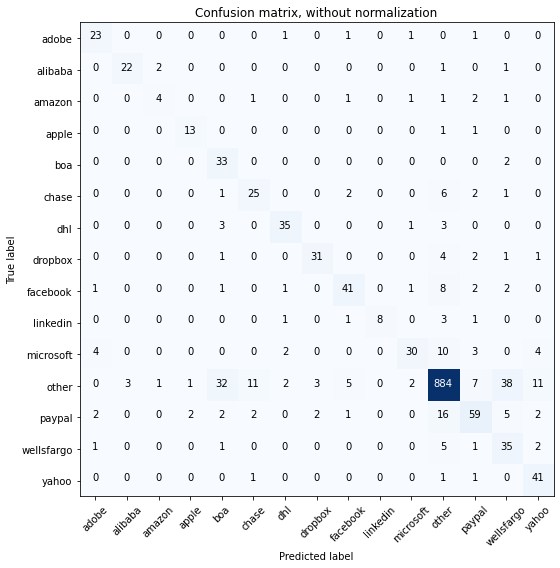

Acc     =  0.834
Pre     =  0.861
Rec     =  0.834
F1      =  0.841

Bal_Acc =  0.749
Bal_Pre =  0.742
Bal_Rec =  0.749
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.57      0.36      0.44        11
       apple       0.81      0.87      0.84        15
         boa       0.45      0.94      0.61        35
       chase       0.62      0.68      0.65        37
         dhl       0.83      0.83      0.83        42
     dropbox       0.86      0.78      0.82        40
    facebook       0.79      0.72      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.83      0.57      0.67        53
       other       0.94      0.88      0.91      1000
      paypal       0.72      0.63      0.67        93
  wellsfargo       0.41      0.78      0.53        45
       yahoo       0.67      0.93      0.78        

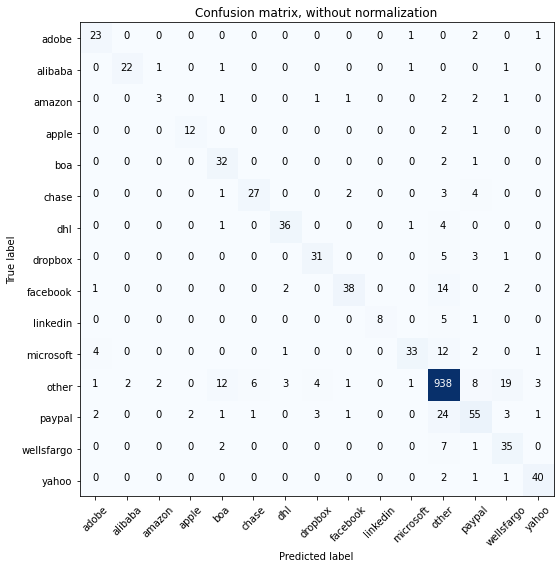

Acc     =  0.866
Pre     =  0.87
Rec     =  0.866
F1      =  0.864

Bal_Acc =  0.742
Bal_Pre =  0.793
Bal_Rec =  0.742
Bal_F1  =  0.767

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.50      0.27      0.35        11
       apple       0.86      0.80      0.83        15
         boa       0.63      0.91      0.74        35
       chase       0.79      0.73      0.76        37
         dhl       0.86      0.86      0.86        42
     dropbox       0.79      0.78      0.78        40
    facebook       0.88      0.67      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.92      0.94      0.93      1000
      paypal       0.68      0.59      0.63        93
  wellsfargo       0.56      0.78      0.65        45
       yahoo       0.87      0.91      0.89        4

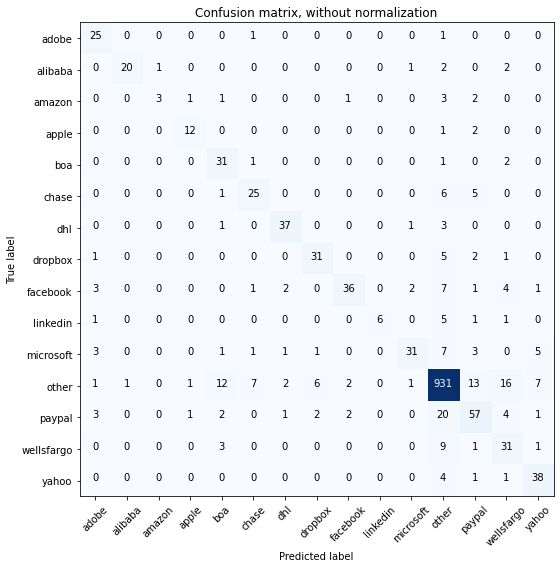

Acc     =  0.854
Pre     =  0.862
Rec     =  0.854
F1      =  0.853

Bal_Acc =  0.715
Bal_Pre =  0.776
Bal_Rec =  0.715
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.68      0.93      0.78        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.75      0.27      0.40        11
       apple       0.80      0.80      0.80        15
         boa       0.60      0.89      0.71        35
       chase       0.69      0.68      0.68        37
         dhl       0.86      0.88      0.87        42
     dropbox       0.78      0.78      0.78        40
    facebook       0.88      0.63      0.73        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.86      0.58      0.70        53
       other       0.93      0.93      0.93      1000
      paypal       0.65      0.61      0.63        93
  wellsfargo       0.50      0.69      0.58        45
       yahoo       0.72      0.86      0.78        

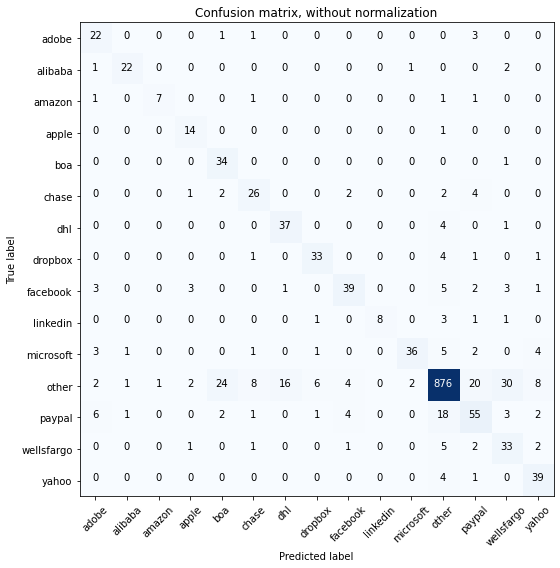

Acc     =  0.832
Pre     =  0.857
Rec     =  0.832
F1      =  0.839

Bal_Acc =  0.776
Bal_Pre =  0.736
Bal_Rec =  0.776
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.88      0.64      0.74        11
       apple       0.67      0.93      0.78        15
         boa       0.54      0.97      0.69        35
       chase       0.65      0.70      0.68        37
         dhl       0.69      0.88      0.77        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.78      0.68      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.92      0.68      0.78        53
       other       0.94      0.88      0.91      1000
      paypal       0.60      0.59      0.59        93
  wellsfargo       0.45      0.73      0.55        45
       yahoo       0.68      0.89      0.77        

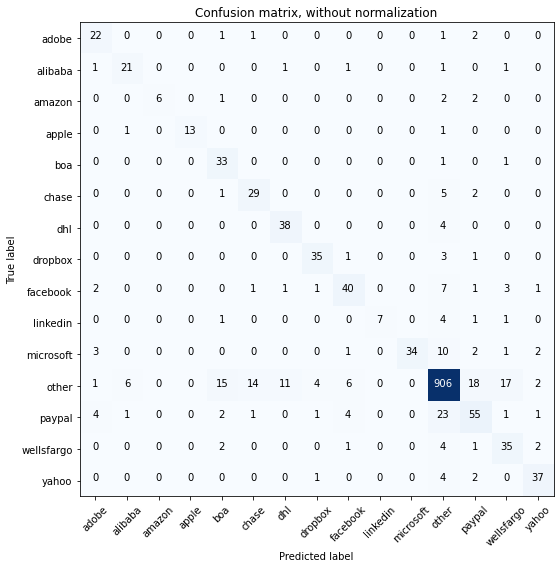

Acc     =  0.852
Pre     =  0.864
Rec     =  0.852
F1      =  0.853

Bal_Acc =  0.767
Bal_Pre =  0.793
Bal_Rec =  0.767
Bal_F1  =  0.78

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.72      0.81      0.76        26
      amazon       1.00      0.55      0.71        11
       apple       1.00      0.87      0.93        15
         boa       0.59      0.94      0.73        35
       chase       0.63      0.78      0.70        37
         dhl       0.75      0.90      0.82        42
     dropbox       0.83      0.88      0.85        40
    facebook       0.74      0.70      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       1.00      0.64      0.78        53
       other       0.93      0.91      0.92      1000
      paypal       0.63      0.59      0.61        93
  wellsfargo       0.58      0.78      0.67        45
       yahoo       0.82      0.84      0.83        4

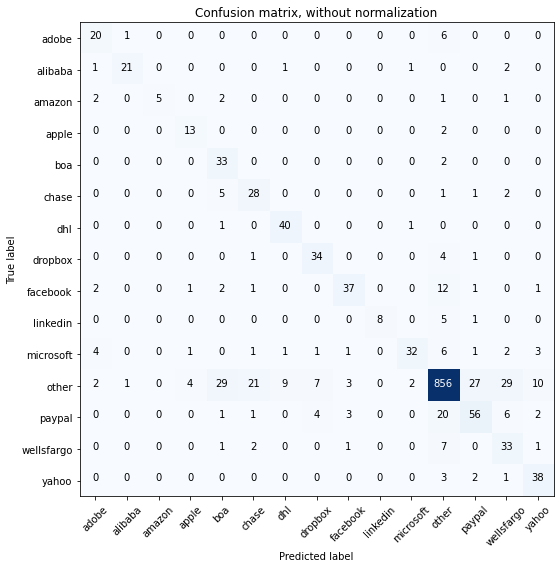

Acc     =  0.815
Pre     =  0.845
Rec     =  0.815
F1      =  0.822

Bal_Acc =  0.75
Bal_Pre =  0.74
Bal_Rec =  0.75
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        27
     alibaba       0.91      0.81      0.86        26
      amazon       1.00      0.45      0.62        11
       apple       0.68      0.87      0.76        15
         boa       0.45      0.94      0.61        35
       chase       0.51      0.76      0.61        37
         dhl       0.78      0.95      0.86        42
     dropbox       0.74      0.85      0.79        40
    facebook       0.82      0.65      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.60      0.72        53
       other       0.93      0.86      0.89      1000
      paypal       0.62      0.60      0.61        93
  wellsfargo       0.43      0.73      0.55        45
       yahoo       0.69      0.86      0.77        44


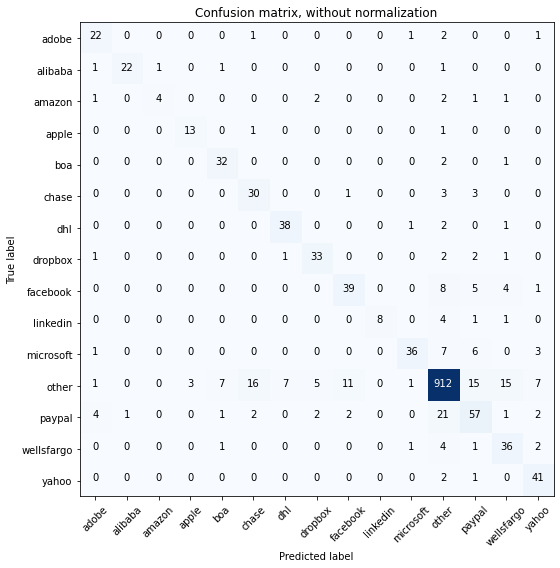

Acc     =  0.86
Pre     =  0.869
Rec     =  0.86
F1      =  0.861

Bal_Acc =  0.769
Bal_Pre =  0.784
Bal_Rec =  0.769
Bal_F1  =  0.776

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.80      0.36      0.50        11
       apple       0.81      0.87      0.84        15
         boa       0.76      0.91      0.83        35
       chase       0.60      0.81      0.69        37
         dhl       0.83      0.90      0.86        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.74      0.68      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.90      0.68      0.77        53
       other       0.94      0.91      0.92      1000
      paypal       0.62      0.61      0.62        93
  wellsfargo       0.59      0.80      0.68        45
       yahoo       0.72      0.93      0.81        44

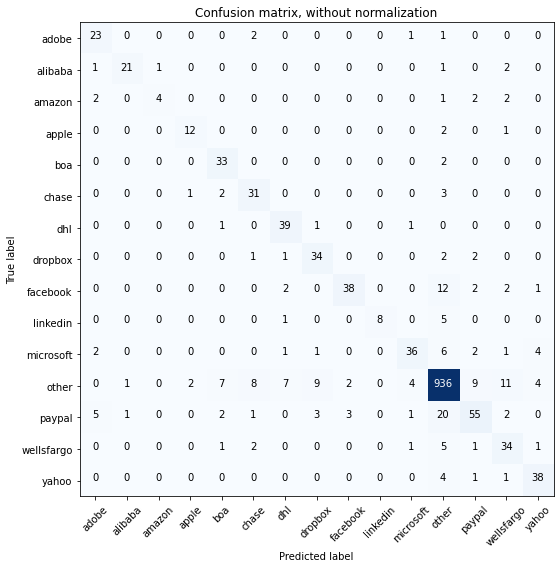

Acc     =  0.872
Pre     =  0.877
Rec     =  0.872
F1      =  0.871

Bal_Acc =  0.763
Bal_Pre =  0.791
Bal_Rec =  0.763
Bal_F1  =  0.777

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.80      0.80      0.80        15
         boa       0.72      0.94      0.81        35
       chase       0.69      0.84      0.76        37
         dhl       0.76      0.93      0.84        42
     dropbox       0.71      0.85      0.77        40
    facebook       0.88      0.67      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.68      0.74        53
       other       0.94      0.94      0.94      1000
      paypal       0.74      0.59      0.66        93
  wellsfargo       0.61      0.76      0.67        45
       yahoo       0.79      0.86      0.83        

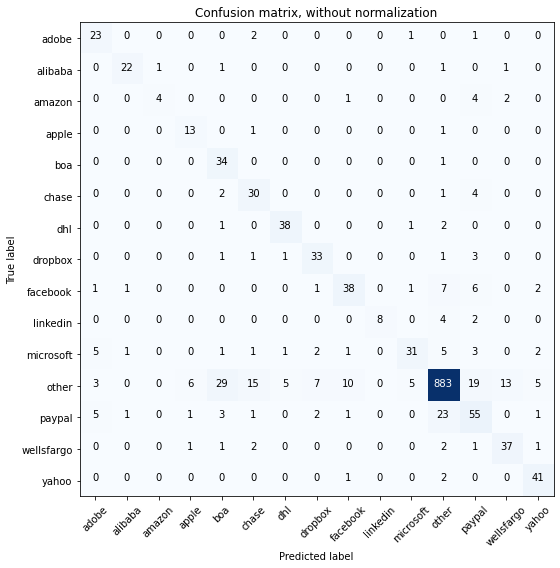

Acc     =  0.838
Pre     =  0.859
Rec     =  0.838
F1      =  0.843

Bal_Acc =  0.766
Bal_Pre =  0.737
Bal_Rec =  0.766
Bal_F1  =  0.751

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.62      0.87      0.72        15
         boa       0.47      0.97      0.63        35
       chase       0.57      0.81      0.67        37
         dhl       0.84      0.90      0.87        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.73      0.67      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.58      0.67        53
       other       0.95      0.88      0.91      1000
      paypal       0.56      0.59      0.58        93
  wellsfargo       0.70      0.82      0.76        45
       yahoo       0.79      0.93      0.85        

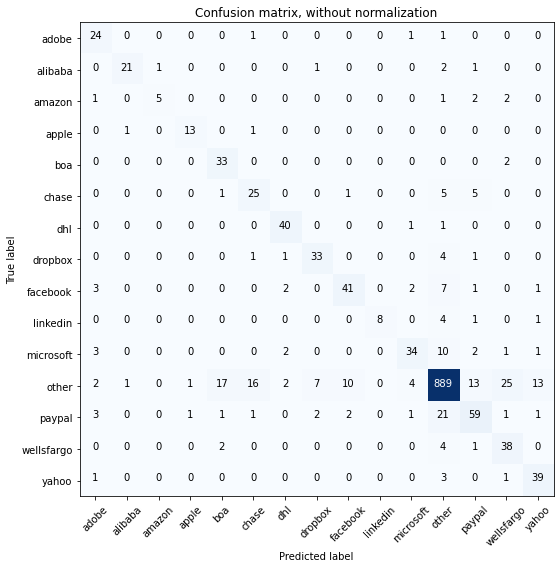

Acc     =  0.846
Pre     =  0.86
Rec     =  0.846
F1      =  0.849

Bal_Acc =  0.773
Bal_Pre =  0.764
Bal_Rec =  0.773
Bal_F1  =  0.768

              precision    recall  f1-score   support

       adobe       0.65      0.89      0.75        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.83      0.45      0.59        11
       apple       0.87      0.87      0.87        15
         boa       0.61      0.94      0.74        35
       chase       0.56      0.68      0.61        37
         dhl       0.85      0.95      0.90        42
     dropbox       0.77      0.82      0.80        40
    facebook       0.76      0.72      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.64      0.71        53
       other       0.93      0.89      0.91      1000
      paypal       0.69      0.63      0.66        93
  wellsfargo       0.54      0.84      0.66        45
       yahoo       0.70      0.89      0.78        4

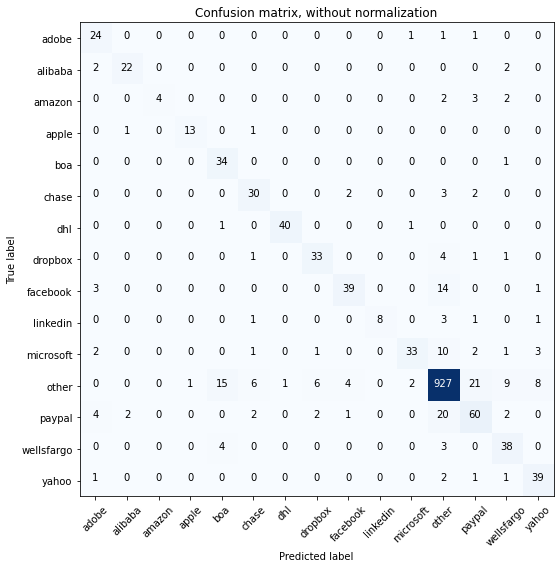

Acc     =  0.873
Pre     =  0.882
Rec     =  0.873
F1      =  0.873

Bal_Acc =  0.78
Bal_Pre =  0.822
Bal_Rec =  0.78
Bal_F1  =  0.8

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.88      0.85      0.86        26
      amazon       1.00      0.36      0.53        11
       apple       0.93      0.87      0.90        15
         boa       0.63      0.97      0.76        35
       chase       0.71      0.81      0.76        37
         dhl       0.98      0.95      0.96        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.85      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.94      0.93      0.93      1000
      paypal       0.65      0.65      0.65        93
  wellsfargo       0.67      0.84      0.75        45
       yahoo       0.75      0.89      0.81        44



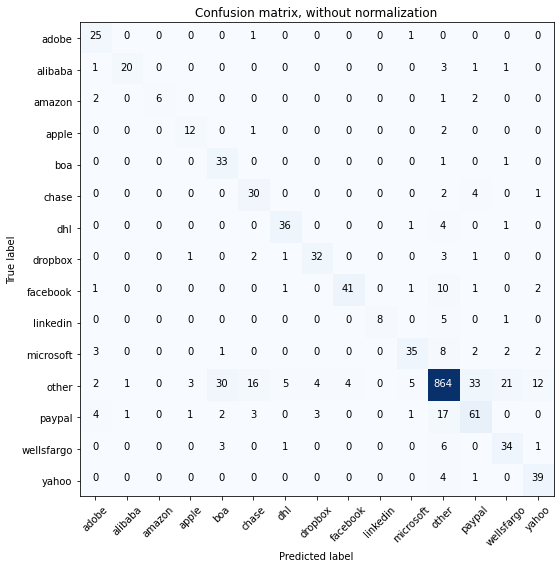

Acc     =  0.829
Pre     =  0.854
Rec     =  0.829
F1      =  0.835

Bal_Acc =  0.771
Bal_Pre =  0.761
Bal_Rec =  0.771
Bal_F1  =  0.766

              precision    recall  f1-score   support

       adobe       0.66      0.93      0.77        27
     alibaba       0.91      0.77      0.83        26
      amazon       1.00      0.55      0.71        11
       apple       0.71      0.80      0.75        15
         boa       0.48      0.94      0.63        35
       chase       0.57      0.81      0.67        37
         dhl       0.82      0.86      0.84        42
     dropbox       0.82      0.80      0.81        40
    facebook       0.91      0.72      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.66      0.72        53
       other       0.93      0.86      0.90      1000
      paypal       0.58      0.66      0.61        93
  wellsfargo       0.56      0.76      0.64        45
       yahoo       0.68      0.89      0.77        

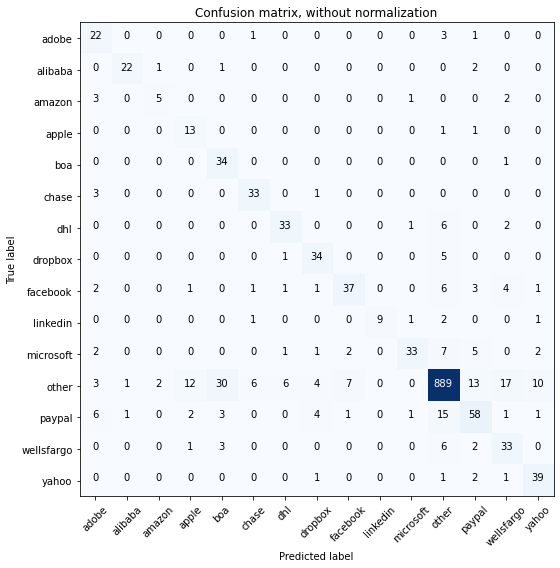

Acc     =  0.841
Pre     =  0.864
Rec     =  0.841
F1      =  0.846

Bal_Acc =  0.769
Bal_Pre =  0.725
Bal_Rec =  0.769
Bal_F1  =  0.746

              precision    recall  f1-score   support

       adobe       0.54      0.81      0.65        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.62      0.45      0.53        11
       apple       0.45      0.87      0.59        15
         boa       0.48      0.97      0.64        35
       chase       0.79      0.89      0.84        37
         dhl       0.79      0.79      0.79        42
     dropbox       0.74      0.85      0.79        40
    facebook       0.79      0.65      0.71        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.89      0.62      0.73        53
       other       0.94      0.89      0.92      1000
      paypal       0.67      0.62      0.64        93
  wellsfargo       0.54      0.73      0.62        45
       yahoo       0.72      0.89      0.80        

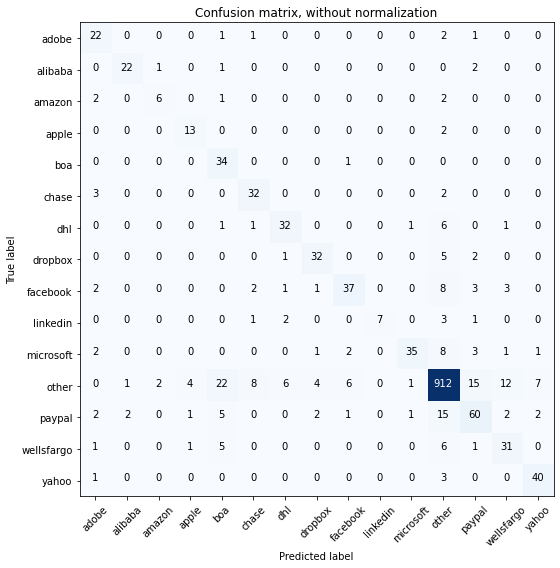

Acc     =  0.854
Pre     =  0.868
Rec     =  0.854
F1      =  0.857

Bal_Acc =  0.762
Bal_Pre =  0.758
Bal_Rec =  0.762
Bal_F1  =  0.76

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.67      0.55      0.60        11
       apple       0.68      0.87      0.76        15
         boa       0.49      0.97      0.65        35
       chase       0.71      0.86      0.78        37
         dhl       0.76      0.76      0.76        42
     dropbox       0.80      0.80      0.80        40
    facebook       0.79      0.65      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.92      0.66      0.77        53
       other       0.94      0.91      0.92      1000
      paypal       0.68      0.65      0.66        93
  wellsfargo       0.62      0.69      0.65        45
       yahoo       0.80      0.91      0.85        4

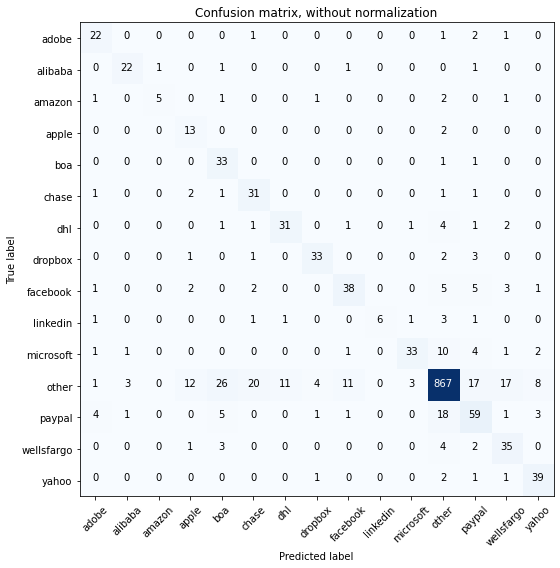

Acc     =  0.823
Pre     =  0.851
Rec     =  0.823
F1      =  0.83

Bal_Acc =  0.747
Bal_Pre =  0.716
Bal_Rec =  0.747
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.83      0.45      0.59        11
       apple       0.42      0.87      0.57        15
         boa       0.46      0.94      0.62        35
       chase       0.54      0.84      0.66        37
         dhl       0.72      0.74      0.73        42
     dropbox       0.82      0.82      0.82        40
    facebook       0.72      0.67      0.69        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.87      0.90      1000
      paypal       0.60      0.63      0.62        93
  wellsfargo       0.56      0.78      0.65        45
       yahoo       0.74      0.89      0.80        4

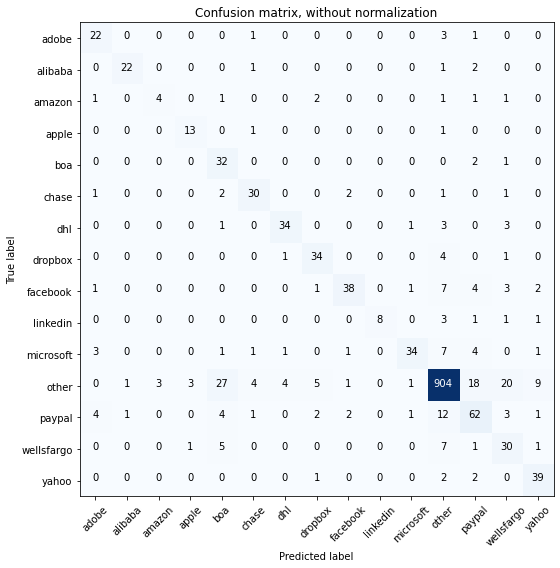

Acc     =  0.849
Pre     =  0.869
Rec     =  0.849
F1      =  0.854

Bal_Acc =  0.752
Bal_Pre =  0.752
Bal_Rec =  0.752
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.57      0.36      0.44        11
       apple       0.76      0.87      0.81        15
         boa       0.44      0.91      0.59        35
       chase       0.77      0.81      0.79        37
         dhl       0.85      0.81      0.83        42
     dropbox       0.76      0.85      0.80        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.64      0.75        53
       other       0.95      0.90      0.92      1000
      paypal       0.63      0.67      0.65        93
  wellsfargo       0.47      0.67      0.55        45
       yahoo       0.72      0.89      0.80        

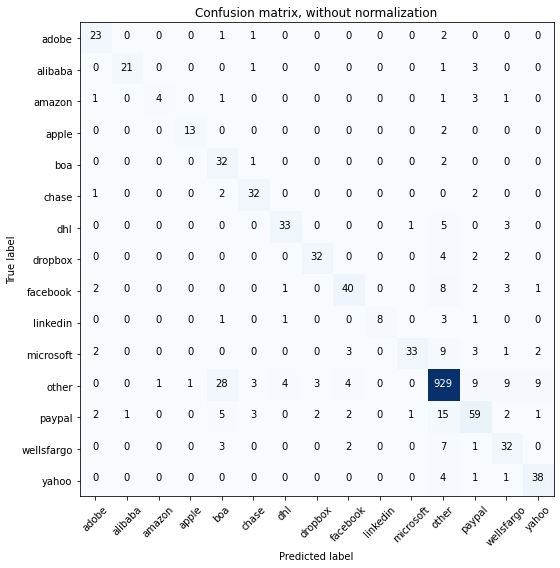

Acc     =  0.864
Pre     =  0.877
Rec     =  0.864
F1      =  0.866

Bal_Acc =  0.753
Bal_Pre =  0.803
Bal_Rec =  0.753
Bal_F1  =  0.777

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.80      0.36      0.50        11
       apple       0.93      0.87      0.90        15
         boa       0.44      0.91      0.59        35
       chase       0.78      0.86      0.82        37
         dhl       0.85      0.79      0.81        42
     dropbox       0.86      0.80      0.83        40
    facebook       0.78      0.70      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.94      0.62      0.75        53
       other       0.94      0.93      0.93      1000
      paypal       0.69      0.63      0.66        93
  wellsfargo       0.59      0.71      0.65        45
       yahoo       0.75      0.86      0.80        

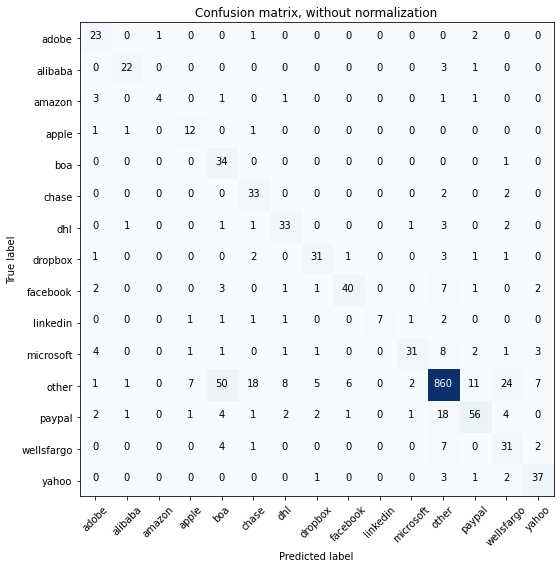

Acc     =  0.815
Pre     =  0.854
Rec     =  0.815
F1      =  0.825

Bal_Acc =  0.738
Bal_Pre =  0.715
Bal_Rec =  0.738
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.80      0.36      0.50        11
       apple       0.55      0.80      0.65        15
         boa       0.34      0.97      0.51        35
       chase       0.56      0.89      0.69        37
         dhl       0.70      0.79      0.74        42
     dropbox       0.76      0.78      0.77        40
    facebook       0.83      0.70      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.58      0.70        53
       other       0.94      0.86      0.90      1000
      paypal       0.74      0.60      0.66        93
  wellsfargo       0.46      0.69      0.55        45
       yahoo       0.73      0.84      0.78        

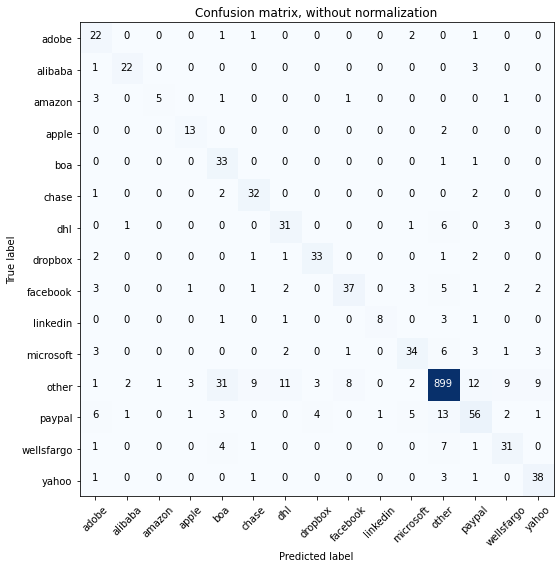

Acc     =  0.841
Pre     =  0.861
Rec     =  0.841
F1      =  0.846

Bal_Acc =  0.751
Bal_Pre =  0.725
Bal_Rec =  0.751
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.50      0.81      0.62        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.83      0.45      0.59        11
       apple       0.72      0.87      0.79        15
         boa       0.43      0.94      0.59        35
       chase       0.70      0.86      0.77        37
         dhl       0.65      0.74      0.69        42
     dropbox       0.82      0.82      0.82        40
    facebook       0.79      0.65      0.71        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.72      0.64      0.68        53
       other       0.95      0.90      0.92      1000
      paypal       0.67      0.60      0.63        93
  wellsfargo       0.63      0.69      0.66        45
       yahoo       0.72      0.86      0.78        

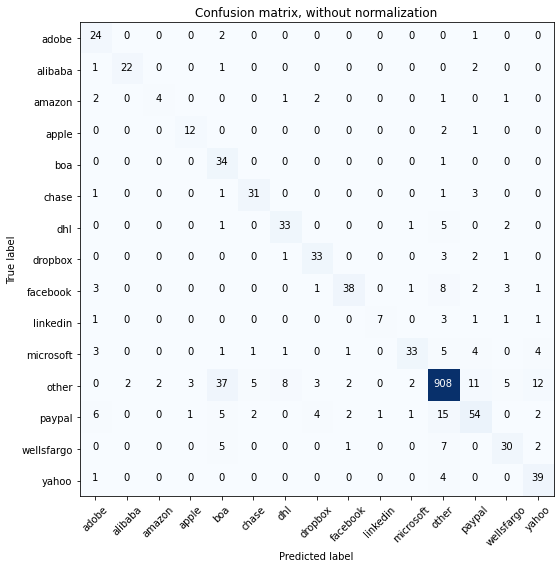

Acc     =  0.846
Pre     =  0.867
Rec     =  0.846
F1      =  0.85

Bal_Acc =  0.743
Bal_Pre =  0.744
Bal_Rec =  0.743
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.57      0.89      0.70        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.67      0.36      0.47        11
       apple       0.75      0.80      0.77        15
         boa       0.39      0.97      0.56        35
       chase       0.79      0.84      0.82        37
         dhl       0.75      0.79      0.77        42
     dropbox       0.77      0.82      0.80        40
    facebook       0.86      0.67      0.75        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.91      0.93      1000
      paypal       0.67      0.58      0.62        93
  wellsfargo       0.70      0.67      0.68        45
       yahoo       0.64      0.89      0.74        4

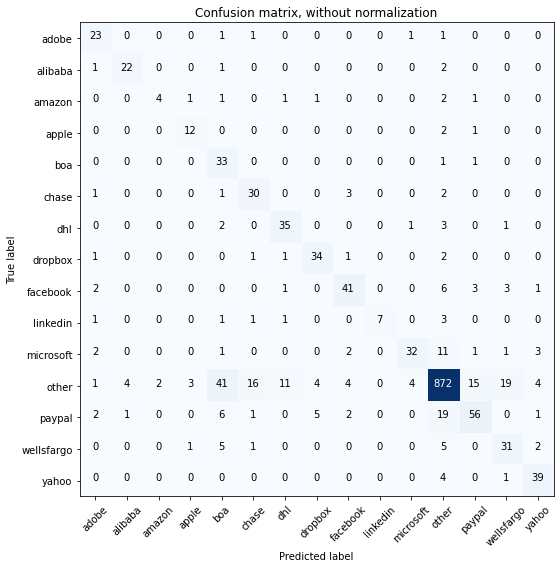

Acc     =  0.826
Pre     =  0.853
Rec     =  0.826
F1      =  0.833

Bal_Acc =  0.745
Bal_Pre =  0.725
Bal_Rec =  0.745
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.67      0.36      0.47        11
       apple       0.71      0.80      0.75        15
         boa       0.35      0.94      0.52        35
       chase       0.59      0.81      0.68        37
         dhl       0.70      0.83      0.76        42
     dropbox       0.77      0.85      0.81        40
    facebook       0.77      0.72      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.60      0.70        53
       other       0.93      0.87      0.90      1000
      paypal       0.72      0.60      0.65        93
  wellsfargo       0.55      0.69      0.61        45
       yahoo       0.78      0.89      0.83        

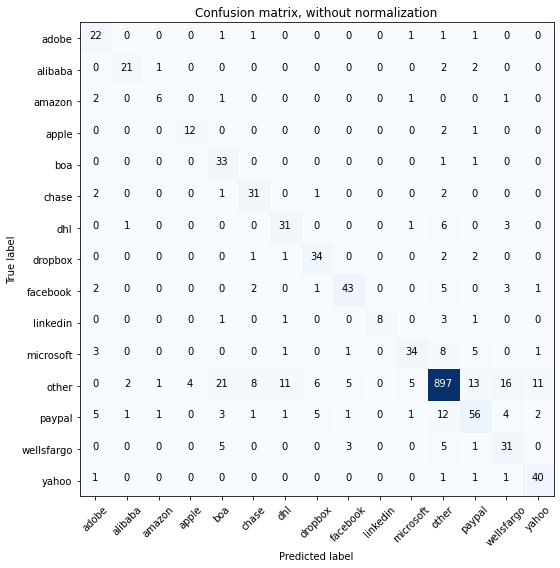

Acc     =  0.844
Pre     =  0.86
Rec     =  0.844
F1      =  0.848

Bal_Acc =  0.76
Bal_Pre =  0.728
Bal_Rec =  0.76
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.67      0.55      0.60        11
       apple       0.75      0.80      0.77        15
         boa       0.50      0.94      0.65        35
       chase       0.70      0.84      0.77        37
         dhl       0.67      0.74      0.70        42
     dropbox       0.72      0.85      0.78        40
    facebook       0.81      0.75      0.78        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.64      0.71        53
       other       0.95      0.90      0.92      1000
      paypal       0.67      0.60      0.63        93
  wellsfargo       0.53      0.69      0.60        45
       yahoo       0.73      0.91      0.81        44


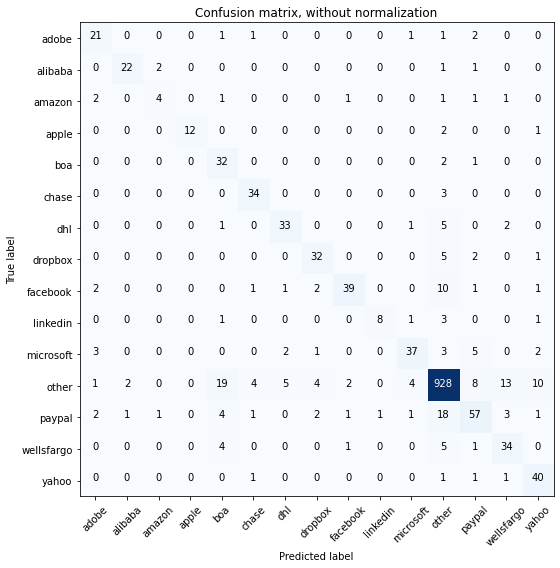

Acc     =  0.866
Pre     =  0.875
Rec     =  0.866
F1      =  0.867

Bal_Acc =  0.758
Bal_Pre =  0.774
Bal_Rec =  0.758
Bal_F1  =  0.766

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.57      0.36      0.44        11
       apple       1.00      0.80      0.89        15
         boa       0.51      0.91      0.65        35
       chase       0.81      0.92      0.86        37
         dhl       0.80      0.79      0.80        42
     dropbox       0.78      0.80      0.79        40
    facebook       0.89      0.68      0.77        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.82      0.70      0.76        53
       other       0.94      0.93      0.93      1000
      paypal       0.71      0.61      0.66        93
  wellsfargo       0.63      0.76      0.69        45
       yahoo       0.70      0.91      0.79        

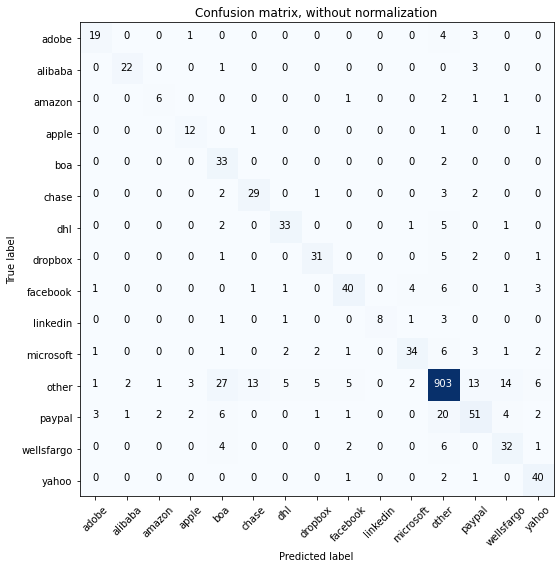

Acc     =  0.84
Pre     =  0.855
Rec     =  0.84
F1      =  0.843

Bal_Acc =  0.745
Bal_Pre =  0.74
Bal_Rec =  0.745
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.76      0.70      0.73        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.67      0.55      0.60        11
       apple       0.67      0.80      0.73        15
         boa       0.42      0.94      0.58        35
       chase       0.66      0.78      0.72        37
         dhl       0.79      0.79      0.79        42
     dropbox       0.78      0.78      0.78        40
    facebook       0.78      0.70      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.64      0.72        53
       other       0.93      0.90      0.92      1000
      paypal       0.65      0.55      0.59        93
  wellsfargo       0.59      0.71      0.65        45
       yahoo       0.71      0.91      0.80        44


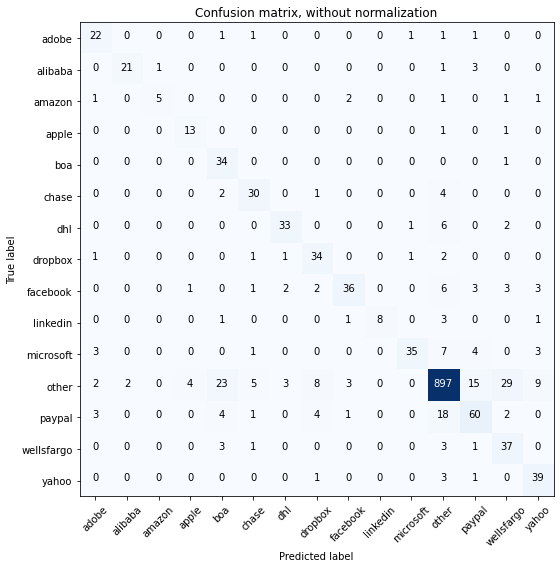

Acc     =  0.847
Pre     =  0.869
Rec     =  0.847
F1      =  0.852

Bal_Acc =  0.765
Bal_Pre =  0.765
Bal_Rec =  0.765
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.83      0.45      0.59        11
       apple       0.72      0.87      0.79        15
         boa       0.50      0.97      0.66        35
       chase       0.73      0.81      0.77        37
         dhl       0.85      0.79      0.81        42
     dropbox       0.68      0.85      0.76        40
    facebook       0.84      0.63      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.92      0.66      0.77        53
       other       0.94      0.90      0.92      1000
      paypal       0.68      0.65      0.66        93
  wellsfargo       0.49      0.82      0.61        45
       yahoo       0.70      0.89      0.78        

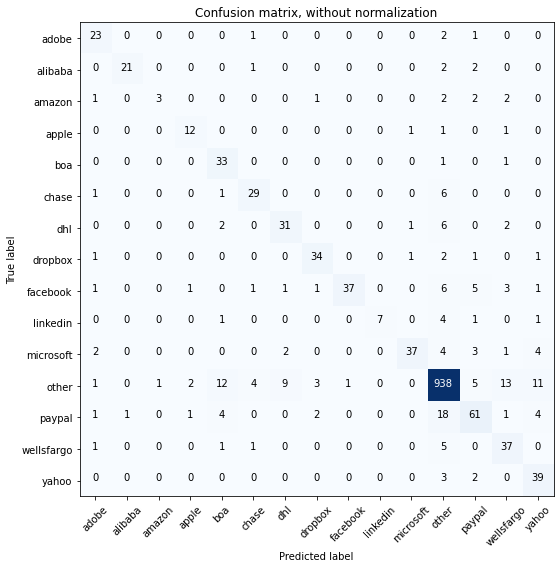

Acc     =  0.872
Pre     =  0.882
Rec     =  0.872
F1      =  0.872

Bal_Acc =  0.746
Bal_Pre =  0.796
Bal_Rec =  0.746
Bal_F1  =  0.77

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.75      0.27      0.40        11
       apple       0.75      0.80      0.77        15
         boa       0.61      0.94      0.74        35
       chase       0.78      0.78      0.78        37
         dhl       0.72      0.74      0.73        42
     dropbox       0.83      0.85      0.84        40
    facebook       0.97      0.65      0.78        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.93      0.70      0.80        53
       other       0.94      0.94      0.94      1000
      paypal       0.73      0.66      0.69        93
  wellsfargo       0.61      0.82      0.70        45
       yahoo       0.64      0.89      0.74        4

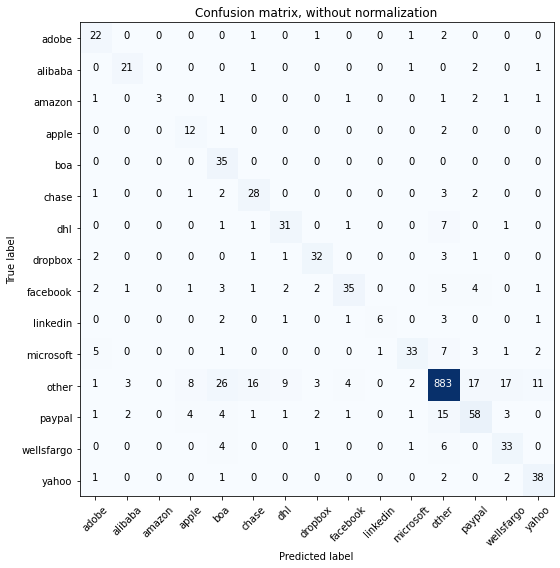

Acc     =  0.825
Pre     =  0.852
Rec     =  0.825
F1      =  0.83

Bal_Acc =  0.717
Bal_Pre =  0.712
Bal_Rec =  0.717
Bal_F1  =  0.714

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.78      0.81      0.79        26
      amazon       1.00      0.27      0.43        11
       apple       0.46      0.80      0.59        15
         boa       0.43      1.00      0.60        35
       chase       0.56      0.76      0.64        37
         dhl       0.69      0.74      0.71        42
     dropbox       0.78      0.80      0.79        40
    facebook       0.81      0.61      0.70        57
    linkedin       0.86      0.43      0.57        14
   microsoft       0.85      0.62      0.72        53
       other       0.94      0.88      0.91      1000
      paypal       0.65      0.62      0.64        93
  wellsfargo       0.57      0.73      0.64        45
       yahoo       0.69      0.86      0.77        4

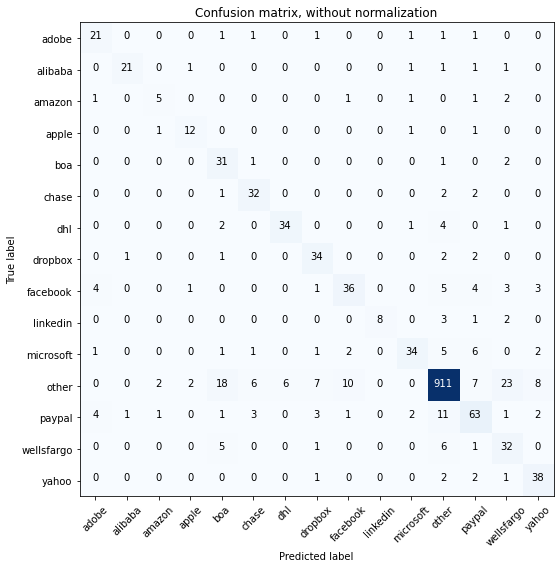

Acc     =  0.853
Pre     =  0.869
Rec     =  0.853
F1      =  0.857

Bal_Acc =  0.751
Bal_Pre =  0.737
Bal_Rec =  0.751
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.56      0.45      0.50        11
       apple       0.75      0.80      0.77        15
         boa       0.51      0.89      0.65        35
       chase       0.73      0.86      0.79        37
         dhl       0.85      0.81      0.83        42
     dropbox       0.69      0.85      0.76        40
    facebook       0.72      0.63      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.83      0.64      0.72        53
       other       0.95      0.91      0.93      1000
      paypal       0.68      0.68      0.68        93
  wellsfargo       0.47      0.71      0.57        45
       yahoo       0.72      0.86      0.78        

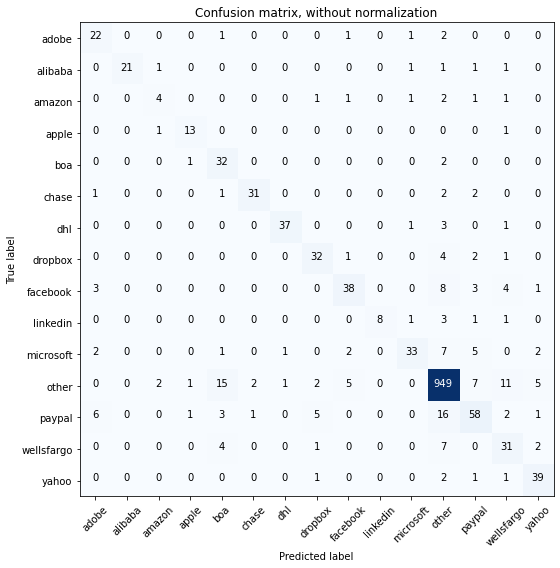

Acc     =  0.876
Pre     =  0.882
Rec     =  0.876
F1      =  0.876

Bal_Acc =  0.753
Bal_Pre =  0.787
Bal_Rec =  0.753
Bal_F1  =  0.77

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       1.00      0.81      0.89        26
      amazon       0.50      0.36      0.42        11
       apple       0.81      0.87      0.84        15
         boa       0.56      0.91      0.70        35
       chase       0.91      0.84      0.87        37
         dhl       0.95      0.88      0.91        42
     dropbox       0.76      0.80      0.78        40
    facebook       0.79      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.95      0.95      1000
      paypal       0.72      0.62      0.67        93
  wellsfargo       0.56      0.69      0.62        45
       yahoo       0.78      0.89      0.83        4

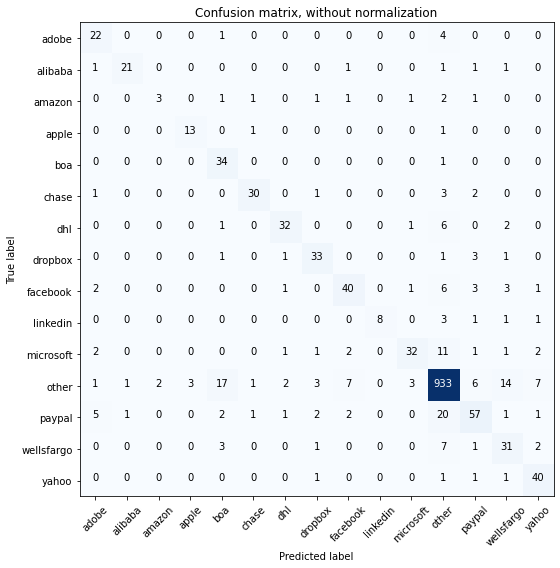

Acc     =  0.864
Pre     =  0.87
Rec     =  0.864
F1      =  0.863

Bal_Acc =  0.743
Bal_Pre =  0.773
Bal_Rec =  0.743
Bal_F1  =  0.758

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.60      0.27      0.37        11
       apple       0.81      0.87      0.84        15
         boa       0.57      0.97      0.72        35
       chase       0.88      0.81      0.85        37
         dhl       0.84      0.76      0.80        42
     dropbox       0.77      0.82      0.80        40
    facebook       0.75      0.70      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.60      0.70        53
       other       0.93      0.93      0.93      1000
      paypal       0.74      0.61      0.67        93
  wellsfargo       0.55      0.69      0.61        45
       yahoo       0.74      0.91      0.82        4

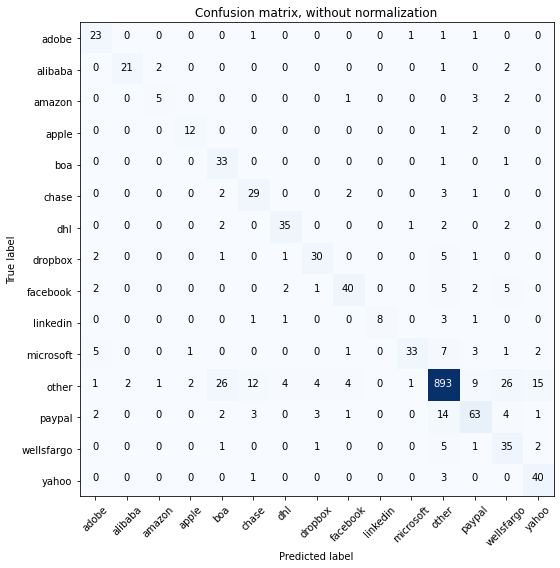

Acc     =  0.845
Pre     =  0.869
Rec     =  0.845
F1      =  0.851

Bal_Acc =  0.758
Bal_Pre =  0.747
Bal_Rec =  0.758
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.62      0.45      0.53        11
       apple       0.80      0.80      0.80        15
         boa       0.49      0.94      0.65        35
       chase       0.62      0.78      0.69        37
         dhl       0.81      0.83      0.82        42
     dropbox       0.77      0.75      0.76        40
    facebook       0.82      0.70      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.92      0.62      0.74        53
       other       0.95      0.89      0.92      1000
      paypal       0.72      0.68      0.70        93
  wellsfargo       0.45      0.78      0.57        45
       yahoo       0.67      0.91      0.77        

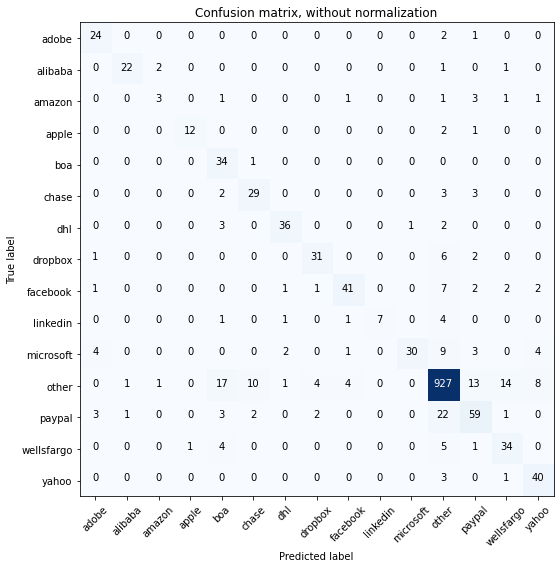

Acc     =  0.864
Pre     =  0.874
Rec     =  0.864
F1      =  0.864

Bal_Acc =  0.747
Bal_Pre =  0.784
Bal_Rec =  0.747
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.73      0.89      0.80        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.50      0.27      0.35        11
       apple       0.92      0.80      0.86        15
         boa       0.52      0.97      0.68        35
       chase       0.69      0.78      0.73        37
         dhl       0.88      0.86      0.87        42
     dropbox       0.82      0.78      0.79        40
    facebook       0.85      0.72      0.78        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.97      0.57      0.71        53
       other       0.93      0.93      0.93      1000
      paypal       0.67      0.63      0.65        93
  wellsfargo       0.63      0.76      0.69        45
       yahoo       0.73      0.91      0.81        

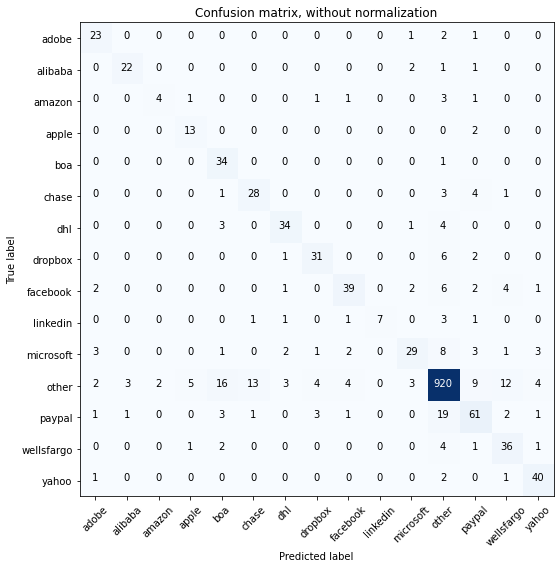

Acc     =  0.858
Pre     =  0.866
Rec     =  0.858
F1      =  0.858

Bal_Acc =  0.75
Bal_Pre =  0.755
Bal_Rec =  0.75
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.67      0.36      0.47        11
       apple       0.65      0.87      0.74        15
         boa       0.57      0.97      0.72        35
       chase       0.65      0.76      0.70        37
         dhl       0.81      0.81      0.81        42
     dropbox       0.78      0.78      0.78        40
    facebook       0.81      0.68      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.76      0.55      0.64        53
       other       0.94      0.92      0.93      1000
      paypal       0.69      0.66      0.67        93
  wellsfargo       0.63      0.80      0.71        45
       yahoo       0.80      0.91      0.85        44

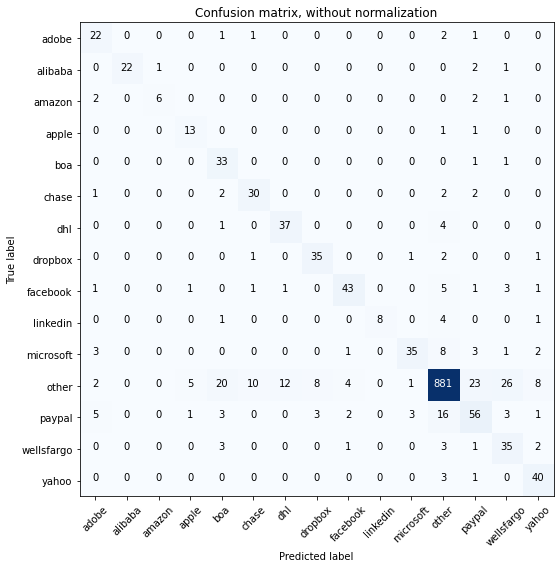

Acc     =  0.842
Pre     =  0.865
Rec     =  0.842
F1      =  0.848

Bal_Acc =  0.783
Bal_Pre =  0.753
Bal_Rec =  0.783
Bal_F1  =  0.768

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.86      0.55      0.67        11
       apple       0.65      0.87      0.74        15
         boa       0.52      0.94      0.67        35
       chase       0.70      0.81      0.75        37
         dhl       0.74      0.88      0.80        42
     dropbox       0.76      0.88      0.81        40
    facebook       0.84      0.75      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.88      0.66      0.75        53
       other       0.95      0.88      0.91      1000
      paypal       0.60      0.60      0.60        93
  wellsfargo       0.49      0.78      0.60        45
       yahoo       0.71      0.91      0.80        

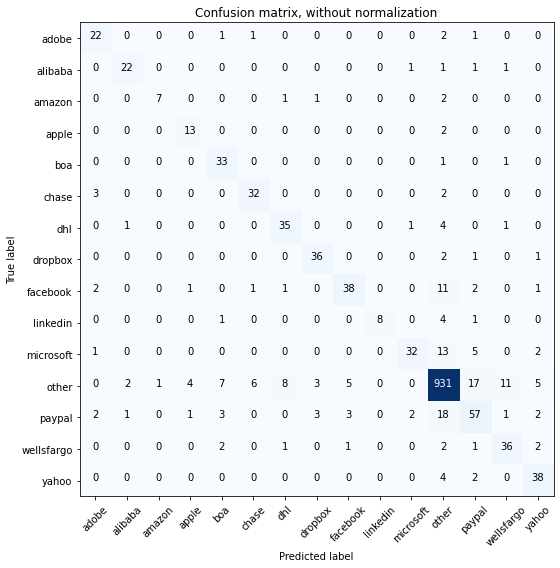

Acc     =  0.871
Pre     =  0.874
Rec     =  0.871
F1      =  0.87

Bal_Acc =  0.784
Bal_Pre =  0.798
Bal_Rec =  0.784
Bal_F1  =  0.791

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.88      0.64      0.74        11
       apple       0.68      0.87      0.76        15
         boa       0.70      0.94      0.80        35
       chase       0.80      0.86      0.83        37
         dhl       0.76      0.83      0.80        42
     dropbox       0.84      0.90      0.87        40
    facebook       0.81      0.67      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.60      0.72        53
       other       0.93      0.93      0.93      1000
      paypal       0.65      0.61      0.63        93
  wellsfargo       0.71      0.80      0.75        45
       yahoo       0.75      0.86      0.80        4

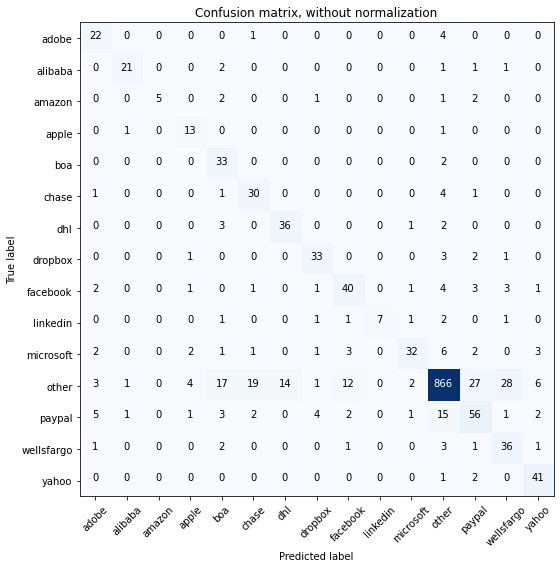

Acc     =  0.826
Pre     =  0.853
Rec     =  0.826
F1      =  0.832

Bal_Acc =  0.759
Bal_Pre =  0.73
Bal_Rec =  0.759
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.88      0.81      0.84        26
      amazon       1.00      0.45      0.62        11
       apple       0.59      0.87      0.70        15
         boa       0.51      0.94      0.66        35
       chase       0.56      0.81      0.66        37
         dhl       0.72      0.86      0.78        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.68      0.70      0.69        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.60      0.70        53
       other       0.95      0.87      0.90      1000
      paypal       0.58      0.60      0.59        93
  wellsfargo       0.51      0.80      0.62        45
       yahoo       0.76      0.93      0.84        4

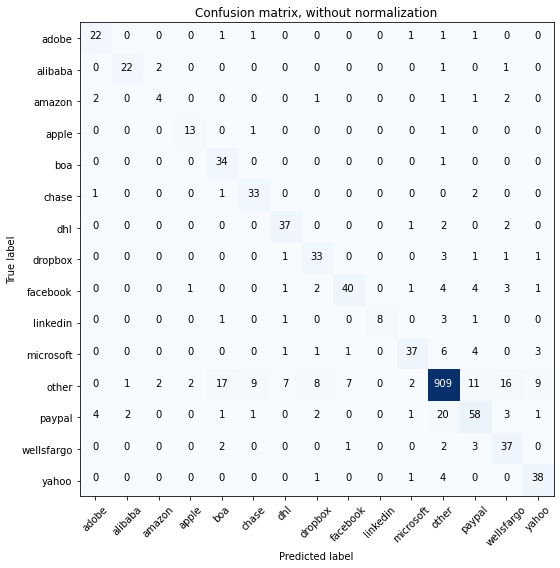

Acc     =  0.861
Pre     =  0.872
Rec     =  0.861
F1      =  0.863

Bal_Acc =  0.777
Bal_Pre =  0.754
Bal_Rec =  0.777
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.50      0.36      0.42        11
       apple       0.81      0.87      0.84        15
         boa       0.60      0.97      0.74        35
       chase       0.73      0.89      0.80        37
         dhl       0.77      0.88      0.82        42
     dropbox       0.69      0.82      0.75        40
    facebook       0.82      0.70      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.70      0.76        53
       other       0.95      0.91      0.93      1000
      paypal       0.67      0.62      0.65        93
  wellsfargo       0.57      0.82      0.67        45
       yahoo       0.72      0.86      0.78        

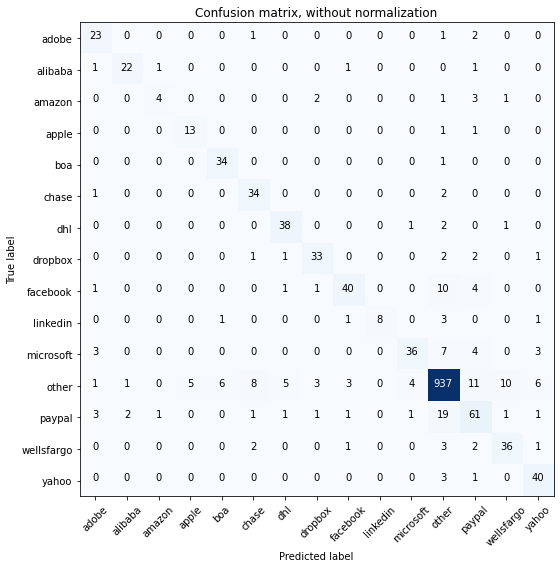

Acc     =  0.883
Pre     =  0.886
Rec     =  0.883
F1      =  0.882

Bal_Acc =  0.787
Bal_Pre =  0.798
Bal_Rec =  0.787
Bal_F1  =  0.792

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.67      0.36      0.47        11
       apple       0.72      0.87      0.79        15
         boa       0.83      0.97      0.89        35
       chase       0.72      0.92      0.81        37
         dhl       0.83      0.90      0.86        42
     dropbox       0.82      0.82      0.82        40
    facebook       0.85      0.70      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.68      0.76        53
       other       0.94      0.94      0.94      1000
      paypal       0.66      0.66      0.66        93
  wellsfargo       0.73      0.80      0.77        45
       yahoo       0.75      0.91      0.82        

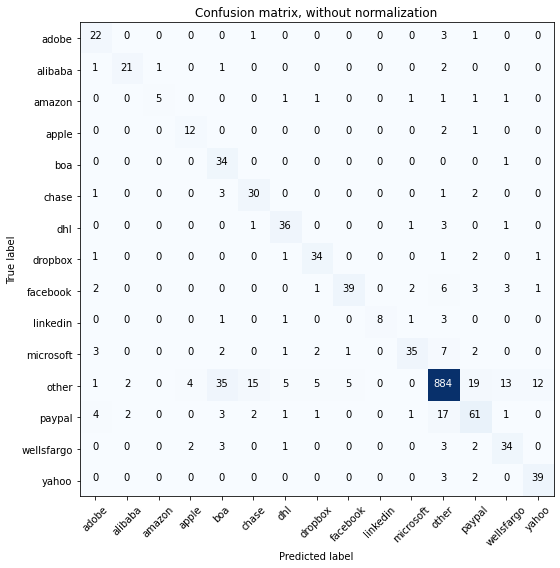

Acc     =  0.841
Pre     =  0.865
Rec     =  0.841
F1      =  0.847

Bal_Acc =  0.764
Bal_Pre =  0.747
Bal_Rec =  0.764
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.83      0.45      0.59        11
       apple       0.67      0.80      0.73        15
         boa       0.41      0.97      0.58        35
       chase       0.61      0.81      0.70        37
         dhl       0.77      0.86      0.81        42
     dropbox       0.77      0.85      0.81        40
    facebook       0.87      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.66      0.74        53
       other       0.94      0.88      0.91      1000
      paypal       0.64      0.66      0.65        93
  wellsfargo       0.63      0.76      0.69        45
       yahoo       0.74      0.89      0.80        

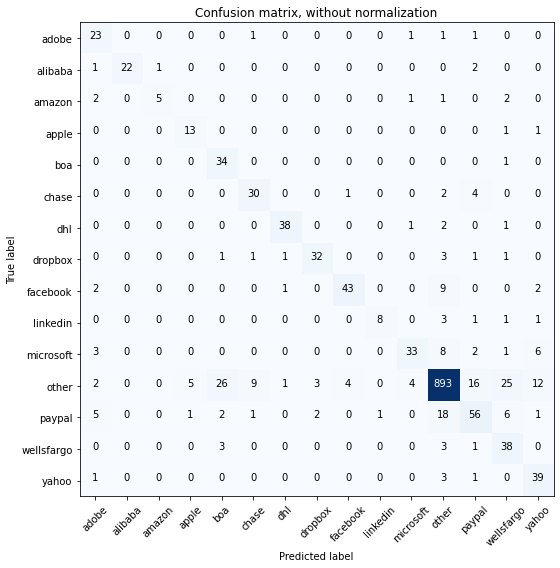

Acc     =  0.849
Pre     =  0.872
Rec     =  0.849
F1      =  0.854

Bal_Acc =  0.779
Bal_Pre =  0.764
Bal_Rec =  0.779
Bal_F1  =  0.771

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.83      0.45      0.59        11
       apple       0.68      0.87      0.76        15
         boa       0.52      0.97      0.67        35
       chase       0.71      0.81      0.76        37
         dhl       0.93      0.90      0.92        42
     dropbox       0.86      0.80      0.83        40
    facebook       0.90      0.75      0.82        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.89      0.92      1000
      paypal       0.66      0.60      0.63        93
  wellsfargo       0.49      0.84      0.62        45
       yahoo       0.63      0.89      0.74        

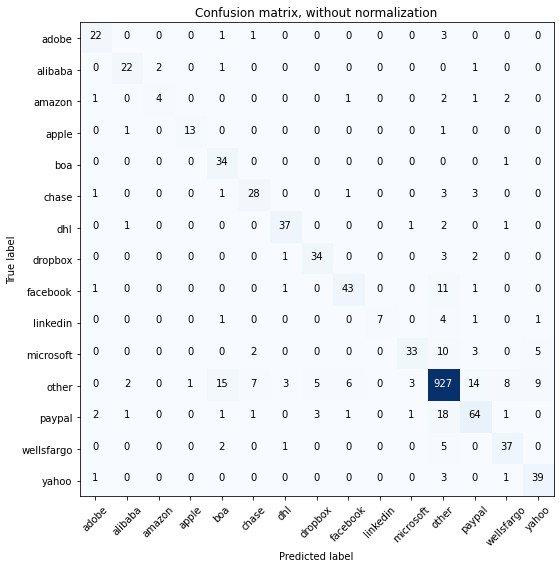

Acc     =  0.873
Pre     =  0.879
Rec     =  0.873
F1      =  0.873

Bal_Acc =  0.77
Bal_Pre =  0.799
Bal_Rec =  0.77
Bal_F1  =  0.784

              precision    recall  f1-score   support

       adobe       0.79      0.81      0.80        27
     alibaba       0.81      0.85      0.83        26
      amazon       0.67      0.36      0.47        11
       apple       0.93      0.87      0.90        15
         boa       0.61      0.97      0.75        35
       chase       0.72      0.76      0.74        37
         dhl       0.86      0.88      0.87        42
     dropbox       0.81      0.85      0.83        40
    facebook       0.83      0.75      0.79        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.62      0.73        53
       other       0.93      0.93      0.93      1000
      paypal       0.71      0.69      0.70        93
  wellsfargo       0.73      0.82      0.77        45
       yahoo       0.72      0.89      0.80        44

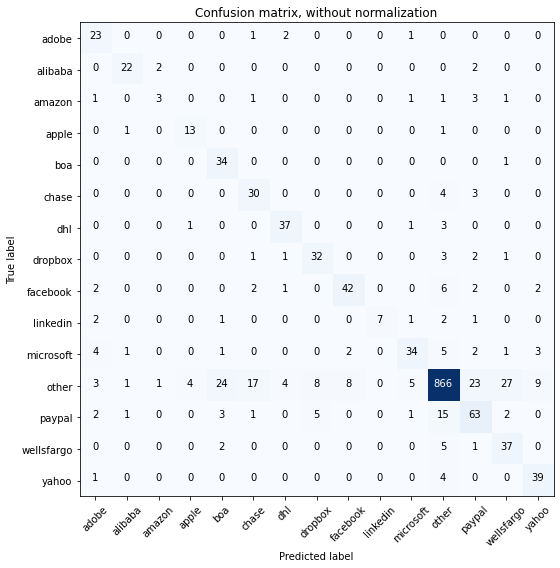

Acc     =  0.833
Pre     =  0.856
Rec     =  0.833
F1      =  0.838

Bal_Acc =  0.762
Bal_Pre =  0.714
Bal_Rec =  0.762
Bal_F1  =  0.737

              precision    recall  f1-score   support

       adobe       0.61      0.85      0.71        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.50      0.27      0.35        11
       apple       0.72      0.87      0.79        15
         boa       0.52      0.97      0.68        35
       chase       0.57      0.81      0.67        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.81      0.74      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.77      0.64      0.70        53
       other       0.95      0.87      0.90      1000
      paypal       0.62      0.68      0.65        93
  wellsfargo       0.53      0.82      0.64        45
       yahoo       0.74      0.89      0.80        

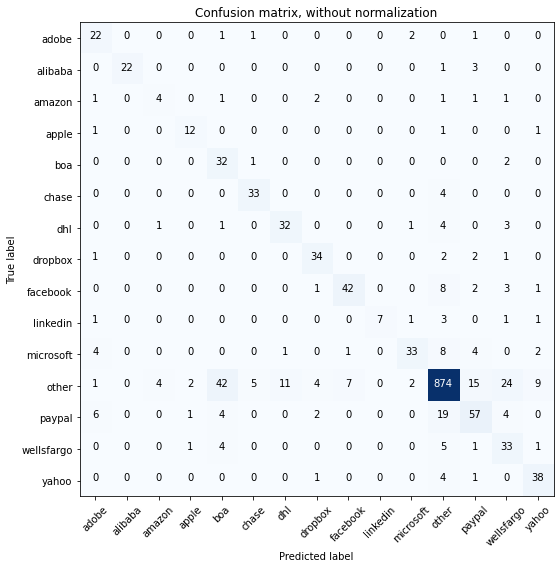

Acc     =  0.828
Pre     =  0.857
Rec     =  0.828
F1      =  0.836

Bal_Acc =  0.746
Bal_Pre =  0.73
Bal_Rec =  0.746
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.44      0.36      0.40        11
       apple       0.75      0.80      0.77        15
         boa       0.38      0.91      0.53        35
       chase       0.82      0.89      0.86        37
         dhl       0.73      0.76      0.74        42
     dropbox       0.77      0.85      0.81        40
    facebook       0.84      0.74      0.79        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.85      0.62      0.72        53
       other       0.94      0.87      0.90      1000
      paypal       0.66      0.61      0.63        93
  wellsfargo       0.46      0.73      0.56        45
       yahoo       0.72      0.86      0.78        4

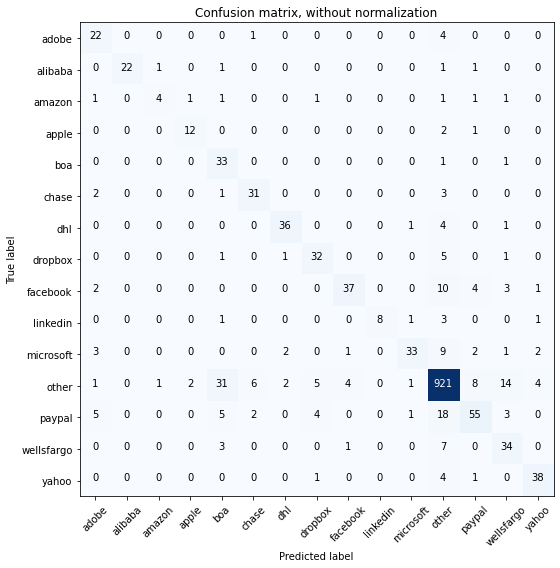

Acc     =  0.856
Pre     =  0.872
Rec     =  0.856
F1      =  0.858

Bal_Acc =  0.749
Bal_Pre =  0.783
Bal_Rec =  0.749
Bal_F1  =  0.766

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.67      0.36      0.47        11
       apple       0.80      0.80      0.80        15
         boa       0.43      0.94      0.59        35
       chase       0.78      0.84      0.81        37
         dhl       0.88      0.86      0.87        42
     dropbox       0.74      0.80      0.77        40
    facebook       0.86      0.65      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.93      0.92      0.92      1000
      paypal       0.75      0.59      0.66        93
  wellsfargo       0.58      0.76      0.65        45
       yahoo       0.83      0.86      0.84        

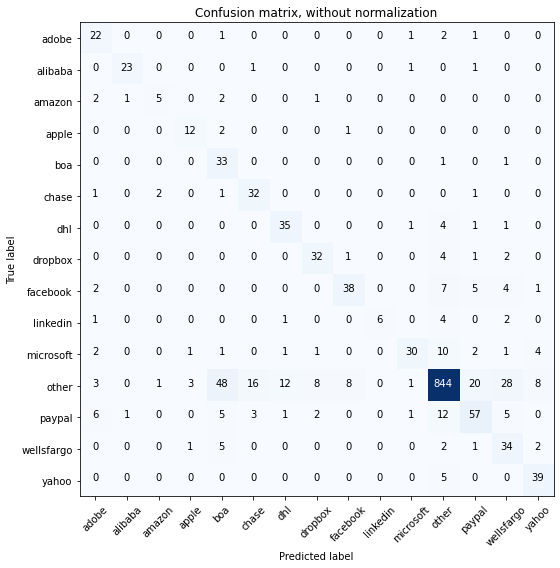

Acc     =  0.807
Pre     =  0.85
Rec     =  0.807
F1      =  0.818

Bal_Acc =  0.744
Bal_Pre =  0.705
Bal_Rec =  0.744
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.56      0.81      0.67        27
     alibaba       0.92      0.88      0.90        26
      amazon       0.62      0.45      0.53        11
       apple       0.71      0.80      0.75        15
         boa       0.34      0.94      0.50        35
       chase       0.62      0.86      0.72        37
         dhl       0.70      0.83      0.76        42
     dropbox       0.73      0.80      0.76        40
    facebook       0.79      0.67      0.72        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.86      0.57      0.68        53
       other       0.94      0.84      0.89      1000
      paypal       0.63      0.61      0.62        93
  wellsfargo       0.44      0.76      0.55        45
       yahoo       0.72      0.89      0.80        4

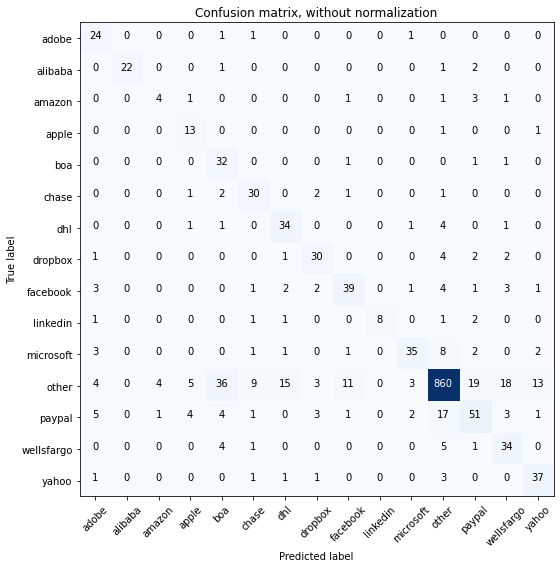

Acc     =  0.814
Pre     =  0.845
Rec     =  0.814
F1      =  0.822

Bal_Acc =  0.745
Bal_Pre =  0.681
Bal_Rec =  0.745
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.57      0.89      0.70        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.44      0.36      0.40        11
       apple       0.52      0.87      0.65        15
         boa       0.40      0.91      0.55        35
       chase       0.65      0.81      0.72        37
         dhl       0.62      0.81      0.70        42
     dropbox       0.73      0.75      0.74        40
    facebook       0.71      0.68      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.66      0.73        53
       other       0.95      0.86      0.90      1000
      paypal       0.61      0.55      0.58        93
  wellsfargo       0.54      0.76      0.63        45
       yahoo       0.67      0.84      0.75        

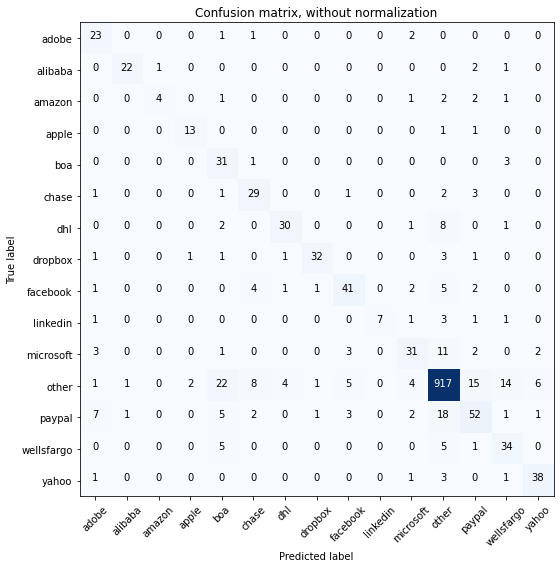

Acc     =  0.847
Pre     =  0.861
Rec     =  0.847
F1      =  0.85

Bal_Acc =  0.734
Bal_Pre =  0.76
Bal_Rec =  0.734
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.80      0.36      0.50        11
       apple       0.81      0.87      0.84        15
         boa       0.44      0.89      0.59        35
       chase       0.64      0.78      0.71        37
         dhl       0.83      0.71      0.77        42
     dropbox       0.91      0.80      0.85        40
    facebook       0.77      0.72      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.69      0.58      0.63        53
       other       0.94      0.92      0.93      1000
      paypal       0.63      0.56      0.59        93
  wellsfargo       0.60      0.76      0.67        45
       yahoo       0.81      0.86      0.84        44

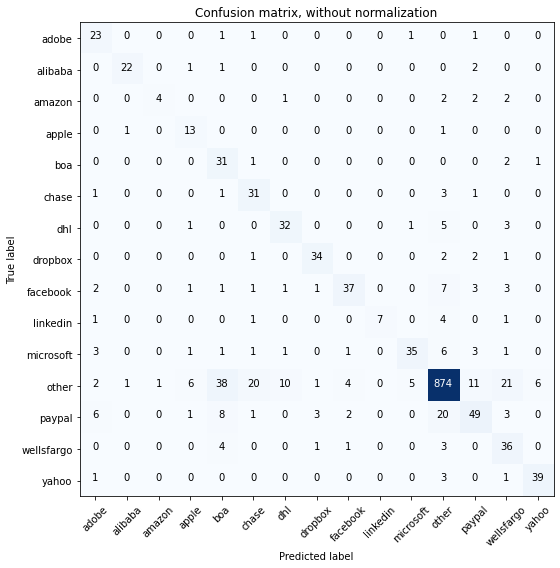

Acc     =  0.823
Pre     =  0.857
Rec     =  0.823
F1      =  0.831

Bal_Acc =  0.744
Bal_Pre =  0.726
Bal_Rec =  0.744
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.59      0.85      0.70        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.80      0.36      0.50        11
       apple       0.54      0.87      0.67        15
         boa       0.36      0.89      0.51        35
       chase       0.53      0.84      0.65        37
         dhl       0.71      0.76      0.74        42
     dropbox       0.85      0.85      0.85        40
    facebook       0.82      0.65      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.83      0.66      0.74        53
       other       0.94      0.87      0.91      1000
      paypal       0.66      0.53      0.59        93
  wellsfargo       0.49      0.80      0.61        45
       yahoo       0.85      0.89      0.87        

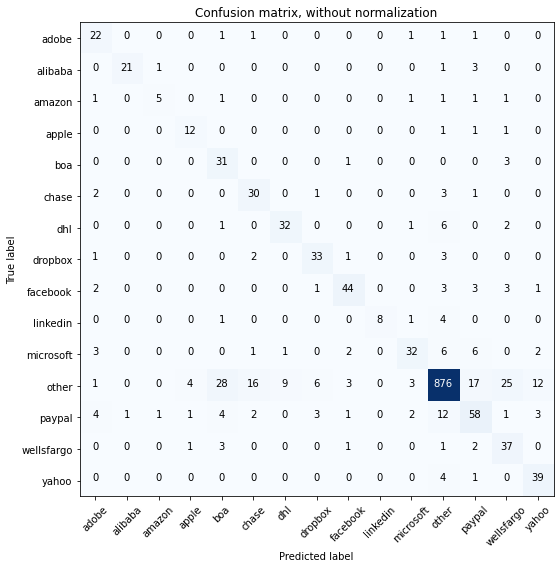

Acc     =  0.832
Pre     =  0.858
Rec     =  0.832
F1      =  0.839

Bal_Acc =  0.754
Bal_Pre =  0.723
Bal_Rec =  0.754
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.71      0.45      0.56        11
       apple       0.67      0.80      0.73        15
         boa       0.44      0.89      0.59        35
       chase       0.58      0.81      0.67        37
         dhl       0.76      0.76      0.76        42
     dropbox       0.75      0.82      0.79        40
    facebook       0.83      0.77      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.60      0.68        53
       other       0.95      0.88      0.91      1000
      paypal       0.62      0.62      0.62        93
  wellsfargo       0.51      0.82      0.63        45
       yahoo       0.68      0.89      0.77        

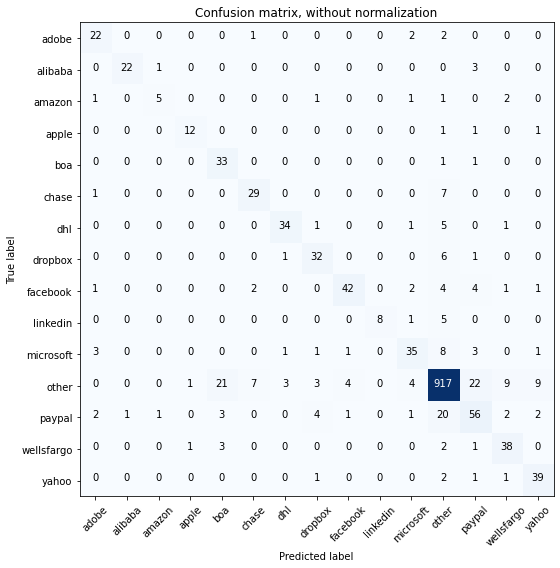

Acc     =  0.86
Pre     =  0.869
Rec     =  0.86
F1      =  0.862

Bal_Acc =  0.765
Bal_Pre =  0.784
Bal_Rec =  0.765
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.71      0.45      0.56        11
       apple       0.86      0.80      0.83        15
         boa       0.55      0.94      0.69        35
       chase       0.74      0.78      0.76        37
         dhl       0.87      0.81      0.84        42
     dropbox       0.74      0.80      0.77        40
    facebook       0.88      0.74      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.74      0.66      0.70        53
       other       0.93      0.92      0.93      1000
      paypal       0.60      0.60      0.60        93
  wellsfargo       0.70      0.84      0.77        45
       yahoo       0.74      0.89      0.80        44

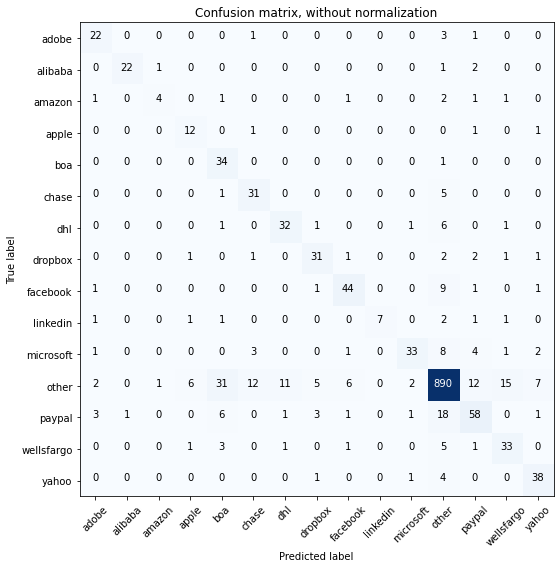

Acc     =  0.839
Pre     =  0.857
Rec     =  0.839
F1      =  0.843

Bal_Acc =  0.745
Bal_Pre =  0.739
Bal_Rec =  0.745
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.67      0.36      0.47        11
       apple       0.57      0.80      0.67        15
         boa       0.44      0.97      0.60        35
       chase       0.63      0.84      0.72        37
         dhl       0.71      0.76      0.74        42
     dropbox       0.74      0.78      0.76        40
    facebook       0.80      0.77      0.79        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.62      0.73        53
       other       0.93      0.89      0.91      1000
      paypal       0.69      0.62      0.66        93
  wellsfargo       0.62      0.73      0.67        45
       yahoo       0.75      0.86      0.80        

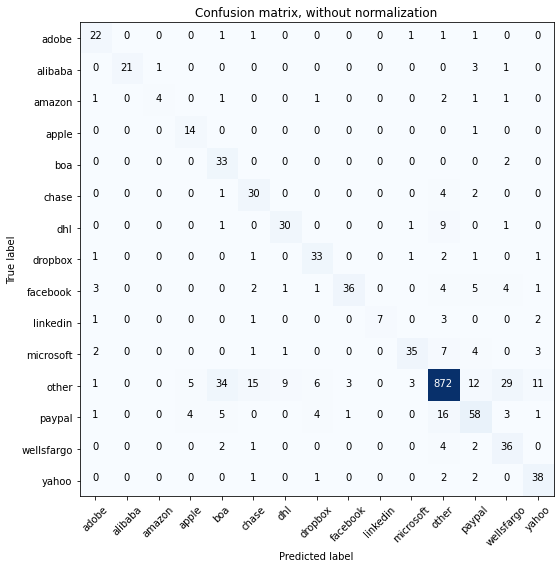

Acc     =  0.825
Pre     =  0.857
Rec     =  0.825
F1      =  0.832

Bal_Acc =  0.744
Bal_Pre =  0.733
Bal_Rec =  0.744
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       1.00      0.81      0.89        26
      amazon       0.80      0.36      0.50        11
       apple       0.61      0.93      0.74        15
         boa       0.42      0.94      0.58        35
       chase       0.57      0.81      0.67        37
         dhl       0.73      0.71      0.72        42
     dropbox       0.72      0.82      0.77        40
    facebook       0.90      0.63      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.85      0.66      0.74        53
       other       0.94      0.87      0.91      1000
      paypal       0.63      0.62      0.63        93
  wellsfargo       0.47      0.80      0.59        45
       yahoo       0.67      0.86      0.75        

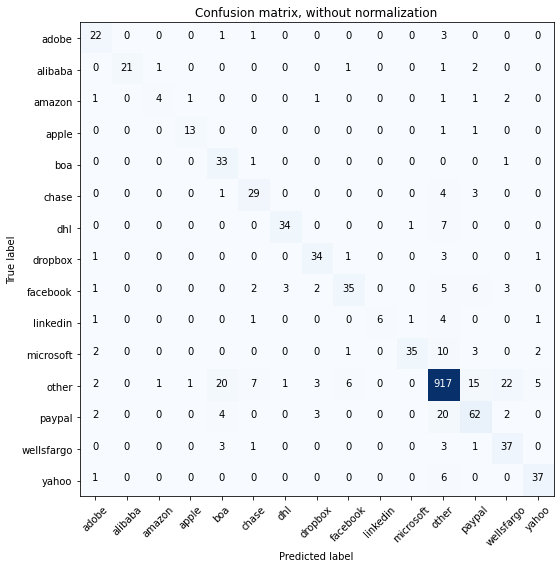

Acc     =  0.857
Pre     =  0.871
Rec     =  0.857
F1      =  0.859

Bal_Acc =  0.746
Bal_Pre =  0.786
Bal_Rec =  0.746
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       1.00      0.81      0.89        26
      amazon       0.67      0.36      0.47        11
       apple       0.87      0.87      0.87        15
         boa       0.53      0.94      0.68        35
       chase       0.69      0.78      0.73        37
         dhl       0.89      0.81      0.85        42
     dropbox       0.79      0.85      0.82        40
    facebook       0.80      0.61      0.69        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.95      0.66      0.78        53
       other       0.93      0.92      0.92      1000
      paypal       0.66      0.67      0.66        93
  wellsfargo       0.55      0.82      0.66        45
       yahoo       0.80      0.84      0.82        

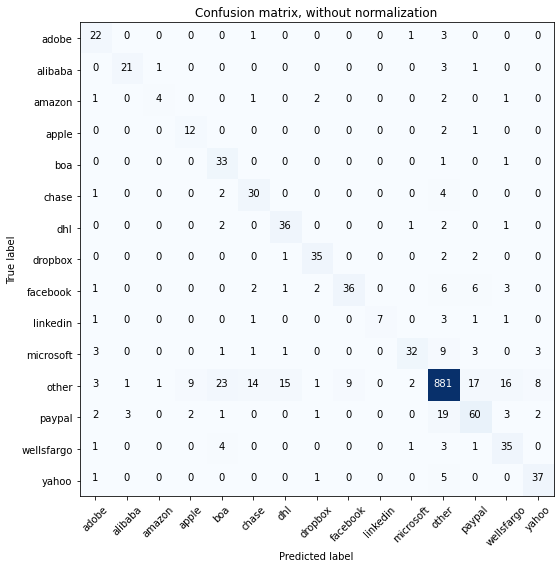

Acc     =  0.832
Pre     =  0.852
Rec     =  0.832
F1      =  0.836

Bal_Acc =  0.743
Bal_Pre =  0.72
Bal_Rec =  0.743
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.67      0.36      0.47        11
       apple       0.52      0.80      0.63        15
         boa       0.50      0.94      0.65        35
       chase       0.60      0.81      0.69        37
         dhl       0.67      0.86      0.75        42
     dropbox       0.83      0.88      0.85        40
    facebook       0.80      0.63      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.60      0.71        53
       other       0.93      0.88      0.91      1000
      paypal       0.65      0.65      0.65        93
  wellsfargo       0.57      0.78      0.66        45
       yahoo       0.74      0.84      0.79        4

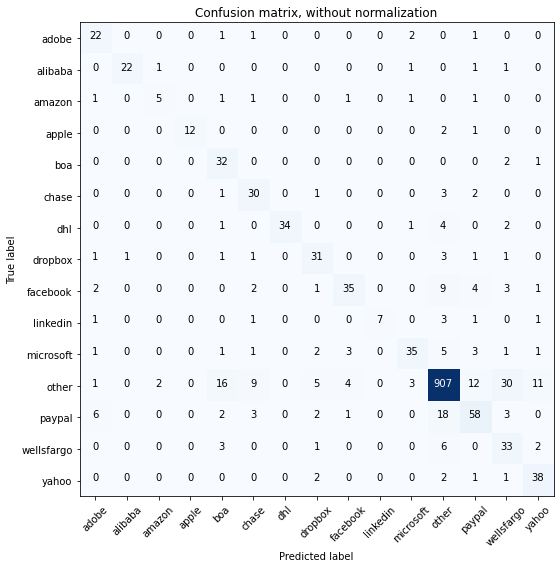

Acc     =  0.845
Pre     =  0.866
Rec     =  0.845
F1      =  0.85

Bal_Acc =  0.742
Bal_Pre =  0.76
Bal_Rec =  0.742
Bal_F1  =  0.751

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.62      0.45      0.53        11
       apple       1.00      0.80      0.89        15
         boa       0.54      0.91      0.68        35
       chase       0.61      0.81      0.70        37
         dhl       1.00      0.81      0.89        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.80      0.61      0.69        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.81      0.66      0.73        53
       other       0.94      0.91      0.92      1000
      paypal       0.67      0.62      0.65        93
  wellsfargo       0.43      0.73      0.54        45
       yahoo       0.69      0.86      0.77        44

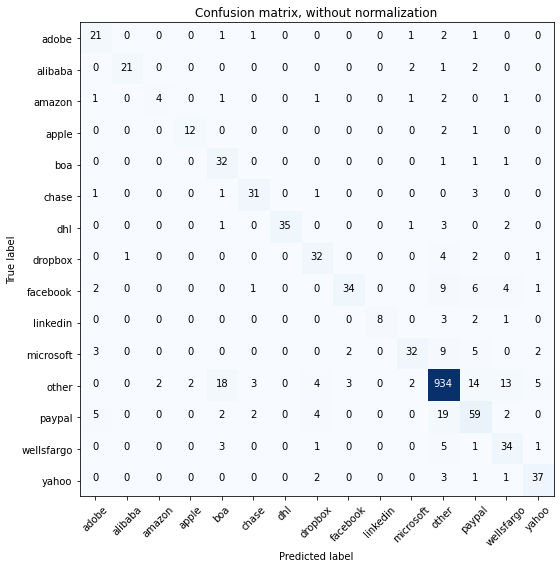

Acc     =  0.862
Pre     =  0.872
Rec     =  0.862
F1      =  0.863

Bal_Acc =  0.738
Bal_Pre =  0.785
Bal_Rec =  0.738
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.67      0.36      0.47        11
       apple       0.86      0.80      0.83        15
         boa       0.54      0.91      0.68        35
       chase       0.82      0.84      0.83        37
         dhl       1.00      0.83      0.91        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.87      0.60      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.60      0.70        53
       other       0.94      0.93      0.94      1000
      paypal       0.60      0.63      0.62        93
  wellsfargo       0.58      0.76      0.65        45
       yahoo       0.79      0.84      0.81        

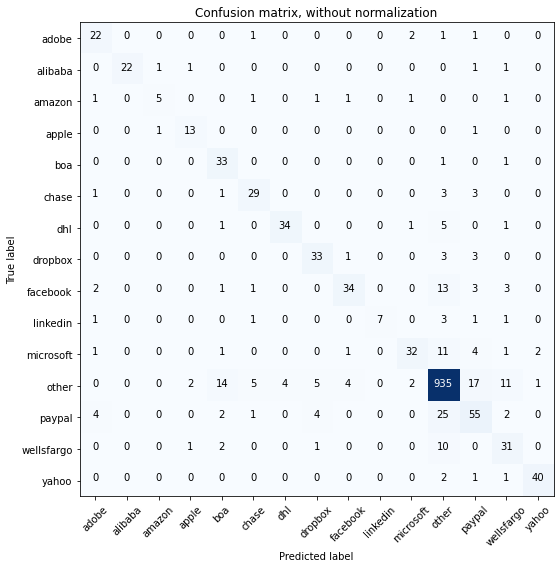

Acc     =  0.861
Pre     =  0.866
Rec     =  0.861
F1      =  0.86

Bal_Acc =  0.745
Bal_Pre =  0.791
Bal_Rec =  0.745
Bal_F1  =  0.767

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.71      0.45      0.56        11
       apple       0.76      0.87      0.81        15
         boa       0.60      0.94      0.73        35
       chase       0.74      0.78      0.76        37
         dhl       0.89      0.81      0.85        42
     dropbox       0.75      0.82      0.79        40
    facebook       0.83      0.60      0.69        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.60      0.70        53
       other       0.92      0.94      0.93      1000
      paypal       0.61      0.59      0.60        93
  wellsfargo       0.57      0.69      0.63        45
       yahoo       0.93      0.91      0.92        4

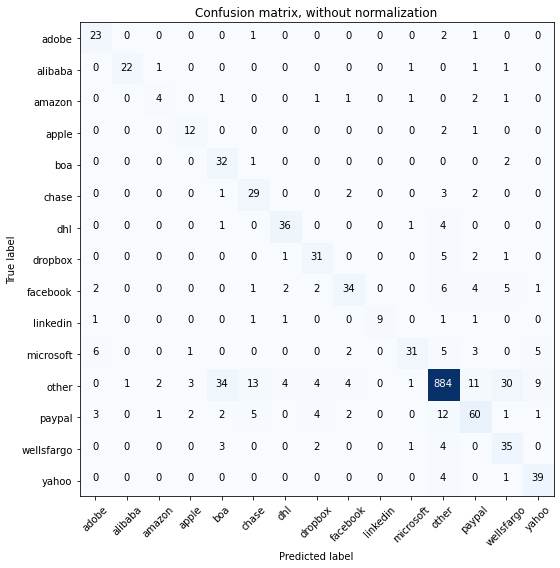

Acc     =  0.832
Pre     =  0.86
Rec     =  0.832
F1      =  0.839

Bal_Acc =  0.747
Bal_Pre =  0.714
Bal_Rec =  0.747
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.50      0.36      0.42        11
       apple       0.67      0.80      0.73        15
         boa       0.43      0.91      0.59        35
       chase       0.57      0.78      0.66        37
         dhl       0.82      0.86      0.84        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.76      0.60      0.67        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.86      0.58      0.70        53
       other       0.95      0.88      0.92      1000
      paypal       0.68      0.65      0.66        93
  wellsfargo       0.45      0.78      0.57        45
       yahoo       0.71      0.89      0.79        44

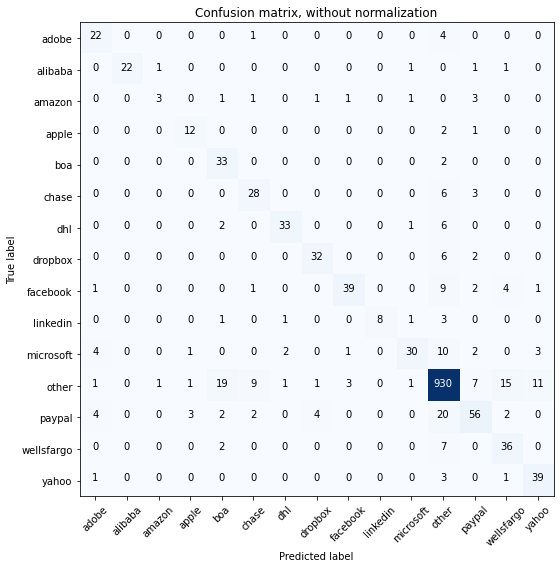

Acc     =  0.86
Pre     =  0.868
Rec     =  0.86
F1      =  0.859

Bal_Acc =  0.737
Bal_Pre =  0.777
Bal_Rec =  0.737
Bal_F1  =  0.756

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.60      0.27      0.37        11
       apple       0.71      0.80      0.75        15
         boa       0.55      0.94      0.69        35
       chase       0.67      0.76      0.71        37
         dhl       0.89      0.79      0.84        42
     dropbox       0.84      0.80      0.82        40
    facebook       0.89      0.68      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.57      0.68        53
       other       0.92      0.93      0.93      1000
      paypal       0.73      0.60      0.66        93
  wellsfargo       0.61      0.80      0.69        45
       yahoo       0.72      0.89      0.80        44

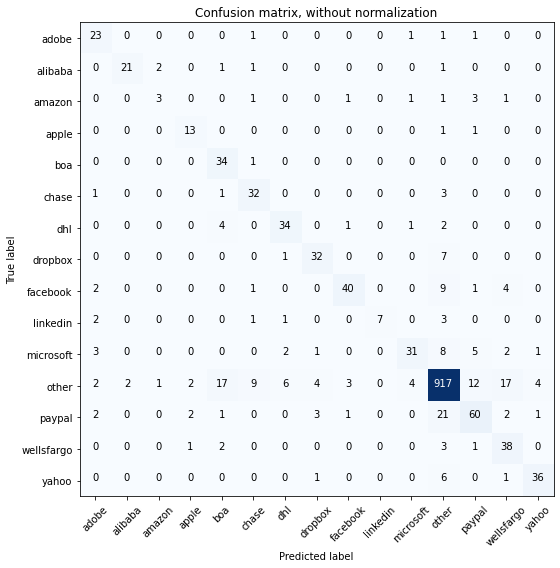

Acc     =  0.858
Pre     =  0.869
Rec     =  0.858
F1      =  0.859

Bal_Acc =  0.75
Bal_Pre =  0.758
Bal_Rec =  0.75
Bal_F1  =  0.754

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.50      0.27      0.35        11
       apple       0.72      0.87      0.79        15
         boa       0.57      0.97      0.72        35
       chase       0.68      0.86      0.76        37
         dhl       0.77      0.81      0.79        42
     dropbox       0.78      0.80      0.79        40
    facebook       0.87      0.70      0.78        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.93      0.92      0.92      1000
      paypal       0.71      0.65      0.68        93
  wellsfargo       0.58      0.84      0.69        45
       yahoo       0.86      0.82      0.84        44

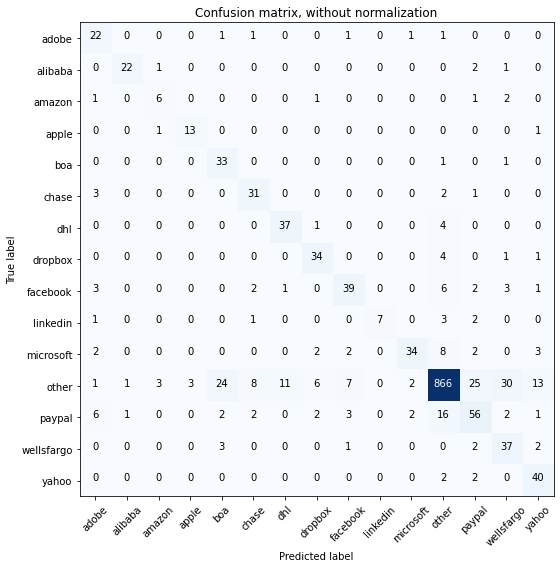

Acc     =  0.83
Pre     =  0.856
Rec     =  0.83
F1      =  0.836

Bal_Acc =  0.774
Bal_Pre =  0.721
Bal_Rec =  0.774
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.56      0.81      0.67        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.55      0.55      0.55        11
       apple       0.81      0.87      0.84        15
         boa       0.52      0.94      0.67        35
       chase       0.69      0.84      0.76        37
         dhl       0.76      0.88      0.81        42
     dropbox       0.74      0.85      0.79        40
    facebook       0.74      0.68      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.64      0.74        53
       other       0.95      0.87      0.91      1000
      paypal       0.59      0.60      0.60        93
  wellsfargo       0.48      0.82      0.61        45
       yahoo       0.65      0.91      0.75        44

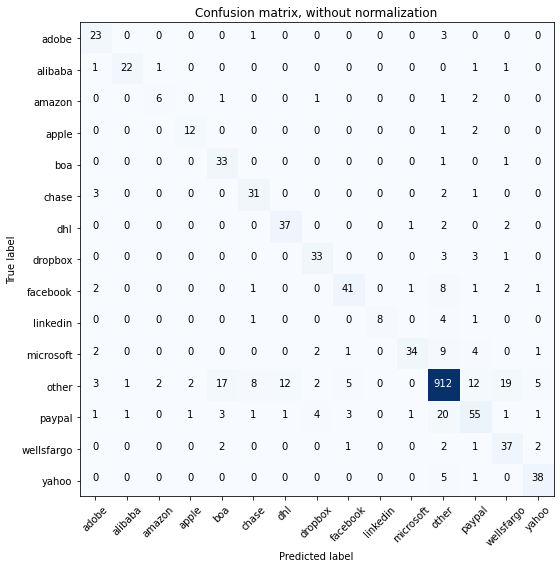

Acc     =  0.859
Pre     =  0.87
Rec     =  0.859
F1      =  0.86

Bal_Acc =  0.777
Bal_Pre =  0.771
Bal_Rec =  0.777
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.67      0.55      0.60        11
       apple       0.80      0.80      0.80        15
         boa       0.59      0.94      0.73        35
       chase       0.72      0.84      0.77        37
         dhl       0.74      0.88      0.80        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.80      0.72      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.92      0.64      0.76        53
       other       0.94      0.91      0.92      1000
      paypal       0.65      0.59      0.62        93
  wellsfargo       0.58      0.82      0.68        45
       yahoo       0.79      0.86      0.83        44

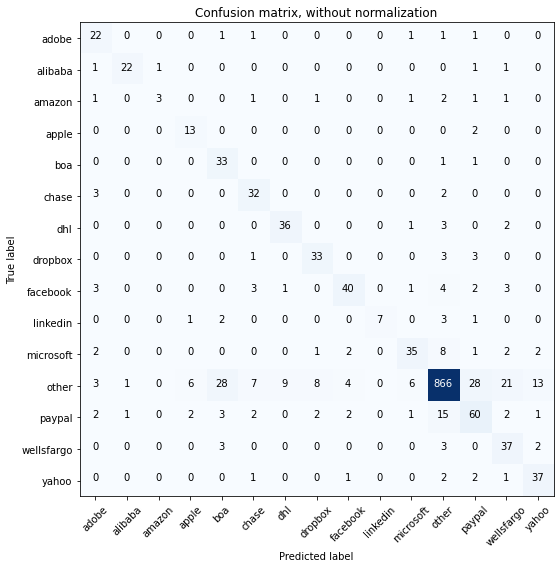

Acc     =  0.829
Pre     =  0.856
Rec     =  0.829
F1      =  0.835

Bal_Acc =  0.755
Bal_Pre =  0.721
Bal_Rec =  0.755
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.75      0.27      0.40        11
       apple       0.59      0.87      0.70        15
         boa       0.47      0.94      0.63        35
       chase       0.67      0.86      0.75        37
         dhl       0.78      0.86      0.82        42
     dropbox       0.73      0.82      0.78        40
    facebook       0.82      0.70      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.76      0.66      0.71        53
       other       0.95      0.87      0.91      1000
      paypal       0.58      0.65      0.61        93
  wellsfargo       0.53      0.82      0.64        45
       yahoo       0.67      0.84      0.75        

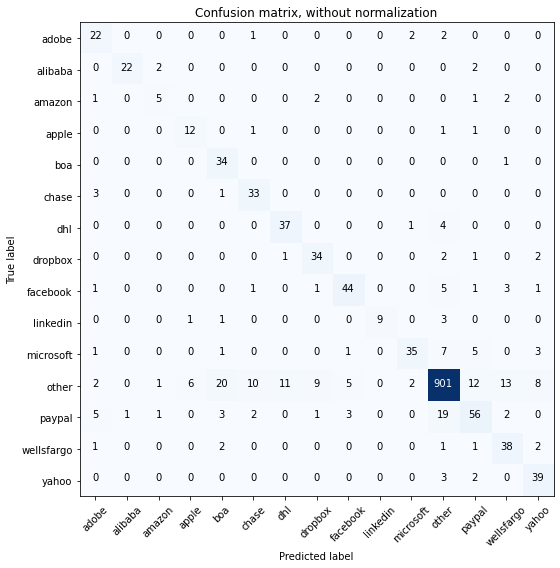

Acc     =  0.858
Pre     =  0.873
Rec     =  0.858
F1      =  0.861

Bal_Acc =  0.788
Bal_Pre =  0.744
Bal_Rec =  0.788
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.56      0.45      0.50        11
       apple       0.63      0.80      0.71        15
         boa       0.55      0.97      0.70        35
       chase       0.69      0.89      0.78        37
         dhl       0.76      0.88      0.81        42
     dropbox       0.72      0.85      0.78        40
    facebook       0.83      0.77      0.80        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.88      0.66      0.75        53
       other       0.95      0.90      0.93      1000
      paypal       0.68      0.60      0.64        93
  wellsfargo       0.64      0.84      0.73        45
       yahoo       0.71      0.89      0.79        

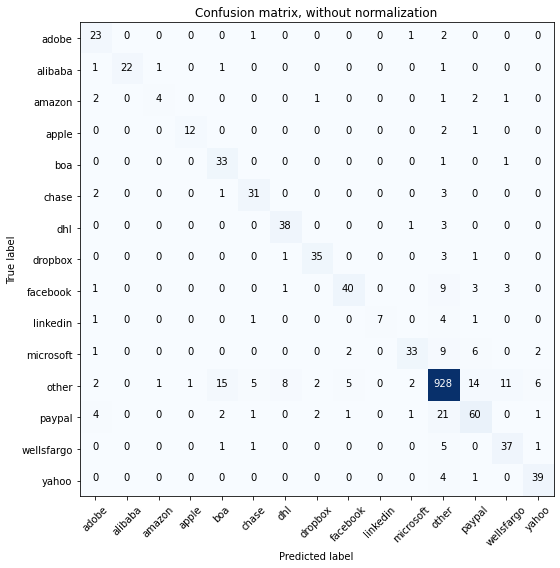

Acc     =  0.872
Pre     =  0.878
Rec     =  0.872
F1      =  0.871

Bal_Acc =  0.769
Bal_Pre =  0.805
Bal_Rec =  0.769
Bal_F1  =  0.787

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.67      0.36      0.47        11
       apple       0.92      0.80      0.86        15
         boa       0.62      0.94      0.75        35
       chase       0.78      0.84      0.81        37
         dhl       0.79      0.90      0.84        42
     dropbox       0.88      0.88      0.88        40
    facebook       0.83      0.70      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.62      0.73        53
       other       0.93      0.93      0.93      1000
      paypal       0.67      0.65      0.66        93
  wellsfargo       0.70      0.82      0.76        45
       yahoo       0.80      0.89      0.84        

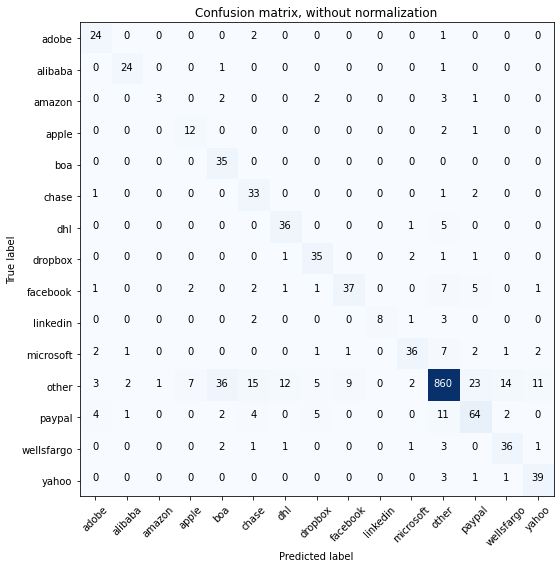

Acc     =  0.833
Pre     =  0.86
Rec     =  0.833
F1      =  0.839

Bal_Acc =  0.776
Bal_Pre =  0.726
Bal_Rec =  0.776
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.69      0.89      0.77        27
     alibaba       0.86      0.92      0.89        26
      amazon       0.75      0.27      0.40        11
       apple       0.57      0.80      0.67        15
         boa       0.45      1.00      0.62        35
       chase       0.56      0.89      0.69        37
         dhl       0.71      0.86      0.77        42
     dropbox       0.71      0.88      0.79        40
    facebook       0.79      0.65      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.68      0.75        53
       other       0.95      0.86      0.90      1000
      paypal       0.64      0.69      0.66        93
  wellsfargo       0.67      0.80      0.73        45
       yahoo       0.72      0.89      0.80        44

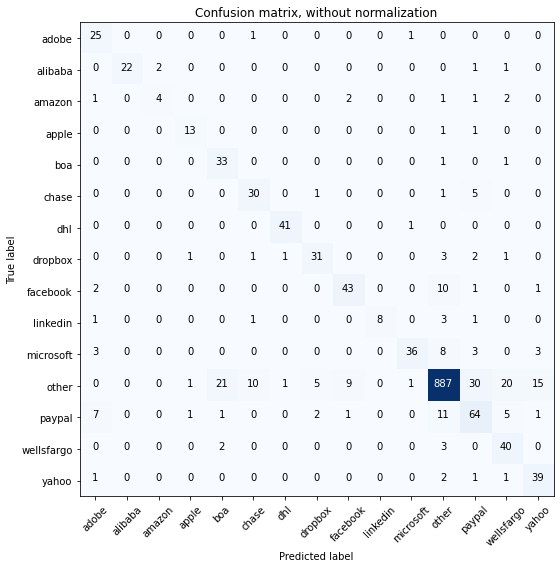

Acc     =  0.855
Pre     =  0.877
Rec     =  0.855
F1      =  0.86

Bal_Acc =  0.791
Bal_Pre =  0.773
Bal_Rec =  0.791
Bal_F1  =  0.782

              precision    recall  f1-score   support

       adobe       0.62      0.93      0.75        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.67      0.36      0.47        11
       apple       0.81      0.87      0.84        15
         boa       0.58      0.94      0.72        35
       chase       0.70      0.81      0.75        37
         dhl       0.95      0.98      0.96        42
     dropbox       0.79      0.78      0.78        40
    facebook       0.78      0.75      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.92      0.68      0.78        53
       other       0.95      0.89      0.92      1000
      paypal       0.58      0.69      0.63        93
  wellsfargo       0.56      0.89      0.69        45
       yahoo       0.66      0.89      0.76        4

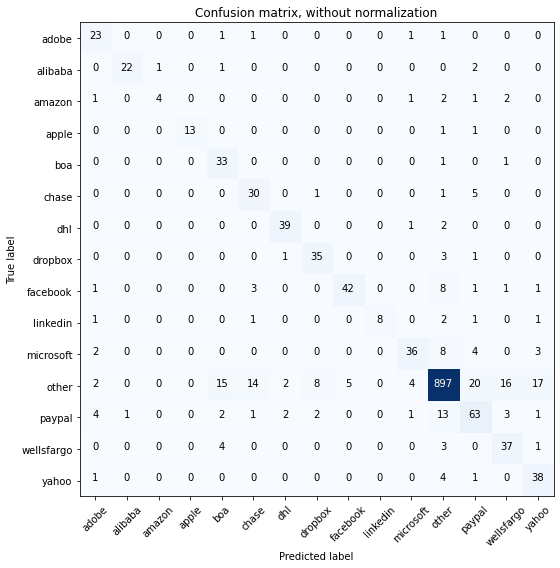

Acc     =  0.858
Pre     =  0.875
Rec     =  0.858
F1      =  0.861

Bal_Acc =  0.782
Bal_Pre =  0.785
Bal_Rec =  0.782
Bal_F1  =  0.783

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.80      0.36      0.50        11
       apple       1.00      0.87      0.93        15
         boa       0.59      0.94      0.73        35
       chase       0.60      0.81      0.69        37
         dhl       0.89      0.93      0.91        42
     dropbox       0.76      0.88      0.81        40
    facebook       0.89      0.74      0.81        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.68      0.74        53
       other       0.95      0.90      0.92      1000
      paypal       0.63      0.68      0.65        93
  wellsfargo       0.62      0.82      0.70        45
       yahoo       0.61      0.86      0.72        

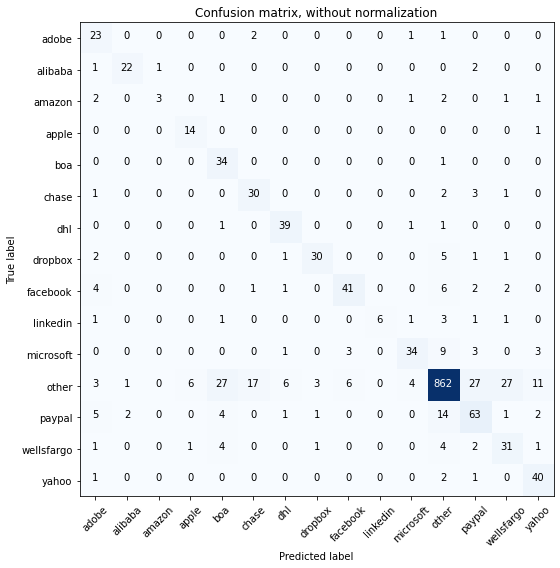

Acc     =  0.827
Pre     =  0.856
Rec     =  0.827
F1      =  0.833

Bal_Acc =  0.753
Bal_Pre =  0.725
Bal_Rec =  0.753
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.52      0.85      0.65        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.75      0.27      0.40        11
       apple       0.67      0.93      0.78        15
         boa       0.47      0.97      0.64        35
       chase       0.60      0.81      0.69        37
         dhl       0.80      0.93      0.86        42
     dropbox       0.86      0.75      0.80        40
    facebook       0.82      0.72      0.77        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.81      0.64      0.72        53
       other       0.95      0.86      0.90      1000
      paypal       0.60      0.68      0.64        93
  wellsfargo       0.48      0.69      0.56        45
       yahoo       0.68      0.91      0.78        

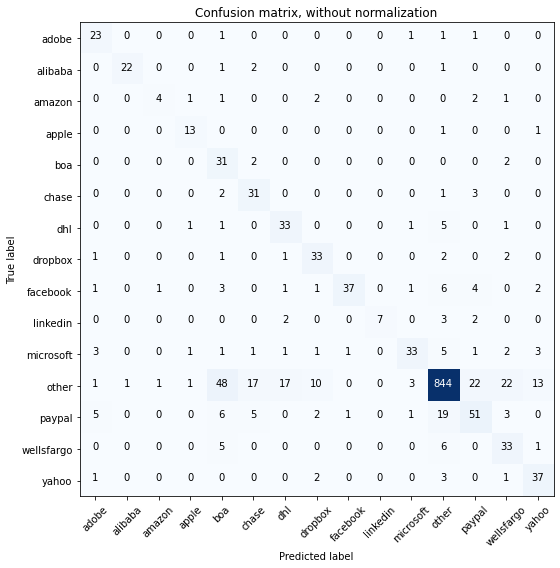

Acc     =  0.801
Pre     =  0.846
Rec     =  0.801
F1      =  0.813

Bal_Acc =  0.733
Bal_Pre =  0.706
Bal_Rec =  0.733
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.67      0.36      0.47        11
       apple       0.76      0.87      0.81        15
         boa       0.31      0.89      0.46        35
       chase       0.53      0.84      0.65        37
         dhl       0.60      0.79      0.68        42
     dropbox       0.65      0.82      0.73        40
    facebook       0.95      0.65      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.84      0.89      1000
      paypal       0.59      0.55      0.57        93
  wellsfargo       0.49      0.73      0.59        45
       yahoo       0.65      0.84      0.73        

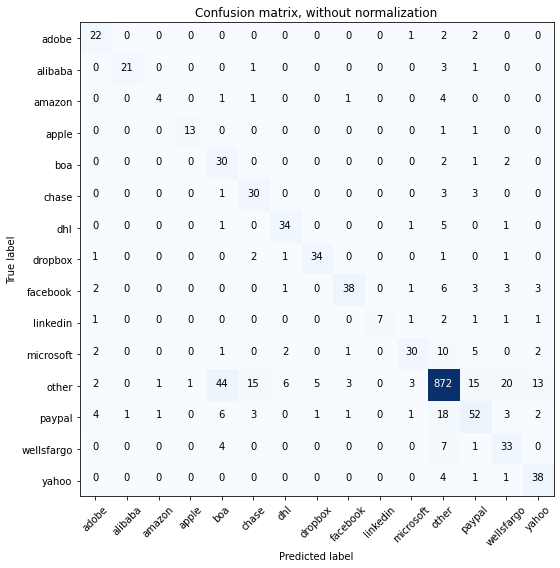

Acc     =  0.817
Pre     =  0.847
Rec     =  0.817
F1      =  0.825

Bal_Acc =  0.729
Bal_Pre =  0.738
Bal_Rec =  0.729
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.67      0.36      0.47        11
       apple       0.93      0.87      0.90        15
         boa       0.34      0.86      0.49        35
       chase       0.58      0.81      0.67        37
         dhl       0.77      0.81      0.79        42
     dropbox       0.85      0.85      0.85        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.79      0.57      0.66        53
       other       0.93      0.87      0.90      1000
      paypal       0.60      0.56      0.58        93
  wellsfargo       0.51      0.73      0.60        45
       yahoo       0.64      0.86      0.74        

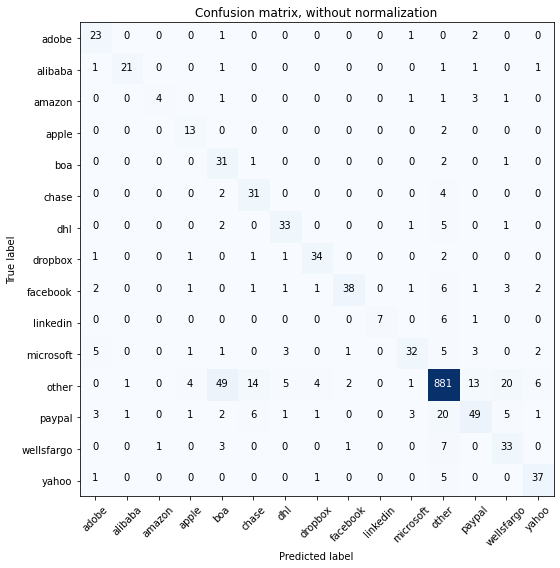

Acc     =  0.823
Pre     =  0.854
Rec     =  0.823
F1      =  0.83

Bal_Acc =  0.733
Bal_Pre =  0.736
Bal_Rec =  0.733
Bal_F1  =  0.734

              precision    recall  f1-score   support

       adobe       0.64      0.85      0.73        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.62      0.87      0.72        15
         boa       0.33      0.89      0.48        35
       chase       0.57      0.84      0.68        37
         dhl       0.75      0.79      0.77        42
     dropbox       0.83      0.85      0.84        40
    facebook       0.90      0.67      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.80      0.60      0.69        53
       other       0.93      0.88      0.90      1000
      paypal       0.67      0.53      0.59        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.76      0.84      0.80        4

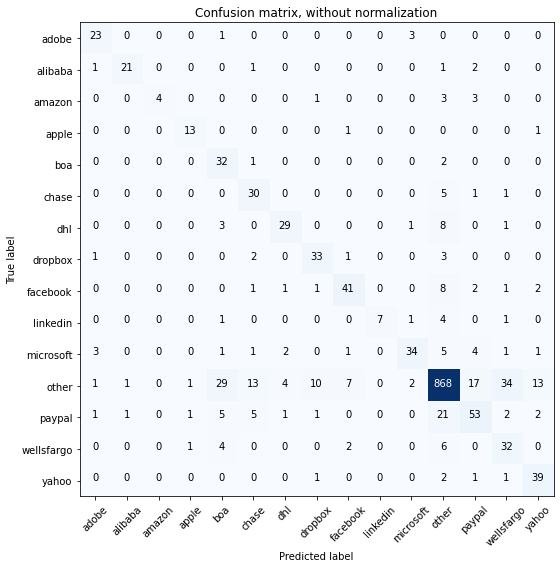

Acc     =  0.818
Pre     =  0.846
Rec     =  0.818
F1      =  0.825

Bal_Acc =  0.735
Bal_Pre =  0.749
Bal_Rec =  0.735
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.77      0.85      0.81        27
     alibaba       0.91      0.81      0.86        26
      amazon       1.00      0.36      0.53        11
       apple       0.81      0.87      0.84        15
         boa       0.42      0.91      0.58        35
       chase       0.56      0.81      0.66        37
         dhl       0.78      0.69      0.73        42
     dropbox       0.70      0.82      0.76        40
    facebook       0.77      0.72      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.83      0.64      0.72        53
       other       0.93      0.87      0.90      1000
      paypal       0.64      0.57      0.60        93
  wellsfargo       0.43      0.71      0.54        45
       yahoo       0.67      0.89      0.76        

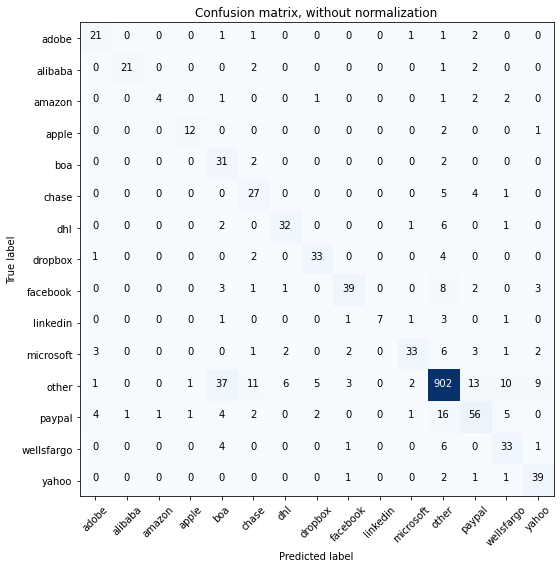

Acc     =  0.838
Pre     =  0.86
Rec     =  0.838
F1      =  0.843

Bal_Acc =  0.725
Bal_Pre =  0.76
Bal_Rec =  0.725
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.80      0.36      0.50        11
       apple       0.86      0.80      0.83        15
         boa       0.37      0.89      0.52        35
       chase       0.55      0.73      0.63        37
         dhl       0.78      0.76      0.77        42
     dropbox       0.80      0.82      0.81        40
    facebook       0.83      0.68      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.85      0.62      0.72        53
       other       0.93      0.90      0.92      1000
      paypal       0.66      0.60      0.63        93
  wellsfargo       0.60      0.73      0.66        45
       yahoo       0.71      0.89      0.79        44

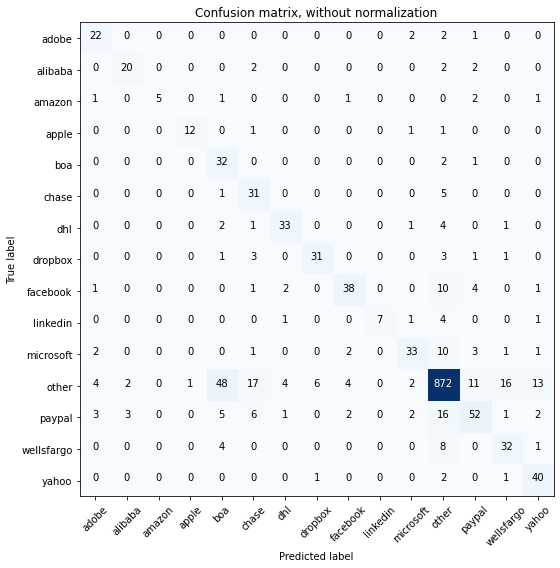

Acc     =  0.819
Pre     =  0.85
Rec     =  0.819
F1      =  0.826

Bal_Acc =  0.733
Bal_Pre =  0.754
Bal_Rec =  0.733
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.80      0.77      0.78        26
      amazon       1.00      0.45      0.62        11
       apple       0.92      0.80      0.86        15
         boa       0.34      0.91      0.50        35
       chase       0.49      0.84      0.62        37
         dhl       0.80      0.79      0.80        42
     dropbox       0.82      0.78      0.79        40
    facebook       0.81      0.67      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.79      0.62      0.69        53
       other       0.93      0.87      0.90      1000
      paypal       0.68      0.56      0.61        93
  wellsfargo       0.60      0.71      0.65        45
       yahoo       0.67      0.91      0.77        4

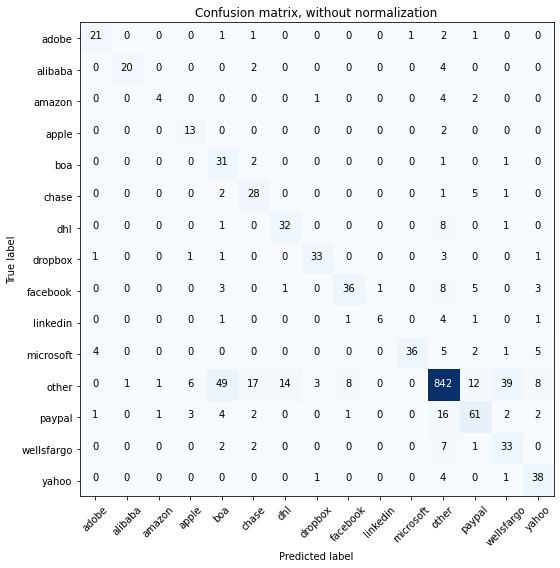

Acc     =  0.802
Pre     =  0.844
Rec     =  0.802
F1      =  0.814

Bal_Acc =  0.723
Bal_Pre =  0.71
Bal_Rec =  0.723
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.78      0.78      0.78        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.67      0.36      0.47        11
       apple       0.57      0.87      0.68        15
         boa       0.33      0.89      0.48        35
       chase       0.52      0.76      0.62        37
         dhl       0.68      0.76      0.72        42
     dropbox       0.87      0.82      0.85        40
    facebook       0.78      0.63      0.70        57
    linkedin       0.86      0.43      0.57        14
   microsoft       0.97      0.68      0.80        53
       other       0.92      0.84      0.88      1000
      paypal       0.68      0.66      0.67        93
  wellsfargo       0.42      0.73      0.53        45
       yahoo       0.66      0.86      0.75        4

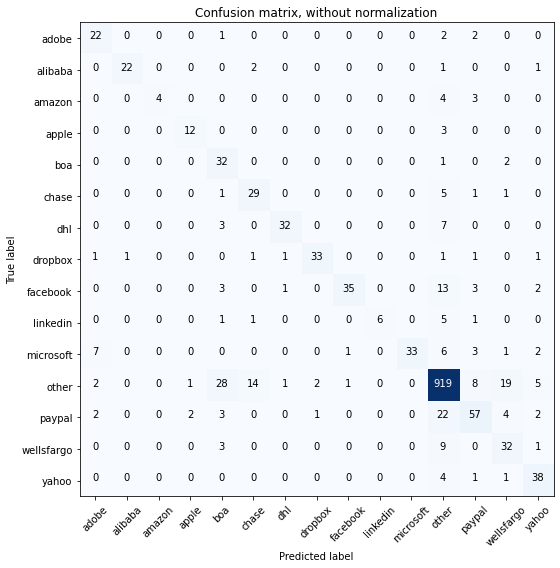

Acc     =  0.849
Pre     =  0.87
Rec     =  0.849
F1      =  0.851

Bal_Acc =  0.725
Bal_Pre =  0.808
Bal_Rec =  0.725
Bal_F1  =  0.764

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.96      0.85      0.90        26
      amazon       1.00      0.36      0.53        11
       apple       0.80      0.80      0.80        15
         boa       0.43      0.91      0.58        35
       chase       0.62      0.78      0.69        37
         dhl       0.91      0.76      0.83        42
     dropbox       0.92      0.82      0.87        40
    facebook       0.95      0.61      0.74        57
    linkedin       1.00      0.43      0.60        14
   microsoft       1.00      0.62      0.77        53
       other       0.92      0.92      0.92      1000
      paypal       0.71      0.61      0.66        93
  wellsfargo       0.53      0.71      0.61        45
       yahoo       0.73      0.86      0.79        4

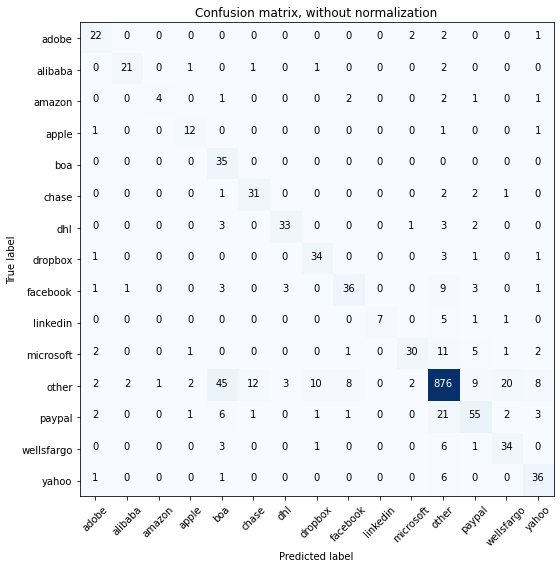

Acc     =  0.823
Pre     =  0.85
Rec     =  0.823
F1      =  0.828

Bal_Acc =  0.733
Bal_Pre =  0.743
Bal_Rec =  0.733
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.80      0.36      0.50        11
       apple       0.71      0.80      0.75        15
         boa       0.36      1.00      0.53        35
       chase       0.69      0.84      0.76        37
         dhl       0.85      0.79      0.81        42
     dropbox       0.72      0.85      0.78        40
    facebook       0.75      0.63      0.69        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.57      0.68        53
       other       0.92      0.88      0.90      1000
      paypal       0.69      0.59      0.64        93
  wellsfargo       0.58      0.76      0.65        45
       yahoo       0.67      0.82      0.73        4

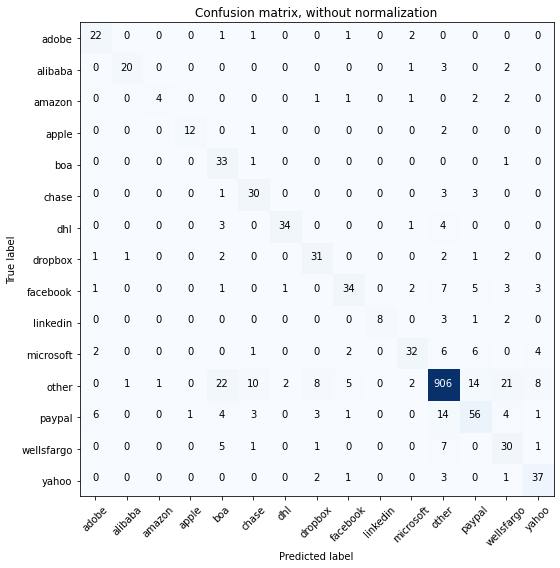

Acc     =  0.838
Pre     =  0.858
Rec     =  0.838
F1      =  0.842

Bal_Acc =  0.725
Bal_Pre =  0.749
Bal_Rec =  0.725
Bal_F1  =  0.737

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.80      0.36      0.50        11
       apple       0.92      0.80      0.86        15
         boa       0.46      0.94      0.62        35
       chase       0.62      0.81      0.71        37
         dhl       0.92      0.81      0.86        42
     dropbox       0.67      0.78      0.72        40
    facebook       0.76      0.60      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.60      0.68        53
       other       0.94      0.91      0.92      1000
      paypal       0.64      0.60      0.62        93
  wellsfargo       0.44      0.67      0.53        45
       yahoo       0.69      0.84      0.76        

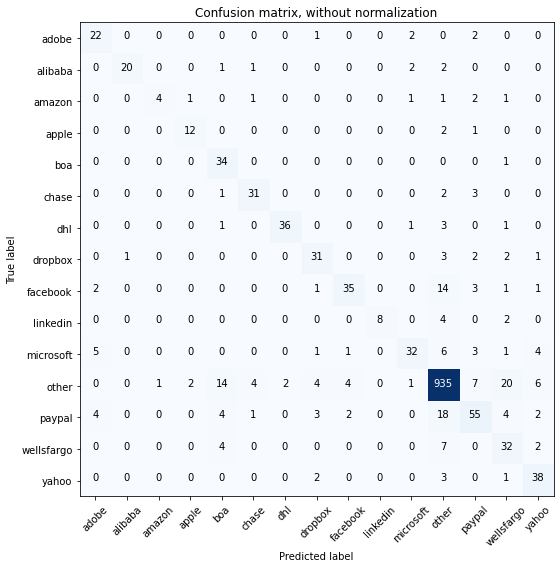

Acc     =  0.861
Pre     =  0.871
Rec     =  0.861
F1      =  0.861

Bal_Acc =  0.739
Bal_Pre =  0.784
Bal_Rec =  0.739
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.80      0.36      0.50        11
       apple       0.80      0.80      0.80        15
         boa       0.58      0.97      0.72        35
       chase       0.82      0.84      0.83        37
         dhl       0.95      0.86      0.90        42
     dropbox       0.72      0.78      0.75        40
    facebook       0.83      0.61      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.60      0.70        53
       other       0.94      0.94      0.94      1000
      paypal       0.71      0.59      0.64        93
  wellsfargo       0.48      0.71      0.58        45
       yahoo       0.70      0.86      0.78        

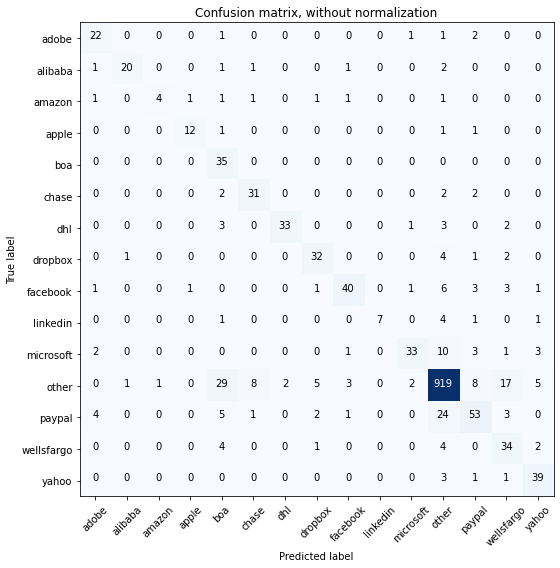

Acc     =  0.854
Pre     =  0.872
Rec     =  0.854
F1      =  0.857

Bal_Acc =  0.742
Bal_Pre =  0.787
Bal_Rec =  0.742
Bal_F1  =  0.764

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.80      0.36      0.50        11
       apple       0.86      0.80      0.83        15
         boa       0.42      1.00      0.59        35
       chase       0.74      0.84      0.78        37
         dhl       0.94      0.79      0.86        42
     dropbox       0.76      0.80      0.78        40
    facebook       0.85      0.70      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.62      0.73        53
       other       0.93      0.92      0.93      1000
      paypal       0.71      0.57      0.63        93
  wellsfargo       0.54      0.76      0.63        45
       yahoo       0.76      0.89      0.82        

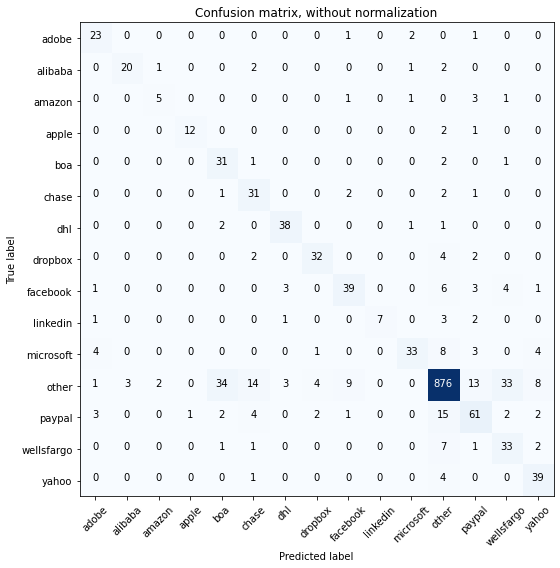

Acc     =  0.832
Pre     =  0.858
Rec     =  0.832
F1      =  0.839

Bal_Acc =  0.751
Bal_Pre =  0.742
Bal_Rec =  0.751
Bal_F1  =  0.746

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.62      0.45      0.53        11
       apple       0.92      0.80      0.86        15
         boa       0.44      0.89      0.58        35
       chase       0.55      0.84      0.67        37
         dhl       0.84      0.90      0.87        42
     dropbox       0.82      0.80      0.81        40
    facebook       0.74      0.68      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.88      0.91      1000
      paypal       0.67      0.66      0.66        93
  wellsfargo       0.45      0.73      0.55        45
       yahoo       0.70      0.89      0.78        

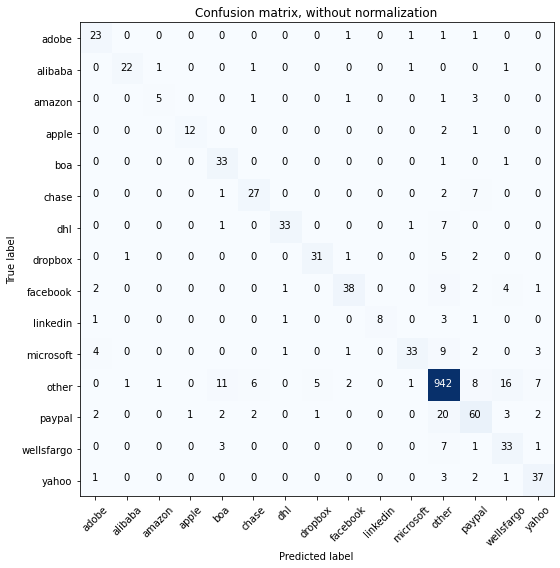

Acc     =  0.869
Pre     =  0.875
Rec     =  0.869
F1      =  0.868

Bal_Acc =  0.747
Bal_Pre =  0.801
Bal_Rec =  0.747
Bal_F1  =  0.773

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.71      0.45      0.56        11
       apple       0.92      0.80      0.86        15
         boa       0.65      0.94      0.77        35
       chase       0.73      0.73      0.73        37
         dhl       0.92      0.79      0.85        42
     dropbox       0.84      0.78      0.81        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.93      0.94      0.94      1000
      paypal       0.67      0.65      0.66        93
  wellsfargo       0.56      0.73      0.63        45
       yahoo       0.73      0.84      0.78        

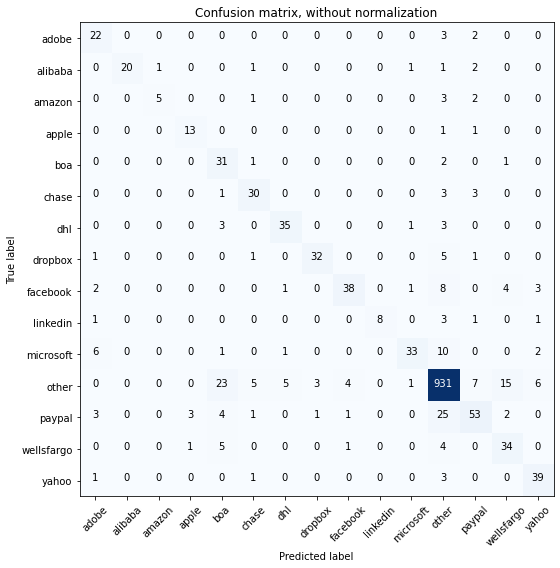

Acc     =  0.86
Pre     =  0.873
Rec     =  0.86
F1      =  0.861

Bal_Acc =  0.749
Bal_Pre =  0.794
Bal_Rec =  0.749
Bal_F1  =  0.771

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       1.00      0.77      0.87        26
      amazon       0.83      0.45      0.59        11
       apple       0.76      0.87      0.81        15
         boa       0.46      0.89      0.60        35
       chase       0.73      0.81      0.77        37
         dhl       0.83      0.83      0.83        42
     dropbox       0.89      0.80      0.84        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.93      0.93      0.93      1000
      paypal       0.74      0.57      0.64        93
  wellsfargo       0.61      0.76      0.67        45
       yahoo       0.76      0.89      0.82        44

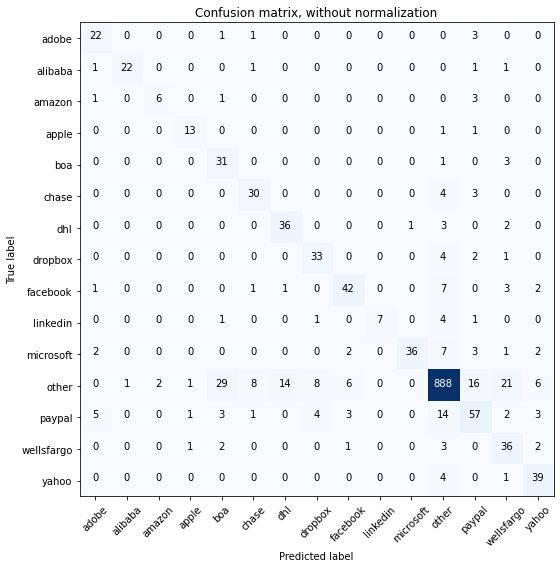

Acc     =  0.843
Pre     =  0.866
Rec     =  0.843
F1      =  0.849

Bal_Acc =  0.77
Bal_Pre =  0.757
Bal_Rec =  0.77
Bal_F1  =  0.763

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.75      0.55      0.63        11
       apple       0.81      0.87      0.84        15
         boa       0.46      0.89      0.60        35
       chase       0.71      0.81      0.76        37
         dhl       0.71      0.86      0.77        42
     dropbox       0.72      0.82      0.77        40
    facebook       0.78      0.74      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.97      0.68      0.80        53
       other       0.94      0.89      0.92      1000
      paypal       0.63      0.61      0.62        93
  wellsfargo       0.51      0.80      0.62        45
       yahoo       0.72      0.89      0.80        44

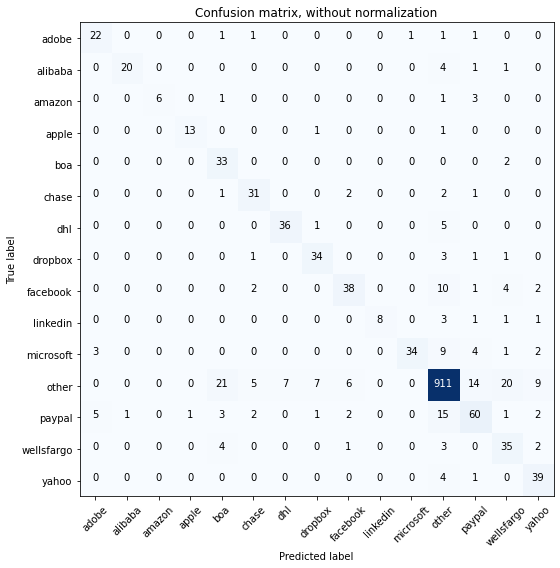

Acc     =  0.858
Pre     =  0.874
Rec     =  0.858
F1      =  0.861

Bal_Acc =  0.772
Bal_Pre =  0.804
Bal_Rec =  0.772
Bal_F1  =  0.788

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.95      0.77      0.85        26
      amazon       1.00      0.55      0.71        11
       apple       0.93      0.87      0.90        15
         boa       0.52      0.94      0.67        35
       chase       0.74      0.84      0.78        37
         dhl       0.84      0.86      0.85        42
     dropbox       0.77      0.85      0.81        40
    facebook       0.78      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.97      0.64      0.77        53
       other       0.94      0.91      0.92      1000
      paypal       0.68      0.65      0.66        93
  wellsfargo       0.53      0.78      0.63        45
       yahoo       0.68      0.89      0.77        

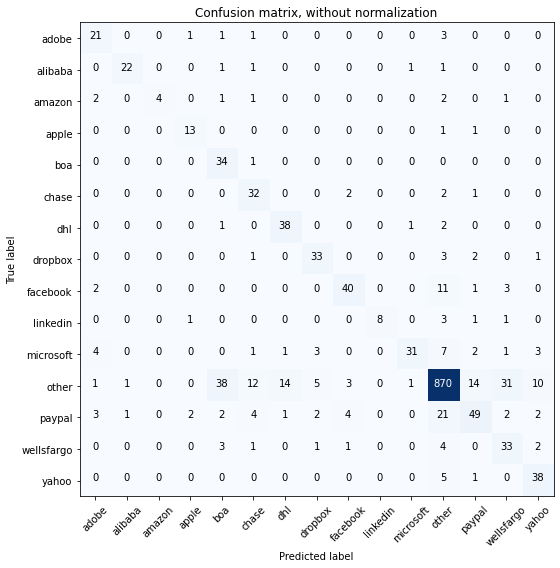

Acc     =  0.823
Pre     =  0.852
Rec     =  0.823
F1      =  0.828

Bal_Acc =  0.751
Bal_Pre =  0.749
Bal_Rec =  0.751
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        27
     alibaba       0.92      0.85      0.88        26
      amazon       1.00      0.36      0.53        11
       apple       0.76      0.87      0.81        15
         boa       0.42      0.97      0.59        35
       chase       0.58      0.86      0.70        37
         dhl       0.70      0.90      0.79        42
     dropbox       0.75      0.82      0.79        40
    facebook       0.80      0.70      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.91      0.58      0.71        53
       other       0.93      0.87      0.90      1000
      paypal       0.68      0.53      0.59        93
  wellsfargo       0.46      0.73      0.56        45
       yahoo       0.68      0.86      0.76        4

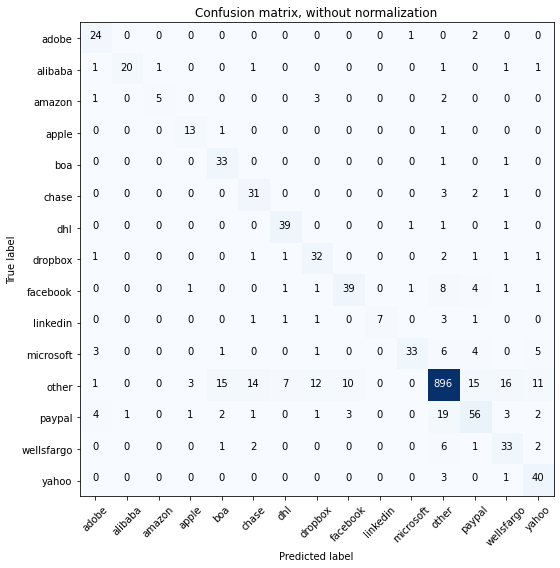

Acc     =  0.845
Pre     =  0.862
Rec     =  0.845
F1      =  0.848

Bal_Acc =  0.762
Bal_Pre =  0.753
Bal_Rec =  0.762
Bal_F1  =  0.757

              precision    recall  f1-score   support

       adobe       0.69      0.89      0.77        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.83      0.45      0.59        11
       apple       0.72      0.87      0.79        15
         boa       0.62      0.94      0.75        35
       chase       0.61      0.84      0.70        37
         dhl       0.80      0.93      0.86        42
     dropbox       0.63      0.80      0.70        40
    facebook       0.75      0.68      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.92      0.62      0.74        53
       other       0.94      0.90      0.92      1000
      paypal       0.65      0.60      0.63        93
  wellsfargo       0.56      0.73      0.63        45
       yahoo       0.63      0.91      0.75        

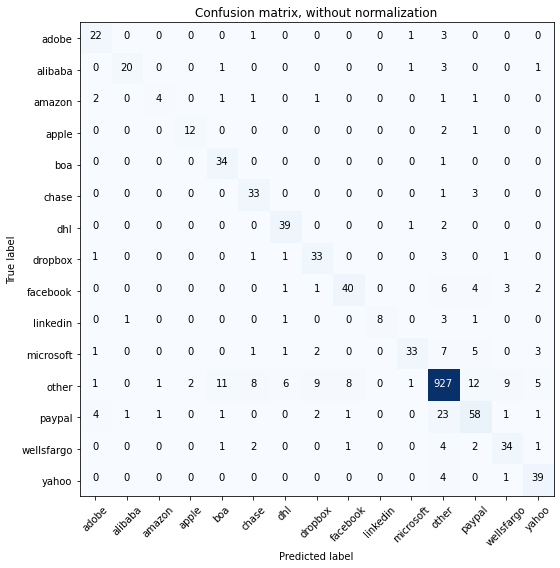

Acc     =  0.868
Pre     =  0.873
Rec     =  0.868
F1      =  0.867

Bal_Acc =  0.764
Bal_Pre =  0.784
Bal_Rec =  0.764
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.67      0.36      0.47        11
       apple       0.86      0.80      0.83        15
         boa       0.69      0.97      0.81        35
       chase       0.70      0.89      0.79        37
         dhl       0.80      0.93      0.86        42
     dropbox       0.69      0.82      0.75        40
    facebook       0.80      0.70      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.94      0.93      0.93      1000
      paypal       0.67      0.62      0.64        93
  wellsfargo       0.69      0.76      0.72        45
       yahoo       0.75      0.89      0.81        

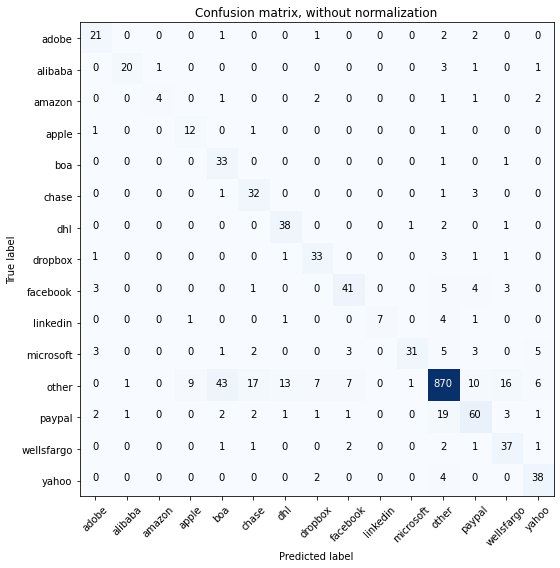

Acc     =  0.83
Pre     =  0.86
Rec     =  0.83
F1      =  0.836

Bal_Acc =  0.75
Bal_Pre =  0.73
Bal_Rec =  0.75
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.80      0.36      0.50        11
       apple       0.55      0.80      0.65        15
         boa       0.40      0.94      0.56        35
       chase       0.57      0.86      0.69        37
         dhl       0.70      0.90      0.79        42
     dropbox       0.72      0.82      0.77        40
    facebook       0.76      0.72      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.94      0.58      0.72        53
       other       0.94      0.87      0.90      1000
      paypal       0.69      0.65      0.67        93
  wellsfargo       0.60      0.82      0.69        45
       yahoo       0.70      0.86      0.78        44

   

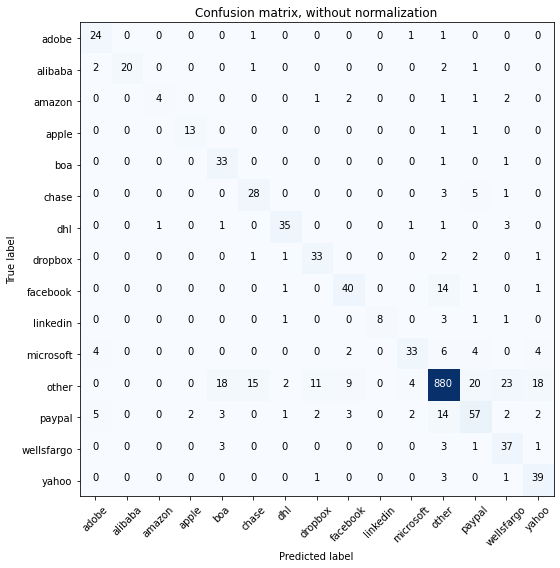

Acc     =  0.834
Pre     =  0.855
Rec     =  0.834
F1      =  0.839

Bal_Acc =  0.756
Bal_Pre =  0.75
Bal_Rec =  0.756
Bal_F1  =  0.753

              precision    recall  f1-score   support

       adobe       0.69      0.89      0.77        27
     alibaba       1.00      0.77      0.87        26
      amazon       0.80      0.36      0.50        11
       apple       0.87      0.87      0.87        15
         boa       0.57      0.94      0.71        35
       chase       0.61      0.76      0.67        37
         dhl       0.85      0.83      0.84        42
     dropbox       0.69      0.82      0.75        40
    facebook       0.71      0.70      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.62      0.70        53
       other       0.94      0.88      0.91      1000
      paypal       0.61      0.61      0.61        93
  wellsfargo       0.52      0.82      0.64        45
       yahoo       0.59      0.89      0.71        4

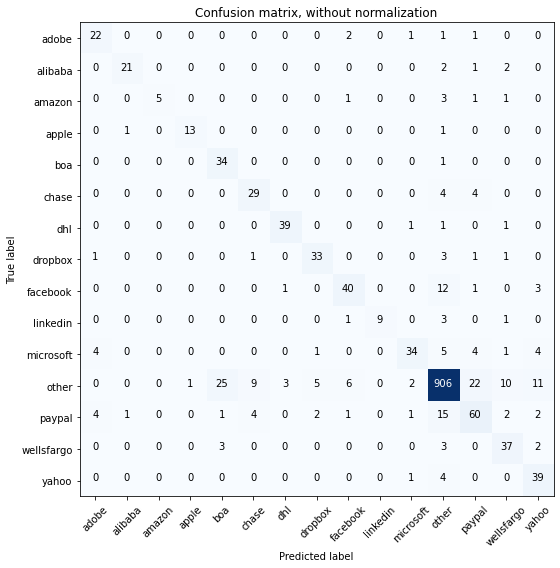

Acc     =  0.858
Pre     =  0.872
Rec     =  0.858
F1      =  0.861

Bal_Acc =  0.78
Bal_Pre =  0.799
Bal_Rec =  0.78
Bal_F1  =  0.789

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.91      0.81      0.86        26
      amazon       1.00      0.45      0.62        11
       apple       0.93      0.87      0.90        15
         boa       0.54      0.97      0.69        35
       chase       0.67      0.78      0.72        37
         dhl       0.91      0.93      0.92        42
     dropbox       0.80      0.82      0.81        40
    facebook       0.78      0.70      0.74        57
    linkedin       1.00      0.64      0.78        14
   microsoft       0.85      0.64      0.73        53
       other       0.94      0.91      0.92      1000
      paypal       0.63      0.65      0.64        93
  wellsfargo       0.66      0.82      0.73        45
       yahoo       0.64      0.89      0.74        44

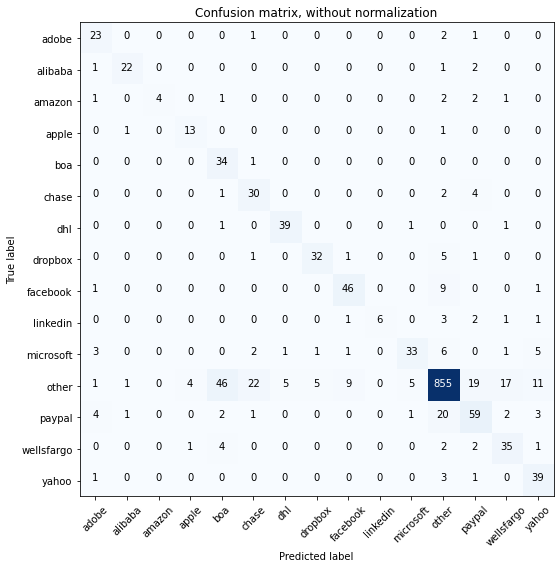

Acc     =  0.825
Pre     =  0.858
Rec     =  0.825
F1      =  0.833

Bal_Acc =  0.763
Bal_Pre =  0.753
Bal_Rec =  0.763
Bal_F1  =  0.758

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.88      0.85      0.86        26
      amazon       1.00      0.36      0.53        11
       apple       0.72      0.87      0.79        15
         boa       0.38      0.97      0.55        35
       chase       0.52      0.81      0.63        37
         dhl       0.87      0.93      0.90        42
     dropbox       0.84      0.80      0.82        40
    facebook       0.79      0.81      0.80        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.85      0.89      1000
      paypal       0.63      0.63      0.63        93
  wellsfargo       0.60      0.78      0.68        45
       yahoo       0.64      0.89      0.74        

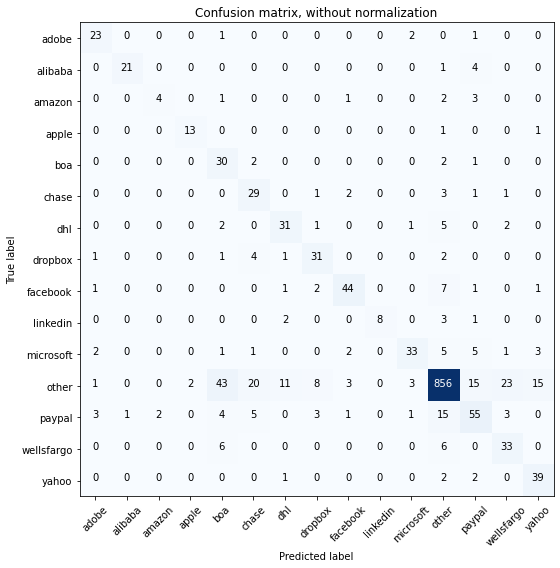

Acc     =  0.812
Pre     =  0.848
Rec     =  0.812
F1      =  0.823

Bal_Acc =  0.738
Bal_Pre =  0.718
Bal_Rec =  0.738
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.67      0.36      0.47        11
       apple       0.87      0.87      0.87        15
         boa       0.34      0.86      0.48        35
       chase       0.48      0.78      0.59        37
         dhl       0.66      0.74      0.70        42
     dropbox       0.67      0.78      0.72        40
    facebook       0.83      0.77      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.62      0.71        53
       other       0.94      0.86      0.90      1000
      paypal       0.62      0.59      0.60        93
  wellsfargo       0.52      0.73      0.61        45
       yahoo       0.66      0.89      0.76        

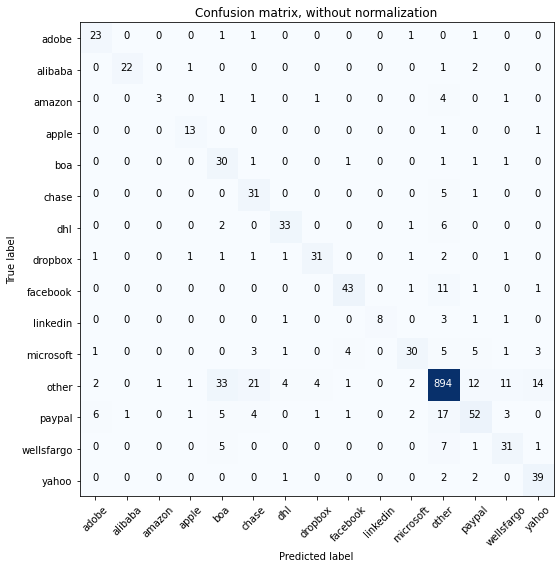

Acc     =  0.834
Pre     =  0.856
Rec     =  0.834
F1      =  0.838

Bal_Acc =  0.734
Bal_Pre =  0.747
Bal_Rec =  0.734
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.75      0.27      0.40        11
       apple       0.76      0.87      0.81        15
         boa       0.38      0.86      0.53        35
       chase       0.49      0.84      0.62        37
         dhl       0.80      0.79      0.80        42
     dropbox       0.84      0.78      0.81        40
    facebook       0.86      0.75      0.80        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.79      0.57      0.66        53
       other       0.93      0.89      0.91      1000
      paypal       0.66      0.56      0.60        93
  wellsfargo       0.62      0.69      0.65        45
       yahoo       0.66      0.89      0.76        4

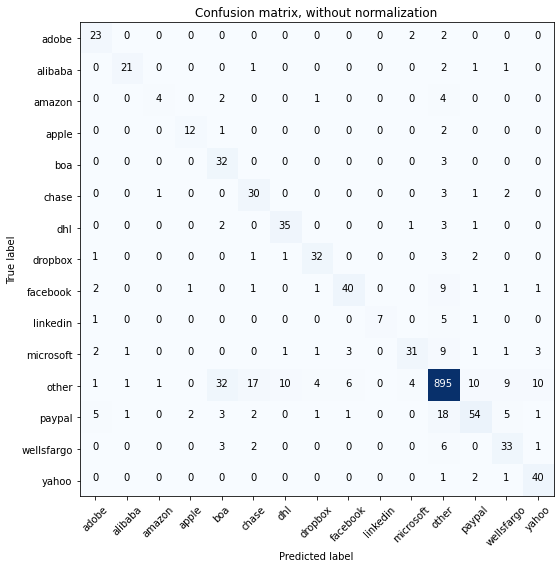

Acc     =  0.838
Pre     =  0.855
Rec     =  0.838
F1      =  0.84

Bal_Acc =  0.739
Bal_Pre =  0.742
Bal_Rec =  0.739
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.80      0.80      0.80        15
         boa       0.43      0.91      0.58        35
       chase       0.56      0.81      0.66        37
         dhl       0.74      0.83      0.79        42
     dropbox       0.80      0.80      0.80        40
    facebook       0.80      0.70      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.93      0.90      0.91      1000
      paypal       0.73      0.58      0.65        93
  wellsfargo       0.62      0.73      0.67        45
       yahoo       0.71      0.91      0.80        44

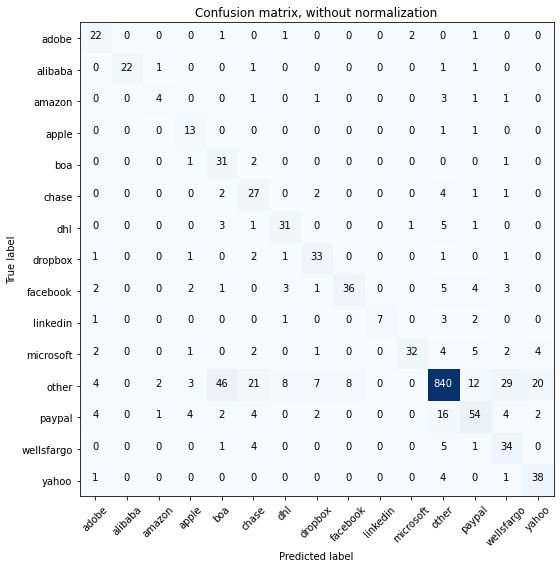

Acc     =  0.795
Pre     =  0.843
Rec     =  0.795
F1      =  0.808

Bal_Acc =  0.723
Bal_Pre =  0.675
Bal_Rec =  0.723
Bal_F1  =  0.698

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.50      0.36      0.42        11
       apple       0.52      0.87      0.65        15
         boa       0.36      0.89      0.51        35
       chase       0.42      0.73      0.53        37
         dhl       0.69      0.74      0.71        42
     dropbox       0.70      0.82      0.76        40
    facebook       0.82      0.63      0.71        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.91      0.60      0.73        53
       other       0.94      0.84      0.89      1000
      paypal       0.64      0.58      0.61        93
  wellsfargo       0.44      0.76      0.56        45
       yahoo       0.59      0.86      0.70        

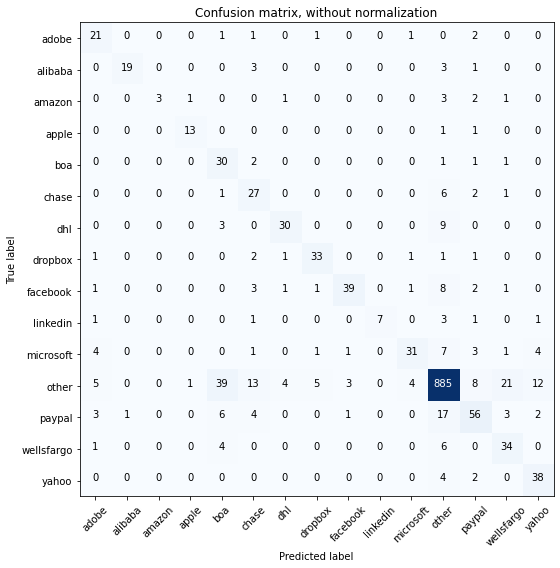

Acc     =  0.823
Pre     =  0.853
Rec     =  0.823
F1      =  0.829

Bal_Acc =  0.71
Bal_Pre =  0.757
Bal_Rec =  0.71
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.57      0.78      0.66        27
     alibaba       0.95      0.73      0.83        26
      amazon       1.00      0.27      0.43        11
       apple       0.87      0.87      0.87        15
         boa       0.36      0.86      0.50        35
       chase       0.47      0.73      0.57        37
         dhl       0.81      0.71      0.76        42
     dropbox       0.80      0.82      0.81        40
    facebook       0.89      0.68      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.58      0.68        53
       other       0.93      0.89      0.91      1000
      paypal       0.68      0.60      0.64        93
  wellsfargo       0.54      0.76      0.63        45
       yahoo       0.67      0.86      0.75        44

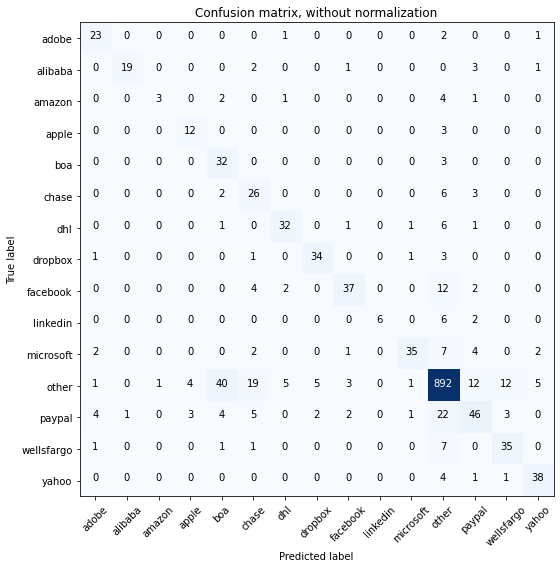

Acc     =  0.825
Pre     =  0.846
Rec     =  0.825
F1      =  0.829

Bal_Acc =  0.71
Bal_Pre =  0.748
Bal_Rec =  0.71
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.95      0.73      0.83        26
      amazon       0.75      0.27      0.40        11
       apple       0.63      0.80      0.71        15
         boa       0.39      0.91      0.55        35
       chase       0.43      0.70      0.54        37
         dhl       0.78      0.76      0.77        42
     dropbox       0.83      0.85      0.84        40
    facebook       0.82      0.65      0.73        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.90      0.66      0.76        53
       other       0.91      0.89      0.90      1000
      paypal       0.61      0.49      0.55        93
  wellsfargo       0.69      0.78      0.73        45
       yahoo       0.81      0.86      0.84        44

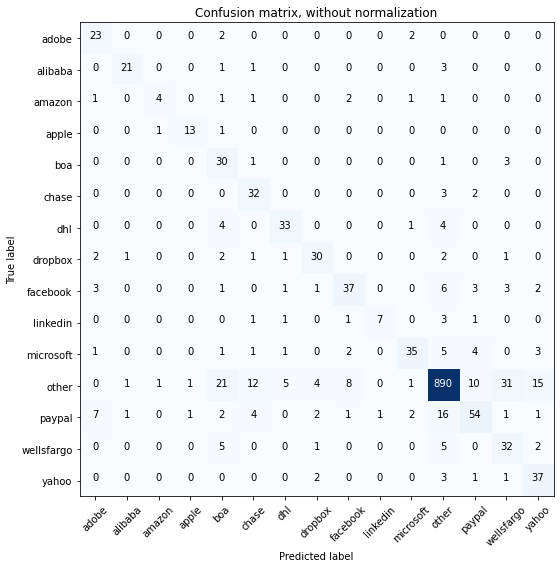

Acc     =  0.83
Pre     =  0.855
Rec     =  0.83
F1      =  0.837

Bal_Acc =  0.732
Bal_Pre =  0.716
Bal_Rec =  0.732
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.87      0.87      0.87        15
         boa       0.42      0.86      0.57        35
       chase       0.59      0.86      0.70        37
         dhl       0.79      0.79      0.79        42
     dropbox       0.75      0.75      0.75        40
    facebook       0.73      0.65      0.69        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.83      0.66      0.74        53
       other       0.94      0.89      0.92      1000
      paypal       0.72      0.58      0.64        93
  wellsfargo       0.44      0.71      0.55        45
       yahoo       0.62      0.84      0.71        44

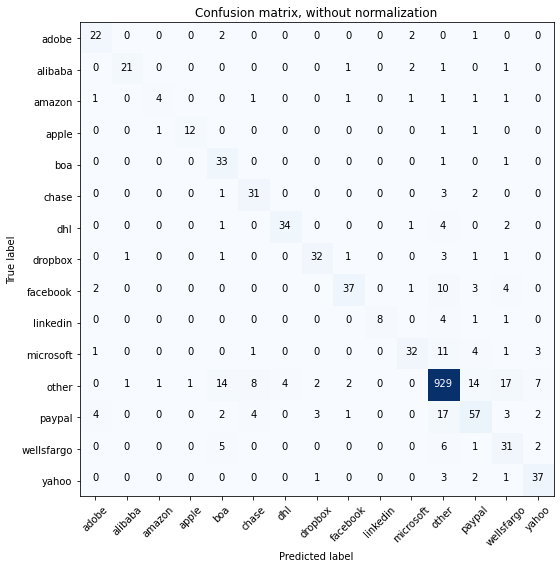

Acc     =  0.858
Pre     =  0.868
Rec     =  0.858
F1      =  0.859

Bal_Acc =  0.738
Bal_Pre =  0.78
Bal_Rec =  0.738
Bal_F1  =  0.758

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.67      0.36      0.47        11
       apple       0.92      0.80      0.86        15
         boa       0.56      0.94      0.70        35
       chase       0.69      0.84      0.76        37
         dhl       0.89      0.81      0.85        42
     dropbox       0.84      0.80      0.82        40
    facebook       0.86      0.65      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.60      0.70        53
       other       0.93      0.93      0.93      1000
      paypal       0.65      0.61      0.63        93
  wellsfargo       0.48      0.69      0.57        45
       yahoo       0.73      0.84      0.78        4

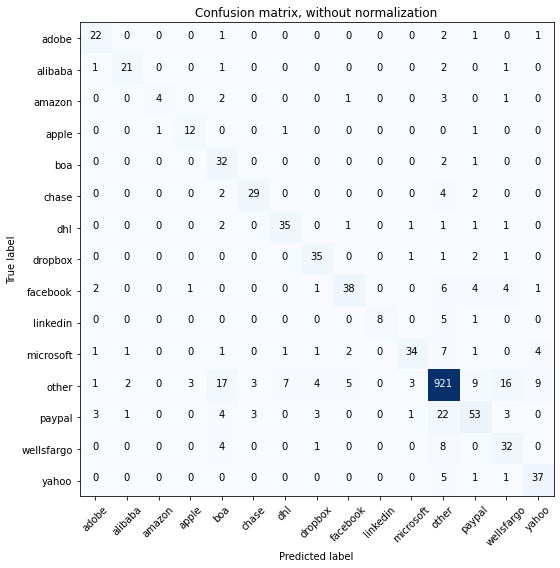

Acc     =  0.853
Pre     =  0.864
Rec     =  0.853
F1      =  0.854

Bal_Acc =  0.741
Bal_Pre =  0.769
Bal_Rec =  0.741
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.80      0.36      0.50        11
       apple       0.75      0.80      0.77        15
         boa       0.48      0.91      0.63        35
       chase       0.83      0.78      0.81        37
         dhl       0.80      0.83      0.81        42
     dropbox       0.78      0.88      0.82        40
    facebook       0.81      0.67      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.64      0.73        53
       other       0.93      0.92      0.93      1000
      paypal       0.69      0.57      0.62        93
  wellsfargo       0.53      0.71      0.61        45
       yahoo       0.71      0.84      0.77        

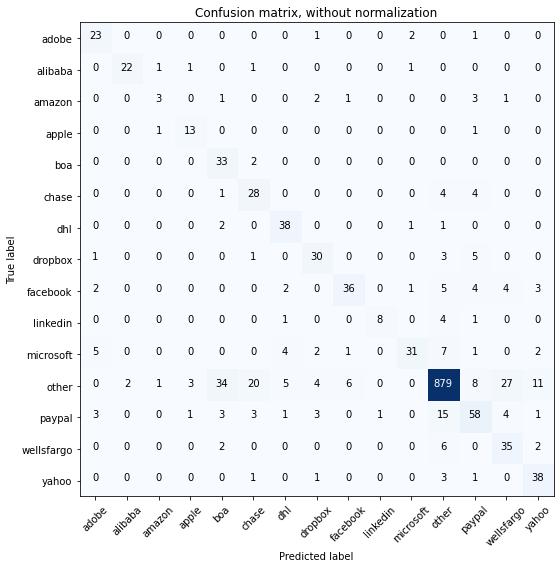

Acc     =  0.828
Pre     =  0.856
Rec     =  0.828
F1      =  0.835

Bal_Acc =  0.742
Bal_Pre =  0.702
Bal_Rec =  0.742
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.50      0.27      0.35        11
       apple       0.72      0.87      0.79        15
         boa       0.43      0.94      0.59        35
       chase       0.50      0.76      0.60        37
         dhl       0.75      0.90      0.82        42
     dropbox       0.70      0.75      0.72        40
    facebook       0.82      0.63      0.71        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.86      0.58      0.70        53
       other       0.95      0.88      0.91      1000
      paypal       0.67      0.62      0.64        93
  wellsfargo       0.49      0.78      0.60        45
       yahoo       0.67      0.86      0.75        

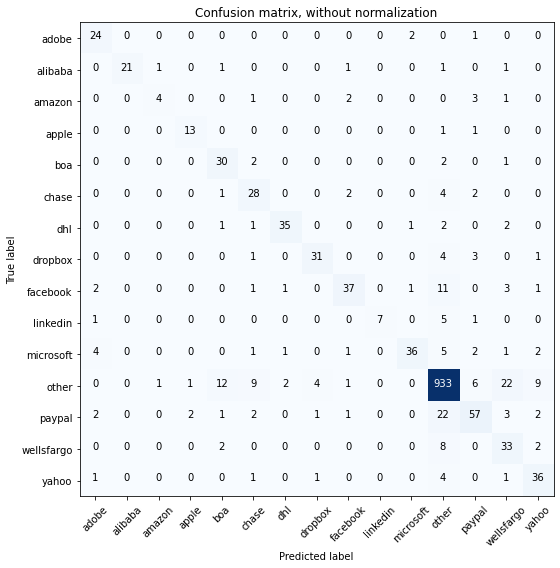

Acc     =  0.861
Pre     =  0.871
Rec     =  0.861
F1      =  0.862

Bal_Acc =  0.738
Bal_Pre =  0.781
Bal_Rec =  0.738
Bal_F1  =  0.759

              precision    recall  f1-score   support

       adobe       0.71      0.89      0.79        27
     alibaba       1.00      0.81      0.89        26
      amazon       0.67      0.36      0.47        11
       apple       0.81      0.87      0.84        15
         boa       0.62      0.86      0.72        35
       chase       0.60      0.76      0.67        37
         dhl       0.90      0.83      0.86        42
     dropbox       0.84      0.78      0.81        40
    facebook       0.82      0.65      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.90      0.68      0.77        53
       other       0.93      0.93      0.93      1000
      paypal       0.75      0.61      0.67        93
  wellsfargo       0.49      0.73      0.58        45
       yahoo       0.68      0.82      0.74        

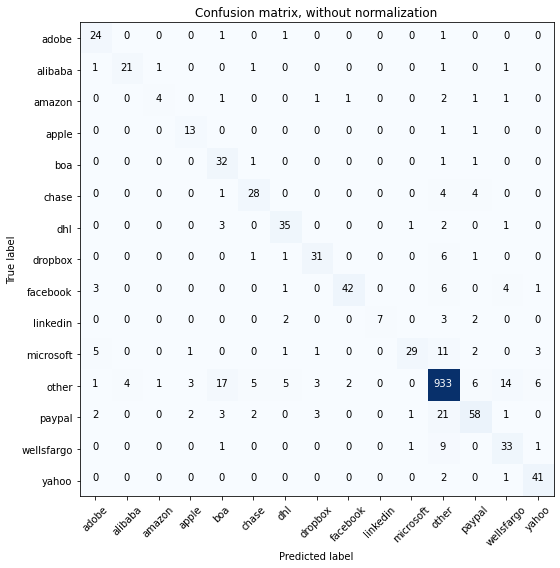

Acc     =  0.865
Pre     =  0.874
Rec     =  0.865
F1      =  0.864

Bal_Acc =  0.747
Bal_Pre =  0.774
Bal_Rec =  0.747
Bal_F1  =  0.76

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.67      0.36      0.47        11
       apple       0.68      0.87      0.76        15
         boa       0.54      0.91      0.68        35
       chase       0.74      0.76      0.75        37
         dhl       0.76      0.83      0.80        42
     dropbox       0.79      0.78      0.78        40
    facebook       0.93      0.74      0.82        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.91      0.55      0.68        53
       other       0.93      0.93      0.93      1000
      paypal       0.76      0.62      0.69        93
  wellsfargo       0.59      0.73      0.65        45
       yahoo       0.79      0.93      0.85        4

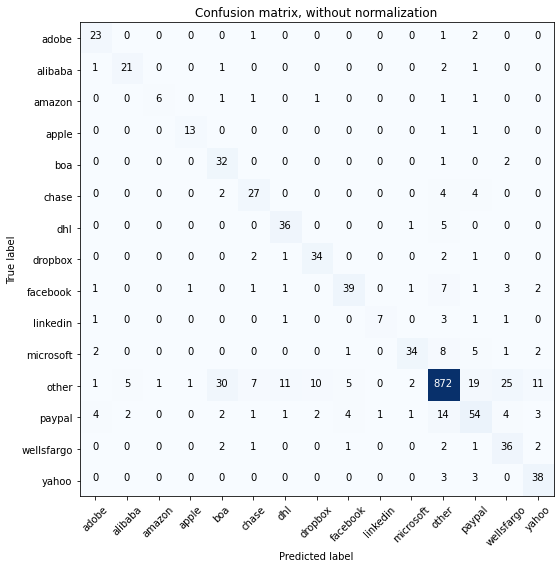

Acc     =  0.827
Pre     =  0.851
Rec     =  0.827
F1      =  0.833

Bal_Acc =  0.758
Bal_Pre =  0.728
Bal_Rec =  0.758
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.75      0.81      0.78        26
      amazon       0.86      0.55      0.67        11
       apple       0.87      0.87      0.87        15
         boa       0.46      0.91      0.61        35
       chase       0.66      0.73      0.69        37
         dhl       0.71      0.86      0.77        42
     dropbox       0.72      0.85      0.78        40
    facebook       0.78      0.68      0.73        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.87      0.64      0.74        53
       other       0.94      0.87      0.91      1000
      paypal       0.57      0.58      0.58        93
  wellsfargo       0.50      0.80      0.62        45
       yahoo       0.66      0.86      0.75        

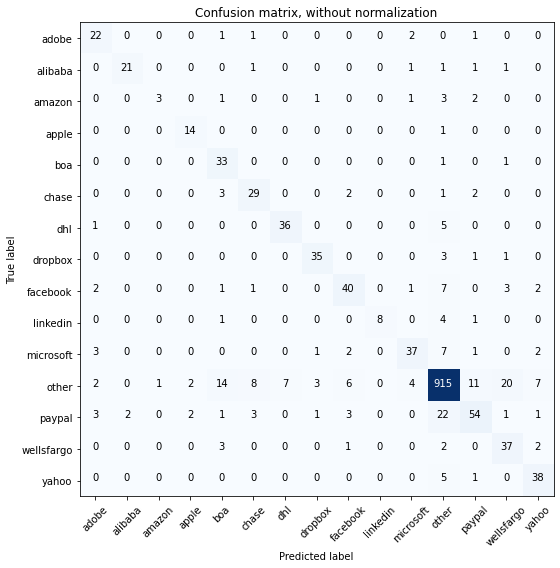

Acc     =  0.859
Pre     =  0.868
Rec     =  0.859
F1      =  0.859

Bal_Acc =  0.763
Bal_Pre =  0.77
Bal_Rec =  0.763
Bal_F1  =  0.766

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.75      0.27      0.40        11
       apple       0.78      0.93      0.85        15
         boa       0.57      0.94      0.71        35
       chase       0.67      0.78      0.72        37
         dhl       0.84      0.86      0.85        42
     dropbox       0.85      0.88      0.86        40
    facebook       0.74      0.70      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.70      0.75        53
       other       0.94      0.92      0.93      1000
      paypal       0.72      0.58      0.64        93
  wellsfargo       0.58      0.82      0.68        45
       yahoo       0.73      0.86      0.79        4

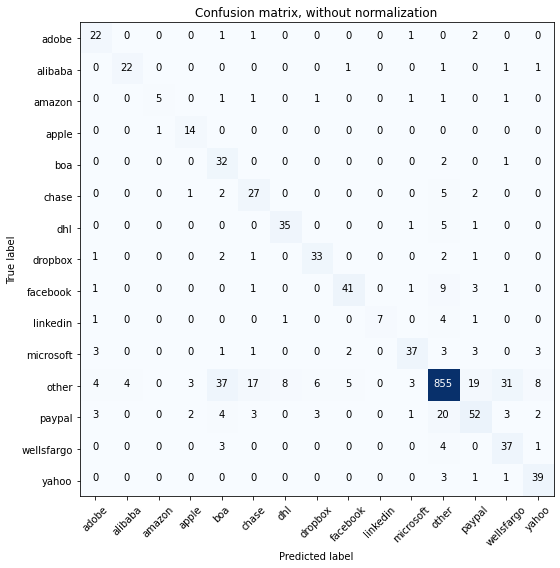

Acc     =  0.817
Pre     =  0.849
Rec     =  0.817
F1      =  0.826

Bal_Acc =  0.759
Bal_Pre =  0.726
Bal_Rec =  0.759
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.83      0.45      0.59        11
       apple       0.70      0.93      0.80        15
         boa       0.39      0.91      0.54        35
       chase       0.52      0.73      0.61        37
         dhl       0.80      0.83      0.81        42
     dropbox       0.77      0.82      0.80        40
    facebook       0.84      0.72      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.82      0.70      0.76        53
       other       0.94      0.85      0.89      1000
      paypal       0.61      0.56      0.58        93
  wellsfargo       0.49      0.82      0.61        45
       yahoo       0.72      0.89      0.80        

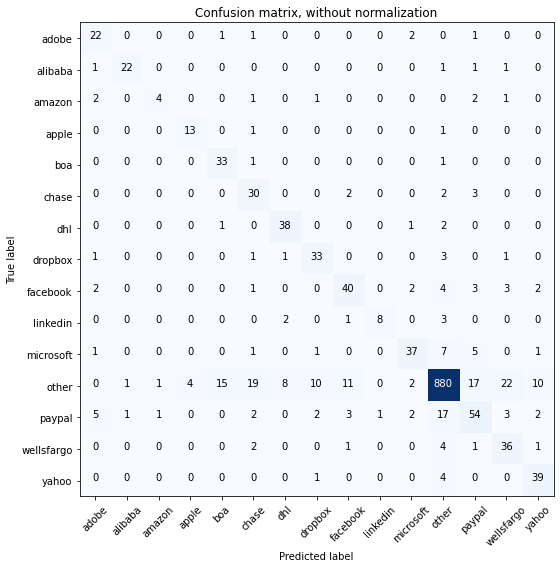

Acc     =  0.838
Pre     =  0.855
Rec     =  0.838
F1      =  0.842

Bal_Acc =  0.766
Bal_Pre =  0.721
Bal_Rec =  0.766
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.67      0.36      0.47        11
       apple       0.76      0.87      0.81        15
         boa       0.66      0.94      0.78        35
       chase       0.50      0.81      0.62        37
         dhl       0.78      0.90      0.84        42
     dropbox       0.69      0.82      0.75        40
    facebook       0.69      0.70      0.70        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.80      0.70      0.75        53
       other       0.95      0.88      0.91      1000
      paypal       0.62      0.58      0.60        93
  wellsfargo       0.54      0.80      0.64        45
       yahoo       0.71      0.89      0.79        

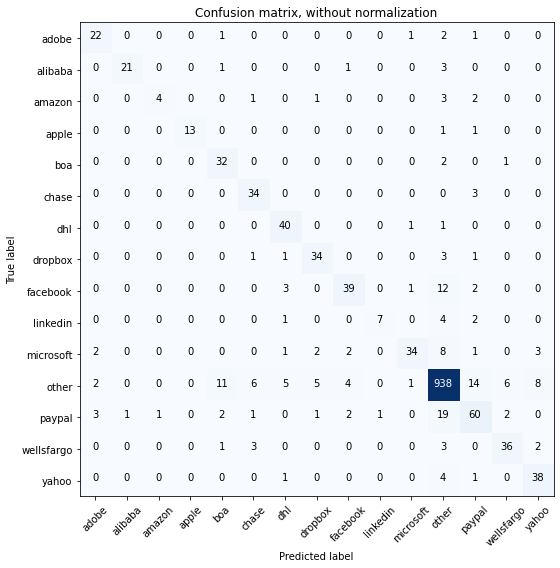

Acc     =  0.878
Pre     =  0.882
Rec     =  0.878
F1      =  0.877

Bal_Acc =  0.771
Bal_Pre =  0.815
Bal_Rec =  0.771
Bal_F1  =  0.792

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.80      0.36      0.50        11
       apple       1.00      0.87      0.93        15
         boa       0.67      0.91      0.77        35
       chase       0.74      0.92      0.82        37
         dhl       0.77      0.95      0.85        42
     dropbox       0.79      0.85      0.82        40
    facebook       0.81      0.68      0.74        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.89      0.64      0.75        53
       other       0.94      0.94      0.94      1000
      paypal       0.68      0.65      0.66        93
  wellsfargo       0.80      0.80      0.80        45
       yahoo       0.75      0.86      0.80        

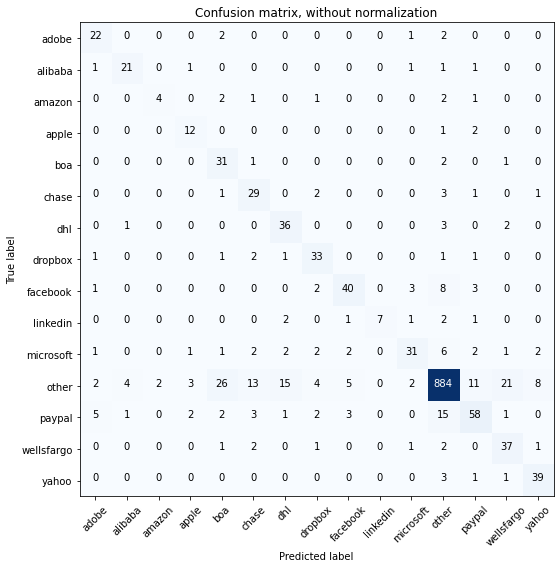

Acc     =  0.834
Pre     =  0.856
Rec     =  0.834
F1      =  0.839

Bal_Acc =  0.743
Bal_Pre =  0.709
Bal_Rec =  0.743
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.78      0.81      0.79        26
      amazon       0.67      0.36      0.47        11
       apple       0.63      0.80      0.71        15
         boa       0.46      0.89      0.61        35
       chase       0.55      0.78      0.64        37
         dhl       0.63      0.86      0.73        42
     dropbox       0.70      0.82      0.76        40
    facebook       0.78      0.70      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.78      0.58      0.67        53
       other       0.95      0.88      0.91      1000
      paypal       0.71      0.62      0.66        93
  wellsfargo       0.58      0.82      0.68        45
       yahoo       0.76      0.89      0.82        

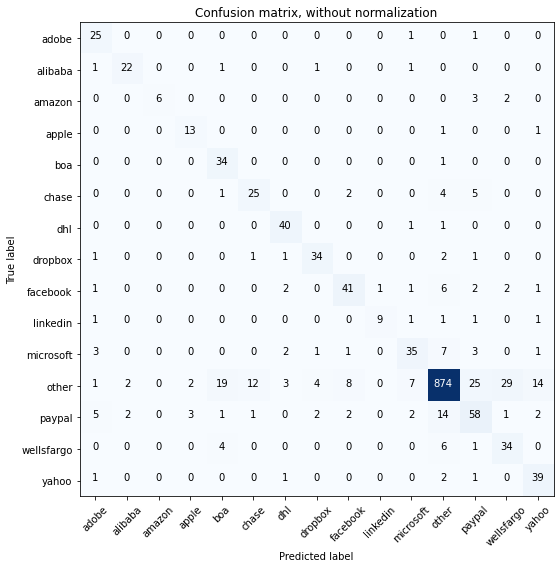

Acc     =  0.838
Pre     =  0.858
Rec     =  0.838
F1      =  0.843

Bal_Acc =  0.786
Bal_Pre =  0.74
Bal_Rec =  0.786
Bal_F1  =  0.762

              precision    recall  f1-score   support

       adobe       0.64      0.93      0.76        27
     alibaba       0.85      0.85      0.85        26
      amazon       1.00      0.55      0.71        11
       apple       0.72      0.87      0.79        15
         boa       0.57      0.97      0.72        35
       chase       0.64      0.68      0.66        37
         dhl       0.82      0.95      0.88        42
     dropbox       0.81      0.85      0.83        40
    facebook       0.76      0.72      0.74        57
    linkedin       0.90      0.64      0.75        14
   microsoft       0.71      0.66      0.69        53
       other       0.95      0.87      0.91      1000
      paypal       0.57      0.62      0.60        93
  wellsfargo       0.50      0.76      0.60        45
       yahoo       0.66      0.89      0.76        4

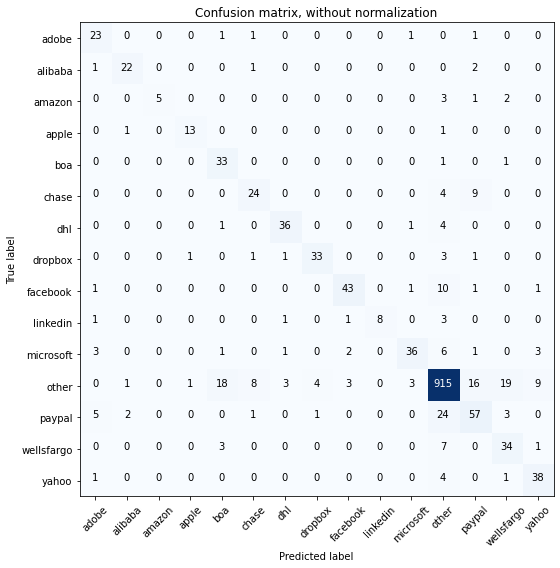

Acc     =  0.858
Pre     =  0.867
Rec     =  0.858
F1      =  0.859

Bal_Acc =  0.763
Bal_Pre =  0.796
Bal_Rec =  0.763
Bal_F1  =  0.779

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.85      0.85      0.85        26
      amazon       1.00      0.45      0.62        11
       apple       0.87      0.87      0.87        15
         boa       0.58      0.94      0.72        35
       chase       0.67      0.65      0.66        37
         dhl       0.86      0.86      0.86        42
     dropbox       0.87      0.82      0.85        40
    facebook       0.88      0.75      0.81        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.68      0.76        53
       other       0.93      0.92      0.92      1000
      paypal       0.64      0.61      0.63        93
  wellsfargo       0.57      0.76      0.65        45
       yahoo       0.73      0.86      0.79        

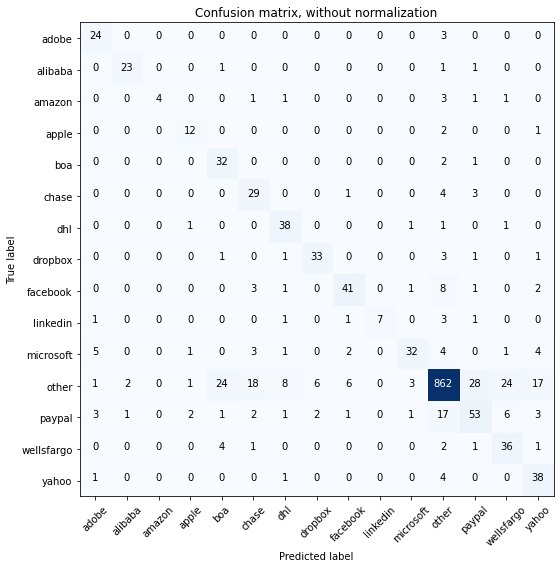

Acc     =  0.821
Pre     =  0.849
Rec     =  0.821
F1      =  0.827

Bal_Acc =  0.752
Bal_Pre =  0.737
Bal_Rec =  0.752
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.69      0.89      0.77        27
     alibaba       0.88      0.88      0.88        26
      amazon       1.00      0.36      0.53        11
       apple       0.71      0.80      0.75        15
         boa       0.51      0.91      0.65        35
       chase       0.51      0.78      0.62        37
         dhl       0.72      0.90      0.80        42
     dropbox       0.80      0.82      0.81        40
    facebook       0.79      0.72      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.60      0.70        53
       other       0.94      0.86      0.90      1000
      paypal       0.58      0.57      0.58        93
  wellsfargo       0.52      0.80      0.63        45
       yahoo       0.57      0.86      0.68        

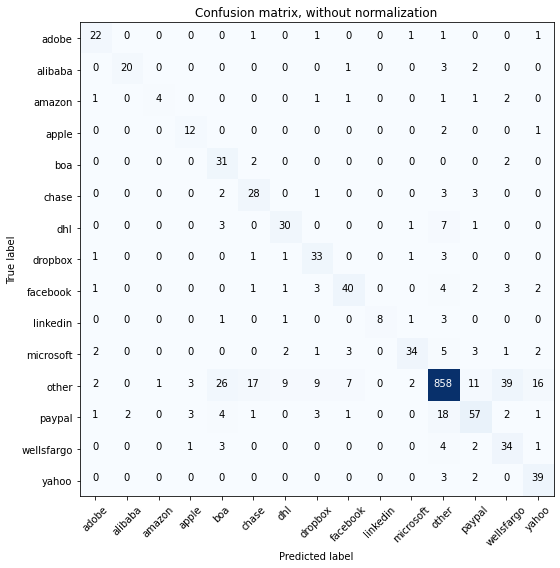

Acc     =  0.812
Pre     =  0.845
Rec     =  0.812
F1      =  0.821

Bal_Acc =  0.73
Bal_Pre =  0.709
Bal_Rec =  0.73
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.80      0.36      0.50        11
       apple       0.63      0.80      0.71        15
         boa       0.44      0.89      0.59        35
       chase       0.55      0.76      0.64        37
         dhl       0.68      0.71      0.70        42
     dropbox       0.63      0.82      0.72        40
    facebook       0.75      0.70      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.64      0.73        53
       other       0.94      0.86      0.90      1000
      paypal       0.68      0.61      0.64        93
  wellsfargo       0.41      0.76      0.53        45
       yahoo       0.62      0.89      0.73        44

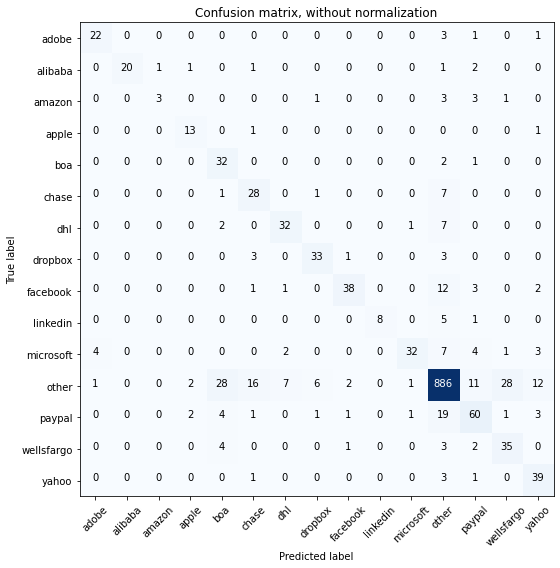

Acc     =  0.832
Pre     =  0.855
Rec     =  0.832
F1      =  0.837

Bal_Acc =  0.735
Bal_Pre =  0.759
Bal_Rec =  0.735
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.81      0.81      0.81        27
     alibaba       1.00      0.77      0.87        26
      amazon       0.75      0.27      0.40        11
       apple       0.72      0.87      0.79        15
         boa       0.45      0.91      0.60        35
       chase       0.54      0.76      0.63        37
         dhl       0.76      0.76      0.76        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.88      0.67      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.91      0.60      0.73        53
       other       0.92      0.89      0.90      1000
      paypal       0.67      0.65      0.66        93
  wellsfargo       0.53      0.78      0.63        45
       yahoo       0.64      0.89      0.74        

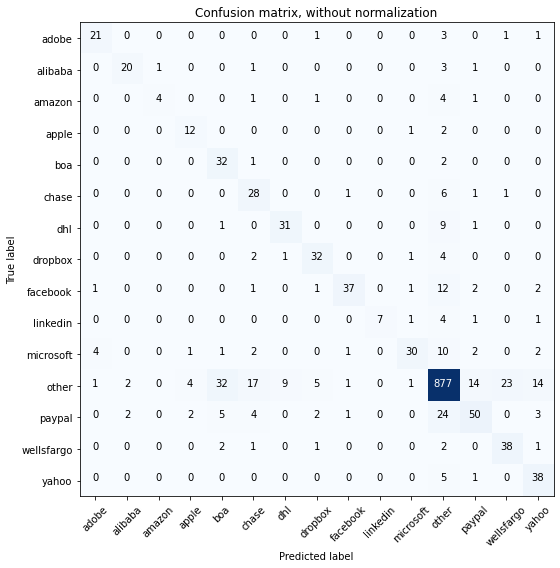

Acc     =  0.817
Pre     =  0.838
Rec     =  0.817
F1      =  0.82

Bal_Acc =  0.717
Bal_Pre =  0.735
Bal_Rec =  0.717
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.78      0.78      0.78        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.80      0.36      0.50        11
       apple       0.63      0.80      0.71        15
         boa       0.44      0.91      0.59        35
       chase       0.48      0.76      0.59        37
         dhl       0.76      0.74      0.75        42
     dropbox       0.74      0.80      0.77        40
    facebook       0.90      0.65      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.57      0.68        53
       other       0.91      0.88      0.89      1000
      paypal       0.68      0.54      0.60        93
  wellsfargo       0.60      0.84      0.70        45
       yahoo       0.61      0.86      0.72        4

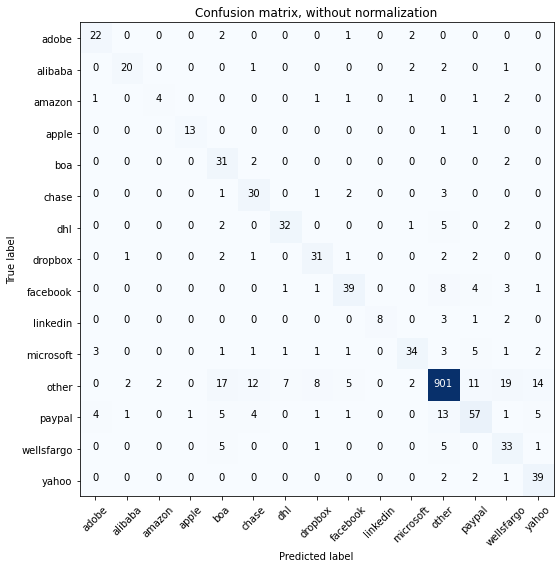

Acc     =  0.841
Pre     =  0.861
Rec     =  0.841
F1      =  0.846

Bal_Acc =  0.739
Bal_Pre =  0.734
Bal_Rec =  0.739
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.67      0.36      0.47        11
       apple       0.93      0.87      0.90        15
         boa       0.47      0.89      0.61        35
       chase       0.59      0.81      0.68        37
         dhl       0.78      0.76      0.77        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.76      0.68      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.81      0.64      0.72        53
       other       0.95      0.90      0.93      1000
      paypal       0.68      0.61      0.64        93
  wellsfargo       0.49      0.73      0.59        45
       yahoo       0.63      0.89      0.74        

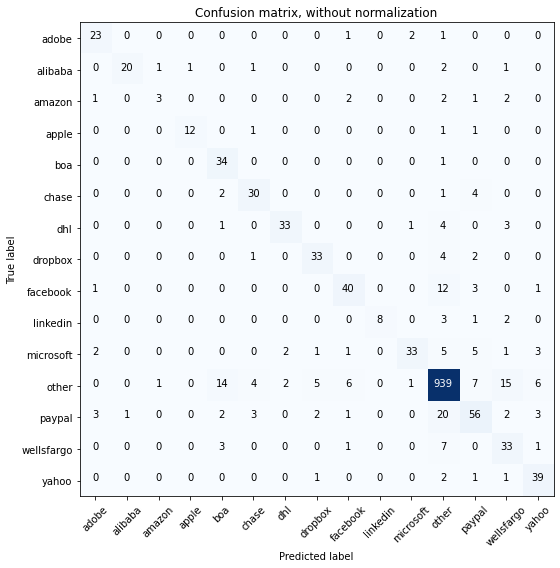

Acc     =  0.868
Pre     =  0.874
Rec     =  0.868
F1      =  0.867

Bal_Acc =  0.743
Bal_Pre =  0.79
Bal_Rec =  0.743
Bal_F1  =  0.766

              precision    recall  f1-score   support

       adobe       0.77      0.85      0.81        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.60      0.27      0.37        11
       apple       0.92      0.80      0.86        15
         boa       0.61      0.97      0.75        35
       chase       0.75      0.81      0.78        37
         dhl       0.89      0.79      0.84        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.77      0.70      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.62      0.73        53
       other       0.94      0.94      0.94      1000
      paypal       0.69      0.60      0.64        93
  wellsfargo       0.55      0.73      0.63        45
       yahoo       0.74      0.89      0.80        4

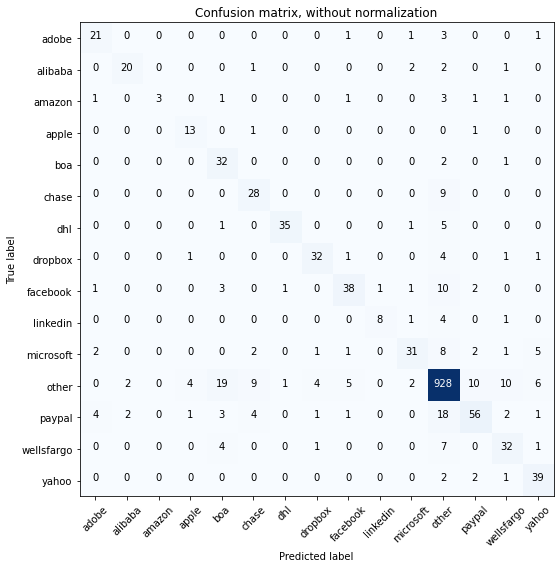

Acc     =  0.855
Pre     =  0.864
Rec     =  0.855
F1      =  0.854

Bal_Acc =  0.729
Bal_Pre =  0.776
Bal_Rec =  0.729
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        27
     alibaba       0.83      0.77      0.80        26
      amazon       1.00      0.27      0.43        11
       apple       0.68      0.87      0.76        15
         boa       0.51      0.91      0.65        35
       chase       0.62      0.76      0.68        37
         dhl       0.95      0.83      0.89        42
     dropbox       0.82      0.80      0.81        40
    facebook       0.79      0.67      0.72        57
    linkedin       0.89      0.57      0.70        14
   microsoft       0.79      0.58      0.67        53
       other       0.92      0.93      0.93      1000
      paypal       0.76      0.60      0.67        93
  wellsfargo       0.63      0.71      0.67        45
       yahoo       0.72      0.89      0.80        

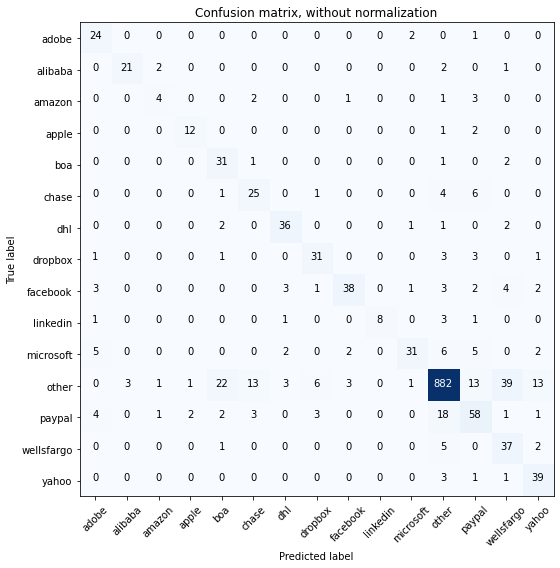

Acc     =  0.83
Pre     =  0.857
Rec     =  0.83
F1      =  0.836

Bal_Acc =  0.739
Bal_Pre =  0.719
Bal_Rec =  0.739
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.63      0.89      0.74        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.50      0.36      0.42        11
       apple       0.80      0.80      0.80        15
         boa       0.52      0.89      0.65        35
       chase       0.57      0.68      0.62        37
         dhl       0.80      0.86      0.83        42
     dropbox       0.74      0.78      0.76        40
    facebook       0.86      0.67      0.75        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.58      0.70        53
       other       0.95      0.88      0.91      1000
      paypal       0.61      0.62      0.62        93
  wellsfargo       0.43      0.82      0.56        45
       yahoo       0.65      0.89      0.75        44

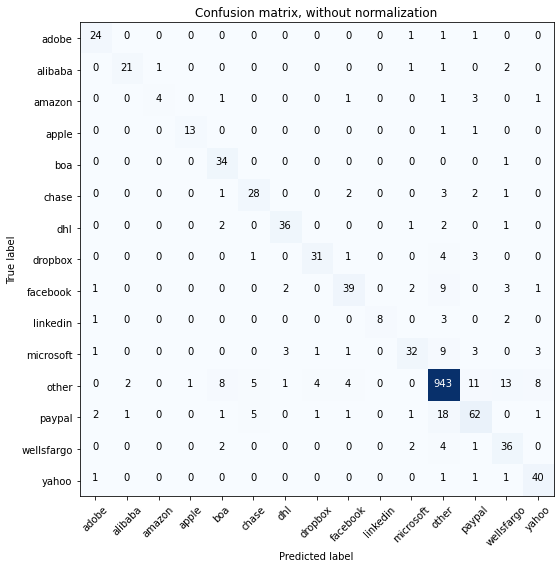

Acc     =  0.878
Pre     =  0.882
Rec     =  0.878
F1      =  0.877

Bal_Acc =  0.764
Bal_Pre =  0.806
Bal_Rec =  0.764
Bal_F1  =  0.784

              precision    recall  f1-score   support

       adobe       0.80      0.89      0.84        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.80      0.36      0.50        11
       apple       0.93      0.87      0.90        15
         boa       0.69      0.97      0.81        35
       chase       0.72      0.76      0.74        37
         dhl       0.86      0.86      0.86        42
     dropbox       0.84      0.78      0.81        40
    facebook       0.80      0.68      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.60      0.69        53
       other       0.94      0.94      0.94      1000
      paypal       0.70      0.67      0.69        93
  wellsfargo       0.60      0.80      0.69        45
       yahoo       0.74      0.91      0.82        

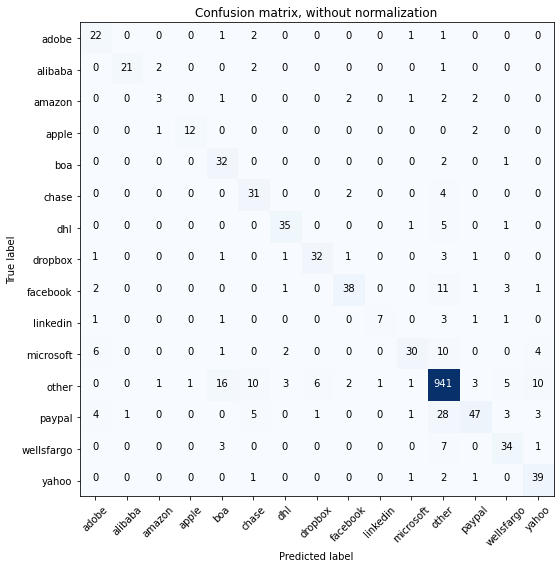

Acc     =  0.86
Pre     =  0.867
Rec     =  0.86
F1      =  0.857

Bal_Acc =  0.727
Bal_Pre =  0.761
Bal_Rec =  0.727
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.43      0.27      0.33        11
       apple       0.92      0.80      0.86        15
         boa       0.57      0.91      0.70        35
       chase       0.61      0.84      0.70        37
         dhl       0.83      0.83      0.83        42
     dropbox       0.82      0.80      0.81        40
    facebook       0.84      0.67      0.75        57
    linkedin       0.88      0.50      0.64        14
   microsoft       0.83      0.57      0.67        53
       other       0.92      0.94      0.93      1000
      paypal       0.81      0.51      0.62        93
  wellsfargo       0.71      0.76      0.73        45
       yahoo       0.67      0.89      0.76        44

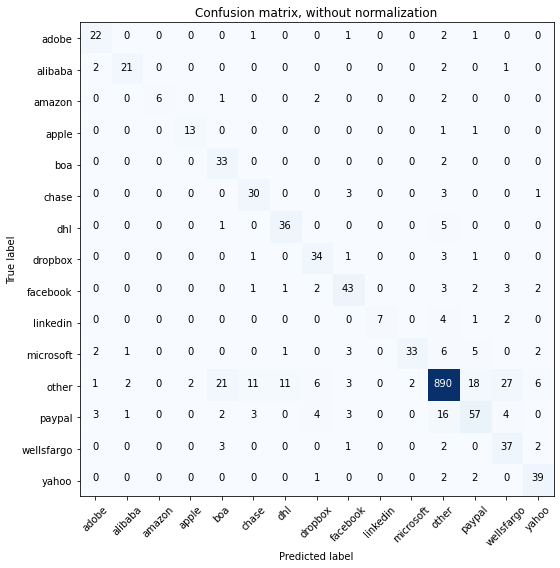

Acc     =  0.845
Pre     =  0.866
Rec     =  0.845
F1      =  0.85

Bal_Acc =  0.772
Bal_Pre =  0.772
Bal_Rec =  0.772
Bal_F1  =  0.772

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.84      0.81      0.82        26
      amazon       1.00      0.55      0.71        11
       apple       0.87      0.87      0.87        15
         boa       0.54      0.94      0.69        35
       chase       0.64      0.81      0.71        37
         dhl       0.73      0.86      0.79        42
     dropbox       0.69      0.85      0.76        40
    facebook       0.74      0.75      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.94      0.62      0.75        53
       other       0.94      0.89      0.92      1000
      paypal       0.65      0.61      0.63        93
  wellsfargo       0.50      0.82      0.62        45
       yahoo       0.75      0.89      0.81        4

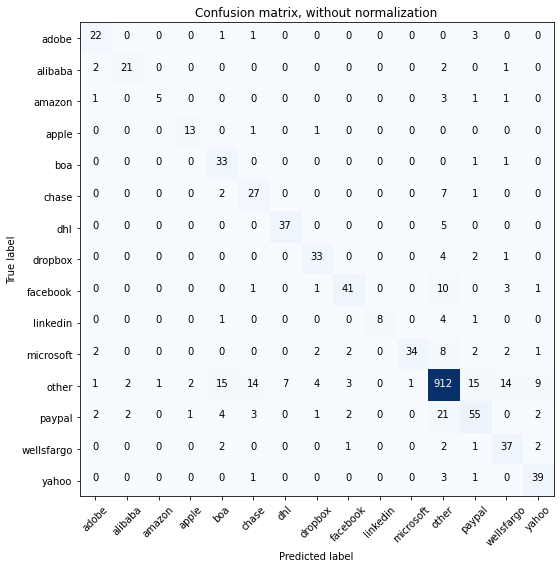

Acc     =  0.856
Pre     =  0.867
Rec     =  0.856
F1      =  0.857

Bal_Acc =  0.764
Bal_Pre =  0.781
Bal_Rec =  0.764
Bal_F1  =  0.772

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.83      0.45      0.59        11
       apple       0.81      0.87      0.84        15
         boa       0.57      0.94      0.71        35
       chase       0.56      0.73      0.64        37
         dhl       0.84      0.88      0.86        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.84      0.72      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.97      0.64      0.77        53
       other       0.93      0.91      0.92      1000
      paypal       0.66      0.59      0.62        93
  wellsfargo       0.62      0.82      0.70        45
       yahoo       0.72      0.89      0.80        

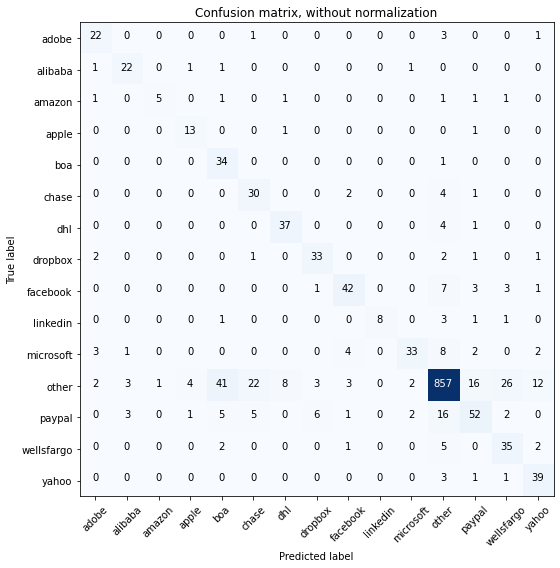

Acc     =  0.82
Pre     =  0.852
Rec     =  0.82
F1      =  0.828

Bal_Acc =  0.765
Bal_Pre =  0.725
Bal_Rec =  0.765
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.76      0.85      0.80        26
      amazon       0.83      0.45      0.59        11
       apple       0.68      0.87      0.76        15
         boa       0.40      0.97      0.57        35
       chase       0.51      0.81      0.62        37
         dhl       0.79      0.88      0.83        42
     dropbox       0.77      0.82      0.80        40
    facebook       0.79      0.74      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.86      0.90      1000
      paypal       0.65      0.56      0.60        93
  wellsfargo       0.51      0.78      0.61        45
       yahoo       0.67      0.89      0.76        44

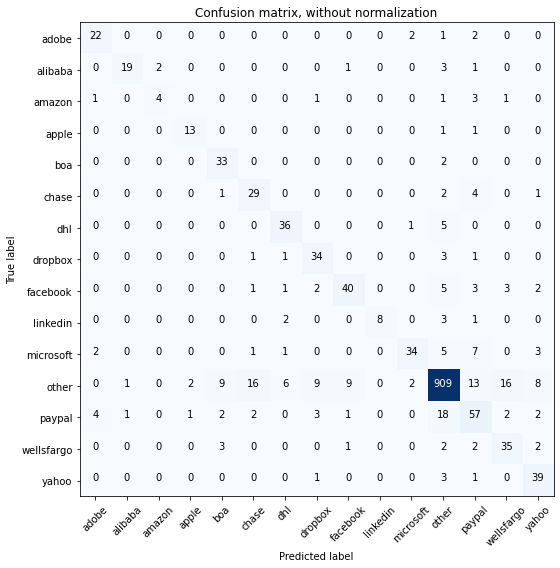

Acc     =  0.853
Pre     =  0.864
Rec     =  0.853
F1      =  0.854

Bal_Acc =  0.754
Bal_Pre =  0.756
Bal_Rec =  0.754
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.90      0.73      0.81        26
      amazon       0.67      0.36      0.47        11
       apple       0.81      0.87      0.84        15
         boa       0.69      0.94      0.80        35
       chase       0.58      0.78      0.67        37
         dhl       0.77      0.86      0.81        42
     dropbox       0.68      0.85      0.76        40
    facebook       0.77      0.70      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.87      0.64      0.74        53
       other       0.94      0.91      0.93      1000
      paypal       0.59      0.61      0.60        93
  wellsfargo       0.61      0.78      0.69        45
       yahoo       0.68      0.89      0.77        

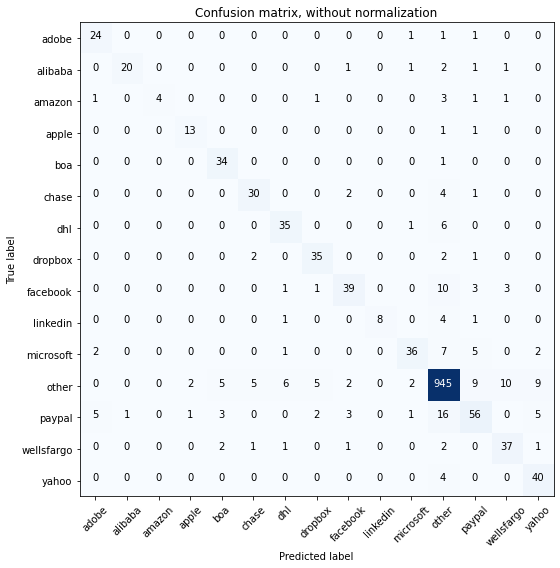

Acc     =  0.881
Pre     =  0.884
Rec     =  0.881
F1      =  0.879

Bal_Acc =  0.773
Bal_Pre =  0.825
Bal_Rec =  0.773
Bal_F1  =  0.798

              precision    recall  f1-score   support

       adobe       0.75      0.89      0.81        27
     alibaba       0.95      0.77      0.85        26
      amazon       1.00      0.36      0.53        11
       apple       0.81      0.87      0.84        15
         boa       0.77      0.97      0.86        35
       chase       0.79      0.81      0.80        37
         dhl       0.78      0.83      0.80        42
     dropbox       0.80      0.88      0.83        40
    facebook       0.81      0.68      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.68      0.76        53
       other       0.94      0.94      0.94      1000
      paypal       0.70      0.60      0.65        93
  wellsfargo       0.71      0.82      0.76        45
       yahoo       0.70      0.91      0.79        

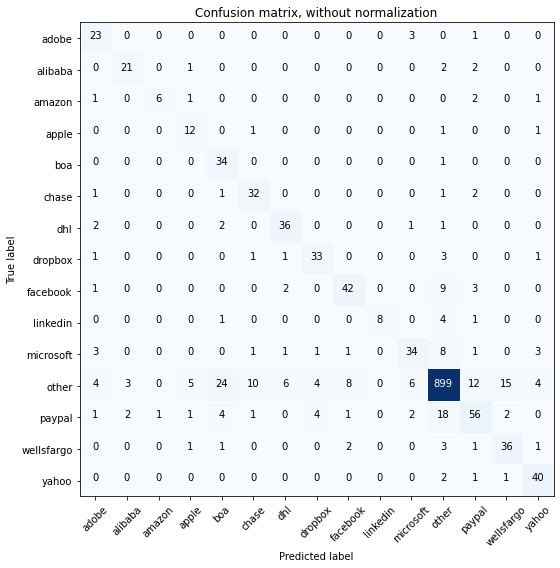

Acc     =  0.853
Pre     =  0.866
Rec     =  0.853
F1      =  0.855

Bal_Acc =  0.779
Bal_Pre =  0.748
Bal_Rec =  0.779
Bal_F1  =  0.763

              precision    recall  f1-score   support

       adobe       0.62      0.85      0.72        27
     alibaba       0.81      0.81      0.81        26
      amazon       0.86      0.55      0.67        11
       apple       0.57      0.80      0.67        15
         boa       0.51      0.97      0.67        35
       chase       0.70      0.86      0.77        37
         dhl       0.78      0.86      0.82        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.78      0.74      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.74      0.64      0.69        53
       other       0.94      0.90      0.92      1000
      paypal       0.68      0.60      0.64        93
  wellsfargo       0.67      0.80      0.73        45
       yahoo       0.78      0.91      0.84        

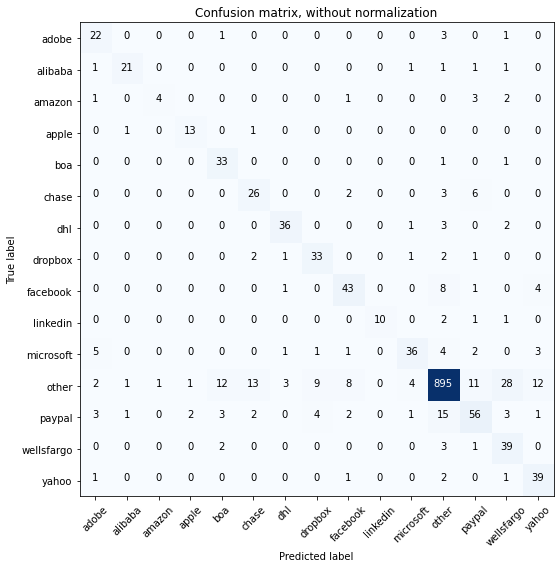

Acc     =  0.849
Pre     =  0.866
Rec     =  0.849
F1      =  0.853

Bal_Acc =  0.772
Bal_Pre =  0.75
Bal_Rec =  0.772
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.80      0.36      0.50        11
       apple       0.81      0.87      0.84        15
         boa       0.65      0.94      0.77        35
       chase       0.59      0.70      0.64        37
         dhl       0.86      0.86      0.86        42
     dropbox       0.70      0.82      0.76        40
    facebook       0.74      0.75      0.75        57
    linkedin       1.00      0.71      0.83        14
   microsoft       0.82      0.68      0.74        53
       other       0.95      0.90      0.92      1000
      paypal       0.67      0.60      0.64        93
  wellsfargo       0.49      0.87      0.63        45
       yahoo       0.66      0.89      0.76        4

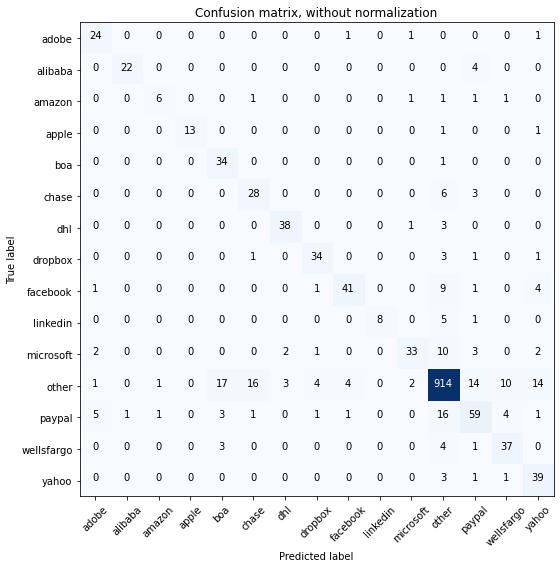

Acc     =  0.864
Pre     =  0.876
Rec     =  0.864
F1      =  0.866

Bal_Acc =  0.787
Bal_Pre =  0.8
Bal_Rec =  0.787
Bal_F1  =  0.793

              precision    recall  f1-score   support

       adobe       0.73      0.89      0.80        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.75      0.55      0.63        11
       apple       1.00      0.87      0.93        15
         boa       0.60      0.97      0.74        35
       chase       0.60      0.76      0.67        37
         dhl       0.88      0.90      0.89        42
     dropbox       0.83      0.85      0.84        40
    facebook       0.87      0.72      0.79        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.87      0.62      0.73        53
       other       0.94      0.91      0.93      1000
      paypal       0.66      0.63      0.65        93
  wellsfargo       0.70      0.82      0.76        45
       yahoo       0.62      0.89      0.73        44

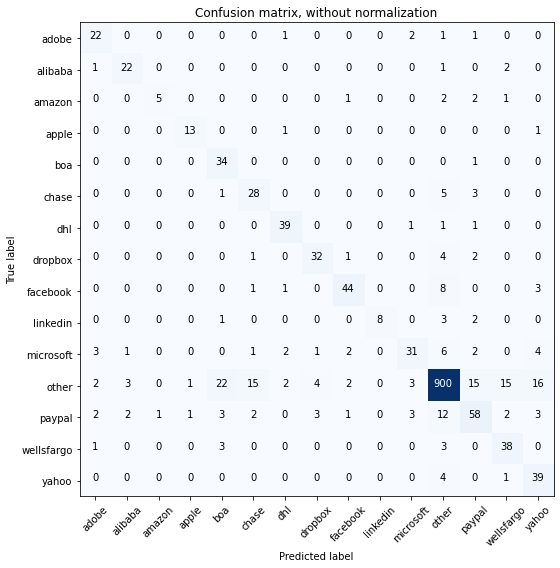

Acc     =  0.853
Pre     =  0.869
Rec     =  0.853
F1      =  0.856

Bal_Acc =  0.775
Bal_Pre =  0.763
Bal_Rec =  0.775
Bal_F1  =  0.769

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.79      0.85      0.81        26
      amazon       0.83      0.45      0.59        11
       apple       0.87      0.87      0.87        15
         boa       0.53      0.97      0.69        35
       chase       0.58      0.76      0.66        37
         dhl       0.85      0.93      0.89        42
     dropbox       0.80      0.80      0.80        40
    facebook       0.86      0.77      0.81        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.58      0.67        53
       other       0.95      0.90      0.92      1000
      paypal       0.67      0.62      0.64        93
  wellsfargo       0.64      0.84      0.73        45
       yahoo       0.59      0.89      0.71        

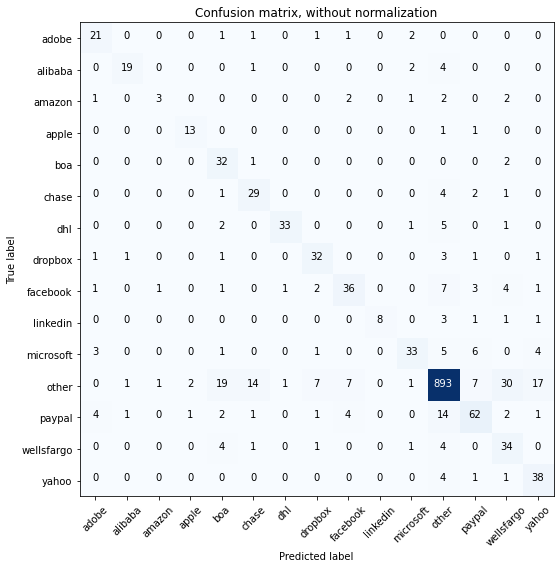

Acc     =  0.836
Pre     =  0.858
Rec     =  0.836
F1      =  0.841

Bal_Acc =  0.729
Bal_Pre =  0.73
Bal_Rec =  0.729
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        27
     alibaba       0.86      0.73      0.79        26
      amazon       0.60      0.27      0.37        11
       apple       0.81      0.87      0.84        15
         boa       0.50      0.91      0.65        35
       chase       0.60      0.78      0.68        37
         dhl       0.94      0.79      0.86        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.72      0.63      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.62      0.70        53
       other       0.94      0.89      0.92      1000
      paypal       0.74      0.67      0.70        93
  wellsfargo       0.44      0.76      0.55        45
       yahoo       0.60      0.86      0.71        4

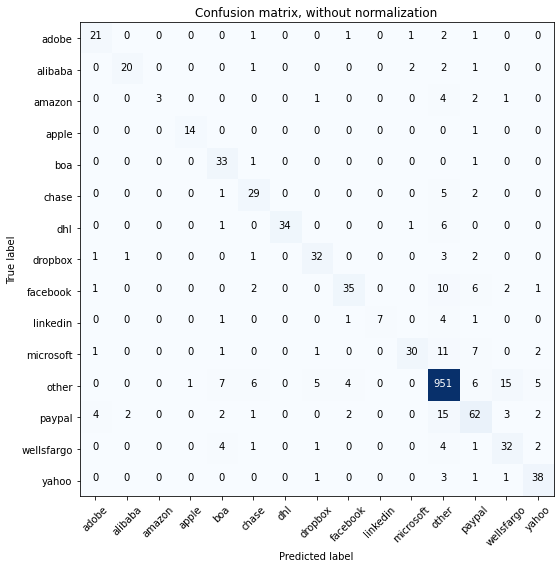

Acc     =  0.871
Pre     =  0.877
Rec     =  0.871
F1      =  0.869

Bal_Acc =  0.731
Bal_Pre =  0.821
Bal_Rec =  0.731
Bal_F1  =  0.773

              precision    recall  f1-score   support

       adobe       0.75      0.78      0.76        27
     alibaba       0.87      0.77      0.82        26
      amazon       1.00      0.27      0.43        11
       apple       0.93      0.93      0.93        15
         boa       0.66      0.94      0.78        35
       chase       0.67      0.78      0.72        37
         dhl       1.00      0.81      0.89        42
     dropbox       0.78      0.80      0.79        40
    facebook       0.81      0.61      0.70        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.88      0.57      0.69        53
       other       0.93      0.95      0.94      1000
      paypal       0.66      0.67      0.66        93
  wellsfargo       0.59      0.71      0.65        45
       yahoo       0.76      0.86      0.81        

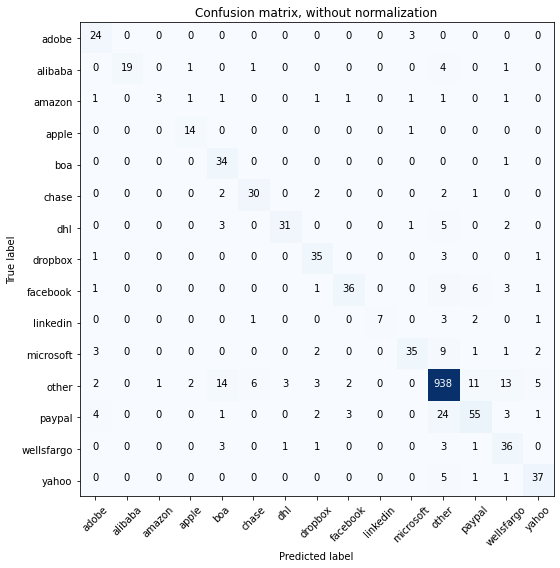

Acc     =  0.867
Pre     =  0.875
Rec     =  0.867
F1      =  0.865

Bal_Acc =  0.746
Bal_Pre =  0.793
Bal_Rec =  0.746
Bal_F1  =  0.769

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       1.00      0.73      0.84        26
      amazon       0.75      0.27      0.40        11
       apple       0.78      0.93      0.85        15
         boa       0.59      0.97      0.73        35
       chase       0.79      0.81      0.80        37
         dhl       0.89      0.74      0.81        42
     dropbox       0.74      0.88      0.80        40
    facebook       0.86      0.63      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.85      0.66      0.74        53
       other       0.93      0.94      0.94      1000
      paypal       0.71      0.59      0.64        93
  wellsfargo       0.58      0.80      0.67        45
       yahoo       0.77      0.84      0.80        

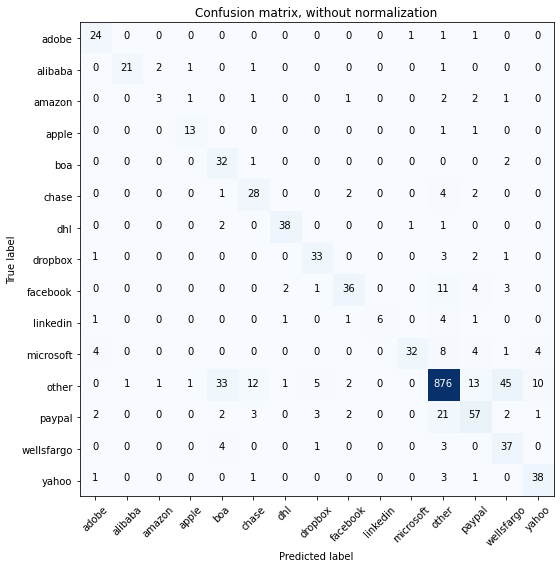

Acc     =  0.828
Pre     =  0.859
Rec     =  0.828
F1      =  0.835

Bal_Acc =  0.738
Bal_Pre =  0.744
Bal_Rec =  0.738
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.73      0.89      0.80        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.50      0.27      0.35        11
       apple       0.81      0.87      0.84        15
         boa       0.43      0.91      0.59        35
       chase       0.60      0.76      0.67        37
         dhl       0.90      0.90      0.90        42
     dropbox       0.77      0.82      0.80        40
    facebook       0.82      0.63      0.71        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.94      0.60      0.74        53
       other       0.93      0.88      0.90      1000
      paypal       0.65      0.61      0.63        93
  wellsfargo       0.40      0.82      0.54        45
       yahoo       0.72      0.86      0.78        

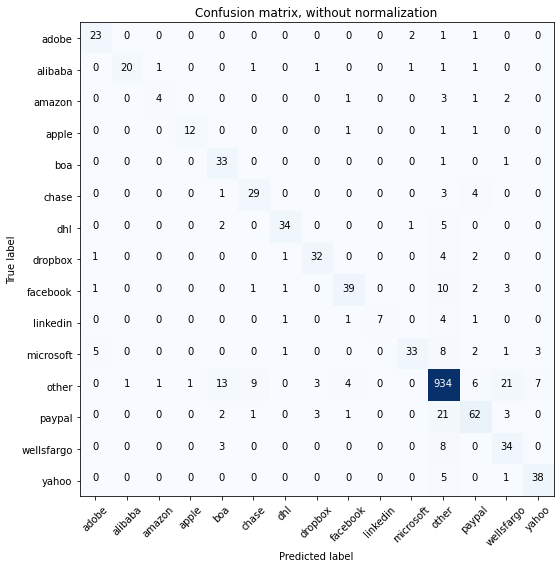

Acc     =  0.867
Pre     =  0.875
Rec     =  0.867
F1      =  0.867

Bal_Acc =  0.743
Bal_Pre =  0.803
Bal_Rec =  0.743
Bal_F1  =  0.772

              precision    recall  f1-score   support

       adobe       0.77      0.85      0.81        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.67      0.36      0.47        11
       apple       0.92      0.80      0.86        15
         boa       0.61      0.94      0.74        35
       chase       0.71      0.78      0.74        37
         dhl       0.89      0.81      0.85        42
     dropbox       0.82      0.80      0.81        40
    facebook       0.83      0.68      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.89      0.62      0.73        53
       other       0.93      0.93      0.93      1000
      paypal       0.75      0.67      0.70        93
  wellsfargo       0.52      0.76      0.61        45
       yahoo       0.79      0.86      0.83        

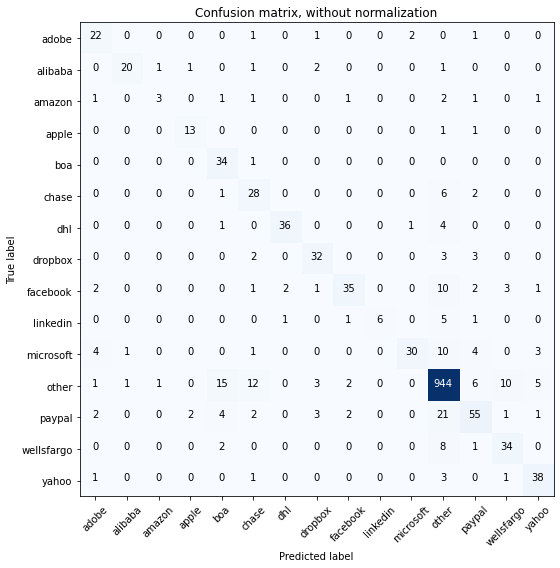

Acc     =  0.864
Pre     =  0.871
Rec     =  0.864
F1      =  0.862

Bal_Acc =  0.725
Bal_Pre =  0.779
Bal_Rec =  0.725
Bal_F1  =  0.751

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.60      0.27      0.37        11
       apple       0.81      0.87      0.84        15
         boa       0.59      0.97      0.73        35
       chase       0.55      0.76      0.64        37
         dhl       0.92      0.86      0.89        42
     dropbox       0.76      0.80      0.78        40
    facebook       0.85      0.61      0.71        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.91      0.57      0.70        53
       other       0.93      0.94      0.94      1000
      paypal       0.71      0.59      0.65        93
  wellsfargo       0.69      0.76      0.72        45
       yahoo       0.78      0.86      0.82        

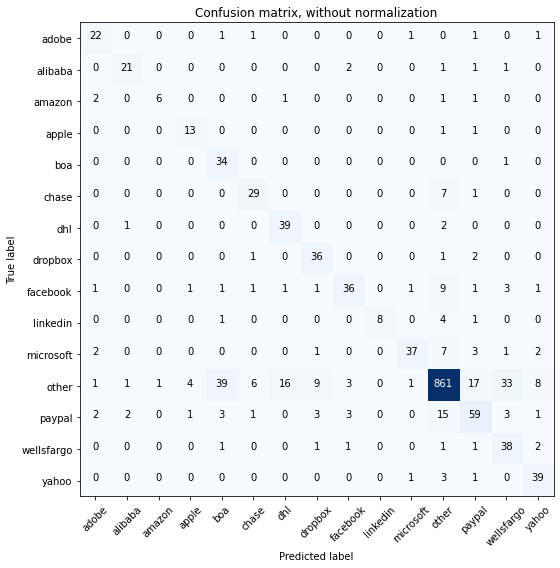

Acc     =  0.83
Pre     =  0.861
Rec     =  0.83
F1      =  0.838

Bal_Acc =  0.783
Bal_Pre =  0.745
Bal_Rec =  0.783
Bal_F1  =  0.764

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.86      0.55      0.67        11
       apple       0.68      0.87      0.76        15
         boa       0.42      0.97      0.59        35
       chase       0.74      0.78      0.76        37
         dhl       0.68      0.93      0.79        42
     dropbox       0.71      0.90      0.79        40
    facebook       0.80      0.63      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.90      0.70      0.79        53
       other       0.94      0.86      0.90      1000
      paypal       0.66      0.63      0.64        93
  wellsfargo       0.47      0.84      0.61        45
       yahoo       0.72      0.89      0.80        44

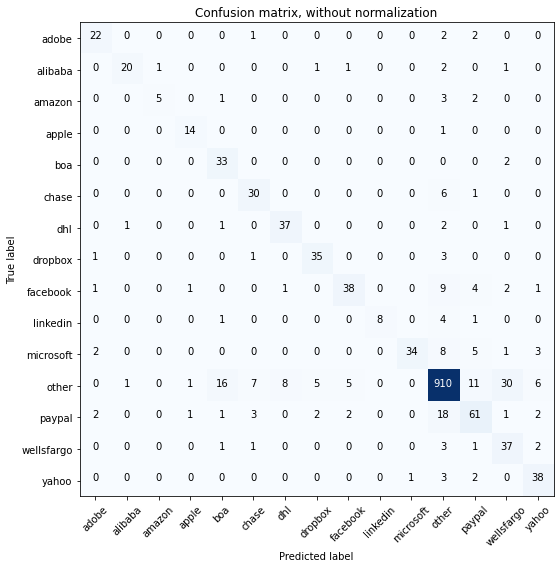

Acc     =  0.859
Pre     =  0.873
Rec     =  0.859
F1      =  0.861

Bal_Acc =  0.774
Bal_Pre =  0.794
Bal_Rec =  0.774
Bal_F1  =  0.784

              precision    recall  f1-score   support

       adobe       0.79      0.81      0.80        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.83      0.45      0.59        11
       apple       0.82      0.93      0.87        15
         boa       0.61      0.94      0.74        35
       chase       0.70      0.81      0.75        37
         dhl       0.80      0.88      0.84        42
     dropbox       0.81      0.88      0.84        40
    facebook       0.83      0.67      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.97      0.64      0.77        53
       other       0.93      0.91      0.92      1000
      paypal       0.68      0.66      0.67        93
  wellsfargo       0.49      0.82      0.62        45
       yahoo       0.73      0.86      0.79        

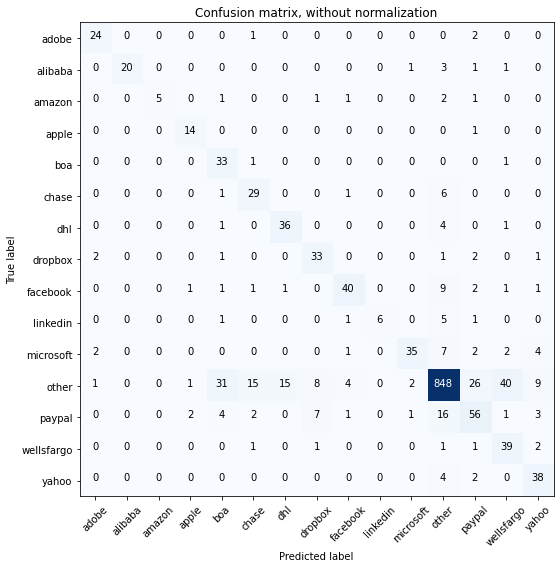

Acc     =  0.816
Pre     =  0.852
Rec     =  0.816
F1      =  0.824

Bal_Acc =  0.762
Bal_Pre =  0.755
Bal_Rec =  0.762
Bal_F1  =  0.758

              precision    recall  f1-score   support

       adobe       0.83      0.89      0.86        27
     alibaba       1.00      0.77      0.87        26
      amazon       1.00      0.45      0.62        11
       apple       0.78      0.93      0.85        15
         boa       0.45      0.94      0.61        35
       chase       0.58      0.78      0.67        37
         dhl       0.69      0.86      0.77        42
     dropbox       0.66      0.82      0.73        40
    facebook       0.82      0.70      0.75        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.90      0.66      0.76        53
       other       0.94      0.85      0.89      1000
      paypal       0.58      0.60      0.59        93
  wellsfargo       0.45      0.87      0.60        45
       yahoo       0.66      0.86      0.75        

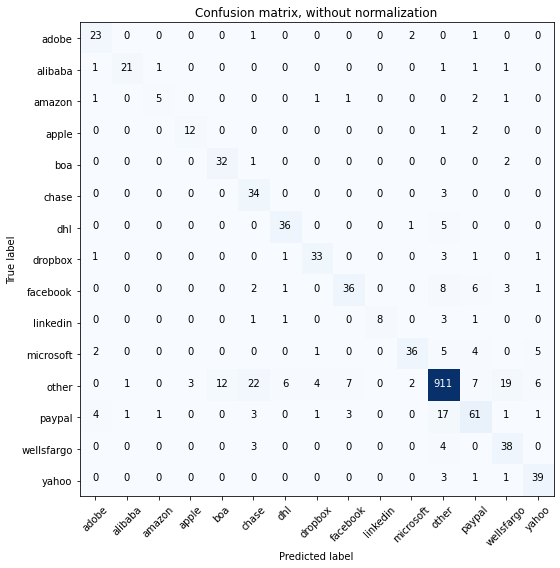

Acc     =  0.861
Pre     =  0.875
Rec     =  0.861
F1      =  0.863

Bal_Acc =  0.774
Bal_Pre =  0.774
Bal_Rec =  0.774
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.71      0.45      0.56        11
       apple       0.80      0.80      0.80        15
         boa       0.73      0.91      0.81        35
       chase       0.51      0.92      0.65        37
         dhl       0.80      0.86      0.83        42
     dropbox       0.82      0.82      0.82        40
    facebook       0.77      0.63      0.69        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.88      0.68      0.77        53
       other       0.95      0.91      0.93      1000
      paypal       0.70      0.66      0.68        93
  wellsfargo       0.58      0.84      0.68        45
       yahoo       0.74      0.89      0.80        

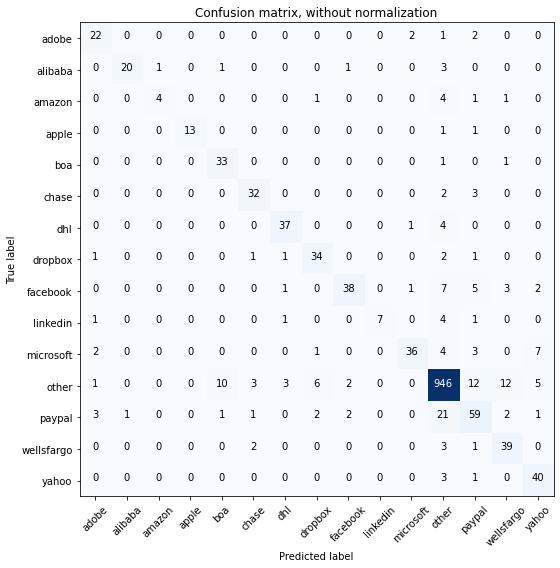

Acc     =  0.884
Pre     =  0.888
Rec     =  0.884
F1      =  0.882

Bal_Acc =  0.77
Bal_Pre =  0.83
Bal_Rec =  0.77
Bal_F1  =  0.799

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.80      0.36      0.50        11
       apple       1.00      0.87      0.93        15
         boa       0.73      0.94      0.83        35
       chase       0.82      0.86      0.84        37
         dhl       0.86      0.88      0.87        42
     dropbox       0.77      0.85      0.81        40
    facebook       0.88      0.67      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.90      0.68      0.77        53
       other       0.94      0.95      0.94      1000
      paypal       0.66      0.63      0.64        93
  wellsfargo       0.67      0.87      0.76        45
       yahoo       0.73      0.91      0.81        44


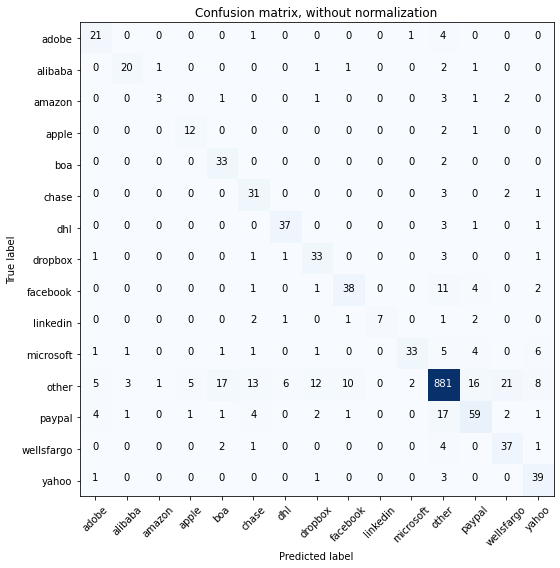

Acc     =  0.834
Pre     =  0.852
Rec     =  0.834
F1      =  0.837

Bal_Acc =  0.741
Bal_Pre =  0.721
Bal_Rec =  0.741
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        27
     alibaba       0.80      0.77      0.78        26
      amazon       0.60      0.27      0.37        11
       apple       0.67      0.80      0.73        15
         boa       0.60      0.94      0.73        35
       chase       0.56      0.84      0.67        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.63      0.82      0.72        40
    facebook       0.75      0.67      0.70        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.92      0.62      0.74        53
       other       0.93      0.88      0.91      1000
      paypal       0.66      0.63      0.65        93
  wellsfargo       0.58      0.82      0.68        45
       yahoo       0.65      0.89      0.75        

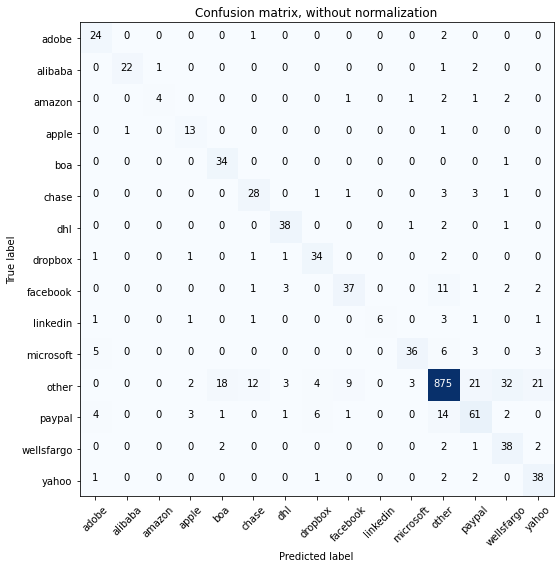

Acc     =  0.837
Pre     =  0.861
Rec     =  0.837
F1      =  0.842

Bal_Acc =  0.763
Bal_Pre =  0.744
Bal_Rec =  0.763
Bal_F1  =  0.753

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.80      0.36      0.50        11
       apple       0.65      0.87      0.74        15
         boa       0.62      0.97      0.76        35
       chase       0.64      0.76      0.69        37
         dhl       0.83      0.90      0.86        42
     dropbox       0.74      0.85      0.79        40
    facebook       0.76      0.65      0.70        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.88      0.68      0.77        53
       other       0.94      0.88      0.91      1000
      paypal       0.64      0.66      0.65        93
  wellsfargo       0.48      0.84      0.61        45
       yahoo       0.57      0.86      0.68        

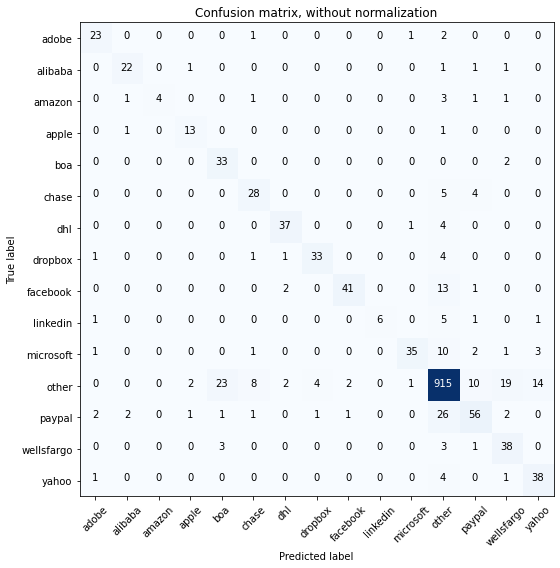

Acc     =  0.859
Pre     =  0.871
Rec     =  0.859
F1      =  0.859

Bal_Acc =  0.758
Bal_Pre =  0.81
Bal_Rec =  0.758
Bal_F1  =  0.783

              precision    recall  f1-score   support

       adobe       0.79      0.85      0.82        27
     alibaba       0.85      0.85      0.85        26
      amazon       1.00      0.36      0.53        11
       apple       0.76      0.87      0.81        15
         boa       0.55      0.94      0.69        35
       chase       0.68      0.76      0.72        37
         dhl       0.88      0.88      0.88        42
     dropbox       0.87      0.82      0.85        40
    facebook       0.93      0.72      0.81        57
    linkedin       1.00      0.43      0.60        14
   microsoft       0.92      0.66      0.77        53
       other       0.92      0.92      0.92      1000
      paypal       0.73      0.60      0.66        93
  wellsfargo       0.58      0.84      0.69        45
       yahoo       0.68      0.86      0.76        4

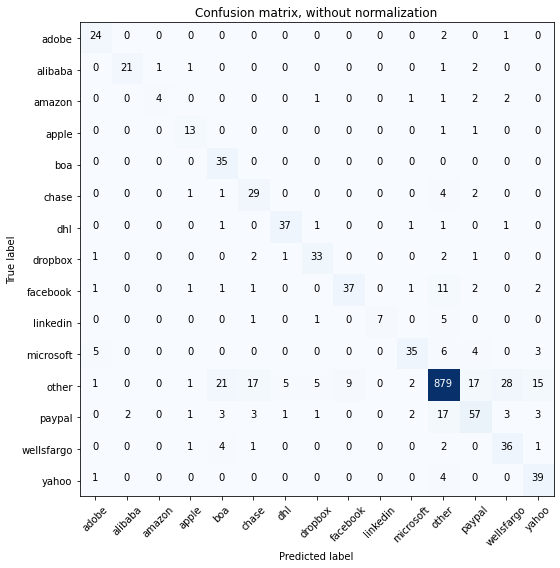

Acc     =  0.836
Pre     =  0.858
Rec     =  0.836
F1      =  0.84

Bal_Acc =  0.76
Bal_Pre =  0.745
Bal_Rec =  0.76
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.73      0.89      0.80        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.68      0.87      0.76        15
         boa       0.53      1.00      0.69        35
       chase       0.54      0.78      0.64        37
         dhl       0.84      0.88      0.86        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.80      0.65      0.72        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.83      0.66      0.74        53
       other       0.94      0.88      0.91      1000
      paypal       0.65      0.61      0.63        93
  wellsfargo       0.51      0.80      0.62        45
       yahoo       0.62      0.89      0.73        44


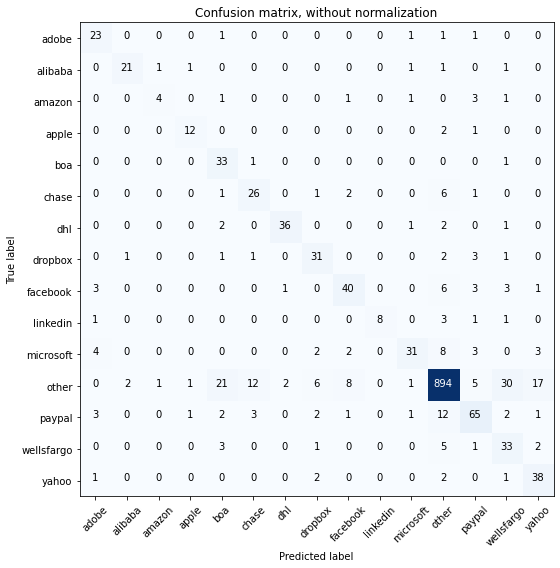

Acc     =  0.841
Pre     =  0.864
Rec     =  0.841
F1      =  0.847

Bal_Acc =  0.743
Bal_Pre =  0.737
Bal_Rec =  0.743
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.80      0.80      0.80        15
         boa       0.51      0.94      0.66        35
       chase       0.60      0.70      0.65        37
         dhl       0.92      0.86      0.89        42
     dropbox       0.69      0.78      0.73        40
    facebook       0.74      0.70      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.58      0.69        53
       other       0.95      0.89      0.92      1000
      paypal       0.75      0.70      0.72        93
  wellsfargo       0.44      0.73      0.55        45
       yahoo       0.61      0.86      0.72        4

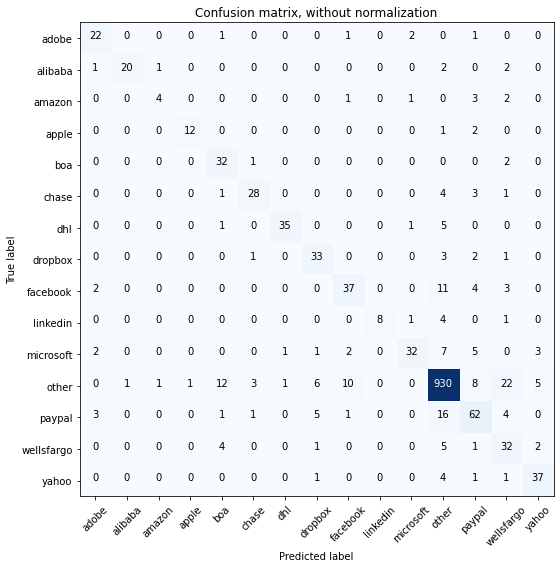

Acc     =  0.86
Pre     =  0.871
Rec     =  0.86
F1      =  0.862

Bal_Acc =  0.737
Bal_Pre =  0.786
Bal_Rec =  0.737
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        27
     alibaba       0.95      0.77      0.85        26
      amazon       0.67      0.36      0.47        11
       apple       0.92      0.80      0.86        15
         boa       0.62      0.91      0.74        35
       chase       0.82      0.76      0.79        37
         dhl       0.95      0.83      0.89        42
     dropbox       0.70      0.82      0.76        40
    facebook       0.71      0.65      0.68        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.86      0.60      0.71        53
       other       0.94      0.93      0.93      1000
      paypal       0.67      0.67      0.67        93
  wellsfargo       0.45      0.71      0.55        45
       yahoo       0.79      0.84      0.81        44

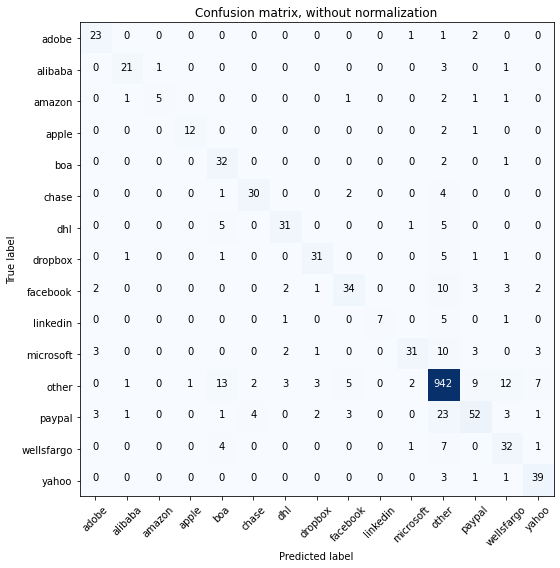

Acc     =  0.859
Pre     =  0.863
Rec     =  0.859
F1      =  0.856

Bal_Acc =  0.729
Bal_Pre =  0.793
Bal_Rec =  0.729
Bal_F1  =  0.76

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.83      0.45      0.59        11
       apple       0.92      0.80      0.86        15
         boa       0.56      0.91      0.70        35
       chase       0.83      0.81      0.82        37
         dhl       0.79      0.74      0.77        42
     dropbox       0.82      0.78      0.79        40
    facebook       0.76      0.60      0.67        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.86      0.58      0.70        53
       other       0.92      0.94      0.93      1000
      paypal       0.71      0.56      0.63        93
  wellsfargo       0.57      0.71      0.63        45
       yahoo       0.74      0.89      0.80        4

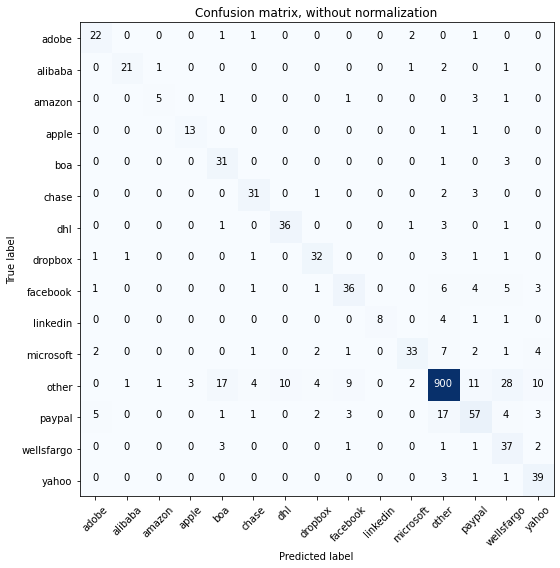

Acc     =  0.845
Pre     =  0.865
Rec     =  0.845
F1      =  0.85

Bal_Acc =  0.758
Bal_Pre =  0.752
Bal_Rec =  0.758
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.71      0.45      0.56        11
       apple       0.81      0.87      0.84        15
         boa       0.56      0.89      0.69        35
       chase       0.78      0.84      0.81        37
         dhl       0.78      0.86      0.82        42
     dropbox       0.76      0.80      0.78        40
    facebook       0.71      0.63      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.62      0.72        53
       other       0.95      0.90      0.92      1000
      paypal       0.66      0.61      0.64        93
  wellsfargo       0.44      0.82      0.57        45
       yahoo       0.64      0.89      0.74        4

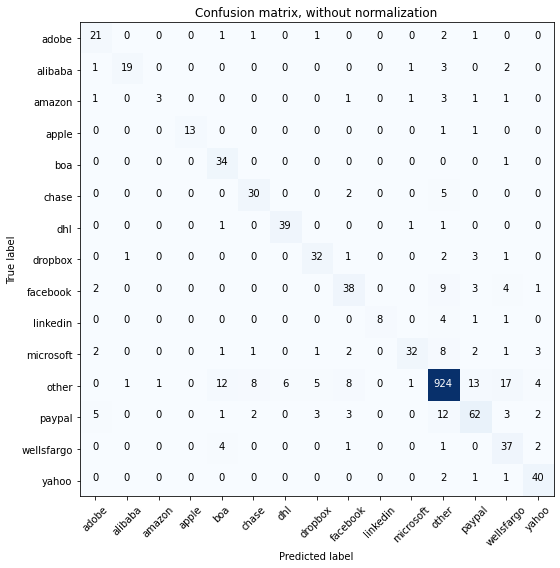

Acc     =  0.865
Pre     =  0.876
Rec     =  0.865
F1      =  0.866

Bal_Acc =  0.755
Bal_Pre =  0.787
Bal_Rec =  0.755
Bal_F1  =  0.771

              precision    recall  f1-score   support

       adobe       0.66      0.78      0.71        27
     alibaba       0.90      0.73      0.81        26
      amazon       0.75      0.27      0.40        11
       apple       1.00      0.87      0.93        15
         boa       0.63      0.97      0.76        35
       chase       0.71      0.81      0.76        37
         dhl       0.87      0.93      0.90        42
     dropbox       0.76      0.80      0.78        40
    facebook       0.68      0.67      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.60      0.72        53
       other       0.95      0.92      0.93      1000
      paypal       0.70      0.67      0.69        93
  wellsfargo       0.54      0.82      0.65        45
       yahoo       0.77      0.91      0.83        

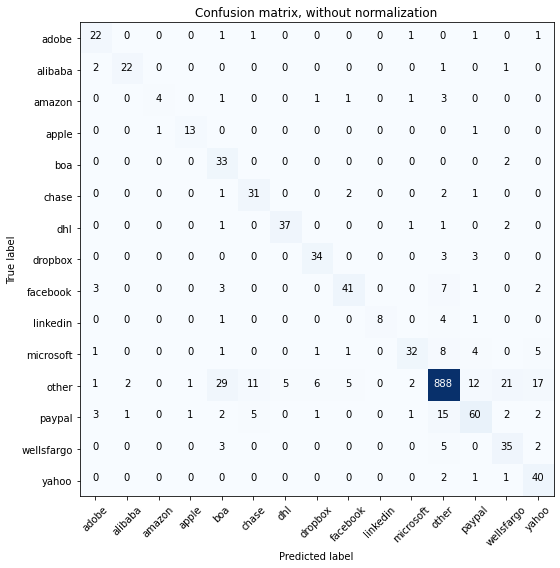

Acc     =  0.845
Pre     =  0.869
Rec     =  0.845
F1      =  0.85

Bal_Acc =  0.768
Bal_Pre =  0.762
Bal_Rec =  0.768
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.88      0.85      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.87      0.87      0.87        15
         boa       0.43      0.94      0.59        35
       chase       0.65      0.84      0.73        37
         dhl       0.88      0.88      0.88        42
     dropbox       0.79      0.85      0.82        40
    facebook       0.82      0.72      0.77        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.84      0.60      0.70        53
       other       0.95      0.89      0.92      1000
      paypal       0.71      0.65      0.67        93
  wellsfargo       0.55      0.78      0.64        45
       yahoo       0.58      0.91      0.71        4

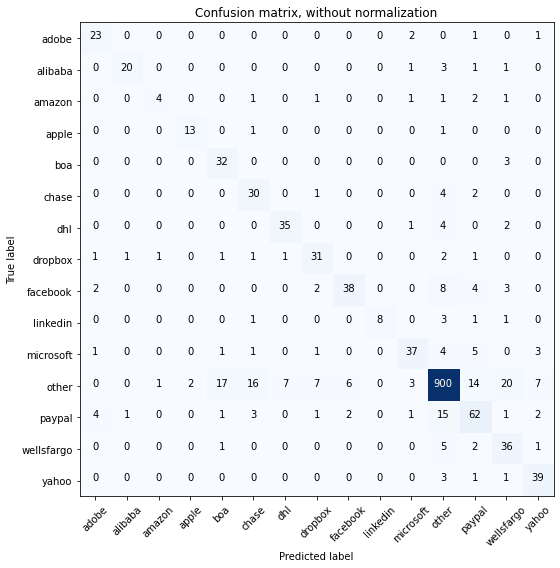

Acc     =  0.85
Pre     =  0.866
Rec     =  0.85
F1      =  0.854

Bal_Acc =  0.758
Bal_Pre =  0.756
Bal_Rec =  0.758
Bal_F1  =  0.757

              precision    recall  f1-score   support

       adobe       0.74      0.85      0.79        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.67      0.36      0.47        11
       apple       0.87      0.87      0.87        15
         boa       0.60      0.91      0.73        35
       chase       0.56      0.81      0.66        37
         dhl       0.81      0.83      0.82        42
     dropbox       0.70      0.78      0.74        40
    facebook       0.83      0.67      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.80      0.70      0.75        53
       other       0.94      0.90      0.92      1000
      paypal       0.65      0.67      0.66        93
  wellsfargo       0.52      0.80      0.63        45
       yahoo       0.74      0.89      0.80        44

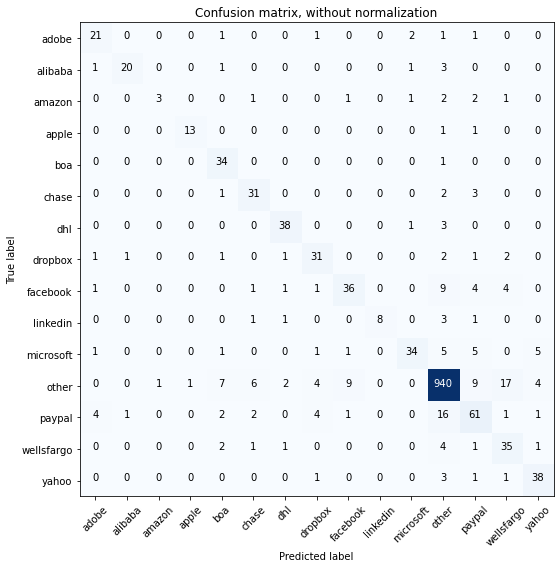

Acc     =  0.873
Pre     =  0.878
Rec     =  0.873
F1      =  0.872

Bal_Acc =  0.75
Bal_Pre =  0.793
Bal_Rec =  0.75
Bal_F1  =  0.771

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.75      0.27      0.40        11
       apple       0.93      0.87      0.90        15
         boa       0.68      0.97      0.80        35
       chase       0.72      0.84      0.77        37
         dhl       0.86      0.90      0.88        42
     dropbox       0.72      0.78      0.75        40
    facebook       0.75      0.63      0.69        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.87      0.64      0.74        53
       other       0.94      0.94      0.94      1000
      paypal       0.68      0.66      0.67        93
  wellsfargo       0.57      0.78      0.66        45
       yahoo       0.78      0.86      0.82        44

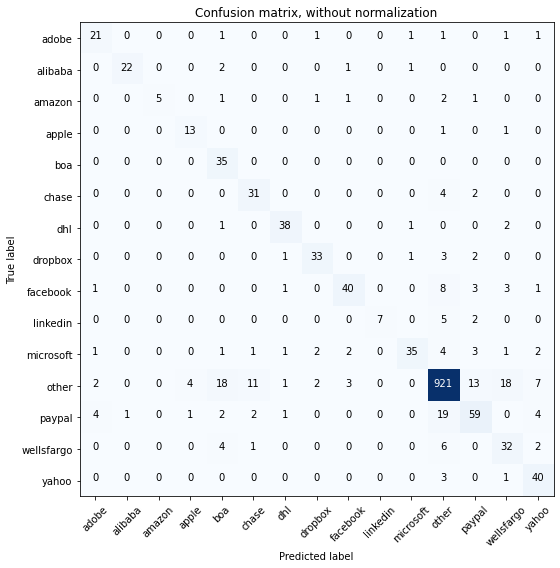

Acc     =  0.865
Pre     =  0.88
Rec     =  0.865
F1      =  0.867

Bal_Acc =  0.77
Bal_Pre =  0.798
Bal_Rec =  0.77
Bal_F1  =  0.784

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        27
     alibaba       0.96      0.85      0.90        26
      amazon       1.00      0.45      0.62        11
       apple       0.72      0.87      0.79        15
         boa       0.54      1.00      0.70        35
       chase       0.67      0.84      0.75        37
         dhl       0.88      0.90      0.89        42
     dropbox       0.85      0.82      0.84        40
    facebook       0.85      0.70      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.90      0.66      0.76        53
       other       0.94      0.92      0.93      1000
      paypal       0.69      0.63      0.66        93
  wellsfargo       0.54      0.71      0.62        45
       yahoo       0.70      0.91      0.79        44


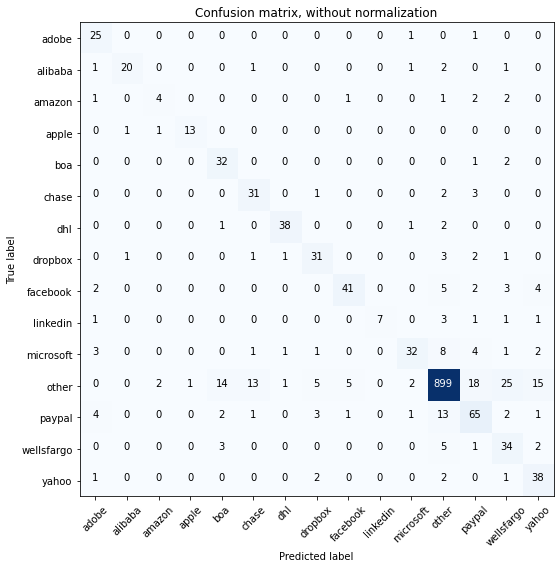

Acc     =  0.851
Pre     =  0.872
Rec     =  0.851
F1      =  0.856

Bal_Acc =  0.76
Bal_Pre =  0.756
Bal_Rec =  0.76
Bal_F1  =  0.758

              precision    recall  f1-score   support

       adobe       0.66      0.93      0.77        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.57      0.36      0.44        11
       apple       0.93      0.87      0.90        15
         boa       0.62      0.91      0.74        35
       chase       0.65      0.84      0.73        37
         dhl       0.93      0.90      0.92        42
     dropbox       0.72      0.78      0.75        40
    facebook       0.85      0.72      0.78        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.84      0.60      0.70        53
       other       0.95      0.90      0.92      1000
      paypal       0.65      0.70      0.67        93
  wellsfargo       0.47      0.76      0.58        45
       yahoo       0.60      0.86      0.71        44

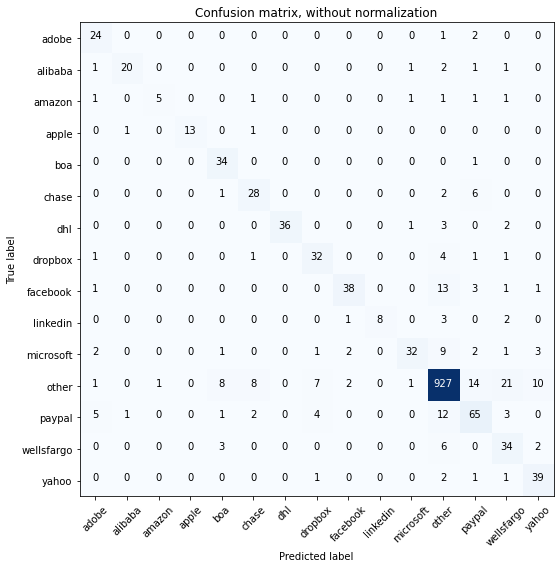

Acc     =  0.867
Pre     =  0.88
Rec     =  0.867
F1      =  0.869

Bal_Acc =  0.765
Bal_Pre =  0.807
Bal_Rec =  0.765
Bal_F1  =  0.785

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.91      0.77      0.83        26
      amazon       0.83      0.45      0.59        11
       apple       1.00      0.87      0.93        15
         boa       0.71      0.97      0.82        35
       chase       0.68      0.76      0.72        37
         dhl       1.00      0.86      0.92        42
     dropbox       0.71      0.80      0.75        40
    facebook       0.88      0.67      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.60      0.72        53
       other       0.94      0.93      0.93      1000
      paypal       0.67      0.70      0.68        93
  wellsfargo       0.50      0.76      0.60        45
       yahoo       0.71      0.89      0.79        4

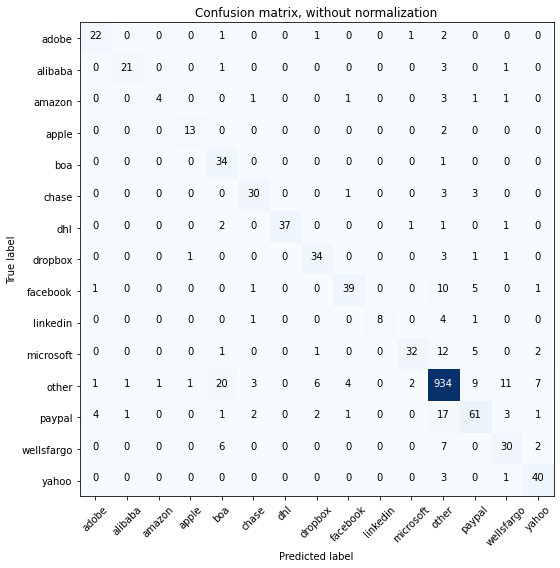

Acc     =  0.87
Pre     =  0.879
Rec     =  0.87
F1      =  0.87

Bal_Acc =  0.759
Bal_Pre =  0.812
Bal_Rec =  0.759
Bal_F1  =  0.785

              precision    recall  f1-score   support

       adobe       0.79      0.81      0.80        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.80      0.36      0.50        11
       apple       0.87      0.87      0.87        15
         boa       0.52      0.97      0.67        35
       chase       0.79      0.81      0.80        37
         dhl       1.00      0.88      0.94        42
     dropbox       0.77      0.85      0.81        40
    facebook       0.85      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.89      0.60      0.72        53
       other       0.93      0.93      0.93      1000
      paypal       0.71      0.66      0.68        93
  wellsfargo       0.61      0.67      0.64        45
       yahoo       0.75      0.91      0.82        44


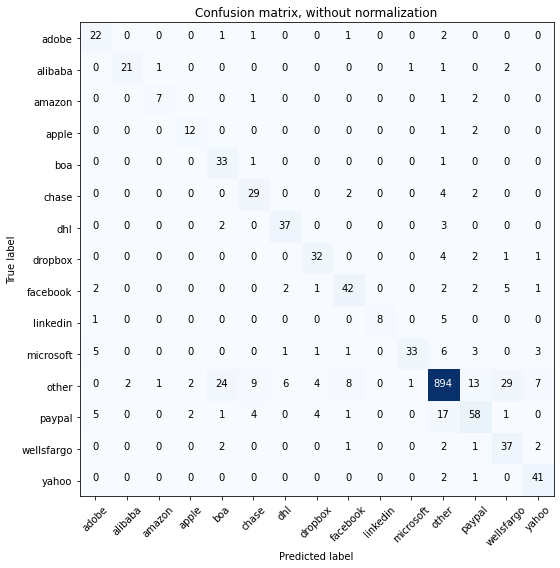

Acc     =  0.849
Pre     =  0.869
Rec     =  0.849
F1      =  0.853

Bal_Acc =  0.778
Bal_Pre =  0.757
Bal_Rec =  0.778
Bal_F1  =  0.767

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.78      0.64      0.70        11
       apple       0.75      0.80      0.77        15
         boa       0.52      0.94      0.67        35
       chase       0.64      0.78      0.71        37
         dhl       0.80      0.88      0.84        42
     dropbox       0.76      0.80      0.78        40
    facebook       0.75      0.74      0.74        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.94      0.62      0.75        53
       other       0.95      0.89      0.92      1000
      paypal       0.67      0.62      0.65        93
  wellsfargo       0.49      0.82      0.62        45
       yahoo       0.75      0.93      0.83        

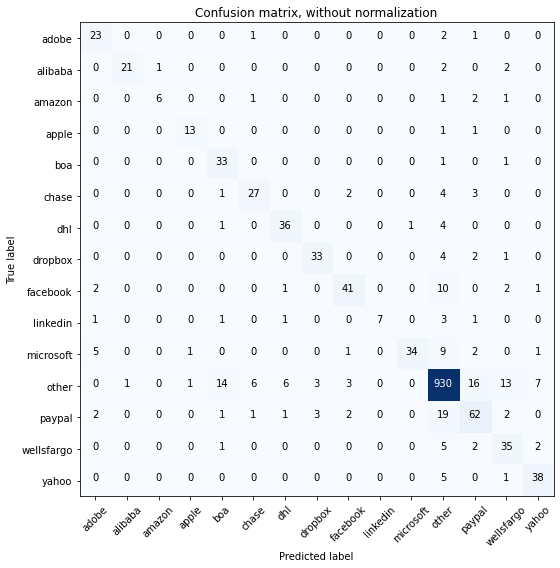

Acc     =  0.87
Pre     =  0.878
Rec     =  0.87
F1      =  0.87

Bal_Acc =  0.768
Bal_Pre =  0.813
Bal_Rec =  0.768
Bal_F1  =  0.79

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       0.95      0.81      0.88        26
      amazon       0.86      0.55      0.67        11
       apple       0.87      0.87      0.87        15
         boa       0.63      0.94      0.76        35
       chase       0.75      0.73      0.74        37
         dhl       0.80      0.86      0.83        42
     dropbox       0.85      0.82      0.84        40
    facebook       0.84      0.72      0.77        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.97      0.64      0.77        53
       other       0.93      0.93      0.93      1000
      paypal       0.67      0.67      0.67        93
  wellsfargo       0.60      0.78      0.68        45
       yahoo       0.78      0.86      0.82        44



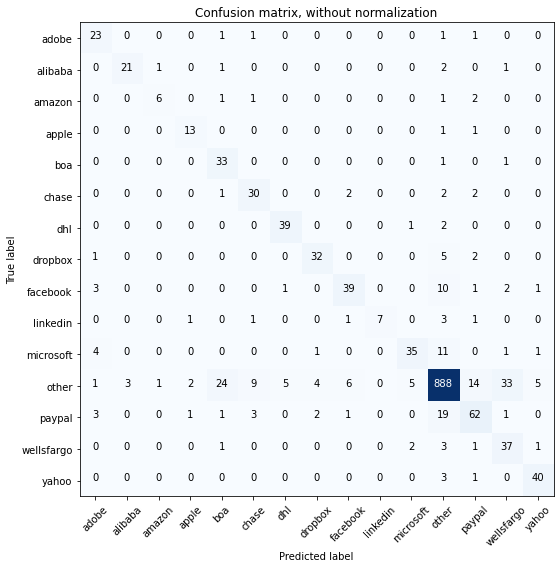

Acc     =  0.848
Pre     =  0.865
Rec     =  0.848
F1      =  0.852

Bal_Acc =  0.779
Bal_Pre =  0.766
Bal_Rec =  0.779
Bal_F1  =  0.772

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.75      0.55      0.63        11
       apple       0.76      0.87      0.81        15
         boa       0.52      0.94      0.67        35
       chase       0.67      0.81      0.73        37
         dhl       0.87      0.93      0.90        42
     dropbox       0.82      0.80      0.81        40
    facebook       0.80      0.68      0.74        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.81      0.66      0.73        53
       other       0.93      0.89      0.91      1000
      paypal       0.70      0.67      0.69        93
  wellsfargo       0.49      0.82      0.61        45
       yahoo       0.83      0.91      0.87        

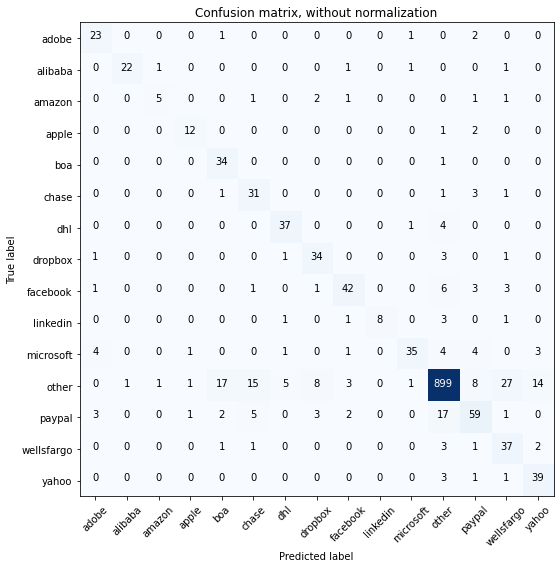

Acc     =  0.856
Pre     =  0.875
Rec     =  0.856
F1      =  0.86

Bal_Acc =  0.78
Bal_Pre =  0.763
Bal_Rec =  0.78
Bal_F1  =  0.771

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.96      0.85      0.90        26
      amazon       0.71      0.45      0.56        11
       apple       0.80      0.80      0.80        15
         boa       0.61      0.97      0.75        35
       chase       0.57      0.84      0.68        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.71      0.85      0.77        40
    facebook       0.82      0.74      0.78        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.90      0.66      0.76        53
       other       0.95      0.90      0.92      1000
      paypal       0.70      0.63      0.67        93
  wellsfargo       0.50      0.82      0.62        45
       yahoo       0.67      0.89      0.76        44


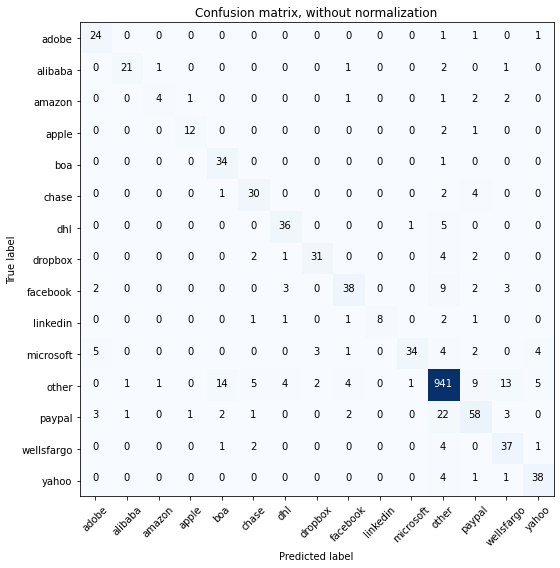

Acc     =  0.875
Pre     =  0.88
Rec     =  0.875
F1      =  0.874

Bal_Acc =  0.76
Bal_Pre =  0.797
Bal_Rec =  0.76
Bal_F1  =  0.778

              precision    recall  f1-score   support

       adobe       0.71      0.89      0.79        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.67      0.36      0.47        11
       apple       0.86      0.80      0.83        15
         boa       0.65      0.97      0.78        35
       chase       0.73      0.81      0.77        37
         dhl       0.80      0.86      0.83        42
     dropbox       0.86      0.78      0.82        40
    facebook       0.79      0.67      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.94      0.64      0.76        53
       other       0.94      0.94      0.94      1000
      paypal       0.70      0.62      0.66        93
  wellsfargo       0.62      0.82      0.70        45
       yahoo       0.78      0.86      0.82        44


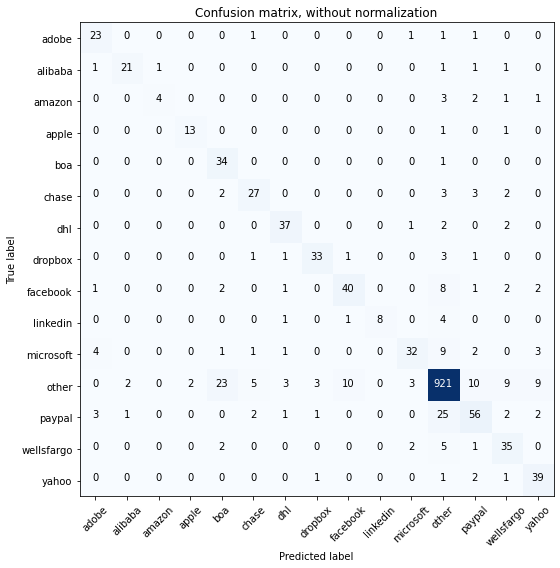

Acc     =  0.86
Pre     =  0.868
Rec     =  0.86
F1      =  0.86

Bal_Acc =  0.757
Bal_Pre =  0.784
Bal_Rec =  0.757
Bal_F1  =  0.77

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.80      0.36      0.50        11
       apple       0.87      0.87      0.87        15
         boa       0.53      0.97      0.69        35
       chase       0.73      0.73      0.73        37
         dhl       0.82      0.88      0.85        42
     dropbox       0.87      0.82      0.85        40
    facebook       0.77      0.70      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.60      0.70        53
       other       0.93      0.92      0.93      1000
      paypal       0.70      0.60      0.65        93
  wellsfargo       0.62      0.78      0.69        45
       yahoo       0.70      0.89      0.78        44



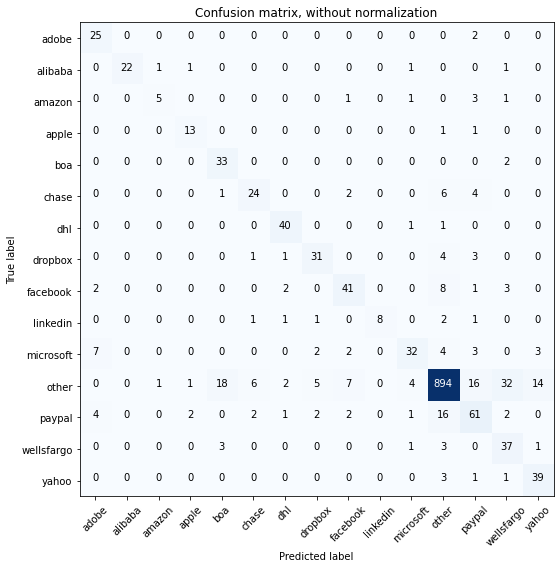

Acc     =  0.848
Pre     =  0.866
Rec     =  0.848
F1      =  0.852

Bal_Acc =  0.771
Bal_Pre =  0.754
Bal_Rec =  0.771
Bal_F1  =  0.762

              precision    recall  f1-score   support

       adobe       0.66      0.93      0.77        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.71      0.45      0.56        11
       apple       0.76      0.87      0.81        15
         boa       0.60      0.94      0.73        35
       chase       0.71      0.65      0.68        37
         dhl       0.85      0.95      0.90        42
     dropbox       0.76      0.78      0.77        40
    facebook       0.75      0.72      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.78      0.60      0.68        53
       other       0.95      0.89      0.92      1000
      paypal       0.64      0.66      0.65        93
  wellsfargo       0.47      0.82      0.60        45
       yahoo       0.68      0.89      0.77        

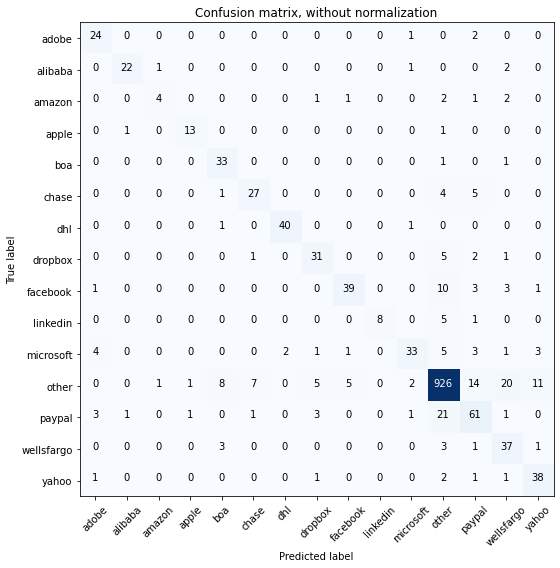

Acc     =  0.868
Pre     =  0.876
Rec     =  0.868
F1      =  0.869

Bal_Acc =  0.767
Bal_Pre =  0.791
Bal_Rec =  0.767
Bal_F1  =  0.779

              precision    recall  f1-score   support

       adobe       0.73      0.89      0.80        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.67      0.36      0.47        11
       apple       0.87      0.87      0.87        15
         boa       0.72      0.94      0.81        35
       chase       0.75      0.73      0.74        37
         dhl       0.95      0.95      0.95        42
     dropbox       0.74      0.78      0.76        40
    facebook       0.85      0.68      0.76        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.62      0.72        53
       other       0.94      0.93      0.93      1000
      paypal       0.65      0.66      0.65        93
  wellsfargo       0.54      0.82      0.65        45
       yahoo       0.70      0.86      0.78        

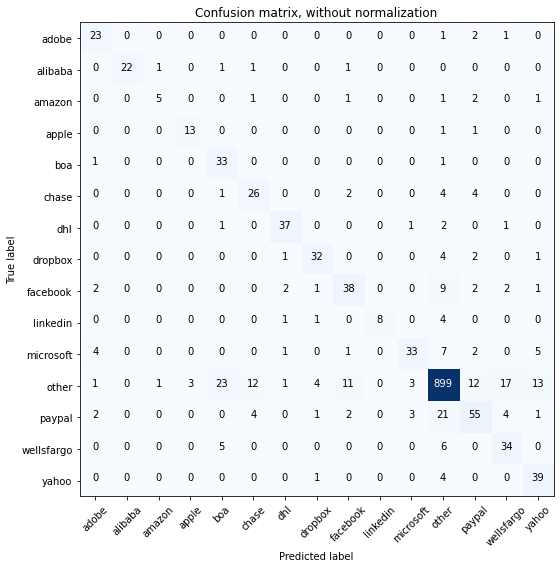

Acc     =  0.843
Pre     =  0.857
Rec     =  0.843
F1      =  0.845

Bal_Acc =  0.756
Bal_Pre =  0.754
Bal_Rec =  0.756
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        27
     alibaba       1.00      0.85      0.92        26
      amazon       0.71      0.45      0.56        11
       apple       0.81      0.87      0.84        15
         boa       0.52      0.94      0.67        35
       chase       0.59      0.70      0.64        37
         dhl       0.86      0.88      0.87        42
     dropbox       0.80      0.80      0.80        40
    facebook       0.68      0.67      0.67        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.82      0.62      0.71        53
       other       0.93      0.90      0.92      1000
      paypal       0.67      0.59      0.63        93
  wellsfargo       0.58      0.76      0.65        45
       yahoo       0.64      0.89      0.74        

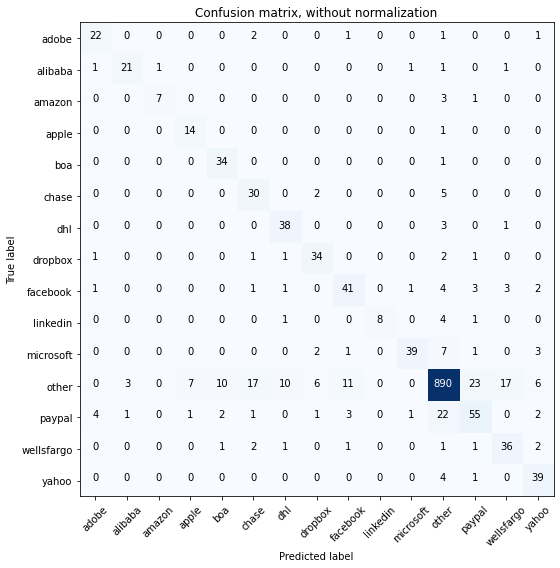

Acc     =  0.85
Pre     =  0.863
Rec     =  0.85
F1      =  0.853

Bal_Acc =  0.795
Bal_Pre =  0.761
Bal_Rec =  0.795
Bal_F1  =  0.778

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        27
     alibaba       0.84      0.81      0.82        26
      amazon       0.88      0.64      0.74        11
       apple       0.64      0.93      0.76        15
         boa       0.72      0.97      0.83        35
       chase       0.56      0.81      0.66        37
         dhl       0.73      0.90      0.81        42
     dropbox       0.76      0.85      0.80        40
    facebook       0.71      0.72      0.71        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.93      0.74      0.82        53
       other       0.94      0.89      0.91      1000
      paypal       0.63      0.59      0.61        93
  wellsfargo       0.62      0.80      0.70        45
       yahoo       0.71      0.89      0.79        44

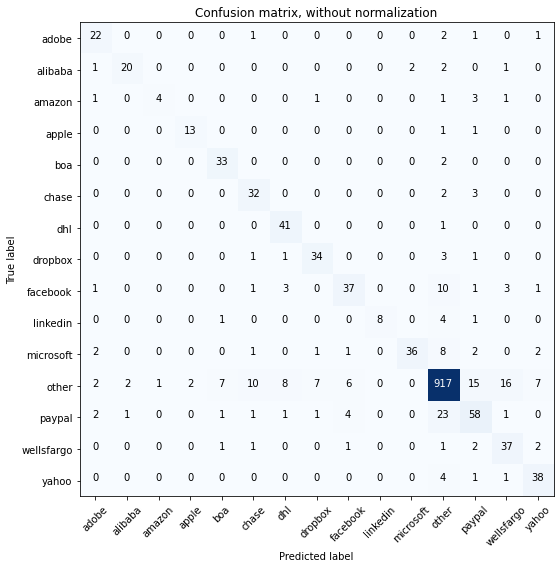

Acc     =  0.864
Pre     =  0.871
Rec     =  0.864
F1      =  0.864

Bal_Acc =  0.772
Bal_Pre =  0.791
Bal_Rec =  0.772
Bal_F1  =  0.781

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        27
     alibaba       0.87      0.77      0.82        26
      amazon       0.80      0.36      0.50        11
       apple       0.87      0.87      0.87        15
         boa       0.77      0.94      0.85        35
       chase       0.67      0.86      0.75        37
         dhl       0.76      0.98      0.85        42
     dropbox       0.77      0.85      0.81        40
    facebook       0.76      0.65      0.70        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.95      0.68      0.79        53
       other       0.93      0.92      0.93      1000
      paypal       0.65      0.62      0.64        93
  wellsfargo       0.62      0.82      0.70        45
       yahoo       0.75      0.86      0.80        

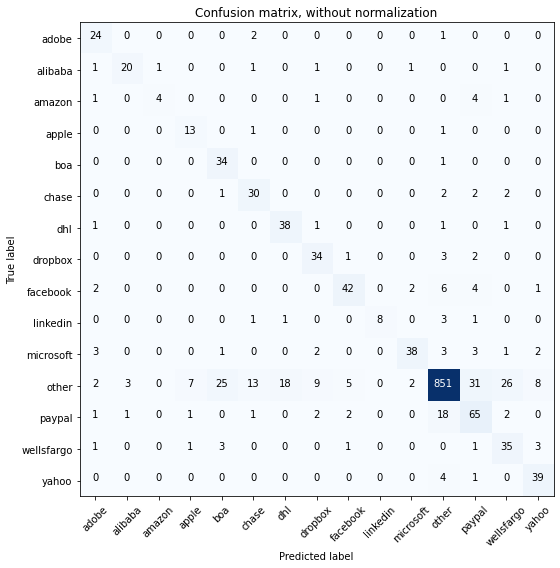

Acc     =  0.828
Pre     =  0.859
Rec     =  0.828
F1      =  0.836

Bal_Acc =  0.778
Bal_Pre =  0.724
Bal_Rec =  0.778
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.67      0.89      0.76        27
     alibaba       0.83      0.77      0.80        26
      amazon       0.80      0.36      0.50        11
       apple       0.59      0.87      0.70        15
         boa       0.53      0.97      0.69        35
       chase       0.61      0.81      0.70        37
         dhl       0.67      0.90      0.77        42
     dropbox       0.68      0.85      0.76        40
    facebook       0.82      0.74      0.78        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.88      0.72      0.79        53
       other       0.95      0.85      0.90      1000
      paypal       0.57      0.70      0.63        93
  wellsfargo       0.51      0.78      0.61        45
       yahoo       0.74      0.89      0.80        4

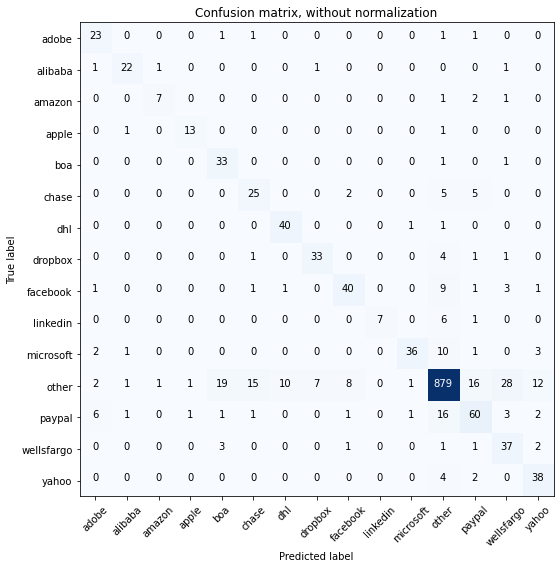

Acc     =  0.84
Pre     =  0.86
Rec     =  0.84
F1      =  0.845

Bal_Acc =  0.779
Bal_Pre =  0.755
Bal_Rec =  0.779
Bal_F1  =  0.767

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        27
     alibaba       0.85      0.85      0.85        26
      amazon       0.78      0.64      0.70        11
       apple       0.87      0.87      0.87        15
         boa       0.58      0.94      0.72        35
       chase       0.57      0.68      0.62        37
         dhl       0.78      0.95      0.86        42
     dropbox       0.80      0.82      0.81        40
    facebook       0.77      0.70      0.73        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.92      0.68      0.78        53
       other       0.94      0.88      0.91      1000
      paypal       0.66      0.65      0.65        93
  wellsfargo       0.49      0.82      0.62        45
       yahoo       0.66      0.86      0.75        44


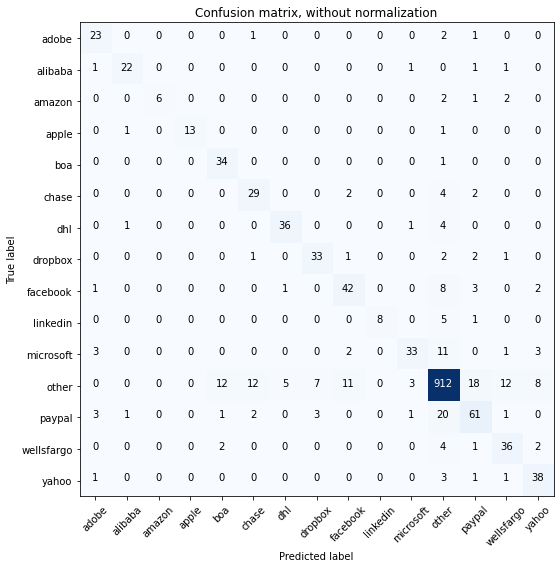

Acc     =  0.862
Pre     =  0.869
Rec     =  0.862
F1      =  0.862

Bal_Acc =  0.781
Bal_Pre =  0.807
Bal_Rec =  0.781
Bal_F1  =  0.794

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        27
     alibaba       0.88      0.85      0.86        26
      amazon       1.00      0.55      0.71        11
       apple       1.00      0.87      0.93        15
         boa       0.69      0.97      0.81        35
       chase       0.64      0.78      0.71        37
         dhl       0.86      0.86      0.86        42
     dropbox       0.77      0.82      0.80        40
    facebook       0.72      0.74      0.73        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.85      0.62      0.72        53
       other       0.93      0.91      0.92      1000
      paypal       0.66      0.66      0.66        93
  wellsfargo       0.65      0.80      0.72        45
       yahoo       0.72      0.86      0.78        

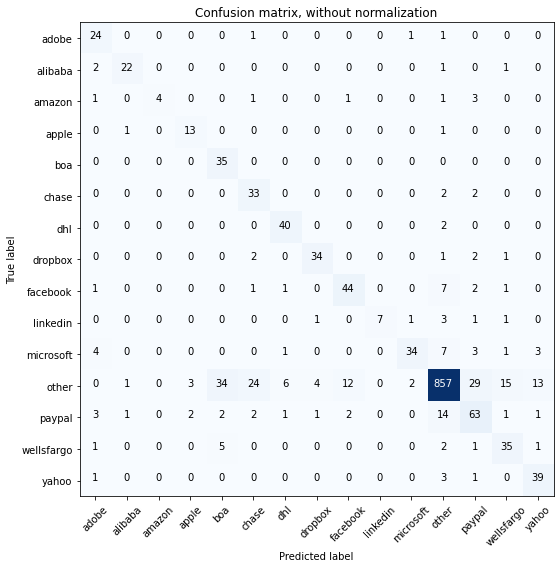

Acc     =  0.834
Pre     =  0.866
Rec     =  0.834
F1      =  0.841

Bal_Acc =  0.785
Bal_Pre =  0.759
Bal_Rec =  0.785
Bal_F1  =  0.772

              precision    recall  f1-score   support

       adobe       0.65      0.89      0.75        27
     alibaba       0.88      0.85      0.86        26
      amazon       1.00      0.36      0.53        11
       apple       0.72      0.87      0.79        15
         boa       0.46      1.00      0.63        35
       chase       0.52      0.89      0.65        37
         dhl       0.82      0.95      0.88        42
     dropbox       0.85      0.85      0.85        40
    facebook       0.75      0.77      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.89      0.64      0.75        53
       other       0.95      0.86      0.90      1000
      paypal       0.59      0.68      0.63        93
  wellsfargo       0.62      0.78      0.69        45
       yahoo       0.68      0.89      0.77        

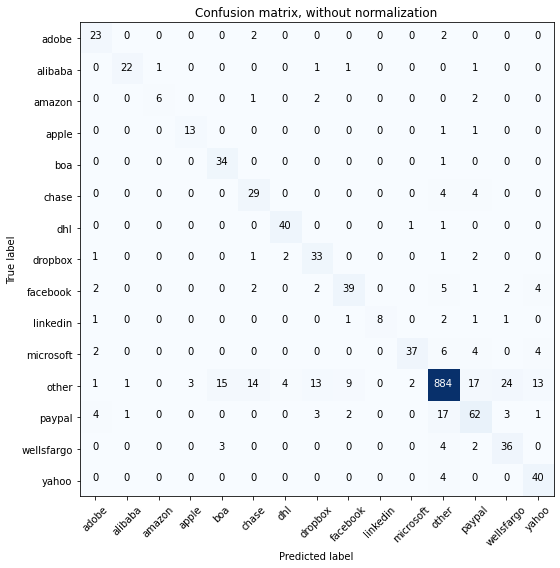

Acc     =  0.849
Pre     =  0.868
Rec     =  0.849
F1      =  0.853

Bal_Acc =  0.79
Bal_Pre =  0.763
Bal_Rec =  0.79
Bal_F1  =  0.776

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        27
     alibaba       0.92      0.85      0.88        26
      amazon       0.86      0.55      0.67        11
       apple       0.81      0.87      0.84        15
         boa       0.65      0.97      0.78        35
       chase       0.59      0.78      0.67        37
         dhl       0.87      0.95      0.91        42
     dropbox       0.61      0.82      0.70        40
    facebook       0.75      0.68      0.72        57
    linkedin       1.00      0.57      0.73        14
   microsoft       0.93      0.70      0.80        53
       other       0.95      0.88      0.92      1000
      paypal       0.64      0.67      0.65        93
  wellsfargo       0.55      0.80      0.65        45
       yahoo       0.65      0.91      0.75        44

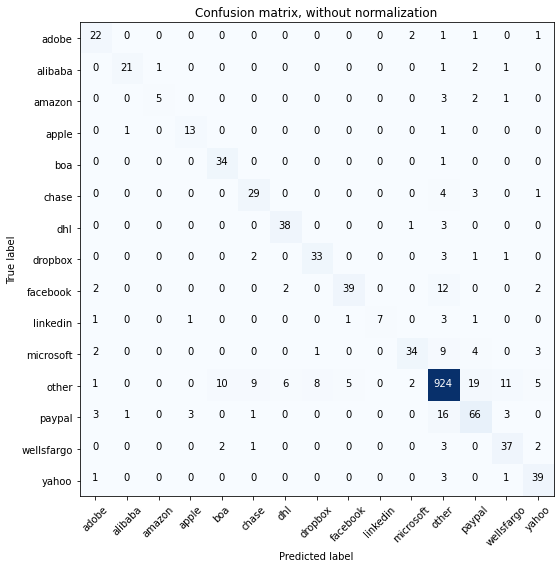

Acc     =  0.871
Pre     =  0.878
Rec     =  0.871
F1      =  0.871

Bal_Acc =  0.773
Bal_Pre =  0.799
Bal_Rec =  0.773
Bal_F1  =  0.786

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        27
     alibaba       0.91      0.81      0.86        26
      amazon       0.83      0.45      0.59        11
       apple       0.76      0.87      0.81        15
         boa       0.74      0.97      0.84        35
       chase       0.69      0.78      0.73        37
         dhl       0.83      0.90      0.86        42
     dropbox       0.79      0.82      0.80        40
    facebook       0.87      0.68      0.76        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.87      0.64      0.74        53
       other       0.94      0.92      0.93      1000
      paypal       0.67      0.71      0.69        93
  wellsfargo       0.67      0.82      0.74        45
       yahoo       0.74      0.89      0.80        

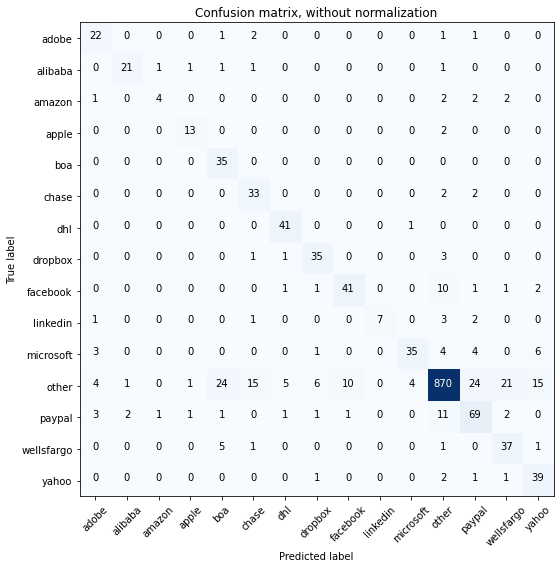

Acc     =  0.846
Pre     =  0.871
Rec     =  0.846
F1      =  0.851

Bal_Acc =  0.786
Bal_Pre =  0.748
Bal_Rec =  0.786
Bal_F1  =  0.767

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        27
     alibaba       0.88      0.81      0.84        26
      amazon       0.67      0.36      0.47        11
       apple       0.81      0.87      0.84        15
         boa       0.52      1.00      0.69        35
       chase       0.61      0.89      0.73        37
         dhl       0.84      0.98      0.90        42
     dropbox       0.78      0.88      0.82        40
    facebook       0.79      0.72      0.75        57
    linkedin       1.00      0.50      0.67        14
   microsoft       0.88      0.66      0.75        53
       other       0.95      0.87      0.91      1000
      paypal       0.65      0.74      0.69        93
  wellsfargo       0.58      0.82      0.68        45
       yahoo       0.62      0.89      0.73        

In [14]:
list_of_analysis=[]
for image_size in list_of_size:
    for models in list_of_combinations:
        model1 = models.split(",")[0]
        model2 = models.split(",")[1]
        for classifier in list_of_classifiers:
            for n_component in n_components:
                print("--------------------------------------------------------------------------")
                print(classifier, model1, model2, image_size, n_component)
                print("")
                accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc = classify(model1, model2, classifier, image_size, n_component)
                list_of_analysis.append(
                    [
                     classifier, model1, model2, image_size, n_components, accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc
                    ]
                )

In [15]:
list_of_analysis

[['RF',
  'Xception',
  'VGG16',
  128,
  [50, 100, 500],
  0.842,
  0.855,
  0.842,
  0.844,
  0.742,
  0.712,
  0.742,
  0.727,
  0.985,
  0.982,
  0.015,
  0.258,
  0.288,
  0.979],
 ['RF',
  'Xception',
  'VGG16',
  128,
  [50, 100, 500],
  0.849,
  0.857,
  0.849,
  0.849,
  0.734,
  0.747,
  0.734,
  0.74,
  0.984,
  0.983,
  0.016,
  0.266,
  0.253,
  0.98],
 ['RF',
  'Xception',
  'VGG16',
  128,
  [50, 100, 500],
  0.821,
  0.84,
  0.821,
  0.824,
  0.712,
  0.697,
  0.712,
  0.704,
  0.982,
  0.98,
  0.018,
  0.288,
  0.303,
  0.976],
 ['RF',
  'Xception',
  'VGG19',
  128,
  [50, 100, 500],
  0.832,
  0.848,
  0.832,
  0.836,
  0.763,
  0.705,
  0.763,
  0.733,
  0.984,
  0.98,
  0.016,
  0.237,
  0.295,
  0.978],
 ['RF',
  'Xception',
  'VGG19',
  128,
  [50, 100, 500],
  0.841,
  0.854,
  0.841,
  0.843,
  0.747,
  0.726,
  0.747,
  0.736,
  0.984,
  0.982,
  0.016,
  0.253,
  0.274,
  0.979],
 ['RF',
  'Xception',
  'VGG19',
  128,
  [50, 100, 500],
  0.793,
  0.821,
  0.

In [16]:
import pandas as pd
df=pd.DataFrame(list_of_analysis, columns=[
                 "classifier",
                 "model1",
                 "model2",
                 "image_size",
                "n_components",
                 "accuracy", 
                 "precision", 
                 "recall", 
                 "f1_score", 
                 "balanced_accuracy", 
                 "balanced_precision_PPV", 
                 "balanced_recall_TPR", 
                 "Bal_F1",
                 "TNR", 
                 "NPV", 
                 "FPR", 
                 "FNR", 
                 "FDR", 
                 "Overall_Acc"
                ])
df

,classifier,model1,model2,image_size,n_components,accuracy,precision,recall,f1_score,balanced_accuracy,balanced_precision_PPV,balanced_recall_TPR,Bal_F1,TNR,NPV,FPR,FNR,FDR,Overall_Acc
0,RF,Xception,VGG16,128,"[50, 100, 500]",0.842,0.855,0.842,0.844,0.742,0.712,0.742,0.727,0.985,0.982,0.015,0.258,0.288,0.979
1,RF,Xception,VGG16,128,"[50, 100, 500]",0.849,0.857,0.849,0.849,0.734,0.747,0.734,0.740,0.984,0.983,0.016,0.266,0.253,0.980
2,RF,Xception,VGG16,128,"[50, 100, 500]",0.821,0.840,0.821,0.824,0.712,0.697,0.712,0.704,0.982,0.980,0.018,0.288,0.303,0.976
3,RF,Xception,VGG19,128,"[50, 100, 500]",0.832,0.848,0.832,0.836,0.763,0.705,0.763,0.733,0.984,0.980,0.016,0.237,0.295,0.978
4,RF,Xception,VGG19,128,"[50, 100, 500]",0.841,0.854,0.841,0.843,0.747,0.726,0.747,0.736,0.984,0.982,0.016,0.253,0.274,0.979
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
391,RF,DenseNet121,DenseNet201,256,"[50, 100, 500]",0.862,0.869,0.862,0.862,0.781,0.807,0.781,0.794,0.985,0.984,0.015,0.219,0.193,0.982
392,RF,DenseNet121,DenseNet201,256,"[50, 100, 500]",0.834,0.866,0.834,0.841,0.785,0.759,0.785,0.772,0.985,0.980,0.015,0.215,0.241,0.978
393,RF,DenseNet169,DenseNet201,256,"[50, 100, 500]",0.849,0.868,0.849,0.853,0.790,0.763,0.790,0.776,0.986,0.982,0.014,0.210,0.237,0.980
394,RF,DenseNet169,DenseNet201,256,"[50, 100, 500]",0.871,0.878,0.871,0.871,0.773,0.799,0.773,0.786,0.986,0.985,0.014,0.227,0.201,0.983


In [17]:
df.to_csv(analysis_output, header=True, index=False)